In [1]:
cd /Volumes/Backup\ Plus

/Volumes/Backup Plus


In [7]:
cd /Users/kwanjeffrey/Desktop/Pioneer/

/Users/kwanjeffrey/Desktop/Pioneer


In [1]:
#Import modules
%matplotlib inline

#handling data
import pandas as pd
import numpy as np
from scipy import stats
from operator import itemgetter

#import twitter credentials
#from twitter_credentials import *

#handling information
import re
import json

#handling plots
import matplotlib.pyplot as plt
import seaborn as sns

#for network creation
import networkx as nx

In [2]:
pd.set_option('display.float_format', lambda x: '%.f' % x) #suppress scientific notation

In [12]:
#read dataset
tweets_df = pd.read_json('tweets1.json')

In [47]:
tweets_df

NameError: name 'tweets_df' is not defined

In [14]:
#second dataframe to retrieve relevant information
tweets_final = pd.DataFrame(columns = ["created_at", "id", "in_reply_to_screen_name", "in_reply_to_status_id", "in_reply_to_user_id",
                                      "retweeted_id", "retweeted_screen_name", "user_mentions_screen_name", "user_mentions_id", 
                                       "text", "user_id", "screen_name", "followers_count"])

In [15]:
#columns that are going to be the same
equal_columns = ["created_at", "id", "text"]
tweets_final[equal_columns] = tweets_df[equal_columns]

In [4]:
#get basic information about user
def get_basics(tweets_final):
    tweets_final["screen_name"] = tweets_df["user"].apply(lambda x: x["screen_name"])
    tweets_final["user_id"] = tweets_df["user"].apply(lambda x: x["id"])
    tweets_final["followers_count"] = tweets_df["user"].apply(lambda x: x["followers_count"])
    return tweets_final

In [5]:
# Get the user mentions 
def get_usermentions(tweets_final):
    # Inside the tag 'entities' will find 'user mentions' and will get 'screen name' and 'id'
    tweets_final["user_mentions_screen_name"] = tweets_df["entities"].apply(lambda x: x["user_mentions"][0]["screen_name"] if x["user_mentions"] else np.nan)
    tweets_final["user_mentions_id"] = tweets_df["entities"].apply(lambda x: x["user_mentions"][0]["id_str"] if x["user_mentions"] else np.nan)
    return tweets_final

In [6]:
# Get retweets
def get_retweets(tweets_final):
    # Inside the tag 'retweeted_status' will find 'user' and will get 'screen name' and 'id'    
    tweets_final["retweeted_screen_name"] = tweets_df["retweeted_status"].apply(lambda x: x["user"]["screen_name"] if x is not np.nan else np.nan)
    tweets_final["retweeted_id"] = tweets_df["retweeted_status"].apply(lambda x: x["user"]["id_str"] if x is not np.nan else np.nan)
    return tweets_final

In [7]:
# Get the information about replies
def get_in_reply(tweets_final):
    # Just copy the 'in_reply' columns to the new dataframe
    tweets_final["in_reply_to_screen_name"] = tweets_df["in_reply_to_screen_name"]
    tweets_final["in_reply_to_status_id"] = tweets_df["in_reply_to_status_id"]
    tweets_final["in_reply_to_user_id"]= tweets_df["in_reply_to_user_id"]
    return tweets_final

In [8]:
# Lastly fill the new dataframe with the important information
def fill_df(tweets_final):
    get_basics(tweets_final)
    get_usermentions(tweets_final)
    get_retweets(tweets_final)
    get_in_reply(tweets_final)
    return tweets_final

In [2]:
# Get the interactions between the different users
def get_interactions(row):
    # From every row of the original dataframe
    # First we obtain the 'user_id' and 'screen_name'
    user = str(row["user_id"]), row["screen_name"]
    # Be careful if there is no user id
    if user[0] is None:
        return (None, None), []
    
    # The interactions are going to be a set of tuples
    interactions = set()
    
    # Add all interactions 
    # First, we add the interactions corresponding to replies adding the id and screen_name
    interactions.add((str(row["in_reply_to_user_id"]), row["in_reply_to_screen_name"],"reply"))
    # After that, we add the interactions with retweets
    interactions.add((str(row["retweeted_id"]), row["retweeted_screen_name"],"retweet"))
    # And later, the interactions with user mentions
    interactions.add((str(row["user_mentions_id"]), row["user_mentions_screen_name"],"mention"))
    
    # Discard if user id is in interactions
    interactions.discard((str(row["user_id"]), row["screen_name"]))
    # Discard all not existing values
    interactions.discard((None, None))
    # Return user and interactions
    return user, interactions

In [3]:
# Get retweet interactions between the different users (self-defined)
def get_retweet_interactions(row):
    # From every row of the original dataframe
    # First we obtain the 'user_id' and 'screen_name'
    user = str(row["user_id"]), row["screen_name"]
    # Be careful if there is no user id
    if user[0] is None:
        return (None, None), []
    
    # The interactions are going to be a set of tuples
    interactions = set()
    
    # After that, we add the interactions with retweets
    interactions.add((str(row["retweeted_id"]), row["retweeted_screen_name"]))
   
    
    # Discard if user id is in interactions
    interactions.discard((str(row["user_id"]), row["screen_name"]))
    # Discard all not existing values
    interactions.discard((None, None))
    # Return user and interactions
    return user, interactions

In [4]:
# Get the reply interactions between the different users (self-defined)
def get_reply_interactions(row):
    # From every row of the original dataframe
    # First we obtain the 'user_id' and 'screen_name'
    user = str(row["user_id"]), row["screen_name"]
    # Be careful if there is no user id
    if user[0] is None:
        return (None, None), []
    
    # The interactions are going to be a set of tuples
    interactions = set()
    
    # Add all interactions 
    # First, we add the interactions corresponding to replies adding the id and screen_name
    interactions.add((str(row["in_reply_to_user_id"]), row["in_reply_to_screen_name"]))
    
    
    # Discard if user id is in interactions
    interactions.discard((str(row["user_id"]), row["screen_name"]))
    # Discard all not existing values
    interactions.discard((None, None))
    # Return user and interactions
    return user, interactions

In [5]:
# Get the user mention interactions between the different users (self-defined)
def get_mention_interactions(row):
    # From every row of the original dataframe
    # First we obtain the 'user_id' and 'screen_name'
    user = str(row["user_id"]), row["screen_name"]
    # Be careful if there is no user id
    if user[0] is None:
        return (None, None), []
    
    # The interactions are going to be a set of tuples
    interactions = set()
    

    # And later, the interactions with user mentions
    interactions.add((str(row["user_mentions_id"]), row["user_mentions_screen_name"]))
    
    # Discard if user id is in interactions
    interactions.discard((str(row["user_id"]), row["screen_name"]))
    # Discard all not existing values
    interactions.discard((None, None))
    # Return user and interactions
    return user, interactions

In [6]:
#progress bar
from tqdm import tqdm

In [58]:
#fill in rest of dataframe
tweets_final = fill_df(tweets_final)

NameError: name 'tweets_df' is not defined

In [27]:
#discard none values
tweets_final = tweets_final.where((pd.notnull(tweets_final)), None)

In [8]:
import pickle

In [29]:
tweets_final.to_pickle('/Volumes/Backup Plus/networkanalysisdf.pkl') #safeguard which actually proved life saving

In [8]:
tweets_final = pd.read_pickle('/Volumes/Backup Plus/networkanalysisdf.pkl')

In [15]:
#sample
tweets_final.head(5)

,created_at,id,in_reply_to_screen_name,in_reply_to_status_id,in_reply_to_user_id,retweeted_id,retweeted_screen_name,user_mentions_screen_name,user_mentions_id,text,user_id,screen_name,followers_count
0,2020-06-20 02:54:19+00:00,1274173705548189697,None,None,None,174443391,MJDuzan,MJDuzan,174443391,RT @MJDuzan: Y el presidente diciendo que no h...,399473642,Javi_artesano,10404
1,2020-06-20 02:54:19+00:00,1274173707766939650,None,None,None,None,None,CarmenKingy,857982677420568582,.@CarmenKingy i’m literally so obsessed w ur r...,4311906501,cloutciara,284
2,2020-06-20 02:54:19+00:00,1274173708504973312,None,None,None,None,None,None,None,So not health or the military now. I'm confused.,1530354577,PaulBMcGill,3205
3,2020-06-20 02:54:20+00:00,1274173710052651008,None,None,None,56304605,sardesairajdeep,sardesairajdeep,56304605,RT @sardesairajdeep: In other news.. Delhi LG ...,137683642,SanjayKrYadav,1486
4,2020-06-20 02:54:20+00:00,1274173710736318465,None,None,None,84696056,Madison420Ivy,Madison420Ivy,84696056,RT @Madison420Ivy: Trying to be your favorite ...,3191158316,alebroncos2,214


In [25]:
tweet = tweets_final['text']

In [325]:
#checking for none values in tweet
e = []
for i in tqdm(tweet):
    if i == None or i == '':
        e.append(1)

100%|██████████| 247584/247584 [00:07<00:00, 31484.77it/s]


In [326]:
len(e) #no empty text

0

In [21]:
#rip out each ID as a series
userID = tweets_final['user_id']

In [22]:
user_mentions_id = tweets_final['user_mentions_id']

In [23]:
in_reply_to_user_id = tweets_final['in_reply_to_user_id']

In [24]:
retweeted_id = tweets_final['retweeted_id']

In [13]:
#import and set up Vader
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
analyser = SentimentIntensityAnalyzer()

def sentiment_analyzer_scores(sentence):
    score = analyser.polarity_scores(sentence)
    #print("{:-<40} {}".format(sentence, str(score)))
    return float(score['compound'])

In [49]:
#sample output
sentiment_analyzer_scores('haha lol')

0.7003

In [30]:
#check the number of unique IDs
total_ids = {}

In [31]:
userID2 = list(tweets_final['user_id'])
retweeted_id2 = list(tweets_final['retweeted_id'])
in_reply_to_user_id2 = list(tweets_final['in_reply_to_user_id'])
user_mentions_id2 = list(tweets_final['user_mentions_id'])

In [32]:
#loop to append values to unique IDs. For some reason this runs faster than using counters. Also for some reason bypasses the slow typecasting
for i in tqdm(range(len(userID2))):
    if userID2[i] != None:
        if str(userID2[i]) in total_ids:
                total_ids[str(userID2[i])].append(1)
        else:
            total_ids[str(userID2[i])] = []
            total_ids[str(userID2[i])].append(1)
    elif retweeted_id2[i] != None:
        if str(retweeted_id2[i]) in total_ids:
                total_ids[str(retweeted_id2[i])].append(1)
        else:
            total_ids[str(retweeted_id2[i])] = []
            total_ids[str(retweeted_id2[i])].append(1)
    elif in_reply_to_user_id2[i] != None:
        if str(in_reply_to_user_id2[i]) in total_ids:
                total_ids[str(in_reply_to_user_id2[i])].append(1)
        else:
            total_ids[str(in_reply_to_user_id2[i])] = []
            total_ids[str(in_reply_to_user_id2[i])].append(1)
    else:
        if str(user_mentions_id2[i]) in total_ids:
                total_ids[str(user_mentions_id2[i])].append(1)
        else:
            total_ids[str(user_mentions_id2[i])] = []
            total_ids[str(user_mentions_id2[i])].append(1)

100%|██████████| 247584/247584 [00:01<00:00, 232796.76it/s]


In [33]:
len(total_ids)

79572

In [258]:
#check if there are empty values in tweet and userID
for i in tqdm(range(len(userID))):
    if userID[i] == None:
        print('none value')

100%|██████████| 247584/247584 [00:03<00:00, 68959.64it/s]


In [ ]:
#initialize dict
users_sentiment = {}

In [ ]:
null_ids = [] #IDs that cannot be attributed a sentiment have to be accounted for as they are still part of the network. This would include IDs that only receive tweets like mentions and replies to. 

In [17]:
#get user sentiment. This is stored in a dictionary of unique IDs and a list of scores as values.
for i in tqdm(range(len(tweet))):
    s = sentiment_analyzer_scores(tweet[i])
    if in_reply_to_user_id[i] != None:
        null_ids.append(str(in_reply_to_user_id[i])) #the reason why I had to make every ID a string is because some columns in the dataframe had different types which count as unique values
        if str(userID[i]) in users_sentiment:
            users_sentiment[str(userID[i])].append(s)
        else:
            users_sentiment[str(userID[i])] = []
            users_sentiment[str(userID[i])].append(s)
    elif str(retweeted_id[i]) != None:
        if str(userID[i]) in users_sentiment and str(retweeted_id[i]) in users_sentiment:
            users_sentiment[str(userID[i])].append(s)
            users_sentiment[str(retweeted_id[i])].append(s)
        elif str(userID[i]) in users_sentiment:
            users_sentiment[str(userID[i])].append(s)
            users_sentiment[str(retweeted_id[i])] = []
            users_sentiment[str(retweeted_id[i])].append(s)
        elif str(retweeted_id[i]) in users_sentiment:
            users_sentiment[str(retweeted_id[i])].append(s)
            users_sentiment[str(userID[i])] = []
            users_sentiment[str(userID[i])].append(s)
        else:
            users_sentiment[str(userID[i])] = []
            users_sentiment[str(retweeted_id[i])] = []
            users_sentiment[str(userID[i])].append(s)
            users_sentiment[str(retweeted_id[i])].append(s)
    elif user_mentions_id[i] != None:
        null_ids.append(str(user_mentions_id[i]))
        if str(userID[i]) in users_sentiment:
            users_sentiment[str(userID[i])].append(s)
        else:
            users_sentiment[str(userID[i])] = []
            users_sentiment[str(userID[i])].append(s)       
    else:
        if str(userID[i]) in users_sentiment:
            users_sentiment[str(userID[i])].append(s)
        else:
            users_sentiment[str(userID[i])] = []
            users_sentiment[str(userID[i])].append(s)
            print(str(userID[i]),users_sentiment[str(userID[i])]) #this line didn't run

100%|██████████| 247584/247584 [02:01<00:00, 2042.91it/s]


In [362]:
len(users_sentiment)

96345

In [22]:
len(set(null_ids))

6939

In [20]:
null_ids_final = set(null_ids)

In [187]:
null_ids

['26436019.0',
 '2898210073.0',
 '412655142.0',
 '164027710.0',
 '8.193201854883635e+17',
 '2603947544.0',
 '8.794721095791575e+17',
 '1.263064994381394e+18',
 '8.865575808768164e+17',
 '16111534.0',
 '15976705.0',
 '2290604383.0',
 '1.1955762201312666e+18',
 '112044454.0',
 '1.2660653981028844e+18',
 '1.0359445597155369e+18',
 '17364806.0',
 '1383272101.0',
 '2287625701.0',
 '9.216252329635471e+17',
 '1.0413674513787699e+18',
 '1.2074524958170153e+18',
 '14529929.0',
 '7.845754154573087e+17',
 '249192073.0',
 '21906144.0',
 '3224807688.0',
 '8.468749506820997e+17',
 '2346317706.0',
 '8.154730308685455e+17',
 '1.2300078422973727e+18',
 '586665536.0',
 '41646662.0',
 '133912673.0',
 '61792342.0',
 '34795013.0',
 '20887713.0',
 '400324576.0',
 '1.1678910083248988e+18',
 '227111818.0',
 '1.215556114852352e+18',
 '2244707072.0',
 '101895678.0',
 '7.270502883102966e+17',
 '2875227179.0',
 '1417771476.0',
 '2343826446.0',
 '8.174156351101624e+17',
 '18170896.0',
 '232268199.0',
 '50769180.0'

In [21]:
#shove the null values back in
for user in tqdm(null_ids_final):
    if user not in users_sentiment:
        users_sentiment[user] = None

100%|██████████| 6939/6939 [00:00<00:00, 621434.76it/s]


In [ ]:
#this abomination hath been borne unto this world due to the incompetence of the programmer
#for some reason I wasn't getting all of the IDs in the user_mentions list, so I had to brute force them in
for user in tqdm(user_mentions_id):
    if user not in users_sentiment:
        users_sentiment[user] = None

In [25]:
len(users_sentiment)

96345

In [23]:
#back ups
import pickle
with open('/Volumes/Backup Plus/users_sentiment.pkl','wb') as f:
    pickle.dump(users_sentiment,f,pickle.HIGHEST_PROTOCOL)

In [9]:
import pickle
with open('/Volumes/Backup Plus/users_sentiment.pkl','rb') as f:
    users_sentiment = pickle.load(f)

In [10]:
averaged_sentiment = {}

In [11]:
#average the values in the dictionary
for key in tqdm(users_sentiment):
    if users_sentiment[key] != None:
        a = sum(users_sentiment[key])/len(users_sentiment[key])
        averaged_sentiment[key] = a
    else:
        averaged_sentiment[key] = None

100%|██████████| 96345/96345 [00:00<00:00, 492131.76it/s]


In [366]:
averaged_sentiment
#not sure why there is a 'none' key as there isn't supposed to be a none value in userID and I caught all the nones in the for loop
#removed later in the code

{'399473642': -0.296,
 '174443391': -0.2960000000000156,
 '4311906501': 0.3612,
 'None': 0.08630784340366279,
 '1530354577': -0.3182,
 '137683642': 0.2422,
 '56304605': 0.13051306187202788,
 '3191158316': 0.7184,
 '84696056': 0.683542857142857,
 '1096330747160420352': 0.4635,
 '1095825244965621761': 0.46350000000000013,
 '941689937044410368': 0.45879999999999993,
 '18036907': 0.45880000000000004,
 '1165093932142907393': 0.0,
 '2792282931': 0.0,
 '1966940634': 0.0,
 '60289128': 0.0,
 '1270427536963534849': 0.44040000000000007,
 '20277941': 0.44039999999999996,
 '2807583090': 0.0,
 '3355313668': -0.296,
 '805615945964257280': 0.0,
 '735583903902277632': 0.0,
 '23126232': 0.0,
 '1268499931075088384': 0.765,
 '1000961577552494592': 0.44040000000000007,
 '1124456517074210816': 0.44040000000000024,
 '849324029588774912': -0.4101000000000001,
 '975868740498796545': 0.128,
 '1190616832899571713': 0.4939,
 '1263449653703368706': 0.0,
 '744986848435417088': 0.1998857142857143,
 '1229961368406593

In [12]:
overall_sentiment = {}

In [13]:
# turn into 1 -1 0
for i in tqdm(averaged_sentiment):
    if averaged_sentiment[i] == None:
        overall_sentiment[i] = 'grey'
    else:
        if averaged_sentiment[i] >= 0.3:
            overall_sentiment[i] = 'blue'
        elif averaged_sentiment[i] <= -0.3:
            overall_sentiment[i] = 'red'

        else:
            overall_sentiment[i] = 'green'

100%|██████████| 96345/96345 [00:00<00:00, 695847.51it/s]


In [502]:
overall_sentiment

{'399473642': 'green',
 '174443391': 'green',
 '4311906501': 'blue',
 'None': 'green',
 '1530354577': 'red',
 '137683642': 'green',
 '56304605': 'green',
 '3191158316': 'blue',
 '84696056': 'blue',
 '1096330747160420352': 'blue',
 '1095825244965621761': 'blue',
 '941689937044410368': 'blue',
 '18036907': 'blue',
 '1165093932142907393': 'green',
 '2792282931': 'green',
 '1966940634': 'green',
 '60289128': 'green',
 '1270427536963534849': 'blue',
 '20277941': 'blue',
 '2807583090': 'green',
 '3355313668': 'green',
 '805615945964257280': 'green',
 '735583903902277632': 'green',
 '23126232': 'green',
 '1268499931075088384': 'blue',
 '1000961577552494592': 'blue',
 '1124456517074210816': 'blue',
 '849324029588774912': 'red',
 '975868740498796545': 'green',
 '1190616832899571713': 'blue',
 '1263449653703368706': 'green',
 '744986848435417088': 'green',
 '1229961368406593536': 'green',
 '2205364669': 'red',
 '2888294402': 'green',
 '939465432112627713': 'green',
 '1110541941106753536': 'green

In [450]:
len(overall_sentiment)

96345

In [503]:
# this is supposed to be later in the code, but because some variables may have been accidentally written over I put this here.
# sum the colors to get color counts (Network Sentiment Analysis section)
a = []
b = []
c = []
d = []
for n in overall_sentiment:
    if overall_sentiment[n] == 'red':
        a.append(1)
    elif overall_sentiment[n] == 'blue':
        b.append(1)
    elif overall_sentiment[n] == 'green':
        c.append(1)
    else:
        d.append(1)
print(len(a),len(b),len(c),len(d))

16165 20575 47014 12591


In [479]:
# check why neutrals is so high
tweet_sentiment = []
for i in tqdm(tweet):
    tweet_sentiment.append(sentiment_analyzer_scores(i))

100%|██████████| 247584/247584 [00:52<00:00, 4731.36it/s]


In [486]:
tweet_sentiment

[-0.296,
 0.3612,
 -0.3182,
 0.2422,
 0.7184,
 0.4635,
 0.4588,
 0.0,
 0.0,
 0.4404,
 0.0,
 -0.296,
 0.0,
 0.0,
 0.765,
 0.4404,
 -0.4101,
 0.128,
 0.4939,
 0.0,
 -0.4019,
 0.0,
 -0.0772,
 -0.3612,
 0.4939,
 0.0,
 0.2263,
 0.8074,
 0.0,
 0.3818,
 -0.7783,
 -0.6899,
 0.0,
 -0.5994,
 0.8625,
 0.8225,
 -0.1532,
 -0.694,
 0.0,
 0.3612,
 -0.3182,
 0.2422,
 0.7184,
 0.4635,
 0.4588,
 0.0,
 0.0,
 0.4404,
 0.0,
 -0.296,
 0.0,
 0.0,
 0.765,
 0.4404,
 -0.4101,
 0.128,
 0.4939,
 0.0,
 -0.4019,
 0.0,
 -0.0772,
 -0.3612,
 0.4939,
 0.0,
 0.2263,
 0.8074,
 0.0,
 0.3818,
 -0.7783,
 -0.6899,
 0.0,
 -0.5994,
 0.8625,
 0.8225,
 -0.1532,
 -0.694,
 0.0,
 0.4215,
 0.0,
 0.0,
 0.3612,
 -0.3182,
 0.2422,
 0.7184,
 0.4635,
 0.4588,
 0.0,
 0.0,
 0.4404,
 0.0,
 -0.296,
 0.0,
 0.0,
 0.765,
 0.4404,
 -0.4101,
 0.128,
 0.4939,
 0.0,
 -0.4019,
 0.0,
 -0.0772,
 -0.3612,
 0.4939,
 0.0,
 0.2263,
 0.8074,
 0.0,
 0.3818,
 -0.7783,
 -0.6899,
 0.0,
 -0.5994,
 0.8625,
 0.8225,
 -0.1532,
 -0.694,
 0.0,
 0.4215,
 0.0,
 0.0,
 

In [493]:
# list of positive tweets
for i in tqdm(range(len(tweet_sentiment))):
    if tweet_sentiment[i] >= 0.3:
        print(tweet[i])
        if i >=1000:
            break

  0%|          | 0/247584 [00:00<?, ?it/s]

.@CarmenKingy i’m literally so obsessed w ur real housewives of windenburg series it’s so funny, tysm for keeping u… https://t.co/mlAFF12Doj
RT @Madison420Ivy: Trying to be your favorite Quarantine snack 😈 https://t.co/FWPKcHYDiD https://t.co/sB1xvk9w66
RT @lixuals: also !!! felix wasn’t comfortable with his korean enough to do a solo live for about THREE years but he understood that quaran…
RT @maryjpitzl: Kansas adds #Arizona to its quarantine list, meaning as of June 17, travelers coming into KS from the Grand Canyon State mu…
RT @FranOSullivan: Safe pair of hands ... everyone Cabinet needs one.
have u ever done this during quarantine? yes/no

1. Yeah 
2. Yes 
3. Yes 
4. Yyyyyaaaa
5. Off course 
6. Nope… https://t.co/GxzdiDAm3k
RT @commonsense_nz: Friday afternoon drinks and word salad with Megan Woods. Let's hope Megan's butchering of her speech today is not indic…
Hahahahaha Naalala na naman kita🤣
RT @lorriebeauchamp: My friend Christine (in a wheelchair, with Cerebral Palsy) has 

  1%|          | 3087/247584 [00:00<00:15, 15644.87it/s]

spent most of quarantine free balling and at this point I don’t see any reason to quit
RT @PupBuday: Retweet if you would want to spend the quarantine with me 😊👉🏼👈🏼 https://t.co/mK8zyoOs3k
PMSg Jan Fredrick Valeros engaged  to the motorist passingby Quarantine Control point at Barangay Lumaba,Villavicio… https://t.co/LZYiVzUazA
RT @HSugarCookie: I gained quarantine weight in 😶 https://t.co/I1FodyAFvG
PMSg Jan Fredrick Valeros engaged  to the motorist passingby Quarantine Control point at Barangay Lumaba,Villavicio… https://t.co/LZYiVzUazA
RT @HSugarCookie: I gained quarantine weight in 😶 https://t.co/I1FodyAFvG
@wmbfnews Myrtle beach, all the tourist areas of SC are going to skyrocket cases, run out of healthy employees ( yo… https://t.co/csxRGUOFGM
RT @RedditCFB: 23 of Clemson's 104 football players have tested positive for COVID-19. Those players will quarantine and voluntary workouts…
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. 

  2%|▏         | 6176/247584 [00:00<00:15, 15437.76it/s]

RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
@helleiot @jamesking0314 @CAgovernor @GavinNewsom Now a bus just arrived from SQ to SVSP to “quarantine” wow &amp; of course no one was tested
@JeffWayneBundy @dizzygotbandz @ufcLawrence @DDJ384 @GrAKing0393 @TopN0tchMMA Lmao its quarantine baby. This the on… https://t.co/85MbtJFRJf
RT @ktlaENT: The lovely @SofiaCarson chats with @SamOnTV about quarantine life Plus her new @netflix movie #FeelTheBeat 
#feelthebeatmovie…
RT @igrcsmdln: Hi, twitter!! I'm just a proud daughter who wants to share my papa's quarantine project. Let's make art 💗 https://t.co/1WfDp…
@KGweStSiiiide But like, this is normal, even when not in quarantine. It's just been amplified by 100
RT @Lance_Bandalan: Para sa mga may tensionadong relasyon dis quarantine✊ HAHAHA https://t.co/G1s9EbdVSZ
Kaines haha may diploma nako after quarantine BACHELOR OF LINIS BAHAY MAJOR IN HUGAS PL

  4%|▍         | 9644/247584 [00:00<00:16, 14249.25it/s]


RT @tonsofbooks: @support_a_teach @DonorsChoose @TpT_Official @Scholastic I'm a 6th grade ELA teacher. I would love some sprinkles in my Sc…
RT @TheMangoMan7: Comrade Barack Obama Goes Golfing After Michelle Said Stay Home. Double standard and hypocrisy is stunning!  https://t.co…
@_sweetnlow_ Thank girl, i really appreciate it♥️ and yeah, we all hate being quarantine, but if we don’t do it the… https://t.co/0xeEiEjTNH
really upset that I finished all six seasons of love island between the beginning of quarantine and now
@msienoyooun Congrats satin sa mga naipon natin ngayong quarantine at sa bagong friendship with Kuya Lazada 🤣
@brettsolis12 I actually think this is a really good solution to contact tracing. If we a lot of us buy in, we can… https://t.co/gxWxlaLpfg
RT @__11x11__: More UTAC merch for your needs in quarantine. UNDERTALE belongs to @tobyfox respectively. #Undertale #AnimalCrossing #ACNH #…
@tired_nonsense @ForrestBennett always?  I've never argued with you, ever.  Howev

  5%|▌         | 13256/247584 [00:00<00:16, 14360.24it/s]


AbFab Quarantine special! @ferrifrump @JoannaLumleyUK @hulu @BBC
RT @yunamusic: 🙏🏽❤️✨ Stay Where You Are music video is out now
RT @fructosepapi: the fact that i was starting to get happy with my body and then quarantine made me lose all that progress https://t.co/52…
RT @997now: I had a chat with @JacksonWang852 and he shared more about what to expect from his album &amp; what he’s been up to during quaranti…
RT @OrgasmGifs: so like... you tryna quarantine and chill? 
                        🥺
                      👉🏻👈🏻 https://t.co/82ZFuREnDi
RT @ofctimallen: My quarantine head can have very selfish moments. It is perhaps wise to look out, not in at times. The grateful wind of gr…
RT @AdiBoss_KHKT: @MariyaSwaroop Yes. It's really good. I have drilling over Rohit Sippy and Sonakshi Rastogi now. This is the best thing t…
RT @JulyViper: Send me money for more tasty snacks like the one this heart is covering 🤫🥰
#ThirstyThursday #Quarantine #cashapp https://t.c…
RT @rammadhavbjp: Thanks.

  6%|▌         | 15041/247584 [00:01<00:16, 14019.51it/s]

Happy birthday ate @jhang_gc! Agawid kan taonu i-quarantine da ka met uki ingat ingat there xoxo
RT @ofctimallen: My quarantine head can have very selfish moments. It is perhaps wise to look out, not in at times. The grateful wind of gr…
RT @vapourtrash: I always forget to upload commissions but here's something AWESOME I got a while back from @saintdraconis!

Quarantine has…
@anilvijminister sahab it's the state of Haryana Quarantine Centres for which we bragged that we are having best qu… https://t.co/dPA0xu1hlc
RT @vagittarius_: i really haven’t seen any of my friends still since quarantine began and my heart really really hurts. if we’re friends j…
RT @yunamusic: 🙏🏽❤️✨ Stay Where You Are music video is out now
RT @Marti_Chann: My Liver Will Handle What My Heart Can’t. I guess , I hope 

This was the quarantine soundtrack I’ll pay my homages with t…
RT @SaquibAziz: @shantihp @virsanghvi I was tested positive n home quarantined. It worked absolutely fine with officials calling me eve

  8%|▊         | 18678/247584 [00:01<00:16, 14280.75it/s]

RT @Schischillyy: Navajo Times will be closing for 2 weeks.”Two members of our Navajo Times team tested positive for the coronavirus on Thu…
Quarantine era membuatku hobi beberes 😂. Kamar selalu rapi, jauh berbeda dengan pikiran 🤣.

#QuarantineDay111
RT @lavagrll: If you turned quarantine into a major transformative period in your life and learned to enjoy your own company let’s be frien…
RT @Robot_Boii: I don’t know who needs to hear this but...😷🇿🇦😅 #RobotBoii #COVID19SouthAfrica #CoronaVirus #Quarantine #LivingMeme #Phakath…
@brattybvnny both sides is my favorite and i’m getting mine redone again once i get back to work (fell out right at… https://t.co/Yi5uzkMV5c
RT @MEENAVOGUEE: QUARANTINE SLIDES😍💁‍♀️ https://t.co/rZqGkmVE6j
@SushantSin I hope they are kept in quarantine for next 14 days with planned proper corona testing. Chinese can go… https://t.co/FCQx7BNdiU
👍🙂🔪
RT @ArchrmanQ72: @saramartinzx I am heading off to work, you have a Great Night! Make sure you enjoy some sunshine tom

  9%|▉         | 22679/247584 [00:01<00:14, 16042.78it/s]


RT @BurningBunring: please folks, anything you can spare would help a lot. 5 bucks would help. we havent worked since February and the govt…
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
RT @ofctimallen: My quarantine head can have very selfish moments. It is perhaps wise to look out, not in at times. The grateful wind of gr…
@misstiffanyly Of course- once I kept seeing you post your get togethers during quarantine, I wanted to make sure m… https://t.co/ADpb3Nyvap
been getting too many compliments on my quarantine beard to ever shave it off
Mientras tanto...en el patio de mi casa! 😎
#garden #shotoniphone #photooftheday #picoftheday #quarantine #instapic… https://t.co/dBBgE4ceBW
RT @WildeOscarCat: #Foster #pledge for this fluffy baby!  Please #pledge for little SPIDER MAN!  #PLEDGES SAVE LIVES TOO!  Give him a foste…
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP cand

 10%|█         | 25739/247584 [00:01<00:16, 13245.68it/s]

@KEVINANDCARR0TS looks like they’re having fun in quarantine 😹😹😹
RT @makeupbyjurn: yeah quarantine’s been good for my creativity 🥵 https://t.co/Ix2S09EQkw
RT @33643pts: Bill Simmons and JJ Redick hint that the Lakers have been secretly scrimmaging throughout quarantine at a mansion in Bel-Air…
Ur still beautiful ❣️
Quarantine Rd.2 (:
After Quarantine 😍🙌🏾 

Watch the video for After Quarantine on YouTube 
https://t.co/SzhYN8pAbM

Stay Home, Stay Sa… https://t.co/8QOOoAckpH
RT @HSugarCookie: I gained quarantine weight in 😶 https://t.co/I1FodyAFvG
RT @sanchana_n: Magical quarantine sunset.🧡 https://t.co/gI7t6Y0RIh
RT @NewsieDave: Coronavirus outbreak reported after Tigerland bars' patrons, staff test positive for virus. LDH says  anyone who has visite…
RT @_beadel: Catch me in a few minutes friends hehehe 😅😬
RT @JoyfullyLa: Tweet what month you think there'll be a #vaccine, this or next year. AYO, Nadel? I hope you had a decent holiday. I did. x…
Happy Birthday Kyle Echarri !
Enjoy your q

 12%|█▏        | 29056/247584 [00:02<00:15, 13827.83it/s]

RT @jotchy1: This is the first time we got to see each other since quarantine, you know I had to rip him a new hole.  😈🍑💦

SUBSCRIBE FOR 60…
@libsyn The conversation you need heading into each weekend. 3 friends talking through what is happening in our wor… https://t.co/5dqPyCgeeX
RT @daveyk317: @TroyPSimpson @dodona777 Yes, the Victorian clusters are a result of security personnel at hotel quarantine giving it to fam…
RT @toooothfunky2th: We should have had a strict, balls to the wall lockdown/quarantine and been given little care packages with food and e…
RT @rammadhavbjp: BTW, respecting state’s quarantine rules, none of us, the BJP leaders, traveled there so that state won’t be unnecessaril…
🙌 #Quarantine #Survivor T-Shirt - After the rain comes the sun. You have successfully survived #Quarantine. Be resi… https://t.co/nVmbNxBOZM
RT @FinelliKimalee: @Sir_IsaacG I do! I hand made cards with short notes on them for some elderly folks I know during quarantine. It really…
Since I’ve st

 13%|█▎        | 32982/247584 [00:02<00:13, 16090.45it/s]


RT @vapourtrash: I always forget to upload commissions but here's something AWESOME I got a while back from @saintdraconis!

Quarantine has…
Never thought I would say this but due to quarantine gardening is one of my new favorite "hobbies"
“ i think lidia is the only one that didn’t gain weight during quarantine “
@realaaar Badtrip na quarantine to. Hahaha. Nakakasira ng body clock. Dati 10pm tulog na ako. 🤣
He’s a great kid! Very toolsy... a lot of raw talent. Very high ceiling! #Canes #uncommitted
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
@thasnymaldives @mabrouq @MoFAmv Thank you sir for arranging a flight to bring back the students.
They have now com… https://t.co/OGDTy21n5r
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
some things we used to do before the quarantine now feel like they're m

 15%|█▍        | 36828/247584 [00:02<00:12, 16560.03it/s]


I’m really be Facetiming my aunt for more than an hour and its the best time Ive ever been since quarantine..
i dont know what i’m gonna do after quarantine because my social skills are nonexistent. like how do i talk to people?!
she really needs help
RT @aksually: me when i see my friends after quarantine https://t.co/u98mUCsGLW
RT @997now: I had a chat with @JacksonWang852 and he shared more about what to expect from his album &amp; what he’s been up to during quaranti…
RT @ofctimallen: My quarantine head can have very selfish moments. It is perhaps wise to look out, not in at times. The grateful wind of gr…
RT @rupashreenanda: #BREAKING 

The central govt decides that there will be no home isolation for the #Covid19 positive in #Delhi.

After b…
RT @ezrealchaser19: Am I the only one here who became a fan just this quarantine?
RT @UpendrraRai: Odisha Hero is someone who understands the degree of responsibility that comes with his freedom.…
RT @ShikuKoshiro: I love how horny everyone

 17%|█▋        | 41082/247584 [00:02<00:12, 16173.33it/s]

Sarap naman sa eyes, may naghihintay na part time job sakin🥺

Ma, Pa, please naman pakawalan nyo na ko sa tindahan… https://t.co/Jygg7nTFpP
RT @aksually: me when i see my friends after quarantine https://t.co/u98mUCsGLW
RT @yunamusic: 🙏🏽❤️✨ Stay Where You Are music video is out now
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
bc of quarantine i have time all for myself, so im vv happy 🙂✌🏼 https://t.co/fjCuZEwsqO
🙌🏿😍🤎 sheesh.
Sarap naman sa eyes, may naghihintay na part time job sakin🥺

Ma, Pa, please naman pakawalan nyo na ko sa tindahan… https://t.co/Jygg7nTFpP
RT @AshleyRambally: Abhi x Maalik hayeeeeee my favorite shabboooo😍 😍😍😍 😊😉
@SHABIRAHLUWALIA .....(✿ ♥‿♥)。･:*:･(✿◕3◕)❤｡.｡:∞♡*♥Quarantine time…
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
RT @JournoAshutosh: Will delhi LG ensure all Covid af

 18%|█▊        | 45345/247584 [00:02<00:11, 17148.62it/s]


🤣🤣😭🤣
@hosseeb SF quarantine 🗝️ is living near one of the 👌 parks
RT @wondrrworks: Rt💥look whos out of quarantine, my cousin Caleb had a lot built up While he was on lock down 😊 full video now up 🤭 https:/…
girls are still wearing makeup and getting dressed up during quarantine wow it's almost like we wear makeup for ourselves and no one else
Growth 🌱
RT @_fangirlabby_: so I guess it's proven that may FaceTime moments ang mag-bala -- paano pa ngayon quarantine period? for sure marami na d…
@PMOIndia @MoCA_GoI @HardeepSPuri @DGCAIndia Sir,India's recovery rate is beyond 50% for covid-19 cases. Please pla… https://t.co/vezWDg6RvN
RT @ofctimallen: My quarantine head can have very selfish moments. It is perhaps wise to look out, not in at times. The grateful wind of gr…
Yay! I just completed my first online course. 💓 Love the feeling of being productive even in quarantine. Another st… https://t.co/7Y7OWoGbLl
RT @_fangirlabby_: so I guess it's proven that may FaceTime moments ang mag-bala -

 19%|█▉        | 47446/247584 [00:03<00:11, 16901.41it/s]


RT @_fangirlabby_: so I guess it's proven that may FaceTime moments ang mag-bala -- paano pa ngayon quarantine period? for sure marami na d…
RT @rammadhavbjp: BTW, respecting state’s quarantine rules, none of us, the BJP leaders, traveled there so that state won’t be unnecessaril…
RT @rammadhavbjp: BTW, respecting state’s quarantine rules, none of us, the BJP leaders, traveled there so that state won’t be unnecessaril…
RT @thtsmrdaddy: If you can’t tell... I LOVE SHOWERS‼️ 🛀 🚿  

https://t.co/8C0rh786OE

https://t.co/s4RSayvSyS

#findom #paypig #bbw #bbwlo…
RT @ofctimallen: My quarantine head can have very selfish moments. It is perhaps wise to look out, not in at times. The grateful wind of gr…
day 92 of quarantine: i finally cleaned my room. i can’t to clean out my room and feel like a new person
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
RT @ofctimallen: My quarantine head can have ver

 20%|██        | 49828/247584 [00:03<00:12, 16179.34it/s]


RT @rituontherun: Goodness what a drama, turning 5 star hotels into 'hospitals', trying to change home quarantine into institutional quaran…
pretty much all of quarantine tbh https://t.co/4gzTm68D9J
RT @CameronTrexler: And where did @POTUS visit at the beginning of the Quarantine??? Lol https://t.co/Ra80qXUyKG
@EmJaeCaer The BLM protestors also took quite substantial safety precautions. They gave out hand sanitizers and mas… https://t.co/RenSm67oGb
RT @JournoAshutosh: Covid survivers I spoke to advocated for home Qurantine which was more helpful. We can't let Covid affected people send…
RT @rituontherun: Goodness what a drama, turning 5 star hotels into 'hospitals', trying to change home quarantine into institutional quaran…
pretty much all of quarantine tbh https://t.co/4gzTm68D9J
RT @CameronTrexler: And where did @POTUS visit at the beginning of the Quarantine??? Lol https://t.co/Ra80qXUyKG
RT @HilarAquar: juneteenth mix #juneteenth

Watch @IAMTONYNEAL's broadcast: #JuneTeenth2020 c

 21%|██        | 51462/247584 [00:03<00:21, 9331.18it/s] 


@TomFitton @realDonaldTrump Dear Tom Fitton, all of emerging infections, including Corona-virus, do not need quaran… https://t.co/h3JINHalcu
Thank you guys again and I hope yall stick around!! Things may change depending but this is just the current state… https://t.co/GYhFRQu5BO
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
RT @PhotoBinh: Thousands go into quarantine in Germany after 600 slaughterhouse workers test positive for coronavirus with outbreak linked…
RT @WolfDeutschland: Quarantine is over 🤙🏻 and the Dad bod is full on 😂🙈 it’s good for my fat ass, that gyms are open again 🏋🏻‍♂️😂 #dadbod…
RT @wondrrworks: Rt💥look whos out of quarantine, my cousin Caleb had a lot built up While he was on lock down 😊 full video now up 🤭 https:/…
The kind of officers this country needs. Lots of dua and good wishes for Hamza Shafqaat sb.
@TomFitton @realDonaldTrump Dear Tom Fitton, all of emerging inf

 23%|██▎       | 57200/247584 [00:03<00:14, 13282.32it/s]


RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
RT @PipSinks: Very good point.
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
@absolutely_ana It’s the best thing to know right now so you can quarantine.. get tested twin
RT @AmbarishSatwik: Who is advising these guys? This is how you make sure that even symptomatic people do not take the test.  https://t.co/…
@LtGovDelhi Your yesterday order as reported by aajtak is that all Covid positive irrespective of mild or asymptoma… https://t.co/IM78k4bJbW
i think the first thing that I'll do after quarantine is taking @YasmineHagagg to a nightclub and party hard 3shan… https://t.co/sSUIjG9N5O
RT @PublicationsPro: "COVID-19 testing backlog keeping travellers in quarantine" TOUGH, but they should be thankful their accommodation, fo…
RT @OgataRizu1: After how man

 25%|██▌       | 62395/247584 [00:04<00:11, 16544.58it/s]

RT @ShikuKoshiro: I love how horny everyone is in quarantine https://t.co/4CMw5g8yxN https://t.co/aDUrXYOek8
RT @soniandtv: Atishi herself is corona positive currently &amp;  recovering at home, she came live on NDTV this morning. While I agree one mus…
RT @JudithCollinsMP: Sometimes it’s best to let Willie have a good attempt to dig in. The government has lied to us about the quarantine. W…
Appeal to Delhi L.G sir please revoke your order regarding quarantine not permissible at home in simple words you'v… https://t.co/BcXGucNSvV
i ran a fan account from 2013-2017 and im back ! s/o to quarantine. my love for 1d is a feeling i cannot shake :~)
@lyeannkryz Ooo next next month HAHAHAHA quarantine man diays annex na😂
@koolinci yuk,nyusul temennya biar bisa wujudin wishlist sendiri🤗

SELESAI PANDEMI, WISHLIST KAMU BISA TERCAPAI SEM… https://t.co/PV0XGau3jP
RT @PublicationsPro: "COVID-19 testing backlog keeping travellers in quarantine" TOUGH, but they should be thankful their accommodation,

 27%|██▋       | 66994/247584 [00:04<00:10, 17262.50it/s]

RT @rai_saloni: 5 more cases tested positive today. All of them had travelled via flight to diu and were under facility quarantine. 

Total…
RT @JaredLeto: Hardcore f#%king chill 🍫🍿🥗🍦😹😹😹⁣
⁣
What’d u do last night? #Quarantine https://t.co/F7xsImRZ1w
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
#smile #selfie #zumba #noexcuses #exercise #workout #HealthyAtHome #fitness #gymtime #weighttraining #weightloss … https://t.co/9zT8rlIkca
Help him get pussy I’m quarantine
RT @_hollylexa: HELLO ARMYs PLEASE READ AND RT. IT WOULD BE A BIG HELP. as we all know Philippines is still under quarantine and some schoo…
#smile #selfie #zumba #noexcuses #exercise #workout #HealthyAtHome #fitness #gymtime #weighttraining #weightloss … https://t.co/sSRZqCOe8K
@private_bizfiz You’re allowed to rant to your friends! It’s the only thing that helps sometimes. I want to hug my… https://t.co/v7BZwb2zHw
@daelasoul_ man 

 29%|██▉       | 71259/247584 [00:04<00:09, 18141.12it/s]


idk if it’s quarantine but all these kpop boys r starting to become very attractive to me
RT @soniandtv: Atishi herself is corona positive currently &amp;  recovering at home, she came live on NDTV this morning. While I agree one mus…
Very interesting thread.
RT @neko_snicker: Everyone's invited to my birthday party tomorrow!! Where @ModularPon, @anticular and I will be doodling and having a good…
@AUThackeray @AmeyGhole @PIBMumbai please sir look in concern , waiting for your response
@_PowerTrip_ Not during this quarantine lol thank you tho
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
Quarantine makeup therapy 😍
What do you think about this soft look? 
What colour should I use next? @ Toronto, Onta… https://t.co/k0VUvTEzfQ
RT @max__imillian: Hey here’s a bop I made with @iamkillbill quarantine vocals lmk whatcha think hope ya enjoy! https://t.co/b6Qw8a4QZ9
RT @KailaniKaiXXX: RETWEET!! ❤ S

 31%|███       | 75843/247584 [00:04<00:08, 19733.81it/s]


@gaches152 @perlmutations Hope you at least quarantine for a couple weeks afterwards
Good news!
RT @chidambara09: Riding Out #Quarantine With a #CHATbOT #Friend: ‘I #Feel Very Connected’ https://t.co/vnzxoeTkjW

by
Cade MetZ

T y _ ina…
RT @initiation: Quarantine got me like https://t.co/Ovep6nQng4
RT @rammadhavbjp: BTW, respecting state’s quarantine rules, none of us, the BJP leaders, traveled there so that state won’t be unnecessaril…
RT @initiation: Quarantine got me like https://t.co/Ovep6nQng4
RT @rammadhavbjp: BTW, respecting state’s quarantine rules, none of us, the BJP leaders, traveled there so that state won’t be unnecessaril…
@realDonaldTrump @myARDOT @USDOT @PulaskiAR Please Consider giving $4,000. To Each Family, in a Extra Stimulus inst… https://t.co/hECtRqr1zj
RT @MarinaElsaeed: That’s Me when I’m comfortable around you
RT @_Taaooma: Hey guys... let’s stay safe please... practice social distancing or better still quarantine. 

#COVIDー19 https://t.co/OA6m4AJ…
RT @Ambaris

 32%|███▏      | 80098/247584 [00:04<00:08, 20497.92it/s]

Looks like quarantine has been lifted back home &amp; my clan has gathered together for Fathers Day!

Mom called me a m… https://t.co/oS6k5vy9nQ
@KMikchester Safe flight and i hope you can have fun in your quarantine 💚💚
I am writing about one of my favourite songs every day during quarantine. Day 83 is The Cure with "Just Like Heaven… https://t.co/RvwXZwdPrX
Can quarantine be over so I can get my smelly socks worshiped by @Kevinog0111 and take all his hard earned savings… https://t.co/duaTmdqah8
Looks like quarantine has been lifted back home &amp; my clan has gathered together for Fathers Day!

Mom called me a m… https://t.co/oS6k5vy9nQ
@KMikchester Safe flight and i hope you can have fun in your quarantine 💚💚
I am writing about one of my favourite songs every day during quarantine. Day 83 is The Cure with "Just Like Heaven… https://t.co/RvwXZwdPrX
RT @NewsieDave: Coronavirus outbreak reported after Tigerland bars' patrons, staff test positive for virus. LDH says  anyone who has visit

 34%|███▍      | 84243/247584 [00:05<00:08, 19879.16it/s]


RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @thebellaconnors: i feel like quarantine brought the side of me i didn’t know i had, out😭 my confidence went 📈📈📈
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
Quarantine Haircut ✨ 1/3 https://t.co/3N51HpGzj9
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
•

 36%|███▌      | 88691/247584 [00:05<00:09, 17626.54it/s]

RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @durianajones: @Martysel2 We're all hit by #WynonnaEarp during Quarantine. Welcome to the #earp family #earpgreet fm PH 🇵🇭❤️
RT @flanbites: If quarantine could only be like this 💔 https://t.co/CeujMFq7sL
RT @TsouvalasAFC: The fkn bombers. Always testing positive to something
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @TsouvalasAFC: The fkn bombers. Always testing positive to something
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
Not a sensible move. This will increase the govt expenditure and result in non reporting of cases
Whipped coffee quarantine feels like a lifetime ago
*11pm, Friday 26th June.

EFL Statement: Leeds United. @TheSquareBall #lufc
The

 38%|███▊      | 93483/247584 [00:05<00:08, 18414.42it/s]

RT @CharlotteLavish: What quarantine with me actually looks like.
*
Texting/Sexting
B/G Content
Video Chat
Custom Photos and Videos
Live Ch…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @thoughtsofaphd: I made it through 5 consecutive days of being back in the lab and I want to thank the three neurons that I sustained ov…
RT @jcpunongbayan: "IATF approved [PAGCOR Chair Andrea Domingo's] recommendation to reopen online gambling services — insisting they are pa…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @thoughtsofaphd: I made it through 5 consecutive days of being back in the lab and I want to thank the three neurons that I sustained ov…
RT @jcpunongbayan: "IATF approved [PAGCOR Chair Andrea Domingo's] recommendation to reopen online gambling services — insisting they are pa…
Dear Sir , #plz

 39%|███▉      | 97254/247584 [00:05<00:08, 16930.24it/s]


Hey, @Jollibee,,,,, we ordered 3 jollihotdogs and 2 of them are stale asf. 
Like  S T A L E,,, 3 months if quaranti… https://t.co/Qgkla0XIKh
RT @natalieben: So many good questions

And if the PM does get a few days abroad, will he then have to spend two weeks in quarantine? And w…
Definitely, this is one for the books! To the Brightwin fandom, moots, oomfs, thank you! You made my quarantine lif… https://t.co/B39qR75yIS
imagine SB19 in their condo sharing each other's "kalat" tweets made by A'tin this quarantine 👀

SB19 VotingDay 
@SB19Official
RT @yunamusic: 🙏🏽❤️✨ Stay Where You Are music video is out now
Captain marvel is what I am proof of this quarantine.
@NCTsmtown_127 Mark!!!you put the qt in quarantine💗💗 https://t.co/5JfQ25MQqA
RT @vapourtrash: I always forget to upload commissions but here's something AWESOME I got a while back from @saintdraconis!

Quarantine has…
RT @ReporterVikrant: Relieved, 67 yrs old MIL with mild symptoms tested corona positive around 15 days back. Today

 40%|████      | 99034/247584 [00:06<00:09, 16046.34it/s]


RT @majesticthrillz: Remember at beginning of quarantine how we saw all those pictures of earth being restored..? If we keep doing these #f…
RT @bool_michelle: MAYMAY LoveFromHomeLaunch
#MayWard

Whats nice about MM is she put her time in good useeven during Quarantine. She compo…
RT @bool_michelle: MAYMAY LoveFromHomeLaunch
#MayWard

Lalabas at lalabas kasi ang natural na kakulitan kahit pa talaga Quarantine.  Cute n…
@NCTsmtown_127 you put the qt in quarantine  😛
Great catch for world #jugglingDay

#stayhome #Covid_19 #coronavirusdeutschland #corona #Coronakrise… https://t.co/XRYd2hDsxv
RT @r3duggal: My friend who has mild symptoms is not getting tested because of your new Quarantine guidelines @LtGovDelhi
@SissGugu 🤣🤣🤣 leave me alone im in quarantine
RT @JournoAshutosh: Covid survivers I spoke to advocated for home Qurantine which was more helpful. We can't let Covid affected people send…
@SissGugu 🤣🤣🤣 leave me alone im in quarantine
RT @JournoAshutosh: Covid survivers I spoke to a

 41%|████▏     | 102634/247584 [00:06<00:09, 15683.94it/s]


RT @fierce_hopie: Pumayat tlga siya. Confident na ulit siyang magsleeveless. Hahaha.. 
Sana all pumapayat habang home quarantine. 😂 https:/…
Rasgama – Quarantine (Mask) ft. Laughter (Prod. by Burnna) https://t.co/v8hjvxNquA
@NCTsmtown_127 HEY JOHNNYY SO IVE BEEN TAKING VOICE LESSONS THIS QUARANTINE AND CAN YOU GIVE ME SOME ADVICE ON HOW TO IMPROVE MY VOICE?
Epektos quarantine😂😂😂 https://t.co/R7UILfmm5k
RT @alssskey: thank you brightwin you guys made my quarantine bearable #GlobalLiveFMxBrightWin
Beyond excited to be finalizing these Spagyrics of Egyptian Blue Lotus, Dubai Saffron, Mount Shasta Mistletoe, Moun… https://t.co/pQqtPsH8pE
Serie A: Italy eases quarantine restrictions on football teams - https://t.co/bmeEWeZzUr https://t.co/lfMQR0Hpxw
RT @sweetenerbright: i just want to thank bright and win so much, without them, i'm not here making friends with these amazing people. they…
RT @winmetawined: BRIGHTWIN THANK YOU SO MUCH FOR MAKING OUR QUARANTINE DAYS EVEN MORE SPECIAL AT THAT 

 43%|████▎     | 106527/247584 [00:06<00:09, 15055.30it/s]

RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
#JOY #StayHomeStaySafe #Mentalhealth #SocialDistancing #life #coronavirus #CoronaWillEndSoon #Viral #Quarantine… https://t.co/BVMfk9tK2J
#Quarantine #EarthOptimism #stressrelief #JOY #life #Viral #SocialDistancing #StayHomeStaySafe #CALM #motivation… https://t.co/mTzjgnT2Mh
RT @AmbarishSatwik: Who is advising these guys? This is how you make sure that even symptomatic people do not take the test.  https://t.co/…
ever since quarantine i just can’t find a comfortable sleeping position
RT @milfmuch69: 😈 OR 😇which would you wanna spend your quarantine with? #quarentinebuddy #milf #bipolar #hornyaf #hotwife https://t.co/nvju…
Cheers sa lahat ng Pearl sa mundo at sa mga pasimpleng kinikilig sa #Gameboys ngayong quarantine 😍🥺👉👈
@NCTsmtown_127 you put the qt in quarantine
#JOY #life #SocialDistancing #depression #positivity #Quarantine #lockdown #stressre

 44%|████▍     | 109783/247584 [00:06<00:09, 15126.50it/s]

RT @JournoAshutosh: Will delhi LG ensure all Covid affected will be provided as fine quarantine centres as they get at home? Arbitrary typi…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @QuibellPaul: Great books by .,@djdaisyjohnson ‘Sisters’ &amp;.,@elainefeeney16 AsYouWere’ #book #books #fiction #BookWorm #booklovers #Quar…
RT @sweetenerbright: i just want to thank bright and win so much, without them, i'm not here making friends with these amazing people. they…
@sam_mcclure So the Blues could play them next week? Surely not they must be quarantine for 2 weeks simple.
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
@NCTsmtown_127 OPPA!!! LOOK how productively i am spending my quarantine days!!! do u want someee??? https://t.co/6Lh1IfgBaY
RT @sweetenerbright: i just want to thank bright and win so 

 46%|████▌     | 114108/247584 [00:06<00:07, 17226.20it/s]

RT @bool_michelle: MAYMAY LoveFromHomeLaunch
#MayWard

Lalabas at lalabas kasi ang natural na kakulitan kahit pa talaga Quarantine.  Cute n…
RT @mcleeeyn: seeing all these momentsof sarawat tine makes me feel thay this quarantine is a little special for us — 10 years after, we wi…
@tinysyd End of quarantine party when quarantine ends
It’s the best 2 hours of my quarantine life indeed! Thank you @winmetawin  @bbrightvc ! Love you both! 😍😍😍… https://t.co/sQVLW4xEki
Quarantine EP, a fresh hot release from #Birmingham #UK artist Big Stygs (@bigstygs) whose making a name in the sce… https://t.co/rnit9p5Ilt
🌸✋🌼😷💮👐🌸😷🌼✋💮
#facemasks #facemasks4all
#gifts #shoppingonline #healthandsafety #onlineshopping #socialdistancing… https://t.co/iW756sRLCs
@jrthelostreyes Hahaha okay lang yan. Makakabangon na rin soon. Mas pangmalakasan na shopping mo niyan  after quarantine
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
•

 47%|████▋     | 115890/247584 [00:07<00:07, 17174.46it/s]

RT @myben111899: Memorable moment during quarantine ni Maymay nasita ng guard sa pila hahaha daldal kasi
MAYMAY LoveFromHomeLaunch
@mikeevinas @heartlovetine @bbrightvc @winmetawin I get that pandemic part. They makes my quarantine life cheerful!
RT @myben111899: Memorable moment during quarantine ni Maymay nasita ng guard sa pila hahaha daldal kasi
MAYMAY LoveFromHomeLaunch
@mikeevinas @heartlovetine @bbrightvc @winmetawin I get that pandemic part. They makes my quarantine life cheerful!
@ms_pigtails I mean i just used faceapp to see what i could be lookin like if i were to be a femboy aaaand that is… https://t.co/Shc2GgeuvX
Nice Job 👏  @dcrajouri
RT @natalieben: So many good questions

And if the PM does get a few days abroad, will he then have to spend two weeks in quarantine? And w…
it’s 2040 and we look back at quarantine’20 with a tear in our eyes thinking about how those days were the best days of our lives :’)
ATE SAAAAM HAPPY BIRTHDAAAAY @Sambolilay 🎉

We are very cute here. ☺

 49%|████▊     | 120570/247584 [00:07<00:09, 13425.23it/s]

RT @JournoAshutosh: Will delhi LG ensure all Covid affected will be provided as fine quarantine centres as they get at home? Arbitrary typi…
RT @chimonlit: i suffered a lot from anxiety during this quarantine. but i'm really thankful to these two who helped me to cope. they deser…
RT @ethicalsid: *Amit Shah's Chronology*

▶️Threaten to quarantine asymptomatic

▶️People will stop volunteering for tests

▶️Lesser tests,…
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
@senkkl1 @sltganesh1 Thank you so much for your help sir. This is very useful information for me. So from Trichy ai… https://t.co/iy1hpSROeo
RT @rammadhavbjp: BTW, respecting state’s quarantine rules, none of us, the BJP leaders, traveled there so that state won’t be unnecessaril…
RT @AustinWilde: Quarantine under my desk please https://t.co/Kf8oHmBCWg
@DrAnitaPeters1 Dear Mam,

The quarantine of passengers is being handled by the D

 50%|█████     | 124986/247584 [00:07<00:07, 16080.10it/s]


distances reduced to one hand's length; furlough reduced at a rate of 10% monthly; all entertainment and enclosed v… https://t.co/HLJKsDAk6x
Found them this quarantine month(s), it even be my "reward" after studying. Intinya sekarang semakin banyak alasan… https://t.co/08xRt0dLRp
after quarantine, trust and believe

 https://t.co/bD7um1qmAp
@AlysePlattos @SamyraTell Hey thanks. If you like a fast paced adventure thriller treasure hunt, here is the link t… https://t.co/gsptLFAIRD
Please government, kindly quarantine all these people before they get home and infect those who have no hand in thi… https://t.co/kRypTxyEuZ
RT @mcleeeyn: seeing all these momentsof sarawat tine makes me feel thay this quarantine is a little special for us — 10 years after, we wi…
RT @JenLazo3: Solid Fans here
Happy dahil sau @DJLOONYO2
naging part kana ng Quarantine namin 

DJLoonyo PINASSayawLIVE
RT @GarrettHaake: I’d like to take this opportunity to apologize to everyone I ignored over the last few years wh

 51%|█████     | 126312/247584 [00:19<05:23, 374.54it/s]  

Really thankful to this Quarantine for a clear skin. What are you thankful for?🌼 https://t.co/Y26orWRkXL
RT @SinnamonLove: I’m so glad I learned how to make a coconut match latte at home under quarantine. #byestarbucks https://t.co/CBDjN8E0lI
RT @DrNehalVaidya: As a health care expert and public health educatot, i strongly oppose central govt order to do compulsory hospital quara…
RT @MayWileyyy: Bless up. Guys we can't be getting soft just cause its quarantine season 😤

Check out this free fitness app and keep yourse…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @flanbites: If quarantine could only be like this 💔 https://t.co/CeujMFq7sL
RT @marckirstie1: GMA..3 MONTHS WALANG NORMAL PROGRAM COZ OF COVID QUARANTINE..BUT THEN TUMAAS ANG RATING AT SPONSORS NYO? ADMIT IT OR NOT…
sorry but y'all literally wanted hye content. like you asked them to make a youtube channel,tiktok account and get… 

 51%|█████▏    | 127235/247584 [00:19<03:10, 630.55it/s]

RT @LoveHomePorn: Petite teen improving her riding skills during quarantine 😏🙉 https://t.co/x5NBk5X37f
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @kingnuktuk: this ride is so iconic and so much fun ❤️ can’t wait to go back once quarantine is done 🙈🙈🙈 https://t.co/fTXgBBH6hx
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @kingnuktuk: this ride is so iconic and so much fun ❤️ can’t wait to go back once quarantine is done 🙈🙈🙈 https://t.co/fTXgBBH6hx
RT @tufailaap: Chronology 👇👇

▶️Threaten to quarantine asymptomatic

▶️People will stop volunteering for tests

▶️Lesser tests, lesser pati…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @rammadhavbjp: BTW, respecting state’s quarantine rules, none of us, 

 53%|█████▎    | 131905/247584 [00:19<01:33, 1237.98it/s]


its the fact that brightwin and 2gethermade quarantine a million times better and bearable for me.. for now im just so glad to have them
Yes please
@ibdxqueenstown Yeah people tested positive there have being going to work and family gatherings. They need to brin… https://t.co/EtYkuuAwV3
RT @kj_fetishmodel: coming out of quarantine, ready to pounce https://t.co/ZheNd78kRi
RT @idontgivafahk: Salamat sa quarantine, yung damit kong pang gala, naging pambahay nalang HAHAHA
RT @05akashit: damn this quarantine be making me artistic asf 🥵 art inspired by @kunikiduh’s socmed au 👍🏼👍🏼😃😃 https://t.co/fvwwCdzJyx
RT @mmyungishart1: Anyone's interested on personalizing a shelf you can DM me ❤️

My uncle is great on carpentry and he did my kpop shelf i…
#Quarantine ? we #musicproducers don't give a shit abut nothing as long we are composing #music offline 
#hiphop… https://t.co/EuHL2x0ch0
RT @rynford_: "How's love during this quarantine?"

K: "Iba ang frontliner ng pag-ibig. Alam niyo na kung sino y

 54%|█████▍    | 134327/247584 [00:19<01:06, 1712.95it/s]

RT @teacherdude: 21 year old Swedish man tests positive for #Covid19 second time. Arrived in Athens in May, tested positive went into quara…
RT @teacherdude: 21 year old Swedish man tests positive for #Covid19 second time. Arrived in Athens in May, tested positive went into quara…
RT @ethicalsid: *Amit Shah's Chronology*

▶️Threaten to quarantine asymptomatic

▶️People will stop volunteering for tests

▶️Lesser tests,…
Good one
https://t.co/YOQOgrMd5M
RT @Alph4k4: Having fun and getting my dick sucked all night 💦  
Even in quarantine I’m still living my best life.. one of my top earning m…
RT @rynford_: "How's love during this quarantine?"

K: "Iba ang frontliner ng pag-ibig. Alam niyo na kung sino yon... I'm very happy. Alaga…
RT @Madison_kahn230: Just don’t understand how anyone could have possibly thought that going to tigerland was a good idea 🤦🏻‍♀️ y’all are l…
RT @rammadhavbjp: BTW, respecting state’s quarantine rules, none of us, the BJP leaders, traveled there so that state won

 56%|█████▌    | 138620/247584 [00:20<00:34, 3147.93it/s]


RT @AKGLAMOURXO: https://t.co/RQzHFnkzGS

Go watch my QUARANTINE GIVEAWAY!!! and ENTER TO GET A CHANCE TO WIN
@Gideon_Kitheka I hope as you comment regarding wetangula you watched press briefing yesterday by Monica juma. Ther… https://t.co/aspBaEGC0Q
RT @AlisonF123_: petition for @ColleenB123 to know how much we love her vlogs and for her to not stop vlogging daily even after quarantine!…
RT @WHO: "We continue to call on all countries to focus on the basics: 

-find
-isolate
-test and 
-care for every case. 

Trace and quaran…
RT @AKGLAMOURXO: https://t.co/RQzHFnkzGS

Go watch my QUARANTINE GIVEAWAY!!! and ENTER TO GET A CHANCE TO WIN
@Gideon_Kitheka I hope as you comment regarding wetangula you watched press briefing yesterday by Monica juma. Ther… https://t.co/aspBaEGC0Q
@Gideon_Kitheka I hope as you comment regarding wetangula you watched press briefing yesterday by Monica juma. Ther… https://t.co/aspBaEGC0Q
Day two of quarantine was rather successful!
RT @GoalNews: The first team 

 58%|█████▊    | 143075/247584 [00:20<00:19, 5430.83it/s]

RT @NynaeveATIN: Pag umuwi na ako ng Pinas for good, alam ko na pwede ko pagkakakitaan.

Our current situation/challenges has its blessings…
@hyunghoseokjin Hapit na mahurot mamsh tungod aning quarantine murag boang HAHAHA
RT @DrNehalVaidya: As a health care expert and public health educatot, i strongly oppose central govt order to do compulsory hospital quara…
MY SENSE OF HUMOR IS SO F*VKED UP DURING QUARANTINE THAT I LAUGHED ON A DOG WITH A CAPTION "MEOW"💀
RT @AnnPomeroy2: @dexcat63 @Karonleahely @georgiecrozier @DanielAndrewsMP In Victoria it is Cedar Meats, security guards at the quarantine…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @kadingko: ksoo at jongin magka-chat dahil ldr ang peg nila ngayong quarantine...

ks: happy father's day mahal.
ji: ha???
ks: practice…
ngayon lang ulit ako nakakain ng kikiam mula nung quarantine wow ang sarap sarap ng kikiam
RT @igotoobeat: Good morni

 60%|█████▉    | 147577/247584 [00:20<00:12, 8300.83it/s]


RT @rammadhavbjp: BTW, respecting state’s quarantine rules, none of us, the BJP leaders, traveled there so that state won’t be unnecessaril…
RT @Allandope: You are my sanitizer🥵🥵,,Quarantine of my heart
My one and only Covid😋😋
When you are not there I feel like am in lockdown🥰
Yo…
RT @DrNehalVaidya: As a health care expert and public health educatot, i strongly oppose central govt order to do compulsory hospital quara…
LMFAO what being in quarantine with a spouse looks like
RT @NynaeveATIN: Pag umuwi na ako ng Pinas for good, alam ko na pwede ko pagkakakitaan.

Our current situation/challenges has its blessings…
RT @BaeconGirl: FirstsWithVV AndNadine 
#NadineForHM 

verniece: who are you excited to see after the quarantine?

nadine lustre: https://t…
RT @yuhbritney: “Agony”.
2 drawings I’ve made during quarantine that I’m very proud of. the second one is a recreation inspired by Painted…
Clearly the state government had more faith in its health capacity than you. If it felt burdened i

 61%|██████    | 150901/247584 [00:20<00:09, 10002.93it/s]

RT @marckirstie1: GMA..3 MONTHS WALANG NORMAL PROGRAM COZ OF COVID QUARANTINE..BUT THEN TUMAAS ANG RATING AT SPONSORS NYO? ADMIT IT OR NOT…
RT @reader_wanderer: Suggestions welcome! Meanwhile, join the Citizens Home quarantine squad by registering here, and spread the word.
http…
RT @VicoSotto: 15 fresh "graduates" from our Centralized Quarantine Facility!

#beatCovid19 https://t.co/u4UH6qJYzE
RT @OnlineSaleWell: Enjoy the World Music🎧 Day 🎶 with Jam and Arjit Srivastava

#MusicLovers #Myscoot #WorldMusicDay https://t.co/npaMXm8Pb5
@Reuters Wow , the best thing one can do this quarantine
How to stay entertained in quarantine https://t.co/EAF6y5Pcqy
Hugged by @Mia_BTSedits 💜

Hugging circle against quarantine

Tag 10 ppl you'd like to hug, shall do the same!!… https://t.co/0Kvxlg0CQv
RT @marckirstie1: GMA..3 MONTHS WALANG NORMAL PROGRAM COZ OF COVID QUARANTINE..BUT THEN TUMAAS ANG RATING AT SPONSORS NYO? ADMIT IT OR NOT…
RT @reader_wanderer: Suggestions welcome! Meanwhile, join the Citi

 62%|██████▏   | 154589/247584 [00:21<00:07, 12087.71it/s]


RT @rynford_: "How's love during this quarantine?"

K: "Iba ang frontliner ng pag-ibig. Alam niyo na kung sino yon... I'm very happy. Alaga…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @immarygracee: R: "How's love in the time of quarantine?"

K: "Ah dito talaga na-test yung...lahat. Dito na-prove ko talaga na iba ang f…
@francesjanina Oo te, interested pa rin te. Sana available pa nun after quarantine period haha
Quarantine chal raha hai 😂😂
💛
RT @DrNehalVaidya: As a health care expert and public health educatot, i strongly oppose central govt order to do compulsory hospital quara…
💛
RT @DrNehalVaidya: As a health care expert and public health educatot, i strongly oppose central govt order to do compulsory hospital quara…
RT @shomurlyin: I just met my fav person after 3 months of quarantine AND I-🥺🥺🥺🥺❤️❤️
@rohitroy500 Quarantine me reh kar kala ho gaya.,😂
bye im going ✈️ albay to see win

 64%|██████▍   | 158007/247584 [00:21<00:07, 11609.72it/s]

I’m done w guys. Girls- lmk if you like plus sized brunettes (cause quarantine🥺) (jk I’ve always been chubby😛) that… https://t.co/fmBmWBOs6a
RT @Tombx7M: The media likes to divide us. but not even quarantine can hide the truth

#FoxAndFriends #SaturdayThoughts #SaturdayMorning
#T…
RT @BillEllson: Coronavirus: Hong Kong man who slept in park after giving false home quarantine address gets three weeks’ jail 
#Covid_19 #…
If people who are testing positive to Covid arent self isolation and ruining everything for the rest of us why can’… https://t.co/eYyaDNBYQq
RT @Tombx7M: The media likes to divide us. but not even quarantine can hide the truth

#FoxAndFriends #SaturdayThoughts #SaturdayMorning
#T…
RT @BillEllson: Coronavirus: Hong Kong man who slept in park after giving false home quarantine address gets three weeks’ jail 
#Covid_19 #…
If people who are testing positive to Covid arent self isolation and ruining everything for the rest of us why can’… https://t.co/eYyaDNBYQq
😂😂😂
RT @KhaPa

 64%|██████▍   | 159662/247584 [00:21<00:07, 11914.98it/s]

RT @ethicalsid: Padma Shri Awardee @DrKKAggarwal slams Center's and LG's order of mandatory 5-day Institutional quarantine. 

He supports @…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
Happy birthdaykathlane 🎊🎉always keepsafe🙂enjoy your quarantine birthday☺️@kathlanelunaa
RT @etherealkdrama: me @ my friends after quarantine https://t.co/u4xLYBF67D
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @Poorvika_Mobile: Convert your Normal TV to #SmartTV with Amazon #FireStick &amp; Change the Quarantine Days to Super Excited Days.
Do More…
RT @Chaiti: Leading frontline docs like Dr Pratit Samdani back @ArvindKejriwal @AamAadmiParty opposition on mandatory quarantine for covid…
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resign

 66%|██████▌   | 163188/247584 [00:22<00:08, 9629.68it/s] 

RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
Here’s how we’ve been spending quarantine with the #QuarAMFTeam

Hope everyone’s keeping safe and staying healthy!… https://t.co/IIXgvqSVNa
197 BFP-Region 6 staff under quarantine after official tested positive for virus https://t.co/voHr54ScqU https://t.co/a3K4XazJ38
🤣🤣
RT @LoveThatGuides: @UnusualPoems People who stayed with us during the lockdown,
Talked everyday,
Called everyday,
Shared every little thin…
RT @thatzaddyzick: Go watch me and my friends' quarantine porn if you haven't already.  Not to brag, but it is brilliant and prize-winning,…
Gipit now quarantine eh 😁
UK urged to build ‘air bridges’ for summer holidays after backlash at quarantine plan https://t.co/SJ9wsMRSww
RT @rammadhavbjp: BTW, respecting state’s quarantine rules, none of us, the BJP leaders, traveled there so that state won’t be unnecessaril…
RT @rammadhavbjp: Wow.U r fas

 67%|██████▋   | 165148/247584 [00:22<00:07, 10715.09it/s]


RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
RT @ethicalsid: Padma Shri Awardee @DrKKAggarwal slams Center's and LG's order of mandatory 5-day Institutional quarantine. 

He supports @…
Atleast you speak against govt on certain issues. That's cool man.
RT @ethicalsid: Padma Shri Awardee @DrKKAggarwal slams Center's and LG's order of mandatory 5-day Institutional quarantine. 

He supports @…
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
RT @day6confess: Aku selama quarantine 3bulan ini🙂 -my6 https://t.co/ke6fBe0HVK
@doamuslims Quarantine him for life from the humans &amp; let him enjoy him freedom in his bubble.
RT @mrcaccamo: I wanna thanks my friends @NSESAGERATO and @_92riky to keep me company😏during this lonely quarantine😈can’t wait to see you a…
RT @IPR_Odisha: COVID-19 REPORT FOR 19th JUNE

N

 68%|██████▊   | 167919/247584 [00:22<00:07, 10628.42it/s]


RT @AAPTELANGANA: #BJPAgainstDelhi
Delhi LG &amp; Home Ministry issued an order forcing Corona positive patients of Delhi with no or mild sympt…
RT @MaryAKABarbie: Enjoying the sun during this quarantine 🥰☀️ https://t.co/0hTmBFWd7r
@SunandanKaul @bhaskermisra1 @sujakrao @AamAadmiParty Yes all states allowing asymptomatic patient to home quaranti… https://t.co/EdlxEuLy3o
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
RT @MaryAKABarbie: Enjoying the sun during this quarantine 🥰☀️ https://t.co/0hTmBFWd7r
RT @MaryAKABarbie: Enjoying the sun during this quarantine 🥰☀️ https://t.co/0hTmBFWd7r
RT @immarygracee: R: "How's love in the time of quarantine?"

K: "Ah dito talaga na-test yung...lahat. Dito na-prove ko talaga na iba ang f…
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
ave u ever done this during q

 69%|██████▉   | 171835/247584 [00:22<00:06, 12287.23it/s]


RT @_Bareback_: Coming out of quarantine will be like this 😈 #gayxxx #BBBH #bareback #gayorgy #orgy #rawislaw #gayvid #gayporn 

 https://t…
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
👇🏼👇🏼👇🏼        
For those who like to learn english, you can DM my sister @doode_x1 and ask her about english course… https://t.co/2ma7eD60wJ
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @ethicalsid: Padma Shri Awardee @DrKKAggarwal slams Center's and LG's order of mandatory 5-day Institutional quarantine. 

He supports @…
RT @_Bareback_: Coming out of quarantine will be like this 😈 #gayxxx #BBBH #bareback #gayorgy #orgy #rawislaw #gayvid #gayporn 

 https://t…
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
RT @ProsafiaG

 70%|███████   | 173888/247584 [00:22<00:05, 12476.19it/s]


RT @ethicalsid: Padma Shri Awardee @DrKKAggarwal slams Center's and LG's order of mandatory 5-day Institutional quarantine. 

He supports @…
Why aren't we getting any better despite being the country that's been on quarantine for so long at may malaking ut… https://t.co/6qwrNVYJo1
RT @ethicalsid: Padma Shri Awardee @DrKKAggarwal slams Center's and LG's order of mandatory 5-day Institutional quarantine. 

He supports @…
Outstanding! Loving the Laughter!! Very Cute Feet and Yummy Toes!!! 👣💙🤣
RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @HSugarCookie: I gained quarantine weight in 😶 https://t.co/I1FodyAFvG
Why aren't we getting any better despite being the country that's been on quarantine for so long at may malaking ut… https://t.co/6qwrNVYJo1
RT @ethi

 72%|███████▏  | 177956/247584 [00:23<00:04, 14425.16it/s]


RT @gfemol: akala mo may glow up na mangyayari this quarantine pero mas lalo kang naging haggard 😂
@rahiskhan77 Isolation at home is much better than quarantine at govt place...not agreed with LG's order
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
RT @MarinaElsaeed: That’s Me when I’m comfortable around you
RT @gfemol: akala mo may glow up na mangyayari this quarantine pero mas lalo kang naging haggard 😂
@rahiskhan77 Isolation at home is much better than quarantine at govt place...not agreed with LG's order
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
@UrsulaIreneRay1 @News24 @nickymccain @GovernmentZA 🤭Calm down Ursula or else your temperature would rise and you'l… https://t.co/p42oEEjg7T
RT @rubinanaaz8: @dpathak0108 
Please clarify the exam related to even sem as the transport are not working

 73%|███████▎  | 181173/247584 [00:23<00:04, 14908.56it/s]

RT @MaryAKABarbie: Enjoying the sun during this quarantine 🥰☀️ https://t.co/0hTmBFWd7r
RT @MaryAKABarbie: Enjoying the sun during this quarantine 🥰☀️ https://t.co/0hTmBFWd7r
RT @MaryAKABarbie: Enjoying the sun during this quarantine 🥰☀️ https://t.co/0hTmBFWd7r
RT @MaryAKABarbie: Enjoying the sun during this quarantine 🥰☀️ https://t.co/0hTmBFWd7r
RT @MaryAKABarbie: Enjoying the sun during this quarantine 🥰☀️ https://t.co/0hTmBFWd7r
RT @MaryAKABarbie: Enjoying the sun during this quarantine 🥰☀️ https://t.co/0hTmBFWd7r
Happy Juneteenth Quarantine #backyardbbq #juneteenth2020 #freeishday #quarantine2020 #blacklivesmatter… https://t.co/wK83Dy2peN
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
just reached 29k? yeah pwede na
RT @MaryAKABarbie: Enjoying the sun d

 75%|███████▍  | 185474/247584 [00:23<00:03, 16108.03it/s]


RT @Cub10X: Here's some quarantine entertainment for you all from back when we had freedom to travel 😂 with @CubCritical and @ginger_fox ht…
RT @DoreenGLM: Being stuck in an apartment during quarantine...makes you really want to succeed in life. https://t.co/3n242crIkz
i love it how quarantine has induced a state of deep ketosis in many of us
ilan supot ng J&amp;T ang naipon ko ngayon quarantine ha :&lt;
RT @jeysalala_: Birthday quarantine💖 https://t.co/TY8M1XxicO
RT @thugpvrn: Max making the best outta quarantine 🥴https://t.co/82tOYuqx24
RT @Edmondfernandes: Kudos to #doctors for speaking out on the unfounded logic of #institutionalquarantine in #Delhicorona . However, #Karn…
RT @Cub10X: Here's some quarantine entertainment for you all from back when we had freedom to travel 😂 with @CubCritical and @ginger_fox ht…
RT @DoreenGLM: Being stuck in an apartment during quarantine...makes you really want to succeed in life. https://t.co/3n242crIkz
i love it how quarantine has induced a stat

 77%|███████▋  | 189715/247584 [00:23<00:03, 16658.32it/s]

RT @rammadhavbjp: Thanks. A total of 5 Congress MLAs have voted for BJP candidate. That is a fact. So much for your confidence boosting vis…
Looks like Mitro has had a hard quarantine ! #NUFC
RT @GauravGogoiAsm: Clearly the state government had more faith in its health capacity than you. If it felt burdened it would have refused…
RT @tmurphyNZ: Gasps as Labour’s Chris Hipkins tells Parliament the case for releasing two women on compassionate leave from quarantine in…
Kita mo yan? yan yung quarantine na lahat lahat may maarte pa rin sa ulam 🤡🤣 pero lab ko yan.
RT @GauravGogoiAsm: Please steady the BJP ship. Last one week 3 BJP MLAs, 4 NPP MLAs, 2 independent MLAs have supported Congress. We reques…
RT @tmurphyNZ: Gasps as Labour’s Chris Hipkins tells Parliament the case for releasing two women on compassionate leave from quarantine in…
Kita mo yan? yan yung quarantine na lahat lahat may maarte pa rin sa ulam 🤡🤣 pero lab ko yan.
RT @GauravGogoiAsm: Please steady the BJP ship. Last one we

 78%|███████▊  | 193479/247584 [00:24<00:03, 15472.38it/s]


RT @marckirstie1: GMA..3 MONTHS WALANG NORMAL PROGRAM COZ OF COVID QUARANTINE..BUT THEN TUMAAS ANG RATING AT SPONSORS NYO? ADMIT IT OR NOT…
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
mao ni makapalipay nako basta magpadala ug package akong auntie  💯💙  like makatipid nako diri ba 😁 

pero sad news… https://t.co/qKlvia4bg4
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @Joycemlcy: Quarantine got me like: https://t.co/UWBoA7viwq
RT @ANI: Delhi LG announces rollback of compulsory 5-day institutional quarantine, says, "Only those #COVID positive cases which do not req…
RT @marckirstie1: GMA..3 MONTHS WALANG NORMAL PROGRAM COZ OF COVID QUARANTINE..BUT THEN TUMAAS ANG RATING AT SPONSORS NYO? ADMIT IT OR NOT…
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarant

 79%|███████▉  | 196527/247584 [00:24<00:03, 13969.35it/s]

dummies lol
the realta nua version does a good job at replacing the sex scenes, i loved the openings and the music so i would h… https://t.co/w9Xj0FvSbC
RT @DaaruBaazMehta: Thank You @ArvindKejriwal for fighting for the rights of Delhi

Thank You for ensuring that MHA and LG had to rollback…
RT @barandbench: Kerala High Court judge goes into quarantine after Police Officer who entered High Court tests positive for COVID-19

http…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
Fun Things to do While at Home or in Quarantine – Information Technology Blog https://t.co/ecUw7yxZZS
RT @Joycemlcy: Quarantine got me like: https://t.co/UWBoA7viwq
RT @DaaruBaazMehta: Thank You @ArvindKejriwal for fighting for the rights of Delhi

Thank You for ensuring that MHA and LG had to rollback…
RT @patvoreetrends: Opkorssss! Thankyou for making our quarantine more exciting! ✨🖤💛
have u ever done this during quarant

 81%|████████  | 199512/247584 [00:24<00:03, 13236.00it/s]


RT @neerajarora91: Corona positive case on my floor. Getting ready for self-quarantine. https://t.co/qniAPgFDSz
Quarantine Curation: 7 short-story collections you must read to soothe your soul https://t.co/ChydnOfH9E
RT @DaaruBaazMehta: Thank You @ArvindKejriwal for fighting for the rights of Delhi

Thank You for ensuring that MHA and LG had to rollback…
RT @rohitroy500: The quarantine effect !!! Ab batao kaisa lag raha hai ye ladka 😁 https://t.co/w1eRGL7Dyp
RT @vikramchandra: Phew! I'm glad that better sense prevailed. People in authority should never be afraid of taking back bad decisions.
RT @DaaruBaazMehta: Thank You @ArvindKejriwal for fighting for the rights of Delhi

Thank You for ensuring that MHA and LG had to rollback…
@zairaelIaine Di jd ko ma sumhan ika pila na nako gi balik2 ug tanaw adtong quarantine 🤣
RT @neerajarora91: Corona positive case on my floor. Getting ready for self-quarantine. https://t.co/qniAPgFDSz
RT @ANI: Delhi LG announces rollback of compulsory 5-day in

 82%|████████▏ | 203225/247584 [00:24<00:03, 14020.17it/s]


RT @Joycemlcy: Quarantine got me like: https://t.co/UWBoA7viwq
we have been in quarantine since march 14th nice
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
RT @Joycemlcy: Quarantine got me like: https://t.co/UWBoA7viwq
RT @PraktheC: Different people in hot weather 😂
#london #quarantine #comedy #standupcomedy https://t.co/JqxRIWsuuc
The Whole White House Should Be On Quarantine But White Supremacists Believe That They Have Supreme Genes. We'll Se… https://t.co/MiVWmEyGTp
RT @Joycemlcy: Quarantine got me like: https://t.co/UWBoA7viwq
we have been in quarantine since march 14th nice
RT @rammadhavbjp: Wow.U r fascinated by Manipur’s quarantine 2 travel all d way to get quarantined der.Goodluck.😀V accepted resignations of…
RT @Joycemlcy: Quarantine got me like: https://t.co/UWBoA7viwq
Delhi High Court challenging Lieutenant Governor’s order mandatory institutional quarantine COVID19 positive को

 83%|████████▎ | 204900/247584 [00:24<00:03, 13563.66it/s]


RT @ziqjoo: the only thing that makes me alive this quarantine https://t.co/taLRKrAlaQ
RT @PiyushBawariIAC: Big relief for Delhite. https://t.co/GftOi6i29A
RT @neerajarora91: Corona positive case on my floor. Getting ready for self-quarantine. https://t.co/qniAPgFDSz
RT @ambermruffin: Please enjoy this sketch about making sweet love during quarantine that has one FULL joke that you’re guaranteed not to g…
🤣🤣🤣🤣🤣🐶
Nice!!!!!
RT @JimmyNeesh: Wellllllll first night out after quarantine. I head up to the bar all confident. I’m gonna rock this!

“I’ll have five Vodk…
RT @ziqjoo: the only thing that makes me alive this quarantine https://t.co/taLRKrAlaQ
RT @PiyushBawariIAC: Big relief for Delhite. https://t.co/GftOi6i29A
RT @neerajarora91: Corona positive case on my floor. Getting ready for self-quarantine. https://t.co/qniAPgFDSz
jungkook bts 18+ ifb comeback kpop follow trick gg dom sub mommy retweet nsfw sex nudes gain mutuals rt if you like… https://t.co/GG0cGNNH7b
RT @Amber02150: Wishing

 84%|████████▍ | 208627/247584 [00:25<00:02, 14109.89it/s]

Quarantine Curation: 7 short-story collections you must read to soothe your soul https://t.co/J63cxHDrKh
RT @dearericsohn: can kevin keep this hair for long.. like boy next door crushie on quarantine come thru https://t.co/U3e8nhQ6lB
RT @ofctimallen: My quarantine head can have very selfish moments. It is perhaps wise to look out, not in at times. The grateful wind of gr…
RT @gabbiecarter00: I’m so happy this is my front yard during quarantine! https://t.co/5BxZhwVVN6
RT @Joycemlcy: Quarantine got me like: https://t.co/UWBoA7viwq
RT @Joycemlcy: Quarantine got me like: https://t.co/UWBoA7viwq
RT @neerajarora91: Corona positive case on my floor. Getting ready for self-quarantine. https://t.co/qniAPgFDSz
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @Joycemlcy: Quarantine got me like: https://t.co/UWBoA7viwq
RT @VicoSotto: 15 fresh "graduates" from our Centralized Quarantine Facility!

#beatCo

 86%|████████▌ | 212713/247584 [00:25<00:02, 15518.45it/s]


grabe ang dami kong nakaclose at nagustuhan na hindi ko trip at gusto dati. thank you quarantine~
RT @Joycemlcy: Quarantine got me like: https://t.co/UWBoA7viwq
Send a quarantine surprise to a loved one! https://t.co/OHxOL26dDZ
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
finally, better sense prevailed.
Prolly the best thing that i’ve heard this whole quarantine
@masercot @mmpadellan Yes and also never in the history did any nation quarantine healthy ppl. Medicine requires qu… https://t.co/DEHSUa5RDh
today was the first time since quarantine started that i was able to buy my favorite brand of toilet paper. it’s a… https://t.co/36zHFc71dm
RT @DrNehalVaidya: As a health care expert and public health educatot, i strongly oppose central govt order to do compulsory hospital quara…
RT @JoselynCano_1: My quarantine look 🙈😅 can’t remember the last time I did my hair or wore makeup https://t.co/9hyp

 87%|████████▋ | 216468/247584 [00:25<00:01, 15829.49it/s]

RT @chicKenOurJoy1: Hmmm... maybe he's on their house on Sta. Mesa? Traveling to Zamboanga is impossible rn due to quarantine. Glad to know…
@DrGJackBrown A loved one is worried she will never see her daughter and new grandson because of the 14 day quarantine coming and going.
@actor_Nikhil How is your new life in quarantine life 🤭😜

#ArjunSuravaramSunday6pm
RT @Twinkle68987958: See what happened when exams were conducted?Can u now guess what would happen if u conduct larger scale exams like nee…
If you know anyone going to the Tulsa rally from another state - please spread the word in your neighborhood. They… https://t.co/uAeodJ4Tc8
@lilangelei Ig quarantine hira ha skuylahan? Upay pa ako ha balay la haha
Quarantine Vlog pls :)) — uyy i really miss vlogging LEGIT 🥺 i hope i can still do sum despite of my busy schedule.… https://t.co/5TKsoVx1Mp
RT @chicKenOurJoy1: Hmmm... maybe he's on their house on Sta. Mesa? Traveling to Zamboanga is impossible rn due to quarantine. Glad to know…
RT

 89%|████████▉ | 220385/247584 [00:25<00:01, 16798.20it/s]


Pencapaian ku selama quarantine mungkin hanya di like tweetnya dua kali sama divestudios wkz
RT @DrNehalVaidya: As a health care expert and public health educatot, i strongly oppose central govt order to do compulsory hospital quara…
RT @DaaruBaazMehta: Thank You @ArvindKejriwal for fighting for the rights of Delhi

Thank You for ensuring that MHA and LG had to rollback…
Good morning have you thought about the significance of enjoying life.? Over the course of a week being self quaran… https://t.co/tAHI3n4mCy
RT @thebalamacab: im doing quarantine for the rest of my life, like just by choice
RT @KhaParisDior: Quarantine birthday trip 🎁 https://t.co/z8IfFGDNuY
@india_nigeria Dear embassador ,  thank for sending home safely .I was traveled on 12th June AI1922 dehli.yesterday… https://t.co/TNqL3F6MIZ
RT @AJ_Fresh_XXX: I love fucking doggystyle - I can really stroke deep, fuck hard, and massage my partners ass/hips/waist 🥰

Who should I s…
RT @kmctcreative: yay, my biggest restock &amp; ne

 91%|█████████ | 224139/247584 [00:26<00:01, 15984.24it/s]

Bankroll Freddie - Quarantine Flow (Clean)
RT @izzywolfe_: quarantine lifted this week so def had to celebrate 😛

just posted the full vid 💦
https://t.co/XiKdT8ycA6 https://t.co/Cb5K…
Day 95 of Quarantine:
God I wish that was me https://t.co/lCgc8febFx
RT @VicoSotto: 15 fresh "graduates" from our Centralized Quarantine Facility!

#beatCovid19 https://t.co/u4UH6qJYzE
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
@washengmasheene can’t wait to see you after quarantine babe😘🥰😍😘🥰😍🥰😍🥰😘🥰😍🥰😘🥰🥰😍😘😍🥰😘😍😍😍❤️🧡💛💙💙💙💛💖💗💓💞💞💝💜💜
RT @OKWU_ID: K'anyi hapu Chuhkerdee n'ime quarantine 😂😂.

#igbofridays https://t.co/teNLQi45LJ
@montaillacman @timolarch A friend just had to travel to Taiwan for surgery and her quarantine experince is definit… https://t.co/4ATO4ofGfY
RT @WagliO_O: Coming out of quarantine like... 🤣🐒 https://t.co/gmwhzButNP
RT @HennatheGoddess: Squirtin all through this quarantine,💦😂 Full vid ⬇️⬇️⬇️

ht

 92%|█████████▏| 227767/247584 [00:26<00:01, 14443.92it/s]


RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
Nice analogies.
RT @immarygracee: R: "How's love in the time of quarantine?"

K: "Ah dito talaga na-test yung...lahat. Dito na-prove ko talaga na iba ang f…
RT @smitaprakash: Thank you @LtGovDelhi for rolling back decision on institutional quarantine
RT @KooMin_PH: And yeeees, pupush na namin CSE (Quarantine Edition) for MJamie!! 😉✨💜
RT @ryansaasi: People seeking to change the world in one quarantine 😂
RT @chicKenOurJoy1: Hmmm... maybe he's on their house on Sta. Mesa? Traveling to Zamboanga is impossible rn due to quarantine. Glad to know…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @ViewsNotFake: @Amy_Siskind @RepublicanSwine Serious question:  What happens later today when a MAGAT in Tulsa tests positive for C-19 b…
RT @abhisar_sharma: Good sense 

 93%|█████████▎| 231225/247584 [00:26<00:01, 13864.35it/s]

RT @ofctimallen: My quarantine head can have very selfish moments. It is perhaps wise to look out, not in at times. The grateful wind of gr…
RT @Ankit_Tyagi01: BREAKING: Big relief for the people of #Delhi. @LtGovDelhi withdraws order regarding 5 day mandatory institutional quara…
RT @aegallo: Yikes: More than 100 people who were at Tigerland bars over the weekend near LSU have tested positive for coronavirus. Everyon…
RT @nahlahrsl: quarantine day 4 with red velvet cake! here’s my easy recipe guna blender je 🤤 https://t.co/fR2AXI21tc
RT @deepaklagad: @CMOMaharashtra 
@AUThackeray 
@mybmc 
 Please start call center for people traveling from abroad , there are so many issu…
RT @marckirstie1: GMA..3 MONTHS WALANG NORMAL PROGRAM COZ OF COVID QUARANTINE..BUT THEN TUMAAS ANG RATING AT SPONSORS NYO? ADMIT IT OR NOT…
@ItsDrLittle He’s having it up in club quarantine! Early! 😂
RT @nahlahrsl: quarantine day 4 with red velvet cake! here’s my easy recipe guna blender je 🤤 https://t.co/fR2AXI21tc


 94%|█████████▍| 233403/247584 [00:26<00:00, 15558.77it/s]


RT @immarygracee: R: "How's love in the time of quarantine?"

K: "Ah dito talaga na-test yung...lahat. Dito na-prove ko talaga na iba ang f…
extend nyo tong quarantine

may nakita akong post, happy monthsarry daw
RT @guardian: Portugal hoping to be among first countries with quarantine-free 'air bridge' to UK https://t.co/fokiN4SBBB
RT @immarygracee: R: "How's love in the time of quarantine?"

K: "Ah dito talaga na-test yung...lahat. Dito na-prove ko talaga na iba ang f…
Portugal hoping.....
RT @miamistalli: Is quarantine over yet? I miss throwing my ass back at the club but this will do for now 🥺👉👈

💛 Subscribe below for more 💛…
RT @DemureDusk: Felt cute today uwu
Letting my hair grow soooo long during quarantine wasn't a bad idea. Really love the way my bangs are l…
RT @RexChapman: These Parisian friends are so happy to reunite and dance together after spending 2-months apart due to the quarantine. 

Lo…
RT @StatelyMephisto: Kuch log twitter p bhi social distancing banaye rakhe hai 

RT @vesyenz: BAJU KULIAH, HANG OUT, KERJA, QUARANTINE UNDER 80K CHECKKKKK✨✨✨✨✨✨✨✨✨

SHOPEE: VESY.ENZ
IG: VESYENZ
DOM: BEKASI https://t.co/C…
RT @OOTDFESS: OPEN FOLLBACK  !

- RT TWEET INI
- RT TWEET DIBAWAH INI ✨
@neerajarora91 Don't Be Sad Sir.Kuch Ni Hoga.Khiin Ni Jaane Denge Aaapko.Stay Safe Stay Healthy Sir.All The Best for ur Quarantine Period👍❤
RT @rupashreenanda: Decision on compulsory 5 day  institutional quarantine for all Covid positive in #Delhi  has been rolled back ! 

A san…
RT @OOTDFESS: OPEN FOLLBACK  !

- RT TWEET INI
- RT TWEET DIBAWAH INI ✨
RT @OOTDFESS: OPEN FOLLBACK  !

- RT TWEET INI
- RT TWEET DIBAWAH INI ✨
RT @vesyenz: BAJU KULIAH, HANG OUT, KERJA, QUARANTINE UNDER 80K CHECKKKKK✨✨✨✨✨✨✨✨✨

SHOPEE: VESY.ENZ
IG: VESYENZ
DOM: BEKASI https://t.co/C…
RT @rwbesocute: I'm seeing a lot of posts from friends talking about weight they've gained during quarantine and shaming themselves and jus…
RT @savoie617: PSA: Best player of this generation that’s 6’8” can still dunk a 

 96%|█████████▌| 236889/247584 [00:27<00:01, 8834.78it/s] 


Trying to be like this on vacation with my dark skin king 🤴🏿😍😍
A project I started in the middle of quarantine has finally been finished. Combining 2 things I love, my @Chargers… https://t.co/PIX71ZmwFw
RT @OOTDFESS: OPEN FOLLBACK  !

- RT TWEET INI
- RT TWEET DIBAWAH INI ✨
RT @OOTDFESS: OPEN FOLLBACK  !

- RT TWEET INI
- RT TWEET DIBAWAH INI ✨
RT @vesyenz: BAJU KULIAH, HANG OUT, KERJA, QUARANTINE UNDER 80K CHECKKKKK✨✨✨✨✨✨✨✨✨

SHOPEE: VESY.ENZ
IG: VESYENZ
DOM: BEKASI https://t.co/C…
RT @OOTDFESS: OPEN FOLLBACK  !

- RT TWEET INI
- RT TWEET DIBAWAH INI ✨
RT @vesyenz: BAJU KULIAH, HANG OUT, KERJA, QUARANTINE UNDER 80K CHECKKKKK✨✨✨✨✨✨✨✨✨

SHOPEE: VESY.ENZ
IG: VESYENZ
DOM: BEKASI https://t.co/C…
#NY21 @EliseStefanik  please ensure that you self quarantine for 14 days if returning to NY. Coronapalooza 2020
Happy First Day Of Summer☀️🧡#snapchat👻 #snapschenanigans #motd #makeupoftheday #selfie #selca #quarantine… https://t.co/AXdt67v4DF
RT @OOTDFESS: OPEN FOLLBACK  !

- RT TWEET INI
- RT TWE

 97%|█████████▋| 239604/247584 [00:27<00:00, 9139.98it/s]

Buong quarantine hindi pa ako nagpapagupit at nagaahit ng balbas😅
1 yes
2 No
3 No
4 No
5 Yup
6 No
7 No
8 No
9 No 
10 i had to travel so yes
11 ofc 
12 ? what is that
13 No
14 yup 
1… https://t.co/PVb00NOGDu
@JustinTrudeau oh my.. celebrates something pretty much 365. Anyhow back to what Canadians are talking bout... covi… https://t.co/GAb60C42hR
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @vesyenz: BAJU KULIAH, HANG OUT, KERJA, QUARANTINE UNDER 80K CHECKKKKK✨✨✨✨✨✨✨✨✨

SHOPEE: VESY.ENZ
IG: VESYENZ
DOM: BEKASI https://t.co/C…
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @vesyenz: BAJU KULIAH, HANG OUT, KERJA, QUARANTINE UNDER 80K CHECKKKKK✨✨✨✨✨✨✨✨✨

SHOPEE: VESY.ENZ
IG: VESYENZ
DOM: BEKASI https://t.co/C…
Confirma my today’s morning tweet but y’all ain’t ready for that
@MYA_Dolly Loool yeah man

 98%|█████████▊| 242165/247584 [00:27<00:00, 10471.57it/s]


RT @vesyenz: BAJU KULIAH, HANG OUT, KERJA, QUARANTINE UNDER 80K CHECKKKKK✨✨✨✨✨✨✨✨✨

SHOPEE: VESY.ENZ
IG: VESYENZ
DOM: BEKASI https://t.co/C…
RT @simakrl: OPEN FOLLBACK ‼️

1. RETWEET TWEET INI
2. RETWEET QUOTED TWEET INI

WISH U LUCK 🥰😘
RT @PupBuday: Retweet if you would want to spend the quarantine with me 😊👉🏼👈🏼 https://t.co/mK8zyoOs3k
RT @simakrl: OPEN FOLLBACK ‼️

1. RETWEET TWEET INI
2. RETWEET QUOTED TWEET INI

WISH U LUCK 🥰😘
RT @ProsafiaGaming: FINAL QUARANTINE TIMEKILL GIVEAWAY!🎁
Win ANY GAME OF YOUR CHOICE!

How to win:
• Comment the Game you wish for!
• Like…
RT @OOTDFESS: OPEN FOLLBACK  !

- RT TWEET INI
- RT TWEET DIBAWAH INI ✨
😌✨
RT @MABIN2_: Quarantine has changed the trajectory of my life for the better. It really forced me to reflect and become much more honest wi…
RT @simakrl: OPEN FOLLBACK ‼️

1. RETWEET TWEET INI
2. RETWEET QUOTED TWEET INI

WISH U LUCK 🥰😘
RT @RichieFaulkner: Myself and my bro @joelazdrums took it back to the piece of mind album for some quarantine f

 99%|█████████▉| 244540/247584 [00:28<00:00, 10628.12it/s]


Thank God good sense prevailed 👍
Live: Delhi LG withdraws 5-day mandatory institutional quarantine order… https://t.co/bdza8dwTBk
RT @DaaruBaazMehta: Thank You @ArvindKejriwal for fighting for the rights of Delhi

Thank You for ensuring that MHA and LG had to rollback…
RT @andymilonakis: I went on a VR date, won a thou on Internet poker and then ordered McDonalds breakfast at 8am. I’m a Quarantine gangsta
RT @MABIN2_: Quarantine has changed the trajectory of my life for the better. It really forced me to reflect and become much more honest wi…
RT @novelalltime: (205) Love in quarantine 
[สนุก ตลก 4/5] เพราะโรคระบาดทำให้ไม่ได้ไปทำงานและรายรับก็ลดลง จะกลับบ้านพ่อนายเอกก็ไม่ให้กลับ จ…
RT @vesyenz: BAJU KULIAH, HANG OUT, KERJA, QUARANTINE UNDER 80K CHECKKKKK✨✨✨✨✨✨✨✨✨

SHOPEE: VESY.ENZ
IG: VESYENZ
DOM: BEKASI https://t.co/C…
@journomanish Dear Sir,

As you are returning on the same day, you will not be asked to follow any Quarantine proce… https://t.co/XsYzeoE1mR
RT @MABIN2_: Quarantine ha

100%|██████████| 247584/247584 [00:28<00:00, 8755.59it/s] 

RT @DaaruBaazMehta: Thank You @ArvindKejriwal for fighting for the rights of Delhi

Thank You for ensuring that MHA and LG had to rollback…
RT @VicoSotto: 15 fresh "graduates" from our Centralized Quarantine Facility!

#beatCovid19 https://t.co/u4UH6qJYzE
While working from home as an office administrator, Tracy Murray finds the time to enjoy the Arizona sunrise every… https://t.co/P89YC3pQqV
RT @muwnge: I’ve been using quarantine to work on my BRAND and would appreciate if you guys could show some love and RETWEET ❤️ https://t.c…
RT @vesyenz: BAJU KULIAH, HANG OUT, KERJA, QUARANTINE UNDER 80K CHECKKKKK✨✨✨✨✨✨✨✨✨

SHOPEE: VESY.ENZ
IG: VESYENZ
DOM: BEKASI https://t.co/C…
RT @GNQfit: #retweet if you’re gonna need to be dicked down like this after the quarantine? Where my power bottoms at? 

https://t.co/vhADU…
RT @DaaruBaazMehta: Thank You @ArvindKejriwal for fighting for the rights of Delhi

Thank You for ensuring that MHA and LG had to rollback…
RT @VicoSotto: 15 fresh "graduates" from 

In [494]:
#neutral tweets
for i in tqdm(range(20)):
    if tweet_sentiment[i] > -0.3 and tweet_sentiment[i] < 0.3:
        print(tweet[i])


100%|██████████| 20/20 [00:00<00:00, 2637.84it/s]

RT @MJDuzan: Y el presidente diciendo que no hubo ni siquiera aglomeraciones.   What Pandemic? Colombians Shop During VAT-Free Day Amid Cor…
RT @sardesairajdeep: In other news.. Delhi LG passes order of mandatory 5 day govt quarantine for those testing positive for corona. NO hom…
RT @DanielvHausser: This dude tried to quarantine in our courtyard! (WITH A GIANT BART SIMPSON) 🤔🤔🤔
@lawrenceWestXXX @redxchanelx 
.
Commen…
RT @tumbler_p: คือไทยเราบอกว่าไม่มีผู้ติดโควิดในประเทศมาแล้ว 20 กว่าวัน แต่พม่าเจอคนติดเชื้อใน state quarantine ของเค้า ซึ่ง "เดินทางมาจากไ…
RT @tumbler_p: คือไทยเราบอกว่าไม่มีผู้ติดโควิดในประเทศมาแล้ว 20 กว่าวัน แต่พม่าเจอคนติดเชื้อใน state quarantine ของเค้า ซึ่ง "เดินทางมาจากไ…
RT @MJDuzan: Y el presidente diciendo que no hubo ni siquiera aglomeraciones.   What Pandemic? Colombians Shop During VAT-Free Day Amid Cor…
RT @_gabrielpicolo: Quarantine day 20 https://t.co/sQO47z25MK
Have to be somewhere (dressed, hair, makeup) before 9 AM tomorrow for the first time since q

In [491]:
#negative tweets
for i in tqdm(range(len(tweet_sentiment))):
    if tweet_sentiment[i] <= -0.3:
              print(tweet[i])

  0%|          | 0/247584 [00:00<?, ?it/s]

So not health or the military now. I'm confused.
Before appt, Even though I’ve seen him for years I was so nervous it’s been 4 months since I’ve seen someone &amp; he w… https://t.co/WdZFJpl2KN
RT @abhinandita_m: Goes without saying that home isolation is not feasible for everyone. There may be constrains of space, family &amp; resourc…
RT @Gursanjam6: Atleast let us go back to our usual lives then conduct our exams. It's already difficult to cope with everything during qua…
RT @_judasking: haven’t taken dick since the beginning of quarantine..probably should get back into practice. who y’all wanna see fuck this…
seriously bro, cases are still rapidly increasing. I feel so disappointed.
Fact: With our current (inadequate) test &amp; trace capabilities, we have nearly no way to control the spread administ… https://t.co/uhs0hlmEX9
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
So not health or t

  1%|▏         | 3491/247584 [00:00<00:13, 17590.72it/s]


What an unforgivable and completely incompetent situation.  @GovWhitmer must resign immediately.
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
"Introverts in quarantine are thus less likely than extroverts to feel deflated, isolated or bored, and more likely… https://t.co/lnC6Ie8q09
RT @kerpen: Whitmer should resign https://t.co/bM1byhCyMA
Something I learned tonight about myself is how damn unmotivated I am. Every time I tell myself to do something, I… https://t.co/SX48s9uiIO
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT

  2%|▏         | 5230/247584 [00:00<00:13, 17444.46it/s]

RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis:

  3%|▎         | 7390/247584 [00:00<00:12, 18509.82it/s]


RT @cookiebabe33: “Man, this quarantine is rough on me! I’m putting on so many pounds and I’ve been so lonely. At least most of the weight…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @Pfagell: "A teacher says her 7th &amp; 8th graders write about their loneliness. One messages her 5x a day &amp; sends pics of her pets. “I’ll…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @gorgonglam: hi i made my first fmv (getting new hobbies in quarantine in 2020!!!!) so don't be rude lmao i'm already embarrassed 🥺👉👈

w…
RT @kerpen: Whitmer should resign https://t.co/bM1byhCyMA
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @Zander_Sparks: Rt for quarantine dick 💦
https://t.co/e32OfRRoDB https://t.co/TuXQ5kne

RT @iisgrandmathere: i have a confession ... i was a slut the whole time during quarantine ... people really thought i would take a break w…
RT @AtishiAAP: As a Covid-positive patient - who is  recovering in Home Isolation - am appalled at the order issued by @LtGovDelhi at the b…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
I always knew Tigerland would destroy us all
my heart hurts 😭😭😭 the world doesn't deserve Felix 😭😭😭😭
all I did during this quarantine was SMOKE my lil ass was out of breath today
SHAME SHAME SHAME https://t.co/NscmWjH7L8
Voaaaa llorar 😫😫😭 jajajajaj las señoras somos nosotras 🥺😭
RT @insideotears: HOW HAS MY ART STYLE GOT WORSE..???????????? I HAVE HAD ALL QUARANTINE PRACTICING AND ITS......,DEVOLVED??
RT @WereGaddafi: Kenyans that were retrenched by Qatar Airways are stuck in JKIA. They landed today at 3pm. Hungry and tired. Government is…
RT @kyletranz_: This quarantine 

  4%|▍         | 10207/247584 [00:00<00:16, 14412.38it/s]

RT @AtishiAAP: As a Covid-positive patient - who is  recovering in Home Isolation - am appalled at the order issued by @LtGovDelhi at the b…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis

RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Back in the gym and lifting again foe the first time since quarantine... doing half the weight I used to for the ov… https://t.co/iaQX7p22md
RT @StillCrankyAF: If there's one thing I've learned from 2020 is how much we as humans in civilization waste on performative gestures.

Th…
A lot of y’all went without mask and didn’t get social distanced YALL BETTER QUARANTINE YA NASTY ASS SELFS IF YOUVE… https://t.co/hGXw94xeym
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Quarantine is really gonna make me have a very lonely birthday 😔
RT @linkanletlora: Quarantine days are about to be over I’m actually kinda scared
RT @sky

  5%|▌         | 13205/247584 [00:00<00:16, 14485.93it/s]

and to think that they borrowed billions of money for Corona virus response yet still no progress!
RT @jaznrcso: kadaghan na achieve sa uban during quarantine and all i did was sit the fuck down while binge eating unhealthy shit ohmygod i…
@a24dany yea I mean, I wouldn’t cancel anyone for something like that. quarantine has ppl jobless &amp; bored smh
@gaybunnypup @KesselsLastNut @WeHo_1985 @kylegriffin1 @MSNBC The stupid is you. You gonnna wear a mask &amp; quarantine… https://t.co/QLBqSH65IF
I feel terrible yikes, need quarantine to be over😴
RT @Pfagell: "A teacher says her 7th &amp; 8th graders write about their loneliness. One messages her 5x a day &amp; sends pics of her pets. “I’ll…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The 

  6%|▌         | 14755/247584 [00:00<00:15, 14581.24it/s]


RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@Duke_Lucas_ my dude pay heed, no phones out the house now👀
https://t.co/krH4DB6COX https://t.co/6ZcEST7xNF
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @virsanghvi: Complete madness. There will be more pressure on doctors &amp; beds. People with mild symptoms will not go for testing. And peo…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@zxrysky it really fucking is hhhhhhh 💦💦 i

  7%|▋         | 16176/247584 [00:01<00:16, 14426.33it/s]


RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
Found a photo of me being an idiot at the beginning of Quarantine https://t.co/HOgwnehZku
eu com a vitória :(
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
bitch said quarantine oomfs. What https://t.co/13FjkDLFD0
RT @RobClar79187488: Haha funny as fuk- sounds like she did a few fuking Tequila shots before going on- NZ Labour is a fuking shit show!!!
RT @Loverhardfucker: Yun 2weeks kau di nakapagsex dahil
Sa quarantine kaya ito,punong puno na nman puke ng asawa ko sa pagkantot ko...sobra…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, 

  7%|▋         | 17623/247584 [00:01<00:16, 14259.64it/s]


RT @hasanthehun: i officially am incapable of working out consecutively. in a tremendous amount of pain. might be getting old, and the quar…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
ganahan ko mo gawas pero naa paman quarantine 😢😷
RT @SSBM_Spark: I can't believe quarantine has driven me this insane https://t.co/e09OoqillL
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @AktuStudents: Mera college Ghaziabad mai h,aur April se Quarantine Center ban rkha h, waha pe COVID ke patients aate h aur sari jaach h…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @sagarikaghose: Most unfortunate order from @LtGovDelhi. Does Delhi govt have capacity to house tens of 1000s of #COVID__19 + cases safe…
RT @kyletran

  8%|▊         | 19500/247584 [00:01<00:15, 15105.56it/s]


RT @Just_PCEW: If some stupid person decided to come home from overseas and do not want to quarantine for JUST 2 weeks, and cause a second…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @SSBM_Spark: I can't believe quarantine has driven me this insane https://t.co/e09OoqillL
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
@KerriWithAn_i_ quarantine kerri has grown a lot since january kerri. stop beating yourself up. you shouldn’t ever… https://t.co/RxFXgwgC8E
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
LG Anil Baijal Ban On Coronavirus Patients Home Quarantine In D

  9%|▊         | 21317/247584 [00:01<00:14, 15908.86it/s]

RT @_judasking: haven’t taken dick since the beginning of quarantine..probably should get back into practice. who y’all wanna see fuck this…
RT @tommy_italiano: Fuck the quarantine! Naw, actually I just fucked the neighbor boy. I made him cry like a bitch before I opened him up.…
RT @VivekSi57101600: @DrRPNishank open your damn eyes #HealthOverExams #postponeneet #Cancel_Exam2020 https://t.co/Ay2rh4EjJs
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @RobClar79187488: Haha funny as fuk- sounds like she did a few fuking Tequila shots before going on- NZ Labour is a fuking shit show!!!
RT @bugattiBLACK: hip hop harry’s comeback during this quarantine is NOT something I expected 😭😭
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@RohanCT @sandylanceley Failure of hotel quarantine too. Two outbreaks from

  9%|▉         | 22919/247584 [00:01<00:14, 15475.25it/s]

RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @KaorhysUnited: Which among the #HesIntoHer casts are you isolated with this quarantine? Pause the GIF to find out! 

[WARNING: contains…
quarantine finna have people heartbroken over niggas they ain’t never met
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @AtishiAAP: As a Covid-positive patient - who is  recovering in Home Isolation

 10%|▉         | 24577/247584 [00:01<00:14, 15779.08it/s]

RT @ravevathi: This order makes absolutely no sense. What happens to the mild or asymptomatic cases who have already spent days in home iso…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@jazlynlb Bitch that was even before quarantine
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @wrmism: dotae stop flaunting your relationship there are people alone and in quarantine
RT @ganjjagodess98: Bored as shit❗️quarantine sucks👎🏾 https://t.co/oYyPFQNQk2
The world is on fire, grad school is killing me, quarantine is a nightmare, b

 11%|█         | 26164/247584 [00:01<00:15, 14113.90it/s]

RT @AtishiAAP: As a Covid-positive patient - who is  recovering in Home Isolation - am appalled at the order issued by @LtGovDelhi at the b…
Me to 20 yr old me: Oh man, you will not believe some of the crazy shit your friends will text you while we’re all… https://t.co/yPlO5wrKRj
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @v_valadez96: Quarantine Is fucking depressing
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@skyboundgames @SkyboundGames I would like to play The Walking Dead: The Series Collection, but I have no money ...… https://t.co/7hmcmXKf7P
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside fr

RT @RADELORTIZ: Quarantine DEMBOWW 🤣🤣🔥🔥🔥🔥🔥🔥🔥🔥 https://t.co/8ejMYLpJQc
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @shlyhll_: Quarantine ft. unhealthy sleeping routine
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @SAILORSADIST: “I’ll crush them all.”

This day feels like an eternity ago, but it was just before quarantine so it hurts 😭❣️Can’t wait…
Just asked Siri how many days it had been since March 14th when quarantine started. 97. 97 days. Wtf.
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @WereGaddafi: Kenyans that were retrenched by Qatar Airways are st

 12%|█▏        | 29021/247584 [00:01<00:17, 12786.40it/s]


RT @cursedbythegods: In this country, you're only guilty if you're poor, marginalized and powerless. Let's shake the system. https://t.co/4…
@AndrewPaulWood I think tourism has done a lot of damage here and the unrelenting pushing of it by John Key was ill… https://t.co/6Joxvcn4fe
RT @thatsjustzoee: I never thought this bitch was funny can someone actually get her ass some help
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @EDP445: Why in 2020 does Kobe have to die, quarantine and coronavirus kick it, and I daily consider smashing James Charles. What an odd…
RT @Saurabh_MLAgk: Central Govt's order of Com

RT @SSBM_Spark: I can't believe quarantine has driven me this insane https://t.co/e09OoqillL
Stuck in quarantine with no job and no income? Click https://t.co/PZ7sKKqXLK
RT @SSBM_Spark: I can't believe quarantine has driven me this insane https://t.co/e09OoqillL
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
@JoyAnnReid @senatemajldr "QUARANTINE!! STAY INSIDE!!! YOU WILL DIE IF YOU TAKE ONE STEP OUTSIDE YOUR....Oh, wait!… https://t.co/XskaQsoS12
RT @xtinaowo: Unemployment has fucked me over since quarantine began, so my only source of income at the moment is my prod/engineer service…
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @emtothea: I just talked to the Earp cast on a Zoom call and they're all so good-looking? During a full-on quarantine? I'm furious and y…
Losing my sanity right now in

 13%|█▎        | 31642/247584 [00:02<00:17, 12338.15it/s]


RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @kinky_horror: And one last look back at our lil’ Quarantine Singalong... (I still feel so bad I couldn’t fit everyone in here, but-t I…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @shenoy70: 5-Day Institutional Quarantine Mandatory In Delhi, AAP Government Upset

https://t.co/U55Z4fUvWA
Shocks na quarantine
RT @davidmirandario: @lachancenaomi Alright you got your 15 min of fame, dosen't look pretty. This racism and homophobia that you're doing…
RT @kyletranz_: This quarantine makes me sadder and sadder
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside 

 13%|█▎        | 33380/247584 [00:02<00:15, 13513.42it/s]


RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@GideonCRozner I’d argue the bigger mistake has been the leakage of infections from hotel quarantine
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @plorabilis: The Philippines has had the longe

 14%|█▍        | 34861/247584 [00:02<00:15, 13495.72it/s]

With a feast it began
In the now infamous Wuhan
An unforeseen fallout
Panic stricken of this unknown
How sorry,
Tha… https://t.co/0Pqe47JwlT
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
customers are inconsiderate, every retailer that was closed during quarantine is now sold out of most things &amp; cant… https://t.co/jQ9KVrSLqN
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@clairlemon So you’re advocating what? Forced quarantine?
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as F

 15%|█▍        | 36527/247584 [00:02<00:14, 14310.03it/s]


RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @MiaCabral: Quarantine has me chubby again 😢 https://t.co/21mTJQeIms
RT @azucchann_: quarantine has escalated the tension in my household so my sister and i are now taking commissions for emergency funds in c…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institution

 15%|█▌        | 37995/247584 [00:02<00:15, 13860.61it/s]

Yes Dojaaaa, Pussy talented it do cartwheels🤸🏽‍♀️🔥🔥🔥
Doja said fuck y'all niggas imma give BW something fun somethi… https://t.co/IdbUFqueVS
RT @Adroit_Cadet: Need to wait until vs. West Ham. Harsh to judge a CF in a Mourinho big game. Isolated, never suited closing large distanc…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @arabnews: #BREAKING: #Qatar treats foreigners badly, forces Canadians to bear the costs of quarantine: Canadian TV https://t.co/bDb7jVo…
everyday someone says some stupid shit on this app, i beg y’all to log off bc this quarantine has y’all a little too fucking bored 😐
Is it just me or did everyone just completely stop interacting with anyone outside their immediate family in any wa… https://t.co/XQ26azgA73
RT @ZoroMins: She real

 16%|█▌        | 39581/247584 [00:02<00:14, 14332.54it/s]

RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @VasanthStaySafe: @AndhraPradeshCM @dgpapofficial @GHMCOnline @CollectorGuntr - 
KILL US rather than sending in to guntur paid quarantin…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
This is obscene and not funny at all.
Absolutely not that was the worst time of my life I’d rather be in quarantine and wearing a mask 10x over
RT @docanoopmisra: Totally agree. This is senseless flip flop going continuously. Confusion and chaos abound.
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @VasanthStaySafe: @AndhraPradeshCM @dgp

 17%|█▋        | 42294/247584 [00:02<00:12, 16460.26it/s]

RT @thick_hotwife: After months of #Quarantine my #HotWife finally got some #BigCock &amp; it hurt!🍆😫 To see this stud #FuckMyWife like there's…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @AmakanjiThomas: It is awkward that our politicians travel all corners of the country yet mwanachi is grounded with no business,no food…
@helleluyahh quarantine nya asikk bgt nemu cowo😭😭
Gov. Hutchinson adds 45 days to health emergency order, calls Kansas quarantine rule an ‘aberration’ https://t.co/DjIm54LJm8
My favorite pastime during quarantine is fighting with racists in Facebook comments
RT @georgiecrozier: Blaming families is hardly helpful @DanielAndrewsMP .. why don’t  you take responsibility 4 your actions on protests, s…
RT @Saurabh_MLAgk: Central Govt's

 18%|█▊        | 44070/247584 [00:02<00:12, 15816.36it/s]


RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@JulieHe40521540 @imogenrq Not according to Dan Andrews.  Said a lot are sick people going to work and family to fa… https://t.co/QmzeBEVt6I
RT @miscreantinc: What the fcuk what this? Was this women drunk
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrib

 18%|█▊        | 45748/247584 [00:03<00:14, 14277.65it/s]


RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Back-riding on motorcycles will soon be allowed despite the strict quarantine restrictions to combat the Covid-19 p… https://t.co/kK3kKXWGDK
RT @AkainuBerbaric: Your team came out of quarantine and lost a match with 0 shots on target and you're here talking shit comedy bro lmaaaa…
RT @AmakanjiThomas: It is awkward that our politicians travel all corners of the country yet mwanachi is grounded with no business,no food…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Back-riding on motorcycles will soon be allowed despite the strict quarantine restrictions to combat the Covid-19 p… https://t.co/kK3kKXWGDK
RT @AkainuBerbaric: Your team came out of quarantine and lost a match with 0 shots on target and you're here talking shit comedy bro lmaaaa…
Plot twist of

Delhi w…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @kyletranz_: This quarantine makes me sadder and sadder
nagbibigay ng number. At bakit may penalty silang sinasabi sa late payment eh di ba nasa quarantine tayo ngayon.
@steve_wars @COVID_Australia Time to mandatorily put diagnosed cases into enforced isolation rather than volunteer… https://t.co/8HglarNJd6
I wonder how many US citizens know we are STILL barred from entering MOST countries because of how bad Covid-19 is… https://t.co/tMUQSuzIMW
RT @cwbybiker: Quarantine makes us all horny as fuck. https://t.co/fOqTzCRBEq
Feds approve NHL cohort quarantine plan, removing an obstacle for hub cities https://t.co/KkDnpkyWhp https://t.co/4iSvDGk7Fv
RT @SSBM_Spark: I can't believe quarantine has driven me this insane https://t.co/e09OoqillL
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientifi

 19%|█▉        | 47272/247584 [00:03<00:15, 13254.55it/s]


RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @_judasking: haven’t taken dick since the beginning of quarantine..probably should get back into practice. who y’all wanna see fuck this…
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @_judasking: haven’t taken dick since the beginning of quarantine..probably should get back into practice. who y’all wanna see fuck this…
RT @rahulkanwa

 20%|█▉        | 48680/247584 [00:03<00:17, 11485.69it/s]

quarantine ft. unhealthy sleeping routine 🤦🏻‍♂️
RT @SSBM_Spark: I can't believe quarantine has driven me this insane https://t.co/e09OoqillL
@quelineruby64 @DanielAndrewsMP QLD shut borders are driving me crazy!
I daily go through a "check point" that caus… https://t.co/80FT6VIC6T
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @georgiecrozier: Blaming families is hardly helpful @DanielAndrewsMP .. why don’t  you take responsibility 4 your actions on protests, s…
My annoying neighbors are fighting. I think quarantine is about to demolish their relationship. 
Her: “Your persona… https://t.co/h1B88WUiRC
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @georgiecrozier: Blaming families is hardly helpful @DanielAndrewsMP .. why don’t  you take responsibility 4 your actions on protests, s…
My annoying n

 21%|██        | 52478/247584 [00:03<00:13, 14417.91it/s]


RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@IPR_Odisha Apart frm rise in local cases,what worries is,yesterday a person tested +ve aftr completing quarantine… https://t.co/mSo9sL3M1N
RT @Loverhardfucker: Yun 2weeks kau di nakapagsex dahil
Sa quarantine kaya ito,punong puno na nman puke ng asawa ko sa pagkantot ko...sobra…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@IPR_Odisha Apart frm rise in local cases,what worries is,yesterday a person tested +ve aftr completing quarantine… https://t.co/mSo9sL3M1N
Alan, self isolation, Day 4. #Quarantine #QuarantineLife #boredinthehouse #SelfIsolation #SocialDistancing… https://t.co/5o2ivXfc1c
RT @plorabilis: The Phi

 22%|██▏       | 54682/247584 [00:03<00:11, 16086.48it/s]


Agree @LtGovDelhi should reconsider his order as its adding to fear in people. Considering the burden on public hea… https://t.co/ycc0M7XHeR
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @DullVivid: Lara trying to burn some extra quarantine calories off but her titties are saying no

comm for @BEGhostwriter https://t.co/Y…
RT @plorabil

 23%|██▎       | 57961/247584 [00:03<00:14, 13250.57it/s]

have u ever done this during quarantine? yes/no

1. No
2. Yes
3. No
4. No
5. Yes
6. Yes
7. No
8. Yes
9. No
10. No
1… https://t.co/gTtOrNWzDr
RT @Zander_Sparks: Rt for quarantine dick 💦
https://t.co/e32OfRRoDB https://t.co/TuXQ5knelI
Gutted for McKenna. To battle homesickness, come back to Australia, sit out quarantine, get back to full fitness an… https://t.co/ZK5zY63J6V
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
I hate this house, I fucking hate being on quarantine
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: POPULATION THAN WE DO! WE'VE BORROWED SO MUCH TO FIGHT THIS PANDEMIC BUT WHERE IS IT GOING? ARE WE GOING TO JUST KEEP EXTEN…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @theyc

 25%|██▍       | 60823/247584 [00:04<00:15, 12381.59it/s]


RT @kyletranz_: This quarantine makes me sadder and sadder
RT @AtishiAAP: As a Covid-positive patient - who is  recovering in Home Isolation - am appalled at the order issued by @LtGovDelhi at the b…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @growingwitnemit: COVID 19 Scare - I had to Quarantine myself for the sake of my Family https://t.co/7BSN7lo7eq #COVID19 #CoronaScare
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @ReporterVikrant: केंद्र ने राज्यों को सुझाव दिया था कि Home Isolation के नियमों का सख्ती से पालन किया जाए, DDMA अध्यक्ष उपराज्यपाल ने H…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sina

 26%|██▌       | 64191/247584 [00:04<00:14, 12366.37it/s]

how can I stop my face from breaking out. been breaking out since last last week 😭
RT @TheAshLeon: Gemini women snapped the most in this quarantine season. every single birthday shoot been a massacre.
RT @DullVivid: Lara trying to burn some extra quarantine calories off but her titties are saying no

comm for @BEGhostwriter https://t.co/Y…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Alan Self isolation Day 14 Alan's Girlfriend https://t.co/qIohGX0X45 #animation #animated #Quarantine… https://t.co/sS9idgTOBJ
RT @DaAnastimafilia: I made this pic back in quarantine days, I should draw the after match one of these days!
veronica isn't liking the ef…
RT @zackfox: my dick and balls all quarantine https://t.co/oyBFGcLo0E
@dstaples Dude fuck that. They have players and staff from nearly every single team testing positive, AND THEY REFUSED 14 DAY QUARANTINE.
Got on the scale today for the first time

 28%|██▊       | 69071/247584 [00:04<00:11, 14994.00it/s]

I can't wait to hear "March madness" post quarantine. These fukin police can't touch me. I ain't wanna fuk the itch… https://t.co/m51pOC744y
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@_jigeumbuteo quarantine got me misqueen 😭
RT @oficial_nathy0: what’re you doing in this quarantine? follow my page onlyfans and watch a lot of fuck in my day !!!…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @FotMob: 🇷🇺 Absolute madness in Russia.

Rostov sat 4th in the league ahead of tonight’s game but forced to play despite FOURTY TWO squa…
RT @WereGaddafi: Kenyans that were retrenched by Qatar Airways are stuck in JKIA. They landed today at 3pm. Hungry and tired. Gover

 29%|██▉       | 72443/247584 [00:04<00:12, 14010.69it/s]

RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @PreetiSMenon: Who can beat the genius of @AmitShah? Chronology samjho..

Threaten to quarantine non symptomatics

People will stop volu…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Puro short lang naipon ko ngayon quarantine awat na wag nyo na ako alukin pls. hahahahahahahaha nagagalit na inay 🙅🤦
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Quarantine's got you two goin' mad, hu

 31%|███       | 76108/247584 [00:05<00:13, 13092.09it/s]


RT @whiteDe01176385: @DrRPNishank sir think out of your  illusion, students are not safe.
@OfficeofUT @samant_uday @lokeshchugh09 @msisodia…
RT @AndreaW94916434: Media still hanging out outside quarantine and managed isolation hotels picking up scraps of negativity against the te…
RT @zubairpbl: DGP who was tested #Covid19 +ve and undergoing home isolation summons a lab technician from a private lab for blood test, de…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @whiteDe01176385: @DrRPNishank sir think out of your  illusion, students are not safe.
@OfficeofUT @samant_uday @lokeshchugh09 @msisodia…
RT @AndreaW94916434: Media still hanging out outside quarantine and managed isolation hotels picking up scraps of negativity against the te…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
getting fatte

 32%|███▏      | 79094/247584 [00:05<00:12, 13871.19it/s]

RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @bananadesire: Stepmom Heals Her Son During This Boring Quarantine #9 https://t.co/mYYh8wfR5Z
RT @herseyreign: @ashleynrine sana ol pu nataba ng quarantine😞
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @kittybread: regretting that gross binge i went on the first two months of quarantine so bad rn
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @bananadesire: Stepmom Heals Her 

 33%|███▎      | 82675/247584 [00:05<00:10, 15089.76it/s]


RT @AStrongerOZ: @DanielAndrewsMP Resign Premier, you've failed big-time to manage this #COVID19 crisis in Victoria. From overzealous inane…
RT @thick_hotwife: After months of #Quarantine my #HotWife finally got some #BigCock &amp; it hurt!🍆😫 To see this stud #FuckMyWife like there's…
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
@AkshayMarathe @LtGovDelhi appears to misuse his powers as Chairman, Delhi Epidemic Disaster Act by ordering remova… https://t.co/qciVC2YXzi
RT @kyletranz_: This quarantine makes me sadder and sadder
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
Man steals COVID-19 patient’s phone, sent to quarantine - https://t.co/xplkEjOLHu https://t.co/UmyDKT3P5E
RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of h

 35%|███▌      | 86999/247584 [00:05<00:09, 17818.05it/s]


RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
3:30 sketch: quarantine is hell. Ignore my thermodynamic nonsense in the background and pretend I covered it throug… https://t.co/vQgDd67UQt
RT @bananadesire: Stepmom Heals Her Son During This Boring Quarantine #9 https://t.co/mYYh8wfR5Z
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @PreetiSMenon: Who can beat the genius of @AmitShah? Chronology samjho..

Threaten to quarantine non symptomatics

People will stop volu…
Sometimes i feel that i'm losing SO much rhis quarantine
has quarantine made your mental state worse or is that just a me struggle
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @PreetiSMenon: Who can beat the genius of @AmitShah? Chronology 

 37%|███▋      | 90954/247584 [00:06<00:09, 16889.01it/s]


RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @PamelaT34912263: Jacinda Ardern denies personal responsibility over COVID19 border gaps where arrivals with COVID19 have been given spe…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @AmakanjiThomas: It is awkward that our politicians travel all corners of the country yet mwanachi is grounded with no business,no food…
RT @plorabilis: POPULATION THAN WE DO! WE'VE BORROWED SO MUCH TO FIGHT THIS PANDEMIC BUT WHERE IS IT GOING? ARE WE GOING TO JUST KEEP EXTEN…
RT @FotMob: 🇷🇺 Absolute madness in Russia.

Rostov sat 4th in the league ahead of tonight’s game but forced to play despite FOURTY TWO squa…
RT @theyca

 38%|███▊      | 94724/247584 [00:06<00:09, 16590.32it/s]

RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis

 39%|███▉      | 96510/247584 [00:06<00:10, 14269.03it/s]


RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @JournoAshutosh: Only 6000 bed available in govt facility and 10,000 under home quarantine. If home isolation is done away, there will b…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Ang useless neto sakin this quarantine
@jack_cole23 Wala po makita... Quarantine pa po... Busy pa sa work...
If I made ‘of course I’m drunk, it’s 2020’ pins would you pals be into that?
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from ex

 40%|███▉      | 98049/247584 [00:06<00:12, 11730.39it/s]

RT @AtishiAAP: Ending the option of Home Isolation will lead to further spread of Corona, as many people will be scared of institutional qu…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @ReporterVikrant: केंद्र ने राज्यों को सुझाव दिया था कि Home Isolation के नियमों का सख्ती से पालन किया जाए, DDMA अध्यक्ष उपराज्यपाल ने H…
This is suicidal. Think again. @LtGovDelhi
Jacinda Ardern has lied to us all.  She said everyone will be tested while in quarantine and this did not happen.… https://t.co/OVyn1skftx
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @AStrongerOZ: @DanielAndrewsMP Resign Premier, you've failed big-time to manage this #COVID19 crisis in Victoria. From overzealous inane…
RT @Kuldeep9Sharma: @sanket A Mandatory institutional quarantine for ALL COVID+ will discourage people from getti

 41%|████▏     | 102721/247584 [00:07<00:11, 12306.82it/s]


RT @JournoAshutosh: Only 6000 bed available in govt facility and 10,000 under home quarantine. If home isolation is done away, there will b…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @FotMob: 🇷🇺 Absolute madness in Russia.

Rostov sat 4th in the league ahead of tonight’s game but forced to play despite FOURTY TWO squa…
RT @FotMob: 🇷🇺 Absolute madness in Russia.

Rostov sat 4th in the league ahead of tonight’s game but forced to play despite FOURTY TWO squa…
RT @_xrcmx_: Remember when quarantine started and the mandem were kicking toilet rolls, girls ruined it &amp; mother’s were panic buying in bul…
@jetcas1434 Not sure, he did the 2 weeks quarantine, didn't play last week because not fit enough. We have had outb… https://t.co/Q9YHLMjwAE
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @thbro

 44%|████▍     | 108730/247584 [00:07<00:08, 16393.95it/s]

RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
imagine ignoring provincial guidelines to not travel and quarantine if you do travel and then fricking going to cro… https://t.co/6rUJDyYTdd
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @_MangusMande_: I'm going alone!!! 🥺😔
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: POPULATION THAN WE DO! WE'VE BORROWED SO MUCH TO FIGHT THIS PANDEMIC BUT WHERE IS IT GOING? ARE WE GOING TO JUST KEEP EXTEN…
RT @AshokJainBwd: Mother of one activist died of covid19, balance family members are in *Aamantra Quarantine Centre* 
The food quality is w…
imagine ignoring provincial guidelines to not travel and quarantine if you do travel and then fricking going to cr

 46%|████▌     | 113189/247584 [00:07<00:08, 15508.22it/s]


RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @cloudfilled_: I've been living in an abusive home for years and I'm desperately trying to move out. My mental and physical health are d…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @LOvbioba: Quarantine Obaseki now for violation of social distancing rules https://t.co/wrFdF3DMu2
I just drew a gun on my bathroom counter

Also not brushing my teeth tonight bathroom is on quarantine that was the… https://t.co/pdbOGj4wpY
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson

 47%|████▋     | 116506/247584 [00:07<00:09, 14397.49it/s]


RT @AtishiAAP: As a Covid-positive patient - who is  recovering in Home Isolation - am appalled at the order issued by @LtGovDelhi at the b…
@CyprusInUK hi. Am due to travel last day of July to Cyprus.  I understand at present that on entry a negative COVI… https://t.co/2eRbOBviun
RT @JournoAshutosh: Only 6000 bed available in govt facility and 10,000 under home quarantine. If home isolation is done away, there will b…
RT @ndtv: Watch | "If home isolation is stopped, and if everyone goes to quarantine centers then we will need 1 lakh beds by June 30": Mani…
RT @kyletranz_: This quarantine makes me sadder and sadder
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@CyprusInUK hi. Am due to travel last day of July to Cyprus.  I understand at present that on entry a negative COVI… https://t.co/2eRbOBviun
RT @JournoAshutosh: Only 6000 bed available in govt facility and 10,000 under home quarantine.

 48%|████▊     | 119826/247584 [00:08<00:08, 15261.50it/s]

RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @DaaruBaazMehta: MUST WATCH

Delhi Govt Press Conference

"If home isolation is stopped, and if everyone goes to quarantine centers then…
RT @georgiecrozier: Blaming families is hardly helpful @DanielAndrewsMP .. why don’t  you take responsibility 4 your actions on protests, s…
RT @JournoAshutosh: Only 6000 bed available in govt facility and 10,000 under home quarantine. If home isolation is done away, there will b…
When work meets home, things can get extra stressful – especially during a quarantine. Feeling the burnout? Here's… https://t.co/tcGGahjHzt
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmeja

 50%|████▉     | 123697/247584 [00:08<00:07, 16756.54it/s]


RT @kyletranz_: This quarantine makes me sadder and sadder
RT @pukupuku_powpow: Pls rt 🐷💣

quarantine-zone | #markhyuck

A story of two companions sharing a room. One suffering from being quarantine…
RT @PreetiSMenon: Who can beat the genius of @AmitShah? Chronology samjho..

Threaten to quarantine non symptomatics

People will stop volu…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @PreetiSMenon: Who can beat the genius of @AmitShah? Chronology samjho..

Threaten to quarantine non symptomatics

People will stop volu…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @AtishiAAP: Since morning I have been getting panic calls from people I know - who are curre

 51%|█████     | 126441/247584 [00:08<00:07, 17182.95it/s]

RT @peakfiction: This shit just weird af idk whats funny
RT @mixedthott: anyone know when quarantine will be over? i wanna fuck 😩 https://t.co/PJNfGDSN6k
RT @64Hyacinth: ANYONE WOULD THINK THAT THERE ISN'T ONE SINGLE LNP TOE-RAG ...who heard about #RubyPrincess 

you lot whine about his restr…
RT @KesbarBaloch: Who can beat the genius of @AmitShah? Chronology samjho..

Threaten to quarantine non symptomatics

People will stop volu…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @DaaruBaazMehta: MUST WATCH

Delhi Govt Press Conference

"If home isolation is stopped, and if everyone goes to quarantine centers then…
R

 52%|█████▏    | 129822/247584 [00:08<00:08, 14547.45it/s]


RT @rahulkanwal: Making institutional quarantine compulsory for mild cases too is a terrible idea. Hearing horror stories of how bad condit…
@sb19fanboy @keun16308352 @SB19Official Esbi and naruto were the ones who inspired me the most in my life wahhh 🥺😭😭… https://t.co/cLwoPzlte7
RT @KesbarBaloch: Who can beat the genius of @AmitShah? Chronology samjho..

Threaten to quarantine non symptomatics

People will stop volu…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Why is quarantine so boring
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Did he come into contact with a certain former crime minister who didn't follow the 14day quarantine that was impos… https://

 54%|█████▎    | 132745/247584 [00:08<00:08, 12844.65it/s]


RT @simrandhindsa17: BJP govt. has removed the home isolation and would be forcing all mild and asymptomatic corona patients to go for Inst…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @AamAadmiParty: If mild and asymptomatic patients would be forced to go for institutional quarantine, it is going to pull up the optimum…
RT @simrandhindsa17: Why central governament use a different model for Delhi?

  Home isolation across India.…
RT @AamAadmiParty: If mild and asymptomatic patients would be forced to go for institutional quarantine, it is going to pull up the optimum…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @Trojanmachine: 🔥 QUARANTINE SALE🔥

50% OFF OnlyFans for the first 20 subs a day!

Only 💲5💲

✅559 Vids
✅325 Pics 
muscle full frontal an…
RT @simrandhindsa17: BJP govt. has removed 

 55%|█████▌    | 137139/247584 [00:09<00:07, 15485.69it/s]

RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @simrandhindsa17: Mandatory institutional quarantine is a disaster. it is not enforced anywhere elese in India, but BJP wants it in Delh…
RT @sportbible: Despite 42 players and staff going into quarantine, Sochi refused to postpone their game last night.

Rostov were forced to…
#BorisJohnson Isn’t this dangerous ?
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @fadereuid: •It is said that students in quarantine areas can leave their regions for examination.
•A very meaningless curfew was introd…
RT @Pfagell: "A teacher says her 7th &amp; 8th graders write about their loneliness. One messages her 5x a day &amp; 

 57%|█████▋    | 142130/247584 [00:09<00:06, 15774.04it/s]


RT @AmakanjiThomas: It is awkward that our politicians travel all corners of the country yet mwanachi is grounded with no business,no food…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @bbybjaem: *°•.•° NOMIN AU

J.aemin has a hard time managing both homeoffice and a bored boyfriend during quarantine. https://t.co/h6NAS…
No consensus reached on LG order on institutional quarantine; another meeting at 5pm #DelhiLG… https://t.co/y3s1AlTCTn
RT @mesaurabh18: @PatanjaliDair

 59%|█████▉    | 145539/247584 [00:09<00:06, 16056.83it/s]


RT @chowhanpriyanka: Only 6000 bed available in govt facility and 10,000 under home quarantine. If home isolation is done away, there will…
RT @MotorcycoBeau: Brother Hark &amp; I just before a general meeting of @CelticBrothers to reassign our @Awareness_Ride for Traumatic Brain In…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @sharmapraveen35: #BJPAgainstDelhi
The argument of home quarantine being violated could have dealt in a much better way.

20 million peo…
RT @ethicalsid: The argument of home quarantine being violated could have dealt in a much better way.

20 million people don't deserve to s…
RT @Nadeem_Ali7: BJP govt. has removed the home isolation and would be forcing all mild and asymptomatic corona patients to go for Institut…
@ImranKha

 60%|██████    | 148722/247584 [00:09<00:06, 14996.33it/s]


RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @thelmamunashe: According to @tkm1__ girls are coming forward about being raped because they are bored and it’s quarantine.  Come and ed…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: POPULATION THAN WE DO! WE'VE BORROWED SO MUCH TO FIGHT THIS PANDEMIC BUT WHERE IS IT GOING? ARE WE GOING TO JUST KEEP EXTEN…
RT @Sumz_Rao: #بندے_بن_جاو

PM Imran Khan facing public panic, has stopped short of declaring a nationwide lockdown but has asked all citiz…
RT @King2Wesley: Yall never should've given this crazy ass bitch a platform
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been i

 62%|██████▏   | 153532/247584 [00:10<00:05, 18031.97it/s]


RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @salamuddinansa5: Why central governament use a different model for Delhi?

  Home isolation across India.…
RT @DaaruBaazMehta: MUST WATCH

Delhi Govt Press Conference

"If home isolation is stopped, and if everyone goes to quarantine centers then…
RT @simrandhindsa17: BJP govt. has removed the home isolation and would be forcing all mild and asymptomatic corona patients to go for Inst…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @AtishiAAP: Since morning I have been getting panic calls from people I know - who are currently in Home Isolation- to ask whether they…
RT @kyletranz_: This quarantine makes me sadder and sadder
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; imp

 64%|██████▎   | 157352/247584 [00:10<00:05, 16748.13it/s]

RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @whewChile: I took this down but it’s quarantine and I’m bored so hey🤷🏾‍♂️ https://t.co/TTOLKJFqRj
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @chowhanpriyanka: Only 6000 bed available in govt facility and 10,000 under home quarantine. If home isolation is done away, there will…
RT @plorabilis: The Philippines has had the longest lo

 65%|██████▌   | 161250/247584 [00:10<00:04, 17741.18it/s]

YESS!!! finally seeing a bit of the Kimmel - Damon feud after ages.
RT @Sanatkhan391: If anyone feels any symptoms, he must observe isolation and quarantine oneself for at least 14 days. 
#بندے_بن_جاو https:…
RT @_fittaymu: Now that I literally have nothing to do you'd think I'd have the decency to reply to people but no I'm still the lazy and so…
RT @tsubiv2: y’all laugh at this weirdo shit but it was literally kids there.... like wtf
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @AuthorJennSadai: My ex tried to smother me in my sleep with a pillow. Having something over my mouth triggers me in a bad way.

I sti

 67%|██████▋   | 165129/247584 [00:10<00:04, 17020.16it/s]


RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @kyletranz_: This quarantine makes me sadder and sadder
@seanhannity MAGAts are literally shitting and pissing all over the place. It's a COVID petrie dish. They should be… https://t.co/sq8QPGsouQ
The 2nd PU student who wrote the Eng examination earlier this week has tested negative for COVID 19. She was in ins… https://t.co/3lQ8CGwGjr
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @kyletranz_: This quarantine makes me sadder and sadder
@seanhannity MAGAts are literally shi

 68%|██████▊   | 169391/247584 [00:11<00:04, 18292.58it/s]

RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Ano naaaaaa! Nasa 30k na ang confirmed COVID19 patients! Wala din kwenta yung quarantine kasi ang weak ng leaders natin!
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @theycallmejae: In case y'all forg

 69%|██████▉   | 171267/247584 [00:11<00:04, 17812.94it/s]


RT @meathoven: and 3 months of that was quarantine 😭😭😭😭
RT @ANI: The plea states that such harsh directions are forcing patients to undergo 5 days institutional quarantine, especially when the go…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @sagarikaghose: Most unfortunate order from @LtGovDelhi. Does Delhi govt have capacity to house tens of 1000s of #COVID__19 + cases safe…
RT @georgiecrozier: Blaming families is hardly helpful @DanielAndrewsMP .. why don’t  you take responsibility 4 your actions on protests, s…
RT @IndianExpress: "The sick patients who genuinely require hospitalization will suffer due to the shift of focus of administration in hand…
RT @meathoven: and 3 months of that was quarantine 😭😭😭😭
RT @ANI: The plea states that such harsh d

 71%|███████   | 174880/247584 [00:11<00:04, 15045.16it/s]

RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @KesbarBaloch: Who can beat the genius of @AmitShah? Chronology samjho..

Threaten to quarantine non symptomatics

People will stop volu…
RT @AAureilus: What this so called pandemic is really about 
1. Quarantine isolation controlling the masses
2. 5g deployment 
3. Economic/s…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabili

 72%|███████▏  | 178057/247584 [00:11<00:04, 14583.96it/s]


Y'all big dumb going to tigerland
RT @WishSays: Zeher lag raha hai ab Quarantine. 🌚👀
RT @kyletranz_: This quarantine makes me sadder and sadder
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @Spandan911: LG won’t discuss with the CM of Delhi, who is the elected representative of Delhi, before sending out his idiotic orders an…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Cops file case against man in Pune for violating quarantine norms
https://t.co/5OnL8d5nDd
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Y'all big dumb going to tigerland
RT @YayathiPuru: More importantly, if quarantine is in some unattended, government school, many old people will die in quarantine of causes…
RT @peakfiction: This shit 

 74%|███████▎  | 182519/247584 [00:11<00:03, 16499.35it/s]

RT @HatsOfDefiance: Public complain to the press regulator about #DominicCummings' wife, #MaryWakefield’s #Spectator article, describing ‘e…
Considerations : #Quarantine 

Let us not increase division and the most severe and still unresolved, long-term threat.   See attached.
RT @LatinCouple8: Quarantine’s got us all horny and shit 🥵🤤🍆💦🍑

Subscribe to see the full video 
https://t.co/4FZtu6BFfM

#gay #porn #twink…
@AamAadmiParty To sir AAP sarkar k mantri ji ko q qurantine kia h , ICU m q rakha hai , Home quarantine kara dete !… https://t.co/ARIiKOy2RF
RT @JournoAshutosh: Only 6000 bed available in govt facility and 10,000 under home quarantine. If home isolation is done away, there will b…
RT @footyfp: While media kept doubting Christian Eriksen, Conte spent his quarantine time "tailoring" his tactics for the Danish.

Here is…
RT @HatsOfDefiance: Public complain to the press regulator about #DominicCummings' wife, #MaryWakefield’s #Spectator article, describing ‘e…
RT @LatinCouple8: Q

 75%|███████▍  | 185087/247584 [00:12<00:04, 13786.78it/s]


RT @habibaelkoloui: i’ve deadass changed so much in the last three months in quarantine wtf who am i now
quarantine’s ending and the only thing ill miss is being able to use corona as an excuse of getting shit done oops
RT @inb4invert: Omg he looks so ripped 😭 Has he just been working out this entire quarantine?
@thehill Philadelphia prematurely ended its quarantine from the Spanish Flu. Some 200K people lined the streets. Wi… https://t.co/m5KQiXQPYk
RT @ypf_xxx: After quarantine 
Φτου ξελευθερια 
#bnwporn #cum #greek #fuck https://t.co/TQk9Wh7zNI
quarantine’s ending and the only thing ill miss is being able to use corona as an excuse of getting shit done oops
RT @inb4invert: Omg he looks so ripped 😭 Has he just been working out this entire quarantine?
@thehill Philadelphia prematurely ended its quarantine from the Spanish Flu. Some 200K people lined the streets. Wi… https://t.co/m5KQiXQPYk
RT @ypf_xxx: After quarantine 
Φτου ξελευθερια 
#bnwporn #cum #greek #fuck https://t.co/TQk9Wh7

 76%|███████▌  | 188155/247584 [00:12<00:04, 13399.23it/s]

RT @AshokJainBwd: Mother of one activist died of covid19, balance family members are in *Aamantra Quarantine Centre* 
The food quality is w…
RT @AktuStudents: Mera college Ghaziabad mai h,aur April se Quarantine Center ban rkha h, waha pe COVID ke patients aate h aur sari jaach h…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @kyletranz_: This quarantine makes me sadder and sadder
RT @Zander_Sparks: Rt for quarantine dick 💦
https://t.co/e32OfRRoDB https://t.co/TuXQ5knelI
RT @AshokJainBwd: Mother of one activist died of covid19, balance family members are in *Aamantra Quarantine Centre* 
The food quality is w…
RT @AktuStudents: Mera college Ghaziabad mai h,aur April se Quarantine Center ban rkha h, waha pe COVID ke patients aate h aur sari jaach h…
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @k

 79%|███████▉  | 195127/247584 [00:12<00:03, 14678.74it/s]


i was so happy w my body few months back  but quarantine ruined it all now i look like an ugly disgusting pig
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Man, how did I lose *all* of the five erasers I had at the start of this quarantine?
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
Man, how did I lose *all* of the five erasers I had at the start of this quarantine?
Man, how did I lose *all* of the five erasers I had at the start of this quarantine?
If you haven't spent at least 8% of your time in quarantine crying on your shower floor, were you ever really in quarantine?
RT @georgiecrozier: Blaming families is hardly helpful @DanielAndrewsMP .. why don’t  you take responsibility 4 your actions on protests, s…
If you haven't spent at least 8% of your time in quarantine crying on your shower floo

 80%|████████  | 198464/247584 [00:13<00:04, 11969.07it/s]

RT @Saitolstoy: Jagan’s govt always hyped &amp; lied about quarantine. Be it food , basic infrastructure,transportation,covid tests. You are a…
@deb6246 We went to New Orleans for a funeral. 10 people max and I have to quarantine for two weeks for the travel… https://t.co/l8nHBhACiu
RT @rammadhavbjp: BTW Gaurav! U hv d luxury of time now since u r in quarantine to engage in a Twitter war of words. I don’t. I promptly re…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @Saitolstoy: Jagan’s govt always hyped &amp; lied about quarantine. Be it food , basic infrastructure,transportation,covid tests. You are a…
My quarantine progress: 
First month: Sadness and depression
Second month: Time to pay attention to my hair and ski… https://t.co/pA3I0MPqcD
RT @Sait

 83%|████████▎ | 204902/247584 [00:13<00:04, 10667.10it/s]


RT @gogurthoe: quarantine ruined me i do 1 thing and i’m like fuck i’m so tired gotta spend the rest of the week laying on the couch
RT @IndianExpress: After no consensus with the Delhi govt,  L-G Anil Baijal made clarifications on institutional isolation and said that on…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
yo, for the past while, I’ve been getting thoughts of beating someone’s ass, and whenever I get them, I skip and ru… https://t.co/vaSrL9jyyP
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @gogurthoe: quarantine ruined me i do 1 thing and i’m like fuck i’m so tired gotta spend the rest of the week laying on the couch
RT @IndianExpress: After no consensus with the Delhi govt,  L-G Anil Baijal made clarifications on institutional isolation and said that on…
RT @japanawakening: CNNのアンカー

 84%|████████▍ | 208377/247584 [00:14<00:03, 11697.58it/s]


My post quarantine drunk ass is scary
@MDemeans As much as I want to see you get your ass beat, I'm with you on this one.

@BaranovGCC broke quarantine t… https://t.co/N7jwnA1uGO
#SaudiArabia’s Ministry of Health (@SaudiMoH) outlined the measures to be followed by #coronavirus infected people… https://t.co/ft7d239LsB
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
My post quarantine drunk ass is scary
@MDemeans As much as I want to see you get your ass beat, I'm with you on this one.

@BaranovGCC broke quarantine t… https://t.co/N7jwnA1uGO
#SaudiArabia’s Ministry of Health (@SaudiMoH) outlined the measures to be followed by #coronavirus infected people… https://t.co/ft7d239LsB
#SaudiArabia’s Ministry of Health (@SaudiMoH) outlined the measures to be followed by #coronavirus infected people… https://t.co/ft7d239LsB
RT @plorabilis: The Philippines has had the longest lockdown, and it's been inef

 85%|████████▌ | 211279/247584 [00:14<00:02, 12464.29it/s]


my quarantine life is a try not to smile challenge it seems
RT @plorabilis: POPULATION THAN WE DO! WE'VE BORROWED SO MUCH TO FIGHT THIS PANDEMIC BUT WHERE IS IT GOING? ARE WE GOING TO JUST KEEP EXTEN…
@SouthwickMP 1. He told protesters not to go

2 Only 2 infections have been associated with Protest march

Perhaps… https://t.co/KF0tkrHNw2
RT @_judasking: haven’t taken dick since the beginning of quarantine..probably should get back into practice. who y’all wanna see fuck this…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @DaAnastimafilia: I made this pic back in quarantine days, I should draw the after match one of these days!
veronica isn't liking the ef…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUC

 87%|████████▋ | 215245/247584 [00:14<00:02, 14398.77it/s]


@LilianAbuku That sounds about right. I don't know if people's diurnal clocks are messed up due to quarantine or wh… https://t.co/1KKOxxIm4o
dont tell me i left my notes in the quarantine hotel i need those for my upcoming finals bodolah 😭😭😭https://t.co/Fx987RUw5N
COVID Diaries:

Trader Joe’s is now limiting cheese.
A LIMIT ON CHEESE JOE?!?! SERIOUSLY?!?!
Don’t you know that if… https://t.co/sKnprMGLYJ
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @thebootdotcom: We're Team @FaithHill here -- This would drive us nuts, too! https://t.co/lUYMjERs3d
RT @chris_cali_: #FlashbackFriday to my session with @GayJafar with some extra footage of us stretching his hole open. I’m tryna destroy hi…
RT @kyletranz_: This quarantine makes me sadder and sadder
RT @kyletranz_: This quarantine makes me sadder and sadder
RT @ABSCBN: MAYMAY: "Kaya narealize ko na instead na mag worry, tatagan ‘yung loob ko at 

 88%|████████▊ | 217204/247584 [00:14<00:02, 13179.83it/s]


@toddrobbie600 Quarantine Flow Bitches Stripping On Computers🤦🏽‍♂️.
RT @_JuTonio: Y’all really couldn’t just quarantine for 2 weeks ? Y’all really hadda go out ? 😕
Once again, Totally Correct! There always is up to 25% of the populus NEVER GETS IT! It looks like our dipsh FAKE L… https://t.co/blIwpJZKzI
RT @TheTweetOfGod: Oh Corona!
Where the COVID whistles through the air!
Where a close-up breath
Can lead to death
But the Tulsans do not se…
RT @TheTweetOfGod: Oh Corona!
Where the COVID whistles through the air!
Where a close-up breath
Can lead to death
But the Tulsans do not se…
RT @amateurgays: During quarantine, sometimes you just gotta fuck what you can get. https://t.co/VnfoLWeDpT
RT @shlyhll_: Quarantine ft. unhealthy sleeping routine
@toddrobbie600 Quarantine Flow Bitches Stripping On Computers🤦🏽‍♂️.
RT @TheTweetOfGod: Oh Corona!
Where the COVID whistles through the air!
Where a close-up breath
Can lead to death
But the Tulsans do not se…
RT @plorabilis: The Philippines has had

 90%|████████▉ | 222358/247584 [00:14<00:01, 15336.82it/s]

RT @TheTweetOfGod: Oh Corona!
Where the COVID whistles through the air!
Where a close-up breath
Can lead to death
But the Tulsans do not se…
@montaillacman @KernowQ this isn't good enough.. as usual!

if we're going to quarantine at least do it properly @BorisJohnson
RT @TheTweetOfGod: Oh Corona!
Where the COVID whistles through the air!
Where a close-up breath
Can lead to death
But the Tulsans do not se…
@montaillacman @KernowQ this isn't good enough.. as usual!

if we're going to quarantine at least do it properly @BorisJohnson
RT @goanewshub: COVID-19: Testing will be done before declaring the patient as cured only if his condition was severe. In case of asymptoma…
RT @kyletranz_: This quarantine makes me sadder and sadder
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quara

 91%|█████████ | 225361/247584 [00:15<00:01, 16599.71it/s]


RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @mrdeck06: Hello, I came to announce that there is now an emergency commission, these days I have not been active because I was looking…
@callmeluls @si_cuplisss @andihiyat yaampun 😭
https://t.co/UPqRIdJR1q
RT @MuscleTelaviv: Quarantine. Fuck al the long... https://t.co/dyUquCSMeA
Zen Moment of the Day. #dusk #fields #redskiesatnight #quarantine #isolation #breathe #socialdistancing #newyork… https://t.co/ExnIhHuPBT
😞
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @mrdeck06: Hello, I came to announce that there is now an emergency commission, these days I have not been active because I was looking…
@callmeluls @si_cuplisss @andihiyat yaampun 😭
https://t.co/UPqRIdJR1q
RT @MuscleTelaviv: Quarantine. Fuck al the long... https://t.co/dyUquCSMeA
RT @plo

 93%|█████████▎| 230514/247584 [00:15<00:00, 18250.61it/s]

RT @_a_b_b_y_: Day 97 of quarantine: I really tried to go to stonez house but didn’t because 
#1 Bula dogs
#2 THE BITCH WASNT THERE
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @TheChristieWett: #NSWF 🔞➕ONLY! 
#Quarantine and horny as fuck!
Whats a #redhead 👩‍🦰 #PAWG 🍑 to do...#masturbate
#Cum join me and see so…
RT @TheTweetOfGod: Oh Corona!
Where the COVID whistles through the air!
Where a close-up breath
Can lead to death
But the Tulsans do not se…
RT @TheTweetOfGod: Oh Corona!
Where the COVID whistles through the air!
Where a close-up breath
Can lead to death
But the Tulsans do not se…
RT @_a_b_b_y_: Day 97 of quarantine: I really tried to go to stonez house but didn’t because 
#1 Bula dogs
#2 THE BITCH WASNT THERE
RT @theycallmejae: In case y'all forgot: Mocha Uson still peddles fake news, Koko Pimentel and Sinas violated quarantine protocols, Imelda…
RT @TheChristieWett: #NSWF 🔞➕ONLY

 96%|█████████▌| 236487/247584 [00:15<00:00, 17968.81it/s]


@SOCKSnFLOPS ......this quarantine kicking your ass https://t.co/3kx1kKyp6N
RT @Ehren_002: Guys pagbigyan niyo na ako bored lang ako,,, HAHAHAHA I made some lists of YouTube channels to subscribe per category 😩

Sor…
RT @ANI: The plea states that such harsh directions are forcing patients to undergo 5 days institutional quarantine, especially when the go…
As per SC's order,every state to follow same discharge protocol,only severe cases to be tested once before being de… https://t.co/9KqWI2dxOV
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
@SOCKSnFLOPS ......this quarantine kicking your ass https://t.co/3kx1kKyp6N
RT @Ehren_002: Guys pagbigyan niyo na ako bored lang ako,,, HAHAHAHA I made some lists of YouTube channels to subscribe per category 😩

Sor…
RT @ANI: The plea states that such harsh directions are forcing patients to undergo 5 days institutional quarantine, especially when the go…
R

 97%|█████████▋| 239429/247584 [00:15<00:00, 17825.46it/s]


RT @OpinionCovid: @danbloom1 @MichaelPDeacon Tardy testing 
Late Lockdown
Pathetic PPE
Minimal masks
Porous ports
Quasi-Quarantine 
Tendent…
tw police brutality murder

Anderson Arboleda was a young 21 yo black man, he was murdered in Puerto Tejada, Cauca,… https://t.co/9VcnosI5bS
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @OpinionCovid: @danbloom1 @MichaelPDeacon Tardy testing 
Late Lockdown
Pathetic PPE
Minimal masks
Porous ports
Quasi-Quarantine 
Tendent…
RT @iam_trybz: Hello,
Are you struggling to Stay fit &amp; maintain your Weight during this period of Quarantine??
Have you found losing weight…
RT @OpinionCovid: @danbloom1 @MichaelPDeacon Tardy testing 
Late Lockdown
Pathetic PPE
Minimal masks
Porous ports
Quasi-Quarantine 
Tendent…
RT @iam_trybz: Hello,
Are you struggling to Stay fit &amp; maintain your Weight during this period of Quarantine??
Have you found losing weight…
RT @

 98%|█████████▊| 242550/247584 [00:16<00:00, 16433.42it/s]


RT @AjayDhaka0001: The argument of home quarantine being violated could have dealt in a much better way.

20 million people don't deserve t…
RT @TheTweetOfGod: Oh Corona!
Where the COVID whistles through the air!
Where a close-up breath
Can lead to death
But the Tulsans do not se…
Roxxy just gave me a reason to lose all this quarantine weight!
RT @1972CW1972: @SimonCalder I’ve got ✈️ to Naples 7/7 @easyjet said ✈️ going ahead but ✈️ getting cancelled all the time! I’m single paren…
RT @AjayDhaka0001: The argument of home quarantine being violated could have dealt in a much better way.

20 million people don't deserve t…
RT @jasmikaathegoat: ready for this quarantine shit to be over 😭 i got thick in the right places and I need to throw this ass all over some…
RT @sinuntosea: I just noticed "Walk with Yoshi-P", is he just doing a regular ass stream? With a little quarantine mustache? lol This is t…
Actually, they have a plan...the plan to lock us up so no one would dare to speak up.
RT 

100%|██████████| 247584/247584 [00:16<00:00, 15092.36it/s]

RT @Scott_Maxwell: Expect more angry press conferences in Florida.
https://t.co/lsQoCt4jDi
RT @bananadesire: Stepmom Heals Her Son During This Boring Quarantine #9 https://t.co/mYYh8wfR5Z
RT @TheTweetOfGod: Oh Corona!
Where the COVID whistles through the air!
Where a close-up breath
Can lead to death
But the Tulsans do not se…
RT @MiaCabral: Quarantine has me chubby again 😢 https://t.co/21mTJQeIms
RT @TheTweetOfGod: Oh Corona!
Where the COVID whistles through the air!
Where a close-up breath
Can lead to death
But the Tulsans do not se…
RT @MiaCabral: Quarantine has me chubby again 😢 https://t.co/21mTJQeIms
RT @kyletranz_: This quarantine makes me sadder and sadder
RT @briitzzzz: One but now it’s zero 😭😭😭
RT @oh_ali3nisbacc: Okay haters are still up without studying. They have lost their braincells because of quarantine and rtk. Lets blame mn…
RT @plorabilis: The Philippines has had the longest lockdown, and it's been ineffective as FUCK. Aside from extending quarantine, WHAT IS O…
RT @

In [ ]:
#decided to lower the neutral-positive threshold back to 0.3 from 0.5

In [ ]:
#########################################################################################################

In [14]:
#initialize graph (I made it directed)
all_graph = nx.DiGraph()

In [15]:
for index, tweet in tqdm(tweets_final.iterrows()):
    user, interactions = get_interactions(tweet)
    user_id, user_name = user
    tweet_id = tweet["id"]
    #interaction_type = tweet interaction type. May have to break it up into the three functions I defined we'll see
    #tweet_sent = tweet["sentiment"]
    for interaction in interactions:
        int_id, int_name,int_type = interaction
        all_graph.add_edge(user_id, int_id, tweet_id=tweet_id,int_type=int_type) #add interaction_type as an attricute. Not used because inaccurate
        

        all_graph.node[user_id]["name"] = user_name
        all_graph.node[int_id]["name"] = int_name
        if user_id in overall_sentiment:
            all_graph.node[user_id]["color"] = overall_sentiment[user_id]#individual tweeter
        if int_id in overall_sentiment:
            all_graph.node[int_id]["color"] = overall_sentiment[int_id] #reply/retweet/mention
        

247584it [02:03, 1998.60it/s]


In [59]:
#check if the colors got 
node = nx.get_node_attributes(all_graph,'color')

In [60]:
len(node) #deleted the 'none' one

96343

In [16]:
#delete 'None' node. It had a degree of like 71k which completely screwed up my data
all_graph.remove_node('None')

In [17]:
#remove isolates
isolate = list(nx.isolates(all_graph))
all_graph.remove_nodes_from(isolate)

In [80]:
#check general properties
print(f"Nodes: {all_graph.number_of_nodes()} Edges: {all_graph.number_of_edges()} ")

Nodes: 83374 Edges: 81238 


In [93]:
#check degrees
all_degrees = [val for (node, val) in all_graph.degree()]

In [94]:
print(f"Maximum degree: {np.max(all_degrees)}")   
print(f"Minimum degree: {np.min(all_degrees)}")


Maximum degree: 11185
Minimum degree: 1


In [95]:
#since I made the graph directed, I will compute in and out degrees
all_in_degrees = [val for (node, val) in all_graph.in_degree()]
all_out_degrees = [val for (node, val) in all_graph.out_degree()]

In [96]:
print(f"Maximum in degree: {np.max(all_in_degrees)}")   
print(f"Minimum in degree: {np.min(all_in_degrees)}")
print(f"Maximum out degree: {np.max(all_out_degrees)}")   
print(f"Minimum out degree: {np.min(all_out_degrees)}")

Maximum in degree: 11185
Minimum in degree: 0
Maximum out degree: 64
Minimum out degree: 0


In [97]:
# 64 out degrees is a ridiculous number unless the user has sent out multiple tweets tagging multiple people

In [98]:
print(f"The average degree of the nodes in the Graph is {np.mean(all_degrees):.1f}")  
print(f"The most frequent degree of the nodes found in the Graph is {stats.mode(all_degrees)[0][0]}")

The average degree of the nodes in the Graph is 1.9
The most frequent degree of the nodes found in the Graph is 1


In [99]:
print(f"The average in degree of the nodes in the Graph is {np.mean(all_in_degrees):.1f}")  
print(f"The most frequent in degree of the nodes found in the Graph is {stats.mode(all_in_degrees)[0][0]}")
print(f"The average out degree of the nodes in the Graph is {np.mean(all_out_degrees):.1f}")  
print(f"The most frequent out degree of the nodes found in the Graph is {stats.mode(all_out_degrees)[0][0]}")
# A highest frequency of 0 in degrees suggests that there are many users of low following that are not replied to, retweeted, or mentioned.
# The highest frequency of 1 out degree suggests that the majority of users only send singular, isolated, tweets that don't mention, reply to, or retweet 

The average in degree of the nodes in the Graph is 1.0
The most frequent in degree of the nodes found in the Graph is 0
The average out degree of the nodes in the Graph is 1.0
The most frequent out degree of the nodes found in the Graph is 1


In [43]:
# could build a histogram here

In [90]:
undirected_all_graph = nx.Graph(all_graph)
nx.is_connected(undirected_all_graph)

# graph is not connected

False

In [92]:
#check to see if undirected is different from directed
print(f"Nodes: {undirected_all_graph.number_of_nodes()} Edges: {undirected_all_graph.number_of_edges()} ")
#bidirectional edges seem to have merged

Nodes: 83374 Edges: 80859 


In [100]:
print(f"number of connected components: {nx.number_connected_components(undirected_all_graph)}")
# the large number of connected components suggest that each connected component is small, or even singular

number of connected components: 11238


In [101]:
largest_subgraph_all_graph = max(nx.connected_component_subgraphs(undirected_all_graph), key=len)
# directed graphs don't seem to work with these features, so I have to resort to the undirected version
# It doesn't seem like I can graph the directed graph either

In [102]:
print(f"There are {largest_subgraph_all_graph.number_of_nodes()} nodes and {largest_subgraph_all_graph.number_of_edges()} \
edges present in the largest component of the Graph")
#a few directed edges merged when converting to undirected graph

There are 41336 nodes and 48435 edges present in the largest component of the Graph


In [103]:
nx.is_connected(largest_subgraph_all_graph)
# just making sure

True

In [104]:
#get clustering by sampling
import random
cvals = nx.clustering(all_graph,random.sample(all_graph.nodes(),1000))
sum(list(cvals.values()))/len(list(cvals.values()))

0.004869779703966625

In [105]:
#APL and diameter by sampling the GCC
PL = []
for i in tqdm(range(1000)):
    a = random.sample(largest_subgraph_all_graph.nodes(),1)[0]
    b = random.sample(largest_subgraph_all_graph.nodes(),1)[0]
    PL.append(nx.shortest_path_length(largest_subgraph_all_graph, source=a, target=b))

        
print("APL: ", sum(PL)/len(PL))
print("Diameter: ", max(PL))
#very high APL and diameter

100%|██████████| 1000/1000 [00:27<00:00, 35.93it/s]

APL:  9.128
Diameter:  34


In [106]:
#average size of connected components
cl = list(sorted(nx.connected_component_subgraphs(undirected_all_graph), key=len, reverse=True))
nodes = []
edges = []
for i in tqdm(range(len(cl)-1)):
    nodes.append(cl[i+1].number_of_nodes())
    edges.append(cl[i+1].number_of_edges())
print("average nodes in CC: ", sum(nodes)/len(nodes))
print("average edges in CC: ",sum(edges)/len(edges))

100%|██████████| 11237/11237 [00:00<00:00, 97316.18it/s]

average nodes in CC:  3.7410340838302036
average edges in CC:  2.8854676515084097


In [ ]:
pos_all_graph = nx.spring_layout(largest_subgraph_all_graph, k=0.05) #visualization purposes but takes forever to run. Ended up not using this

In [ ]:
with open('/Volumes/Backup Plus/pos_all_graph.pickle','wb') as f:
    pickle.dump(pos_all_graph,f,pickle.HIGHEST_PROTOCOL)

In [3]:
#draw the network but was not used in the paper
plt.figure(figsize = (100,100))
p = nx.draw(all_graph, pos=pos_all_graph, edge_color="black", linewidths=0.3, node_size=60, alpha=0.6, with_labels=False)
with open('Volumes/Backup Plus/networkdrawing.pickle','wb') as f:
    pickle.dump(p,f,pickle.HIGHEST_PROTOCOL)
plt.savefig('allgraphfinal2.png')
plt.show()

NameError: name 'all_graph' is not defined

<Figure size 7200x7200 with 0 Axes>

In [ ]:
#########################################################################################################

In [ ]:
#reply network

In [ ]:
#initialize graph (I made it directed)
all_reply_graph = nx.DiGraph()

for index, tweet in tweets_final.iterrows():
    user, interactions = get_reply_interactions(tweet)
    user_id, user_name = user
    tweet_id = tweet["id"]
    #interaction_type = tweet interaction type. May have to break it up into the three functions I defined we'll see
    #tweet_sent = tweet["sentiment"]
    for interaction in interactions:
        int_id, int_name = interaction
        all_reply_graph.add_edge(user_id, int_id, tweet_id=tweet_id) #add interaction_type as an attricute

        all_reply_graph.node[user_id]["name"] = user_name
        all_reply_graph.node[int_id]["name"] = int_name
        if user_id in overall_sentiment:
            all_reply_graph.node[user_id]["color"] = overall_sentiment[user_id]#individual tweeter
        if int_id in overall_sentiment:
            all_reply_graph.node[int_id]["color"] = overall_sentiment[int_id] #reply/retweet/mention
            


In [ ]:
#delete 'None'
all_reply_graph.remove_node('None')
#remove isolates
isolate = list(nx.isolates(all_reply_graph))
all_reply_graph.remove_nodes_from(isolate)

In [111]:
#check general properties
print(f"Nodes: {all_reply_graph.number_of_nodes()} Edges: {all_reply_graph.number_of_edges()} ")
#interesting how there are more nodes than edges, which usually does not happen. Likely due to many tweets being isolated
undirected_all_reply_graph = nx.Graph(all_reply_graph)
print(f"connected: {nx.is_connected(undirected_all_reply_graph)}")

all_reply_degrees = [val for (node, val) in all_reply_graph.degree()]

print(f"Maximum degree: {np.max(all_reply_degrees)}")   
print(f"Minimum degree: {np.min(all_reply_degrees)}")
# My suspicions are confirmed.

#since I made the graph directed, I will compute in and out degrees
all_reply_in_degrees = [val for (node, val) in all_reply_graph.in_degree()]
all_reply_out_degrees = [val for (node, val) in all_reply_graph.out_degree()]

print(f"Maximum in degree: {np.max(all_reply_in_degrees)}")   
print(f"Minimum in degree: {np.min(all_reply_in_degrees)}")
print(f"Maximum out degree: {np.max(all_reply_out_degrees)}")   
print(f"Minimum out degree: {np.min(all_reply_out_degrees)}")

# 6 out degrees is a ridiculous number unless the user has sent out multiple tweets tagging multiple people

print(f"The average degree of the nodes in the Graph is {np.mean(all_reply_degrees):.1f}")  
print(f"The most frequent degree of the nodes found in the Graph is {stats.mode(all_reply_degrees)[0][0]}")

print(f"The average in degree of the nodes in the Graph is {np.mean(all_reply_in_degrees):.1f}")  
print(f"The most frequent in degree of the nodes found in the Graph is {stats.mode(all_reply_in_degrees)[0][0]}")
print(f"The average out degree of the nodes in the Graph is {np.mean(all_reply_out_degrees):.1f}")  
print(f"The most frequent out degree of the nodes found in the Graph is {stats.mode(all_reply_out_degrees)[0][0]}")
# what surprises me is that the average in and out degrees are the same, but the average of all degrees in twice higher than their individual values.
# A highest frequency of 0 in degrees suggests that there are many users of low following that are not replied to, retweeted, or mentioned.
# The highest frequency of 1 out degree suggests that the majority of users only send singular, isolated, tweets that don't mention, reply to, or retweet 

# can build a histogram here

undirected_all_reply_graph = nx.Graph(all_reply_graph)
nx.is_connected(undirected_all_reply_graph)
# graph is not connected

Nodes: 14959 Edges: 8768 
connected: False
Maximum degree: 237
Minimum degree: 1
Maximum in degree: 237
Minimum in degree: 0
Maximum out degree: 30
Minimum out degree: 0
The average degree of the nodes in the Graph is 1.2
The most frequent degree of the nodes found in the Graph is 1
The average in degree of the nodes in the Graph is 0.6
The most frequent in degree of the nodes found in the Graph is 0
The average out degree of the nodes in the Graph is 0.6
The most frequent out degree of the nodes found in the Graph is 1


False

In [112]:
print(f"number of connected components: {nx.number_connected_components(undirected_all_reply_graph)}")

largest_subgraph_all_reply_graph = max(nx.connected_component_subgraphs(undirected_all_reply_graph), key=len)
# directed graphs don't seem to work with these features, so I have to resort to the undirected version
# It doesn't seem like I can graph the directed graph either

print(f"There are {largest_subgraph_all_reply_graph.number_of_nodes()} nodes and {largest_subgraph_all_reply_graph.number_of_edges()} \
edges present in the largest component of the Graph")
#the number of nodes and edges are roughly equal. This means that each user in the giant connected component interact, on average, with one other user
# This can be interpreted as a user retweeting, replying to, or mentioning one other user only. (This was captured in 5 minutes so that makes sense)

nx.is_connected(largest_subgraph_all_reply_graph)
# just making sure



number of connected components: 6209
There are 548 nodes and 562 edges present in the largest component of the Graph


True

In [113]:
#clustering by sampling
cvals = nx.clustering(all_reply_graph,random.sample(all_reply_graph.nodes(),1000))
sum(list(cvals.values()))/len(list(cvals.values()))


0.0

In [114]:
#APL and diameter by sampling the GCC
PL = []
for i in tqdm(range(1000)):
    a = random.sample(largest_subgraph_all_reply_graph.nodes(),1)[0]
    b = random.sample(largest_subgraph_all_reply_graph.nodes(),1)[0]
    PL.append(nx.shortest_path_length(largest_subgraph_all_reply_graph, source=a, target=b))

        
print("APL: ", sum(PL)/len(PL))
print("Diameter: ", max(PL))

100%|██████████| 1000/1000 [00:00<00:00, 5258.81it/s]

APL:  7.789
Diameter:  19


In [115]:
#replies
cl = list(sorted(nx.connected_component_subgraphs(undirected_all_reply_graph), key=len, reverse=True))
nodes = []
edges = []
for i in tqdm(range(len(cl)-1)):
    nodes.append(cl[i+1].number_of_nodes())
    edges.append(cl[i+1].number_of_edges())
print("average nodes in CC: ", sum(nodes)/len(nodes))
print("average edges in CC: ",sum(edges)/len(edges))

100%|██████████| 6208/6208 [00:00<00:00, 108128.63it/s]

average nodes in CC:  2.321359536082474
average edges in CC:  1.3218427835051547


In [118]:
#check if sentiments made it onto the reply graph
len(nx.get_node_attributes(all_reply_graph,'color'))
#yes

14959

/opt/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):


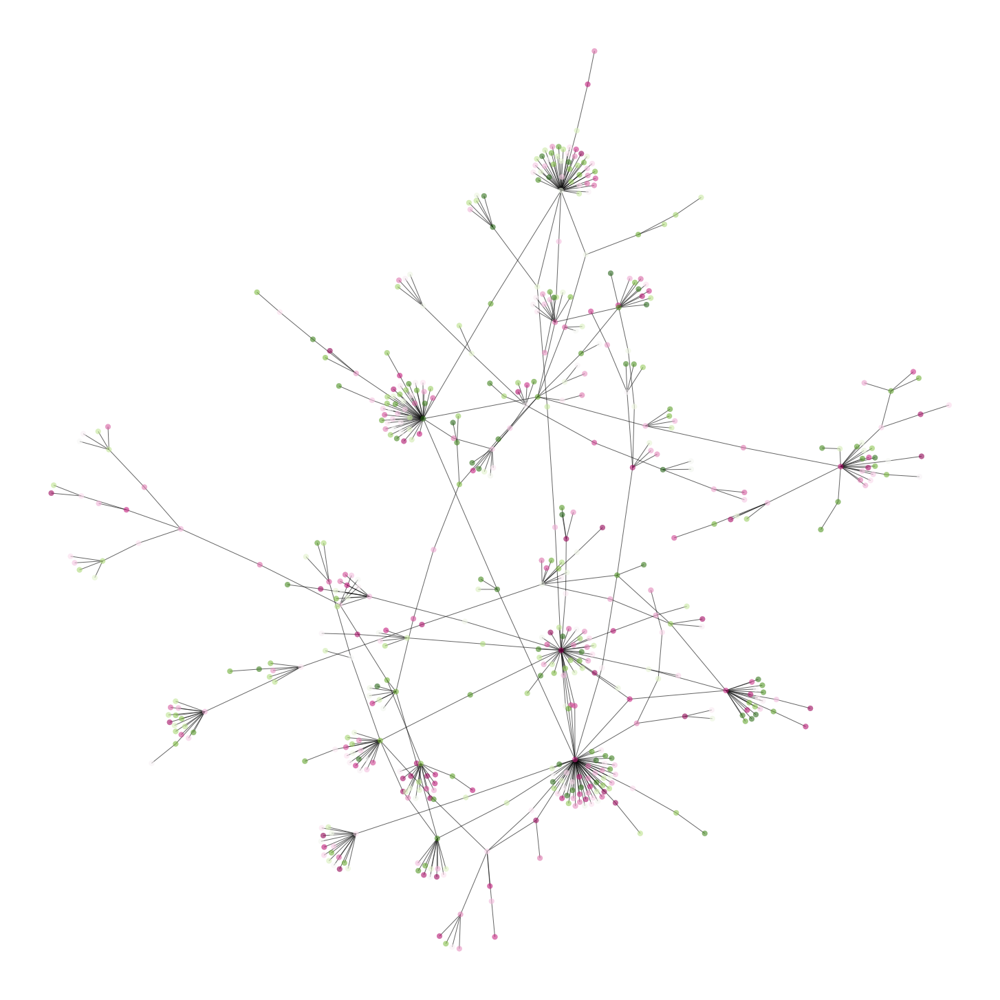

In [117]:
pos_all_reply_graph = nx.spring_layout(largest_subgraph_all_reply_graph, k=0.05)

plt.figure(figsize = (20,20))
nx.draw(largest_subgraph_all_reply_graph, pos=pos_all_reply_graph, node_color=range(548), cmap=plt.cm.PiYG, edge_color="black", linewidths=0.3, node_size=60, alpha=0.6, with_labels=False)

plt.savefig('allreplygraphfinal2.png')
plt.show()
#here's one that actually ran if you wanted to see what it should look like

In [119]:
#initialize graph (I made it directed)
all_retweet_graph = nx.DiGraph()

for index, tweet in tqdm(tweets_final.iterrows()):
    user, interactions = get_retweet_interactions(tweet)
    user_id, user_name = user
    tweet_id = tweet["id"]
    #interaction_type = tweet interaction type. May have to break it up into the three functions I defined we'll see
    #tweet_sent = tweet["sentiment"]
    for interaction in interactions:
        int_id, int_name = interaction
        all_retweet_graph.add_edge(user_id, int_id, tweet_id=tweet_id) #add interaction_type as an attribute
        

        all_retweet_graph.node[user_id]["name"] = user_name
        all_retweet_graph.node[int_id]["name"] = int_name
        if user_id in overall_sentiment:
            all_retweet_graph.node[user_id]["color"] = overall_sentiment[user_id]#individual tweeter
        if int_id in overall_sentiment:
            all_retweet_graph.node[int_id]["color"] = overall_sentiment[int_id] #reply/retweet/mention
            
#delete 'None'
all_retweet_graph.remove_node('None')
#remove isolates
isolate = list(nx.isolates(all_retweet_graph))
all_retweet_graph.remove_nodes_from(isolate)
        

#check general properties
print(f"Nodes: {all_retweet_graph.number_of_nodes()} Edges: {all_retweet_graph.number_of_edges()} ")
#interesting how there are more nodes than edges, which usually does not happen. Likely due to many tweets being isolated

all_retweet_degrees = [val for (node, val) in all_retweet_graph.degree()]

print(f"Maximum degree: {np.max(all_retweet_degrees)}")   
print(f"Minimum degree: {np.min(all_retweet_degrees)}")
# My suspicions are confirmed.

#since I made the graph directed, I will compute in and out degrees
all_retweet_in_degrees = [val for (node, val) in all_retweet_graph.in_degree()]
all_retweet_out_degrees = [val for (node, val) in all_retweet_graph.out_degree()]

print(f"Maximum in degree: {np.max(all_retweet_in_degrees)}")   
print(f"Minimum in degree: {np.min(all_retweet_in_degrees)}")
print(f"Maximum out degree: {np.max(all_retweet_out_degrees)}")   
print(f"Minimum out degree: {np.min(all_retweet_out_degrees)}")

# 6 out degrees is a ridiculous number unless the user has sent out multiple tweets tagging multiple people

print(f"The average degree of the nodes in the Graph is {np.mean(all_retweet_degrees):.1f}")  
print(f"The most frequent degree of the nodes found in the Graph is {stats.mode(all_retweet_degrees)[0][0]}")

print(f"The average in degree of the nodes in the Graph is {np.mean(all_retweet_in_degrees):.1f}")  
print(f"The most frequent in degree of the nodes found in the Graph is {stats.mode(all_retweet_in_degrees)[0][0]}")
print(f"The average out degree of the nodes in the Graph is {np.mean(all_retweet_out_degrees):.1f}")  
print(f"The most frequent out degree of the nodes found in the Graph is {stats.mode(all_retweet_out_degrees)[0][0]}")
# what surprises me is that the average in and out degrees are the same, but the average of all degrees in twice higher than their individual values.
# A highest frequency of 0 in degrees suggests that there are many users of low following that are not replied to, retweeted, or mentioned.
# The highest frequency of 1 out degree suggests that the majority of users only send singular, isolated, tweets that don't mention, reply to, or retweet 

# can build a histogram here

undirected_all_retweet_graph = nx.Graph(all_retweet_graph)
nx.is_connected(undirected_all_retweet_graph)
# graph is not connected

print(f"number of connected components: {nx.number_connected_components(undirected_all_retweet_graph)}")
# the large number of connected components suggest that each connected component is small, or even singular

largest_subgraph_all_retweet_graph = max(nx.connected_component_subgraphs(undirected_all_retweet_graph), key=len)
# directed graphs don't seem to work with these features, so I have to resort to the undirected version
# It doesn't seem like I can graph the directed graph either

print(f"There are {largest_subgraph_all_retweet_graph.number_of_nodes()} nodes and {largest_subgraph_all_retweet_graph.number_of_edges()} \
edges present in the largest component of the Graph")
#the number of nodes and edges are roughly equal. This means that each user in the giant connected component interact, on average, with one other user
# This can be interpreted as a user retweeting, replying to, or mentioning one other user only. (This was captured in 5 minutes so that makes sense)

nx.is_connected(largest_subgraph_all_retweet_graph)
# just making sure



247584it [01:31, 2693.77it/s]


Nodes: 62315 Edges: 62801 
Maximum degree: 11185
Minimum degree: 1
Maximum in degree: 11185
Minimum in degree: 0
Maximum out degree: 64
Minimum out degree: 0
The average degree of the nodes in the Graph is 2.0
The most frequent degree of the nodes found in the Graph is 1
The average in degree of the nodes in the Graph is 1.0
The most frequent in degree of the nodes found in the Graph is 0
The average out degree of the nodes in the Graph is 1.0
The most frequent out degree of the nodes found in the Graph is 1
number of connected components: 5667
There are 38064 nodes and 43559 edges present in the largest component of the Graph


True

In [120]:
cvals = nx.clustering(all_retweet_graph,random.sample(all_retweet_graph.nodes(),1000))
sum(list(cvals.values()))/len(list(cvals.values()))

# pos_all_retweet_graph = nx.spring_layout(largest_subgraph_all_retweet_graph, k=0.05)

# plt.figure(figsize = (20,20))
# nx.draw(largest_subgraph_all_retweet_graph, pos=pos_all_retweet_graph, node_color=range(2828), cmap=plt.cm.PiYG, edge_color="black", linewidths=0.3, node_size=60, alpha=0.6, with_labels=False)

# plt.savefig('allretweetgraphfinal.png')
# plt.show()


0.002597722315772749

In [121]:
#APL and diameter by sampling the GCC
PL = []
for i in tqdm(range(1000)):
    a = random.sample(largest_subgraph_all_retweet_graph.nodes(),1)[0]
    b = random.sample(largest_subgraph_all_retweet_graph.nodes(),1)[0]
    PL.append(nx.shortest_path_length(largest_subgraph_all_retweet_graph, source=a, target=b))

        
print("APL: ", sum(PL)/len(PL))
print("Diameter: ", max(PL))

100%|██████████| 1000/1000 [00:25<00:00, 39.14it/s]

APL:  8.9
Diameter:  26


In [122]:
#retweetss
cl = list(sorted(nx.connected_component_subgraphs(undirected_all_retweet_graph), key=len, reverse=True))
nodes = []
edges = []
for i in tqdm(range(len(cl)-1)):
    nodes.append(cl[i+1].number_of_nodes())
    edges.append(cl[i+1].number_of_edges())
print("average nodes in CC: ", sum(nodes)/len(nodes))
print("average edges in CC: ",sum(edges)/len(edges))

100%|██████████| 5666/5666 [00:00<00:00, 102538.89it/s]

average nodes in CC:  4.280091775503
average edges in CC:  3.384927638545711


In [ ]:
############################################################################################################

In [28]:
#initialize graph (I made it directed)
all_mention_graph = nx.DiGraph()

for index, tweet in tweets_final.iterrows():
    user, interactions = get_mention_interactions(tweet)
    user_id, user_name = user
    tweet_id = tweet["id"]
    #interaction_type = tweet interaction type. May have to break it up into the three functions I defined we'll see
    #tweet_sent = tweet["sentiment"]
    for interaction in interactions:
        int_id, int_name = interaction
        all_mention_graph.add_edge(user_id, int_id, tweet_id=tweet_id) #add interaction_type as an attricute
        

        all_mention_graph.node[user_id]["name"] = user_name
        all_mention_graph.node[int_id]["name"] = int_name
        if user_id in overall_sentiment:
            all_mention_graph.node[user_id]["color"] = overall_sentiment[user_id]#individual tweeter
        if int_id in overall_sentiment:
            all_mention_graph.node[int_id]["color"] = overall_sentiment[int_id] #reply/retweet/mention
#delete 'None'
all_mention_graph.remove_node('None')
#remove isolates
isolate = list(nx.isolates(all_mention_graph))
all_mention_graph.remove_nodes_from(isolate)

In [125]:
#check general properties
print(f"Nodes: {all_mention_graph.number_of_nodes()} Edges: {all_mention_graph.number_of_edges()} ")
#interesting how there are more nodes than edges, which usually does not happen. Likely due to many tweets being isolated

all_mention_degrees = [val for (node, val) in all_mention_graph.degree()]

print(f"Maximum degree: {np.max(all_mention_degrees)}")   
print(f"Minimum degree: {np.min(all_mention_degrees)}")
# My suspicions are confirmed.

#since I made the graph directed, I will compute in and out degrees
all_mention_in_degrees = [val for (node, val) in all_mention_graph.in_degree()]
all_mention_out_degrees = [val for (node, val) in all_mention_graph.out_degree()]

print(f"Maximum in degree: {np.max(all_mention_in_degrees)}")   
print(f"Minimum in degree: {np.min(all_mention_in_degrees)}")
print(f"Maximum out degree: {np.max(all_mention_out_degrees)}")   
print(f"Minimum out degree: {np.min(all_mention_out_degrees)}")

# 6 out degrees is a ridiculous number unless the user has sent out multiple tweets tagging multiple people

print(f"The average degree of the nodes in the Graph is {np.mean(all_mention_degrees):.1f}")  
print(f"The most frequent degree of the nodes found in the Graph is {stats.mode(all_mention_degrees)[0][0]}")

print(f"The average in degree of the nodes in the Graph is {np.mean(all_mention_in_degrees):.1f}")  
print(f"The most frequent in degree of the nodes found in the Graph is {stats.mode(all_mention_in_degrees)[0][0]}")
print(f"The average out degree of the nodes in the Graph is {np.mean(all_mention_out_degrees):.1f}")  
print(f"The most frequent out degree of the nodes found in the Graph is {stats.mode(all_mention_out_degrees)[0][0]}")
# what surprises me is that the average in and out degrees are the same, but the average of all degrees in twice higher than their individual values.
# A highest frequency of 0 in degrees suggests that there are many users of low following that are not replied to, retweeted, or mentioned.
# The highest frequency of 1 out degree suggests that the majority of users only send singular, isolated, tweets that don't mention, reply to, or retweet 

# can build a histogram here

undirected_all_mention_graph = nx.Graph(all_mention_graph)
nx.is_connected(undirected_all_mention_graph)
# graph is not connected

print(f"number of connected components: {nx.number_connected_components(undirected_all_mention_graph)}")
# the large number of connected components suggest that each connected component is small, or even singular

largest_subgraph_all_mention_graph = max(nx.connected_component_subgraphs(undirected_all_mention_graph), key=len)
# directed graphs don't seem to work with these features, so I have to resort to the undirected version
# It doesn't seem like I can graph the directed graph either

print(f"There are {largest_subgraph_all_mention_graph.number_of_nodes()} nodes and {largest_subgraph_all_mention_graph.number_of_edges()} \
edges present in the largest component of the Graph")
#the number of nodes and edges are roughly equal. This means that each user in the giant connected component interact, on average, with one other user
# This can be interpreted as a user retweeting, replying to, or mentioning one other user only. (This was captured in 5 minutes so that makes sense)

nx.is_connected(largest_subgraph_all_mention_graph)
# just making sure


# pos_all_mention_graph = nx.spring_layout(largest_subgraph_all_mention_graph, k=0.05)

# plt.figure(figsize = (20,20))
# nx.draw(largest_subgraph_all_mention_graph, pos=pos_all_mention_graph, node_color=range(2830), cmap=plt.cm.PiYG, edge_color="black", linewidths=0.3, node_size=60, alpha=0.6, with_labels=False)

# plt.savefig('allmentiongraphfinal.png')
# plt.show()


Nodes: 75562 Edges: 72017 
Maximum degree: 11185
Minimum degree: 1
Maximum in degree: 11185
Minimum in degree: 0
Maximum out degree: 64
Minimum out degree: 0
The average degree of the nodes in the Graph is 1.9
The most frequent degree of the nodes found in the Graph is 1
The average in degree of the nodes in the Graph is 1.0
The most frequent in degree of the nodes found in the Graph is 0
The average out degree of the nodes in the Graph is 1.0
The most frequent out degree of the nodes found in the Graph is 1
number of connected components: 10365
There are 40590 nodes and 46439 edges present in the largest component of the Graph


True

In [126]:
cvals = nx.clustering(all_mention_graph,random.sample(all_mention_graph.nodes(),1000))
sum(list(cvals.values()))/len(list(cvals.values()))

0.003684439792165537

In [127]:
#APL and diameter by sampling the GCC
PL = []
for i in tqdm(range(1000)):
    a = random.sample(largest_subgraph_all_mention_graph.nodes(),1)[0]
    b = random.sample(largest_subgraph_all_mention_graph.nodes(),1)[0]
    PL.append(nx.shortest_path_length(largest_subgraph_all_mention_graph, source=a, target=b))

        
print("APL: ", sum(PL)/len(PL))
print("Diameter: ", max(PL))

100%|██████████| 1000/1000 [00:23<00:00, 43.27it/s]

APL:  9.228
Diameter:  37


In [417]:
cl = list(sorted(nx.connected_component_subgraphs(undirected_all_mention_graph), key=len, reverse=True))
nodes = []
edges = []
for i in tqdm(range(len(cl)-1)):
    nodes.append(cl[i+1].number_of_nodes())
    edges.append(cl[i+1].number_of_edges())
print("average nodes in CC: ", sum(nodes)/len(nodes))
print("average edges in CC: ",sum(edges)/len(edges))

100%|██████████| 8469/8469 [00:00<00:00, 110138.57it/s]

average nodes in CC:  2.6699728421301216
average edges in CC:  1.6733970952887


In [54]:
all_mention_graph.edges()
#I see a lot of 'None' values; realized that I made an error in graph generation so I went back and fixed it

OutEdgeView([('399473642', '174443391'), ('4311906501', '857982677420568582'), ('1530354577', 'None'), ('137683642', '56304605'), ('56304605', 'None'), ('3191158316', '84696056'), ('1096330747160420352', '1095825244965621761'), ('941689937044410368', '18036907'), ('1165093932142907393', '2792282931'), ('1966940634', '60289128'), ('1270427536963534849', '20277941'), ('2807583090', '60289128'), ('3355313668', '174443391'), ('805615945964257280', '735583903902277632'), ('23126232', 'None'), ('1268499931075088384', 'None'), ('1000961577552494592', '1124456517074210816'), ('849324029588774912', 'None'), ('975868740498796545', 'None'), ('1190616832899571713', 'None'), ('1263449653703368706', '744986848435417088'), ('744986848435417088', '848465630'), ('744986848435417088', '1000716304234500102'), ('744986848435417088', '1245404836452958208'), ('744986848435417088', '816325228435410945'), ('744986848435417088', '780678084'), ('1229961368406593536', '2205364669'), ('1229961368406593536', '2991

In [49]:
#check why mentions graph is smaller than all_graph
missingedges= []
for i in tqdm(all_graph.edges(data=True)):
    if i not in all_mention_graph.edges(data=True):
        missingedges.append(i)

100%|██████████| 81238/81238 [00:03<00:00, 26405.82it/s]


In [51]:
for i in range(10):
    print(missingedges[i])

('399473642', '174443391', {'tweet_id': 1274173705548189697, 'int_type': 'mention'})
('4311906501', '857982677420568582', {'tweet_id': 1274173707766939650, 'int_type': 'mention'})
('137683642', '56304605', {'tweet_id': 1274173710052651008, 'int_type': 'retweet'})
('3191158316', '84696056', {'tweet_id': 1274173710736318465, 'int_type': 'retweet'})
('1096330747160420352', '1095825244965621761', {'tweet_id': 1274173714582499328, 'int_type': 'retweet'})
('941689937044410368', '18036907', {'tweet_id': 1274173715488673792, 'int_type': 'retweet'})
('1165093932142907393', '2792282931', {'tweet_id': 1274173719036989442, 'int_type': 'mention'})
('2792282931', '2792282931', {'tweet_id': 1274301057183580160, 'int_type': 'mention'})
('1966940634', '60289128', {'tweet_id': 1274173722551660545, 'int_type': 'retweet'})
('1270427536963534849', '20277941', {'tweet_id': 1274173722765729792, 'int_type': 'retweet'})


In [29]:
missingnodes = []
for i in tqdm(all_graph.nodes()):
    if i not in all_mention_graph.nodes():
        missingnodes.append(i)

100%|██████████| 83374/83374 [00:00<00:00, 270130.98it/s]


In [31]:
len(missingnodes)

7812

In [35]:
missingsource = [i[0] for i in missingedges]
missingtarget = [i[1] for i in missingedges]

In [36]:
missingtweets = []
for i in tqdm(userID):
    if str(i) in missingnodes:
        missingtweets.append(i)

100%|██████████| 247584/247584 [01:05<00:00, 3753.96it/s]


In [37]:
len(missingtweets)

2903

In [38]:
tweetindex = []
for n in tqdm(range(len(userID))):
    if userID[n] in missingtweets:
        tweetindex.append(n)

100%|██████████| 247584/247584 [03:33<00:00, 1160.28it/s]


In [40]:
tweetindex

[33,
 71,
 112,
 369,
 409,
 451,
 1455,
 1491,
 1528,
 1589,
 1628,
 1666,
 2119,
 2162,
 2205,
 2257,
 2301,
 2345,
 2612,
 2657,
 2702,
 2748,
 2794,
 2843,
 2890,
 2901,
 2911,
 2935,
 2946,
 2956,
 2980,
 2991,
 3001,
 3915,
 3931,
 3950,
 3966,
 3985,
 4001,
 4034,
 4082,
 4132,
 4320,
 4359,
 4400,
 4797,
 4841,
 4885,
 5211,
 5256,
 5301,
 5330,
 5372,
 5414,
 5698,
 5739,
 5780,
 5818,
 5859,
 5900,
 6096,
 6133,
 6170,
 6227,
 6268,
 6309,
 6842,
 6891,
 6940,
 6978,
 7024,
 7070,
 7523,
 7553,
 7594,
 7769,
 7805,
 7841,
 8012,
 8058,
 8104,
 9049,
 9093,
 9140,
 9347,
 9384,
 9388,
 9796,
 9833,
 9873,
 9890,
 9934,
 9982,
 10294,
 10329,
 10365,
 10563,
 10611,
 10660,
 10706,
 10749,
 10792,
 10916,
 10967,
 11018,
 11461,
 11463,
 11504,
 11506,
 11547,
 11549,
 11585,
 11617,
 11633,
 11665,
 11681,
 11713,
 11983,
 12030,
 12077,
 12583,
 12624,
 12665,
 12983,
 13026,
 13069,
 13106,
 13148,
 13190,
 13340,
 13381,
 13422,
 13504,
 13547,
 13590,
 13830,
 13873,
 1391

In [42]:
for i in tqdm(tweetindex):
    print(tweet[i])
#I'm not sure why these didn't get dumped into mentions?

 32%|███▏      | 921/2903 [00:00<00:00, 9183.91it/s]

Fact: With our current (inadequate) test &amp; trace capabilities, we have nearly no way to control the spread administ… https://t.co/uhs0hlmEX9
Fact: With our current (inadequate) test &amp; trace capabilities, we have nearly no way to control the spread administ… https://t.co/uhs0hlmEX9
Fact: With our current (inadequate) test &amp; trace capabilities, we have nearly no way to control the spread administ… https://t.co/uhs0hlmEX9
Max and I want to say our home is typically alcohol free and has been since "Quarantine" started...
Max and I want to say our home is typically alcohol free and has been since "Quarantine" started...
Max and I want to say our home is typically alcohol free and has been since "Quarantine" started...
RT @thoutiana: ㅤ

@𝐭𝐚𝐭𝐢𝐚𝐧𝐚𝐮𝐝𝐫𝐢𝐞 — Instagram Feed

”celebrating this quarantine period with a new air purifier to keep my room’s air super f…
RT @thoutiana: ㅤ

@𝐭𝐚𝐭𝐢𝐚𝐧𝐚𝐮𝐝𝐫𝐢𝐞 — Instagram Feed

”celebrating this quarantine period with a new air purifier to keep my roo

 56%|█████▌    | 1617/2903 [00:00<00:00, 3453.44it/s]


RT @devanandv: @IndembAbuDhabi
@cgidubai
@UAEembassyIndia
@GDRFADUBAI
@MoFAICUAE
@MoCA_GoI
@MEAIndia
Myself &amp; family are #UAEResidentStrand…
RT @devanandv: @IndembAbuDhabi
@cgidubai
@UAEembassyIndia
@GDRFADUBAI
@MoFAICUAE
@MoCA_GoI
@MEAIndia
Myself &amp; family are #UAEResidentStrand…
RT @devanandv: @IndembAbuDhabi
@cgidubai
@UAEembassyIndia
@GDRFADUBAI
@MoFAICUAE
@MoCA_GoI
@MEAIndia
Myself &amp; family are #UAEResidentStrand…
RT @devanandv: @IndembAbuDhabi
@cgidubai
@UAEembassyIndia
@GDRFADUBAI
@MoFAICUAE
@MoCA_GoI
@MEAIndia
Myself &amp; family are #UAEResidentStrand…
This thread is ending here. Thank you for giving participating company in Home Quarantine and helping me entertain… https://t.co/xkd1wR7sX7
This thread is ending here. Thank you for giving participating company in Home Quarantine and helping me entertain… https://t.co/xkd1wR7sX7
I don’t like taking photos of myself because I hate how I look, I’m too ugly 😣💦

Now I even more fat bc quarantine… https://t.co/ulCqe5LQm2

100%|██████████| 2903/2903 [00:00<00:00, 4097.69it/s]

Plea in Delhi HC Challenges L-G's Order of 5-Day Mandatory Quarantine for Asymptomatic COVID-19 Patients | Read ful… https://t.co/AfyGY5XMwm
When you spend half of your life in making a healthy routine and getting used to it and then this lockdown and quar… https://t.co/Xyr96lyybt
When you spend half of your life in making a healthy routine and getting used to it and then this lockdown and quar… https://t.co/Xyr96lyybt
When you spend half of your life in making a healthy routine and getting used to it and then this lockdown and quar… https://t.co/Xyr96lyybt
RT @xxxdarkstripper: Self Quarantine isn’t all that bad😌 https://t.co/EpKaIGD5nH
RT @xxxdarkstripper: Self Quarantine isn’t all that bad😌 https://t.co/EpKaIGD5nH
RT @xxxdarkstripper: Self Quarantine isn’t all that bad😌 https://t.co/EpKaIGD5nH
i was watching this episode on netflix during this early quarantine szn  &amp; sang along to the song altho idk who's s… https://t.co/Gs3lWdVHnB
i was watching this episode on netflix during th

In [44]:
for i in tqdm(tweetindex):
    print(tweets_final.iloc[[i]])

  1%|          | 24/2903 [00:00<00:26, 110.00it/s]

                  created_at                   id in_reply_to_screen_name  \
33 2020-06-20 02:54:32+00:00  1274173762309521410                ljl_geek   

   in_reply_to_status_id in_reply_to_user_id retweeted_id  \
33           1.27417e+18         2.89821e+09         None   

   retweeted_screen_name user_mentions_screen_name user_mentions_id  \
33                  None                      None             None   

                                                 text     user_id screen_name  \
33  Fact: With our current (inadequate) test &amp;...  2898210073    ljl_geek   

    followers_count  
33              635  
                  created_at                   id in_reply_to_screen_name  \
71 2020-06-20 02:54:32+00:00  1274173762309521410                ljl_geek   

   in_reply_to_status_id in_reply_to_user_id retweeted_id  \
71           1.27417e+18         2.89821e+09         None   

   retweeted_screen_name user_mentions_screen_name user_mentions_id  \
71                  Non

  1%|▏         | 39/2903 [00:00<00:33, 86.74it/s] 


                    created_at                   id in_reply_to_screen_name  \
2911 2020-06-20 03:01:29+00:00  1274175510407532554               craavelex   

     in_reply_to_status_id in_reply_to_user_id retweeted_id  \
2911           1.27411e+18         7.52335e+17         None   

     retweeted_screen_name user_mentions_screen_name user_mentions_id  \
2911                  None                      None             None   

                                               text             user_id  \
2911  So nb was gone tell me i mispelled quarantine  752335146552995840   

     screen_name  followers_count  
2911   craavelex             1713  
                    created_at                   id in_reply_to_screen_name  \
2935 2020-06-20 03:01:17+00:00  1274175462596587521             squishykeys   

     in_reply_to_status_id in_reply_to_user_id retweeted_id  \
2935           1.27418e+18         2.66308e+09         None   

     retweeted_screen_name user_mentions_screen_name user

  2%|▏         | 60/2903 [00:00<00:31, 91.00it/s]

                    created_at                   id in_reply_to_screen_name  \
4797 2020-06-20 03:06:06+00:00  1274176674532392961                    None   

     in_reply_to_status_id in_reply_to_user_id retweeted_id  \
4797                  None                None         None   

     retweeted_screen_name user_mentions_screen_name user_mentions_id  \
4797                  None                      None             None   

                                                   text     user_id  \
4797  already dreading the “how was your quarantine?...  2257936122   

     screen_name  followers_count  
4797  chstntmare             1116  
                    created_at                   id in_reply_to_screen_name  \
4841 2020-06-20 03:06:06+00:00  1274176674532392961                    None   

     in_reply_to_status_id in_reply_to_user_id retweeted_id  \
4841                  None                None         None   

     retweeted_screen_name user_mentions_screen_name user_mentions

  3%|▎         | 84/2903 [00:00<00:27, 101.76it/s]


                    created_at                   id in_reply_to_screen_name  \
6842 2020-06-20 03:11:26+00:00  1274178016839634945              chstntmare   

     in_reply_to_status_id in_reply_to_user_id retweeted_id  \
6842           1.27418e+18         2.25794e+09         None   

     retweeted_screen_name user_mentions_screen_name user_mentions_id  \
6842                  None                      None             None   

                                                   text     user_id  \
6842  sidenote, imagine being told six months ago th...  2257936122   

     screen_name  followers_count  
6842  chstntmare             1116  
                    created_at                   id in_reply_to_screen_name  \
6891 2020-06-20 03:11:26+00:00  1274178016839634945              chstntmare   

     in_reply_to_status_id in_reply_to_user_id retweeted_id  \
6891           1.27418e+18         2.25794e+09         None   

     retweeted_screen_name user_mentions_screen_name user_mention

  4%|▎         | 108/2903 [00:01<00:27, 100.60it/s]

                    created_at                   id in_reply_to_screen_name  \
9982 2020-06-20 03:19:03+00:00  1274179931803537408                    None   

     in_reply_to_status_id in_reply_to_user_id        retweeted_id  \
9982                  None                None  994468822173143040   

     retweeted_screen_name user_mentions_screen_name    user_mentions_id  \
9982              Ayden_x2                  Ayden_x2  994468822173143040   

                                                   text             user_id  \
9982  RT @Ayden_x2: Current system, but instead of t...  994468822173143040   

     screen_name  followers_count  
9982    Ayden_x2              341  
                     created_at                   id in_reply_to_screen_name  \
10294 2020-06-20 03:19:57+00:00  1274180156970528771                 sIypxnk   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
10294           1.27418e+18         1.49334e+09         None   

      retweeted_screen_nam

  4%|▍         | 129/2903 [00:01<00:30, 91.04it/s] 

                     created_at                   id in_reply_to_screen_name  \
11633 2020-06-20 03:23:24+00:00  1274181027485769728                    None   

      in_reply_to_status_id in_reply_to_user_id        retweeted_id  \
11633                  None                None  835677955338575873   

      retweeted_screen_name user_mentions_screen_name    user_mentions_id  \
11633            PINKBLlNKS                PINKBLlNKS  835677955338575873   

                                                    text             user_id  \
11633  RT @PINKBLlNKS: people got so mfing ugly durin...  835677955338575873   

      screen_name  followers_count  
11633  PINKBLlNKS              571  
                     created_at                   id in_reply_to_screen_name  \
11665 2020-06-20 03:23:37+00:00  1274181080107581441             KilluaKatkJ   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
11665           1.27418e+18         1.19695e+18         None   

      retweeted_

  5%|▌         | 148/2903 [00:01<00:33, 83.47it/s]


                     created_at                   id in_reply_to_screen_name  \
13830 2020-06-20 03:28:55+00:00  1274182416505221120                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
13830                  None                None         None   

      retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
13830                  None                 AlfaazThe  1262329179984605186   

                                                    text              user_id  \
13830  Like or share \nFollow @AlfaazThe\n.\n.\n.\n.•...  1262329179984605186   

      screen_name  followers_count  
13830   AlfaazThe               96  
                     created_at                   id in_reply_to_screen_name  \
13873 2020-06-20 03:28:55+00:00  1274182416505221120                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
13873                  None                None         None   

      retweeted_screen_na

  6%|▌         | 170/2903 [00:01<00:29, 93.13it/s]

                     created_at                   id in_reply_to_screen_name  \
14641 2020-06-20 03:31:42+00:00  1274183115917996032                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
14641                  None                None  1095541940161003521   

      retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
14641        bearpuddingnyc            bearpuddingnyc  1095541940161003521   

                                                    text              user_id  \
14641  RT @bearpuddingnyc: Join my FREE #Onlyfans dur...  1095541940161003521   

          screen_name  followers_count  
14641  bearpuddingnyc              464  
                     created_at                   id in_reply_to_screen_name  \
14667 2020-06-20 03:31:38+00:00  1274183100377919488                DrameTV2   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
14667           1.27418e+18         3.08471e+09         None   

  

  7%|▋         | 193/2903 [00:01<00:26, 102.03it/s]

                     created_at                   id in_reply_to_screen_name  \
15887 2020-06-20 03:36:18+00:00  1274184273533308934                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
15887                  None                None   2433771443   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
15887           YueliangYue               YueliangYue       2433771443   

                                                    text     user_id  \
15887  RT @YueliangYue: Graphic Composition for the s...  2433771443   

       screen_name  followers_count  
15887  YueliangYue              348  
                     created_at                   id in_reply_to_screen_name  \
15903 2020-06-20 03:36:27+00:00  1274184309247586305            delightsummm   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
15903           1.27418e+18         8.13276e+17         None   

      retweeted_screen_name user_mentions_screen_n

  7%|▋         | 214/2903 [00:02<00:30, 89.26it/s] 


                     created_at                   id in_reply_to_screen_name  \
17585 2020-06-20 03:42:30+00:00  1274185835202646016             father_kiwi   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
17585           1.27419e+18         9.83506e+17         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
17585                  None                      None             None   

                                                    text             user_id  \
17585  Also because quarantine will never be over til...  983505795693318144   

       screen_name  followers_count  
17585  father_kiwi               11  
                     created_at                   id in_reply_to_screen_name  \
17610 2020-06-20 03:42:42+00:00  1274185883961327616                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
17610                  None                None   1948678717   

      retweeted_screen_name user_

  8%|▊         | 238/2903 [00:02<00:29, 89.79it/s]

                     created_at                   id in_reply_to_screen_name  \
18237 2020-06-20 03:45:21+00:00  1274186549517844482          allieiswriting   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
18237           1.27419e+18         2.37722e+09         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
18237                  None                      None             None   

                                                    text     user_id  \
18237  Romance while watching raindrops fall on a win...  2377215482   

          screen_name  followers_count  
18237  allieiswriting             1015  
                     created_at                   id in_reply_to_screen_name  \
18282 2020-06-20 03:45:21+00:00  1274186549517844482          allieiswriting   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
18282           1.27419e+18         2.37722e+09         None   

      retweeted_screen_name user_mentions_sc

  9%|▊         | 248/2903 [00:02<00:32, 81.57it/s]

                     created_at                   id in_reply_to_screen_name  \
19525 2020-06-20 03:50:19+00:00  1274187798405435392          d33presonances   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
19525           1.27419e+18         1.26655e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
19525                  None                      None             None   

                                                    text              user_id  \
19525  Quarantine got everyone mad bored the fact tha...  1266547675329110019   

          screen_name  followers_count  
19525  d33presonances               65  
                     created_at                   id in_reply_to_screen_name  \
19745 2020-06-20 03:51:20+00:00  1274188056988389382                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
19745                  None                None  1243402637451481090   

      retw

  9%|▉         | 267/2903 [00:02<00:30, 85.59it/s]


                     created_at                   id in_reply_to_screen_name  \
20867 2020-06-20 03:55:44+00:00  1274189163919749120                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
20867                  None                None         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
20867                  None                      None             None   

                                                    text    user_id  \
20867  My sister went to the beach with her friends a...  273047282   

          screen_name  followers_count  
20867  ThewizardofPOS              692  
                     created_at                   id in_reply_to_screen_name  \
20868 2020-06-20 03:55:44+00:00  1274189164708233216          ThewizardofPOS   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
20868           1.27419e+18         2.73047e+08         None   

      retweeted_screen_name user_mentions_scr

 10%|▉         | 289/2903 [00:03<00:27, 93.70it/s]


                     created_at                   id in_reply_to_screen_name  \
22415 2020-06-20 04:01:52+00:00  1274190706358259717                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
22415                  None                None   2553777750   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
22415          JaredPereida              JaredPereida       2553777750   

                                                    text     user_id  \
22415  RT @JaredPereida: For your quarantine entertai...  2553777750   

        screen_name  followers_count  
22415  JaredPereida              418  
                     created_at                   id in_reply_to_screen_name  \
22417 2020-06-20 04:01:53+00:00  1274190709445328896         Pandoraspocksa1   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
22417           1.27419e+18          1.0869e+18         None   

      retweeted_screen_name user_mentions_scree

 11%|█         | 314/2903 [00:03<00:24, 105.29it/s]


                     created_at                   id in_reply_to_screen_name  \
24179 2020-06-20 04:08:53+00:00  1274192473435373569         coffeedaisybaby   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
24179           1.27419e+18         1.23164e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
24179                  None                      None             None   

                                                    text              user_id  \
24179  Just loving the idea of post-college Reddie go...  1231639769228206081   

           screen_name  followers_count  
24179  coffeedaisybaby               50  
                     created_at                   id in_reply_to_screen_name  \
24208 2020-06-20 04:08:46+00:00  1274192442191949824                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
24208                  None                None  1049913301398953984   

      r

 12%|█▏        | 336/2903 [00:03<00:24, 104.99it/s]

                     created_at                   id in_reply_to_screen_name  \
25805 2020-06-20 04:14:26+00:00  1274193871304417283            itsbanananas   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
25805           1.27419e+18         5.40504e+08         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
25805                  None                      None             None   

                                                    text    user_id  \
25805  91: We’ve been moots for some time (can’t real...  540504375   

        screen_name  followers_count  
25805  itsbanananas             1610  
                     created_at                   id in_reply_to_screen_name  \
25849 2020-06-20 04:14:26+00:00  1274193871304417283            itsbanananas   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
25849           1.27419e+18         5.40504e+08         None   

      retweeted_screen_name user_mentions_screen_n

 12%|█▏        | 347/2903 [00:03<00:24, 104.17it/s]


                     created_at                   id in_reply_to_screen_name  \
26574 2020-06-20 04:16:55+00:00  1274194494292926465               linacgioo   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
26574           1.27382e+18         2.61641e+09         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
26574                  None                      None             None   

                                                    text     user_id  \
26574  Quarantine, ninety five. \nBefore anything I j...  2616407226   

      screen_name  followers_count  
26574   linacgioo              248  
                     created_at                   id in_reply_to_screen_name  \
26604 2020-06-20 04:17:06+00:00  1274194540883296259          jaunaefreeman_   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
26604           1.27419e+18         1.27331e+18         None   

      retweeted_screen_name user_mentions_screen_na

 13%|█▎        | 367/2903 [00:03<00:32, 77.42it/s] 


                     created_at                   id in_reply_to_screen_name  \
27438 2020-06-20 04:20:17+00:00  1274195340204392448                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
27438                  None                None     55927532   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
27438            4everJames                4everJames         55927532   

                                                    text   user_id  \
27438  RT @4everJames: QUARANTINE &amp; CHILL VOL. 2 ...  55927532   

      screen_name  followers_count  
27438  4everJames             8482  
                     created_at                   id in_reply_to_screen_name  \
27479 2020-06-20 04:20:17+00:00  1274195340204392448                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
27479                  None                None     55927532   

      retweeted_screen_name user_mentions_screen_name u

 13%|█▎        | 389/2903 [00:04<00:28, 89.51it/s]


                     created_at                   id in_reply_to_screen_name  \
28394 2020-06-20 04:24:01+00:00  1274196280416190464           azimercadejas   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
28394            1.2742e+18         3.23669e+09         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
28394                  None                      None             None   

                                                    text     user_id  \
28394  this quarantine made me so unproductive,  i sp...  3236685300   

         screen_name  followers_count  
28394  azimercadejas             1364  
                     created_at                   id in_reply_to_screen_name  \
28432 2020-06-20 04:24:01+00:00  1274196280416190464           azimercadejas   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
28432            1.2742e+18         3.23669e+09         None   

      retweeted_screen_name user_mentions_scr

 14%|█▍        | 412/2903 [00:04<00:26, 94.99it/s]


                     created_at                   id in_reply_to_screen_name  \
30832 2020-06-20 04:32:59+00:00  1274198535622230023           ceciliaaleigh   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
30832            1.2742e+18          1.0904e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
30832                  None                      None             None   

                text              user_id    screen_name  followers_count  
30832  In quarantine  1090399752716500993  ceciliaaleigh              615  
                     created_at                   id in_reply_to_screen_name  \
30855 2020-06-20 04:33:09+00:00  1274198579515584513                 gg_renz   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
30855            1.2742e+18         1.88234e+08         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
30855                  None                 

 15%|█▌        | 436/2903 [00:04<00:23, 104.24it/s]


                     created_at                   id in_reply_to_screen_name  \
31956 2020-06-20 04:37:17+00:00  1274199620483051522                  tfny_l   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
31956            1.2742e+18         1.21483e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
31956                  None                      None             None   

                                                    text              user_id  \
31956  where was that energy when a bunch of white pe...  1214834961695379456   

      screen_name  followers_count  
31956      tfny_l               13  
                     created_at                   id in_reply_to_screen_name  \
32132 2020-06-20 04:37:56+00:00  1274199783641698304         JourdanAldredge   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
32132            1.2742e+18         2.36961e+09         None   

      retweeted_screen_name user_

 16%|█▌        | 459/2903 [00:04<00:24, 101.58it/s]


                     created_at                   id in_reply_to_screen_name  \
33545 2020-06-20 04:43:03+00:00  1274201069367648257                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
33545                  None                None    176178299   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
33545            subhamsunu                subhamsunu        176178299   

                                                    text    user_id  \
33545  RT @subhamsunu: @CollectorJspur sir please hel...  176178299   

      screen_name  followers_count  
33545  subhamsunu              117  
                     created_at                   id in_reply_to_screen_name  \
33557 2020-06-20 04:43:09+00:00  1274201097461043200                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
33557                  None                None         None   

      retweeted_screen_name user_mentions_screen_name

 17%|█▋        | 481/2903 [00:05<00:24, 98.63it/s] 

                     created_at                   id in_reply_to_screen_name  \
34899 2020-06-20 04:47:44+00:00  1274202248818524162                 xputris   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
34899            1.2742e+18         8.19497e+17         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
34899                  None                      None             None   

                                                    text             user_id  \
34899  quarantine membuatku mengurung diri di kamar 😂...  819496919755960320   

      screen_name  followers_count  
34899     xputris               25  
                     created_at                   id in_reply_to_screen_name  \
34946 2020-06-20 04:48:00+00:00  1274202316254650368                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
34946                  None                None   3055711364   

      retweeted_screen_name user_men

 17%|█▋        | 501/2903 [00:05<00:25, 94.63it/s]


                     created_at                   id in_reply_to_screen_name  \
37432 2020-06-20 04:56:59+00:00  1274204575583440896                 aneeshp   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
37432           1.27402e+18         1.61708e+07         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
37432                  None                      None             None   

                                                    text   user_id  \
37432  Maharashtra govermment advised the cruise line...  16170765   

      screen_name  followers_count  
37432     aneeshp             2098  
                     created_at                   id in_reply_to_screen_name  \
37458 2020-06-20 04:57:11+00:00  1274204628784082949            angelinanoah   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
37458            1.2742e+18         1.97236e+08         None   

      retweeted_screen_name user_mentions_screen_name u

 18%|█▊        | 523/2903 [00:05<00:23, 100.04it/s]


                     created_at                   id in_reply_to_screen_name  \
39258 2020-06-20 05:03:40+00:00  1274206259374223364                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
39258                  None                None  1061747958671003649   

      retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
39258              xyjksyba                  xyjksyba  1061747958671003649   

                                                    text              user_id  \
39258  RT @xyjksyba: ano naipon mo ngayong quarantine...  1061747958671003649   

      screen_name  followers_count  
39258    xyjksyba              827  
                     created_at                   id in_reply_to_screen_name  \
39438 2020-06-20 05:04:23+00:00  1274206441591668736              friday_dev   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
39438           1.26698e+18         1.09478e+18         None   

      ret

 19%|█▉        | 546/2903 [00:05<00:22, 106.99it/s]


                     created_at                   id in_reply_to_screen_name  \
42238 2020-06-20 05:13:56+00:00  1274208843988299778                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
42238                  None                None         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
42238                  None                      None             None   

                                                    text     user_id  \
42238  We Still Can Celebrate Vesak Under the Lockdow...  3435119892   

      screen_name  followers_count  
42238  vasana_fai              255  
                     created_at                   id in_reply_to_screen_name  \
42248 2020-06-20 05:14:01+00:00  1274208863802150912                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
42248                  None                None   3435119892   

      retweeted_screen_name user_mentions_screen_na

 20%|█▉        | 571/2903 [00:05<00:21, 110.34it/s]


                     created_at                   id in_reply_to_screen_name  \
44255 2020-06-20 05:21:02+00:00  1274210630900146176                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
44255                  None                None         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
44255                  None                      None             None   

                                                    text              user_id  \
44255  ques ; - whats  the most  wildest   thing  u’ ...  1134065764892196864   

      screen_name  followers_count  
44255   koofaerie              928  
                     created_at                   id in_reply_to_screen_name  \
44369 2020-06-20 05:21:35+00:00  1274210766342647808                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
44369                  None                None         None   

      retweeted_screen_name user_

 21%|██        | 596/2903 [00:06<00:20, 112.55it/s]


                     created_at                   id in_reply_to_screen_name  \
45432 2020-06-20 05:25:06+00:00  1274211654016708614          serendipkristy   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
45432           1.27421e+18         7.09528e+17         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
45432                  None                      None             None   

                                                    text             user_id  \
45432  LOOK AT ALL THE DAMN AUS IVE READ (plus the on...  709527685379166208   

          screen_name  followers_count  
45432  serendipkristy              321  
                     created_at                   id in_reply_to_screen_name  \
45464 2020-06-20 05:25:06+00:00  1274211654016708614          serendipkristy   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
45464           1.27421e+18         7.09528e+17         None   

      retweeted_screen_name

 21%|██▏       | 622/2903 [00:06<00:19, 118.33it/s]


                     created_at                   id in_reply_to_screen_name  \
47576 2020-06-20 05:32:41+00:00  1274213563452678145            ZoraToniMaya   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
47576           1.27421e+18         1.50245e+07         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
47576                  None                      None             None   

                                                    text   user_id  \
47576  Thank God for the 17 candles I bought during q...  15024454   

        screen_name  followers_count  
47576  ZoraToniMaya             1940  
                     created_at                   id in_reply_to_screen_name  \
47586 2020-06-20 05:32:41+00:00  1274213563452678145            ZoraToniMaya   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
47586           1.27421e+18         1.50245e+07         None   

      retweeted_screen_name user_mentions_screen_na

 22%|██▏       | 646/2903 [00:06<00:19, 113.01it/s]


                     created_at                   id in_reply_to_screen_name  \
49620 2020-06-20 05:39:35+00:00  1274215296186884097               mmithvol6   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
49620           1.27421e+18         8.94268e+17         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
49620                  None                      None             None   

                                                    text             user_id  \
49620  his ig posts were fucking weird before quarant...  894268335592005632   

      screen_name  followers_count  
49620   mmithvol6              515  
                     created_at                   id in_reply_to_screen_name  \
49640 2020-06-20 05:39:34+00:00  1274215292751798273             jes8965priv   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
49640           1.27421e+18         8.11734e+17         None   

      retweeted_screen_name user_me

 23%|██▎       | 670/2903 [00:06<00:19, 112.72it/s]


                     created_at                   id in_reply_to_screen_name  \
51354 2020-06-20 05:45:01+00:00  1274216666138841088                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
51354                  None                None         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
51354                  None                      None             None   

                                             text              user_id  \
51354  niall we’re in quarantine go back to bed 😤  1273298660739051522   

        screen_name  followers_count  
51354  fuckniallerr              649  
                     created_at                   id in_reply_to_screen_name  \
51378 2020-06-20 05:44:58+00:00  1274216650884222976                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
51378                  None                None  1102037035546759168   

      retweeted_screen_name

 24%|██▍       | 694/2903 [00:06<00:19, 110.66it/s]


                     created_at                   id in_reply_to_screen_name  \
53363 2020-06-20 05:51:23+00:00  1274218267524071424         shidicreampie69   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
53363           1.27422e+18         1.24804e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
53363                  None                      None             None   

                                                    text              user_id  \
53363  +"quarantine doesn't work! people are sufferin...  1248044305480134661   

           screen_name  followers_count  
53363  shidicreampie69              181  
                     created_at                   id in_reply_to_screen_name  \
53366 2020-06-20 05:51:23+00:00  1274218269029937153         shidicreampie69   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
53366           1.27422e+18         1.24804e+18         None   

      retweeted_screen_

 25%|██▍       | 718/2903 [00:07<00:20, 106.52it/s]

                     created_at                   id in_reply_to_screen_name  \
55282 2020-06-20 05:57:58+00:00  1274219925263904773                 Donno79   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
55282           1.27422e+18         6.00634e+07         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
55282                  None                      None             None   

                                                    text   user_id  \
55282  That means all Essendon players and staff woul...  60063443   

      screen_name  followers_count  
55282     Donno79              611  
                     created_at                   id in_reply_to_screen_name  \
55308 2020-06-20 05:58:07+00:00  1274219960651448320               ecumenika   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
55308           1.27419e+18         3.89385e+08         None   

      retweeted_screen_name user_mentions_screen_name us

 26%|██▌       | 743/2903 [00:07<00:19, 111.19it/s]

                     created_at                   id in_reply_to_screen_name  \
56967 2020-06-20 06:03:22+00:00  1274221282163216384            COOLHANDLUKE   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
56967           1.27422e+18         1.72672e+07         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
56967                  None                      None             None   

                                                    text   user_id  \
56967  But the tides are rising. Resistance is very m...  17267233   

        screen_name  followers_count  
56967  COOLHANDLUKE             1578  
                     created_at                   id in_reply_to_screen_name  \
57001 2020-06-20 06:03:39+00:00  1274221352782708736                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
57001                  None                None   4855679640   

      retweeted_screen_name user_mentions_screen_nam

 26%|██▋       | 767/2903 [00:07<00:19, 109.11it/s]


                     created_at                   id in_reply_to_screen_name  \
59104 2020-06-20 06:10:24+00:00  1274223052155498497                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
59104                  None                None  1270352307977433088   

      retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
59104          tee___valley              tee___valley  1270352307977433088   

                                                    text              user_id  \
59104  RT @tee___valley: I found this #Interesting vi...  1270352307977433088   

        screen_name  followers_count  
59104  tee___valley                2  
                     created_at                   id in_reply_to_screen_name  \
59404 2020-06-20 06:11:38+00:00  1274223363536240640            OtterHouse_5   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
59404           1.27422e+18         3.79893e+08         None   

     

 27%|██▋       | 795/2903 [00:07<00:17, 120.80it/s]


                     created_at                   id in_reply_to_screen_name  \
60683 2020-06-20 06:15:58+00:00  1274224455296757761                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
60683                  None                None  1270262066989817856   

      retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
60683       Pandaffordables           Pandaffordables  1270262066989817856   

                                                    text              user_id  \
60683  RT @Pandaffordables: Sino gustong kumita while...  1270262066989817856   

           screen_name  followers_count  
60683  Pandaffordables              647  
                     created_at                   id in_reply_to_screen_name  \
60730 2020-06-20 06:16:18+00:00  1274224537727496193                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
60730                  None                None         None   


 28%|██▊       | 821/2903 [00:08<00:17, 119.66it/s]


                     created_at                   id in_reply_to_screen_name  \
62812 2020-06-20 06:23:34+00:00  1274226368775983104         summerdepressio   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
62812           1.27423e+18         5.96113e+08         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
62812                  None                      None             None   

                                                    text    user_id  \
62812  cant believe this quarantine shit really affec...  596112717   

           screen_name  followers_count  
62812  summerdepressio              160  
                     created_at                   id in_reply_to_screen_name  \
62835 2020-06-20 06:23:46+00:00  1274226418818392065                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
62835                  None                None    348763237   

      retweeted_screen_name user_mentions_s

 29%|██▉       | 847/2903 [00:08<00:18, 113.48it/s]


                     created_at                   id in_reply_to_screen_name  \
65619 2020-06-20 06:34:15+00:00  1274229053793460225           SokoConnectKe   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
65619           1.27423e+18         1.22571e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
65619                  None                      None             None   

                                                    text              user_id  \
65619  Ensure the patient is well hydrated, rested, a...  1225712136099434496   

         screen_name  followers_count  
65619  SokoConnectKe              280  
                     created_at                   id in_reply_to_screen_name  \
65640 2020-06-20 06:34:08+00:00  1274229024932261891                  ds1apf   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
65640           1.27423e+18         4.67992e+07         None   

      retweeted_screen_name

 30%|███       | 872/2903 [00:08<00:17, 116.03it/s]


                     created_at                   id in_reply_to_screen_name  \
68660 2020-06-20 06:44:43+00:00  1274231687723933696             MsGraceGrey   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
68660           1.23537e+18         1.06586e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
68660                  None                      None             None   

                                                    text              user_id  \
68660  Initially, from the beginning of quarantine. N...  1065862622510166016   

       screen_name  followers_count  
68660  MsGraceGrey            15965  
                     created_at                   id in_reply_to_screen_name  \
68667 2020-06-20 06:44:46+00:00  1274231700038574082                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
68667                  None                None  1102037035546759168   

      retweeted

 31%|███       | 899/2903 [00:08<00:16, 122.79it/s]


                     created_at                   id in_reply_to_screen_name  \
70944 2020-06-20 06:53:49+00:00  1274233979214929922             haisha_art_   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
70944           1.27423e+18         1.19844e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
70944                  None                      None             None   

                                                    text              user_id  \
70944  the two of us haven't been anywhere since quar...  1198439448947675137   

       screen_name  followers_count  
70944  haisha_art_              156  
                     created_at                   id in_reply_to_screen_name  \
70965 2020-06-20 06:53:41+00:00  1274233946746863618                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
70965                  None                None  1102037035546759168   

      retweeted

 32%|███▏      | 926/2903 [00:08<00:16, 121.83it/s]


                     created_at                   id in_reply_to_screen_name  \
72693 2020-06-20 07:00:00+00:00  1274235535545032705                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
72693                  None                None         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
72693                  None                      None             None   

                                                    text   user_id  \
72693  LOCKDOWN DIARIES: DAY 96\n\n2020-06-20 00:00 -...  30934646   

         screen_name  followers_count  
72693  rogue_analyst             1399  
                     created_at                   id in_reply_to_screen_name  \
72695 2020-06-20 07:00:00+00:00  1274235536601952257                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
72695                  None                None         None   

      retweeted_screen_name user_mentions_screen_

 33%|███▎      | 953/2903 [00:09<00:16, 121.31it/s]


                     created_at                   id in_reply_to_screen_name  \
74611 2020-06-20 07:06:35+00:00  1274237192085188611                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
74611                  None                None         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
74611                  None                      None             None   

                                                    text              user_id  \
74611  Pandemic quarantine solo project\nWatching tan...  1267607292498685952   

       screen_name  followers_count  
74611  FireIsBorn3               45  
                     created_at                   id in_reply_to_screen_name  \
74629 2020-06-20 07:06:35+00:00  1274237192085188611                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
74629                  None                None         None   

      retweeted_screen_name use

 34%|███▎      | 979/2903 [00:09<00:17, 111.16it/s]


                     created_at                   id in_reply_to_screen_name  \
76646 2020-06-20 07:13:53+00:00  1274239031489056768                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
76646                  None                None     18402562   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
76646             djallyBEA                 djallyBEA         18402562   

                                                    text   user_id  \
76646  RT @djallyBEA: I talked about a few things I l...  18402562   

      screen_name  followers_count  
76646   djallyBEA             1970  
                     created_at                   id in_reply_to_screen_name  \
76668 2020-06-20 07:13:53+00:00  1274239031489056768                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
76668                  None                None     18402562   

      retweeted_screen_name user_mentions_screen_name u

 35%|███▍      | 1002/2903 [00:09<00:18, 102.11it/s]


                     created_at                   id in_reply_to_screen_name  \
77549 2020-06-20 07:17:11+00:00  1274239861512232961              abejitadri   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
77549           1.27424e+18         1.25285e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
77549                  None                      None             None   

                                                    text              user_id  \
77549  babies are so perfect everything about them is...  1252853703096143875   

      screen_name  followers_count  
77549  abejitadri               20  
                     created_at                   id in_reply_to_screen_name  \
77682 2020-06-20 07:17:45+00:00  1274240003267129344                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
77682                  None                None  1273998697022423040   

      retweeted_s

 35%|███▍      | 1013/2903 [00:09<00:19, 96.64it/s] 


                     created_at                   id in_reply_to_screen_name  \
79662 2020-06-20 07:25:10+00:00  1274241870382555136         acousticcandy96   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
79662           1.27419e+18           1.664e+09         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
79662                  None                      None             None   

                                                    text     user_id  \
79662  Seriously though as soon as this quarantine bu...  1664002219   

           screen_name  followers_count  
79662  acousticcandy96              311  
                     created_at                   id in_reply_to_screen_name  \
79685 2020-06-20 07:25:10+00:00  1274241870382555136         acousticcandy96   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
79685           1.27419e+18           1.664e+09         None   

      retweeted_screen_name user_mentions

 36%|███▌      | 1034/2903 [00:09<00:19, 94.88it/s]


                     created_at                   id in_reply_to_screen_name  \
82020 2020-06-20 07:33:47+00:00  1274244036937707522               MYLILMELI   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
82020           1.27424e+18         2.56734e+09         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
82020                  None                      None             None   

                                                    text     user_id  \
82020  She was ashamed of it. Ok. Why didn’t she go i...  2567339966   

      screen_name  followers_count  
82020   MYLILMELI              598  
                     created_at                   id in_reply_to_screen_name  \
82201 2020-06-20 07:34:29+00:00  1274244213459296256         fl0wercr0wnkian   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
82201           1.27424e+18          1.8529e+09         None   

      retweeted_screen_name user_mentions_screen_na

 36%|███▋      | 1054/2903 [00:10<00:19, 94.17it/s]


                     created_at                   id in_reply_to_screen_name  \
83729 2020-06-20 07:39:34+00:00  1274245493342629888                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
83729                  None                None         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
83729                  None                      None             None   

                                                    text  user_id screen_name  \
83729  This is smart. Test at the airport, with resul...  1413771     bytebot   

       followers_count  
83729             5031  
                     created_at                   id in_reply_to_screen_name  \
83773 2020-06-20 07:39:34+00:00  1274245493342629888                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
83773                  None                None         None   

      retweeted_screen_name user_mentions_screen_name use

 37%|███▋      | 1066/2903 [00:10<00:18, 99.63it/s]


                     created_at                   id in_reply_to_screen_name  \
86210 2020-06-20 07:48:58+00:00  1274247859433402368               GitaRajen   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
86210           1.27425e+18         1.27424e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
86210                  None                      None             None   

                                                    text              user_id  \
86210  I am ready to do quarantine in Madurai. Please...  1274242822657331202   

      screen_name  followers_count  
86210   GitaRajen                0  
                     created_at                   id in_reply_to_screen_name  \
86235 2020-06-20 07:48:58+00:00  1274247859433402368               GitaRajen   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
86235           1.27425e+18         1.27424e+18         None   

      retweeted_screen_name user_

 37%|███▋      | 1086/2903 [00:10<00:24, 74.06it/s]

                     created_at                   id in_reply_to_screen_name  \
86512 2020-06-20 07:49:59+00:00  1274248113897631744                 yakii97   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
86512           1.27315e+18         2.05968e+08         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
86512                  None                      None             None   

                                                    text    user_id  \
86512  QUARANTINE DIARY\n\nDays 94-96\n\nI know we ai...  205968287   

      screen_name  followers_count  
86512     yakii97             1212  
                     created_at                   id in_reply_to_screen_name  \
86537 2020-06-20 07:50:10+00:00  1274248160672485376         SoumyaK88907539   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
86537           1.27425e+18         1.23518e+18         None   

      retweeted_screen_name user_mentions_screen_name 

 38%|███▊      | 1109/2903 [00:10<00:21, 83.43it/s]


                     created_at                   id in_reply_to_screen_name  \
88437 2020-06-20 07:57:25+00:00  1274249986579009537                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
88437                  None                None    853305248   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
88437            matiasdesu                matiasdesu        853305248   

                                                    text    user_id  \
88437  RT @matiasdesu: Beautiful artist making beauti...  853305248   

      screen_name  followers_count  
88437  matiasdesu             3593  
                     created_at                   id in_reply_to_screen_name  \
88600 2020-06-20 07:58:01+00:00  1274250134042193920                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
88600                  None                None  1100704198537236480   

      retweeted_screen_name user_ment

 39%|███▉      | 1134/2903 [00:11<00:18, 96.37it/s]


                     created_at                   id in_reply_to_screen_name  \
90358 2020-06-20 08:05:02+00:00  1274251901966548993                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
90358                  None                None    296366239   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
90358             devanandv                 devanandv        296366239   

                                                    text    user_id  \
90358  RT @devanandv: @IndembAbuDhabi\n@cgidubai\n@UA...  296366239   

      screen_name  followers_count  
90358   devanandv              123  
                     created_at                   id in_reply_to_screen_name  \
90379 2020-06-20 08:05:08+00:00  1274251928470302727                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
90379                  None                None    296366239   

      retweeted_screen_name user_mentions_screen_name

 40%|███▉      | 1159/2903 [00:11<00:16, 105.97it/s]


                     created_at                   id in_reply_to_screen_name  \
92700 2020-06-20 08:13:41+00:00  1274254079330594818          abricotapricot   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
92700           1.27425e+18         1.24017e+18         None   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
92700                  None                      None             None   

                                                    text              user_id  \
92700  Just because I’m related to someone doesn’t me...  1240170442511527937   

          screen_name  followers_count  
92700  abricotapricot              426  
                     created_at                   id in_reply_to_screen_name  \
93040 2020-06-20 08:14:51+00:00  1274254370318757888              RadarRayne   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
93040           1.27425e+18         1.13076e+18         None   

      retweeted_screen_na

 41%|████      | 1187/2903 [00:11<00:14, 115.24it/s]


                     created_at                   id in_reply_to_screen_name  \
96507 2020-06-20 08:27:26+00:00  1274257539190763521                    None   

      in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
96507                  None                None  1235180349300150273   

      retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
96507       SoumyaK88907539           SoumyaK88907539  1235180349300150273   

                                                    text              user_id  \
96507  RT @SoumyaK88907539: And also the judges of su...  1235180349300150273   

           screen_name  followers_count  
96507  SoumyaK88907539               17  
                     created_at                   id in_reply_to_screen_name  \
96517 2020-06-20 08:27:29+00:00  1274257552558047232                staennis   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
96517           1.27426e+18         9.22555e+08         None   


 42%|████▏     | 1212/2903 [00:11<00:14, 115.50it/s]


                     created_at                   id in_reply_to_screen_name  \
99046 2020-06-20 08:33:49+00:00  1274259146293088256                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
99046                  None                None     87771181   

      retweeted_screen_name user_mentions_screen_name user_mentions_id  \
99046                ppjkis                    ppjkis         87771181   

                                                    text   user_id  \
99046  RT @ppjkis: Coronavirus: Quarantine rules for ...  87771181   

      screen_name  followers_count  
99046      ppjkis              103  
                     created_at                   id in_reply_to_screen_name  \
99316 2020-06-20 08:34:39+00:00  1274259353814609923                    None   

      in_reply_to_status_id in_reply_to_user_id retweeted_id  \
99316                  None                None     89204031   

      retweeted_screen_name user_mentions_screen_name u

 43%|████▎     | 1236/2903 [00:11<00:15, 107.86it/s]


                      created_at                   id in_reply_to_screen_name  \
100842 2020-06-20 08:37:11+00:00  1274259994129526785              jhnfy_mnts   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
100842           1.27404e+18         1.04045e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
100842                  None                      None             None   

                                                     text  \
100842  March9- nag start mawalan ng pasok\nMarch12- l...   

                    user_id screen_name  followers_count  
100842  1040449656562434049  jhnfy_mnts              109  
                      created_at                   id in_reply_to_screen_name  \
101285 2020-06-20 08:38:16+00:00  1274260266348396544               ellowatee   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
101285           1.26422e+18         9.92679e+17         None   

       retweeted_sc

 43%|████▎     | 1262/2903 [00:12<00:15, 104.56it/s]


                      created_at                   id in_reply_to_screen_name  \
103908 2020-06-20 08:42:40+00:00  1274261371572695046                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
103908                  None                None         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
103908                  None                      None             None   

                                                     text  \
103908  Hanap mo ba ay NETFLIX PREMIUM ngayong quarant...   

                    user_id     screen_name  followers_count  
103908  1273998697022423040  charlesnetflix                2  
                      created_at                   id in_reply_to_screen_name  \
103910 2020-06-20 08:42:41+00:00  1274261375917981703                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
103910                  None                None         None   

       retw

 44%|████▍     | 1288/2903 [00:12<00:14, 114.15it/s]


                      created_at                   id in_reply_to_screen_name  \
106368 2020-06-20 08:47:37+00:00  1274262620158091264                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
106368                  None                None    328506852   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
106368       AmitbhadauriaCG           AmitbhadauriaCG        328506852   

                                                     text    user_id  \
106368  RT @AmitbhadauriaCG: Jannayak, true patriot, o...  328506852   

            screen_name  followers_count  
106368  AmitbhadauriaCG             1466  
                      created_at                   id in_reply_to_screen_name  \
106385 2020-06-20 08:47:37+00:00  1274262620158091264                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
106385                  None                None    328506852   

       retweeted_screen_name 

 45%|████▌     | 1315/2903 [00:12<00:14, 108.96it/s]


                      created_at                   id in_reply_to_screen_name  \
109856 2020-06-20 08:56:41+00:00  1274264899934273536               NotTasnyx   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
109856           1.27426e+18         1.23546e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
109856                  None                      None             None   

                                                     text  \
109856  feels like i've been writing this forever just...   

                    user_id screen_name  followers_count  
109856  1235462444824199168   NotTasnyx              237  
                      created_at                   id in_reply_to_screen_name  \
110138 2020-06-20 08:57:38+00:00  1274265140867678210         SantoshReddyVK1   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
110138           1.27426e+18         1.13364e+18         None   

       retweeted_sc

 46%|████▌     | 1327/2903 [00:12<00:16, 94.35it/s] 

                      created_at                   id in_reply_to_screen_name  \
112894 2020-06-20 09:05:08+00:00  1274267026744205314                    None   

       in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
112894                  None                None  1177183549880815616   

       retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
112894         Bichromestain             Bichromestain  1177183549880815616   

                                                     text  \
112894  RT @Bichromestain: Happy weekend walaupun self...   

                    user_id    screen_name  followers_count  
112894  1177183549880815616  Bichromestain              286  
                      created_at                   id in_reply_to_screen_name  \
112936 2020-06-20 09:05:08+00:00  1274267026744205314                    None   

       in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
112936                  None                None

 46%|████▋     | 1348/2903 [00:13<00:16, 94.96it/s]

                      created_at                   id in_reply_to_screen_name  \
114350 2020-06-20 09:08:42+00:00  1274267924354588672                 mergays   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
114350           1.27427e+18         3.24608e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
114350                  None                      None             None   

                                                     text     user_id  \
114350  But there’s a lot of needless vitriol from peo...  3246075828   

       screen_name  followers_count  
114350     mergays              190  
                      created_at                   id in_reply_to_screen_name  \
114354 2020-06-20 09:08:45+00:00  1274267938564923392         Mistress_Katya_   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
114354           1.27427e+18         8.25864e+17         None   

       retweeted_screen_name user_ment

 47%|████▋     | 1374/2903 [00:13<00:14, 108.60it/s]


                      created_at                   id in_reply_to_screen_name  \
119773 2020-06-20 09:24:55+00:00  1274272003034198016                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
119773                  None                None         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
119773                  None                      None             None   

                                                     text    user_id  \
119773  Our test result came negative it's been 5 days...  186420451   

       screen_name  followers_count  
119773   pra13veen                8  
                      created_at                   id in_reply_to_screen_name  \
119812 2020-06-20 09:24:55+00:00  1274272003034198016                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
119812                  None                None         None   

       retweeted_screen_name user_menti

 48%|████▊     | 1401/2903 [00:13<00:12, 118.52it/s]


                      created_at                   id in_reply_to_screen_name  \
121373 2020-06-20 09:29:20+00:00  1274273116655476736                 bodie57   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
121373           1.27417e+18         2.50361e+07         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
121373                  None                      None             None   

                                                     text   user_id  \
121373  Without covid-19 testing, how was Crozier supp...  25036133   

       screen_name  followers_count  
121373     bodie57               49  
                      created_at                   id in_reply_to_screen_name  \
121392 2020-06-20 09:29:30+00:00  1274273157806002176                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
121392                  None                None         None   

       retweeted_screen_name user_mention

 49%|████▉     | 1427/2903 [00:13<00:12, 120.35it/s]


                      created_at                   id in_reply_to_screen_name  \
122504 2020-06-20 09:32:35+00:00  1274273932955148289                Gautaamm   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
122504           1.27427e+18         1.17645e+08         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
122504                  None                      None             None   

                                                     text    user_id  \
122504  The Russian Premier League was schedule to reo...  117644657   

       screen_name  followers_count  
122504    Gautaamm              791  
                      created_at                   id in_reply_to_screen_name  \
122541 2020-06-20 09:32:35+00:00  1274273932955148289                Gautaamm   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
122541           1.27427e+18         1.17645e+08         None   

       retweeted_screen_name user_menti

 50%|█████     | 1453/2903 [00:13<00:12, 111.97it/s]


                      created_at                   id in_reply_to_screen_name  \
125201 2020-06-20 09:39:59+00:00  1274275797453471745                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
125201                  None                None         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
125201                  None                      None             None   

                                                     text  \
125201  Quarantine workout's are always failed😣 https:...   

                    user_id screen_name  followers_count  
125201  1057396107846672384  shaneeiram              221  
                      created_at                   id in_reply_to_screen_name  \
125239 2020-06-20 09:39:59+00:00  1274275797453471745                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
125239                  None                None         None   

       retweeted_sc

 51%|█████     | 1476/2903 [00:14<00:14, 100.43it/s]

                      created_at                   id in_reply_to_screen_name  \
127346 2020-06-20 09:46:13+00:00  1274277364684386305                hourhome   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
127346           1.27428e+18         1.18965e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
127346                  None                      None             None   

                                                     text  \
127346  Actually. My breast got bigger since I’ve been...   

                    user_id screen_name  followers_count  
127346  1189654627802730497    hourhome              280  
                      created_at                   id in_reply_to_screen_name  \
127387 2020-06-20 09:46:13+00:00  1274277364684386305                hourhome   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
127387           1.27428e+18         1.18965e+18         None   

       retweeted_scr

 52%|█████▏    | 1498/2903 [00:14<00:14, 95.09it/s] 

                      created_at                   id in_reply_to_screen_name  \
129138 2020-06-20 09:51:21+00:00  1274278659264671749                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
129138                  None                None     35593005   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
129138                SOMACS                    SOMACS         35593005   

                                                     text   user_id  \
129138  RT @SOMACS: This was always a possibility... w...  35593005   

       screen_name  followers_count  
129138      SOMACS              131  
                      created_at                   id in_reply_to_screen_name  \
129183 2020-06-20 09:51:21+00:00  1274278659264671749                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
129183                  None                None     35593005   

       retweeted_screen_name user_mentions

 52%|█████▏    | 1521/2903 [00:14<00:14, 96.31it/s] 


                      created_at                   id in_reply_to_screen_name  \
132999 2020-06-20 10:01:11+00:00  1274281130439536640                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
132999                  None                None         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
132999                  None                      None             None   

                                                     text             user_id  \
132999  As a Chief Minister, Kejriwal have not good &a...  733570838193012736   

       screen_name  followers_count  
132999    NKSR2016              132  
                      created_at                   id in_reply_to_screen_name  \
133030 2020-06-20 10:01:11+00:00  1274281130439536640                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
133030                  None                None         None   

       retweeted_scre

 53%|█████▎    | 1543/2903 [00:14<00:13, 98.36it/s]


                      created_at                   id in_reply_to_screen_name  \
134689 2020-06-20 10:05:33+00:00  1274282230278500353          crlamriedybrvo   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
134689           1.27428e+18         1.13107e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
134689                  None                      None             None   

                                                     text  \
134689  sobrang kumapit ung faith ko kay God this quar...   

                    user_id     screen_name  followers_count  
134689  1131074318295715840  crlamriedybrvo               32  
                      created_at                   id in_reply_to_screen_name  \
134691 2020-06-20 10:05:34+00:00  1274282233642332165           AidenWrightLS   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
134691           1.27428e+18         1.02198e+18         None   

       retw

 54%|█████▍    | 1563/2903 [00:15<00:14, 94.15it/s]


                      created_at                   id in_reply_to_screen_name  \
136117 2020-06-20 10:09:17+00:00  1274283171870175232             elviscute23   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
136117           1.27428e+18         7.50904e+08         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
136117                  None                      None             None   

                                                     text    user_id  \
136117  at hanggang ngayon kahit quarantine eh ramdam ...  750903565   

        screen_name  followers_count  
136117  elviscute23              128  
                      created_at                   id in_reply_to_screen_name  \
136155 2020-06-20 10:09:17+00:00  1274283171870175232             elviscute23   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
136155           1.27428e+18         7.50904e+08         None   

       retweeted_screen_name user_men

 55%|█████▍    | 1583/2903 [00:15<00:14, 90.17it/s]

                      created_at                   id in_reply_to_screen_name  \
136982 2020-06-20 10:11:22+00:00  1274283693557690374         harrietnineteen   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
136982           1.27427e+18         1.75587e+08         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
136982                  None                      None             None   

                                                     text    user_id  \
136982  may suggestion na for the next book in quarant...  175587116   

            screen_name  followers_count  
136982  harrietnineteen              513  
                      created_at                   id in_reply_to_screen_name  \
137021 2020-06-20 10:11:22+00:00  1274283693557690374         harrietnineteen   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
137021           1.27427e+18         1.75587e+08         None   

       retweeted_screen_name u

 55%|█████▌    | 1604/2903 [00:15<00:14, 91.41it/s]


                      created_at                   id in_reply_to_screen_name  \
138534 2020-06-20 10:15:54+00:00  1274284837407297537          crlamriedybrvo   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
138534           1.27428e+18         1.13107e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
138534                  None                      None             None   

                                       text              user_id  \
138534  this quarantine changed my mindset.  1131074318295715840   

           screen_name  followers_count  
138534  crlamriedybrvo               32  
                      created_at                   id in_reply_to_screen_name  \
138546 2020-06-20 10:16:02+00:00  1274284869842018304                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
138546                  None                None   1043178840   

       retweeted_screen_name user_menti

 56%|█████▌    | 1625/2903 [00:15<00:13, 96.38it/s]


                      created_at                   id in_reply_to_screen_name  \
140115 2020-06-20 10:20:16+00:00  1274285933395767296               yoloshite   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
140115           1.27428e+18         2.80119e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
140115                  None                      None             None   

                                                     text     user_id  \
140115  Need laser focus on solving COVID crisis most ...  2801187490   

       screen_name  followers_count  
140115   yoloshite               14  
                      created_at                   id in_reply_to_screen_name  \
140158 2020-06-20 10:20:16+00:00  1274285933395767296               yoloshite   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
140158           1.27428e+18         2.80119e+09         None   

       retweeted_screen_name user_men

 57%|█████▋    | 1648/2903 [00:15<00:12, 96.91it/s] 

                      created_at                   id in_reply_to_screen_name  \
143219 2020-06-20 10:28:02+00:00  1274287889824616448         ACupOfBrightWin   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
143219           1.27429e+18         1.25708e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
143219                  None                      None             None   

                                                     text  \
143219  ++ Ive watched major clips for ep1 and 2 soooo...   

                    user_id      screen_name  followers_count  
143219  1257077527354327040  ACupOfBrightWin               34  
                      created_at                   id in_reply_to_screen_name  \
143223 2020-06-20 10:28:02+00:00  1274287889824616448         ACupOfBrightWin   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
143223           1.27429e+18         1.25708e+18         None   

       ret

 58%|█████▊    | 1672/2903 [00:16<00:12, 101.51it/s]

                      created_at                   id in_reply_to_screen_name  \
145118 2020-06-20 10:32:33+00:00  1274289027571580929          pancakecleaner   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
145118           1.27429e+18         7.59664e+17         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
145118                  None                      None             None   

                                                     text             user_id  \
145118  school was out the day quarantine began i did ...  759664491185352704   

           screen_name  followers_count  
145118  pancakecleaner               16  
                      created_at                   id in_reply_to_screen_name  \
145151 2020-06-20 10:32:31+00:00  1274289015265456134               pastichhe   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
145151           1.27429e+18          1.2739e+18         None   

       retweet

 58%|█████▊    | 1698/2903 [00:16<00:11, 108.98it/s]


                      created_at                   id in_reply_to_screen_name  \
146552 2020-06-20 10:36:34+00:00  1274290035010015238               1_2_3_WTF   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
146552           1.27429e+18         9.21287e+17         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
146552                  None                      None             None   

                                                     text             user_id  \
146552  (Quarantine Day 93 / Film 139) https://t.co/hh...  921287196153434114   

       screen_name  followers_count  
146552   1_2_3_WTF              517  
                      created_at                   id in_reply_to_screen_name  \
146576 2020-06-20 10:36:42+00:00  1274290071886159877                lattejhs   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
146576           1.27429e+18         4.27674e+09         None   

       retweeted_scre

 59%|█████▉    | 1724/2903 [00:16<00:10, 112.93it/s]

                      created_at                   id in_reply_to_screen_name  \
148333 2020-06-20 10:41:41+00:00  1274291323525165056             shvycsntxxx   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
148333           1.27429e+18         3.64682e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
148333                  None                      None             None   

                                                     text     user_id  \
148333  ambot uy magkasinabot gyud mi basta bulak2 ang...  3646823900   

        screen_name  followers_count  
148333  shvycsntxxx             1319  
                      created_at                   id in_reply_to_screen_name  \
148357 2020-06-20 10:41:41+00:00  1274291323525165056             shvycsntxxx   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
148357           1.27429e+18         3.64682e+09         None   

       retweeted_screen_name user_me

 60%|██████    | 1749/2903 [00:16<00:09, 115.87it/s]


                      created_at                   id in_reply_to_screen_name  \
150838 2020-06-20 10:48:19+00:00  1274292991574720513           UNCpantograph   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
150838           1.27429e+18         8.07125e+17         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
150838                  None                      None             None   

                                                     text             user_id  \
150838  The new patient was a 47-year-old male from Ba...  807125114462486528   

          screen_name  followers_count  
150838  UNCpantograph              598  
                      created_at                   id in_reply_to_screen_name  \
150860 2020-06-20 10:48:19+00:00  1274292991574720513           UNCpantograph   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
150860           1.27429e+18         8.07125e+17         None   

       retweete

 61%|██████    | 1774/2903 [00:17<00:09, 118.28it/s]


                      created_at                   id in_reply_to_screen_name  \
153894 2020-06-20 10:56:56+00:00  1274295162378661889                    None   

       in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
153894                  None                None  1253397732242288641   

       retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
153894         FantasySensPH             FantasySensPH  1253397732242288641   

                                                     text  \
153894  RT @FantasySensPH: 2 types of mood pag ako nag...   

                    user_id    screen_name  followers_count  
153894  1253397732242288641  FantasySensPH             4318  
                      created_at                   id in_reply_to_screen_name  \
153940 2020-06-20 10:56:56+00:00  1274295162378661889                    None   

       in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
153940                  None                Non

 62%|██████▏   | 1799/2903 [00:17<00:09, 116.64it/s]


                      created_at                   id in_reply_to_screen_name  \
155970 2020-06-20 11:02:49+00:00  1274296644280791051         _unculturedmilk   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
155970            1.2743e+18         1.01439e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
155970                  None                      None             None   

                                                     text  \
155970  umalis sa pagiging average/mediocre lang pero ...   

                    user_id      screen_name  followers_count  
155970  1014387923729301505  _unculturedmilk               90  
                      created_at                   id in_reply_to_screen_name  \
156008 2020-06-20 11:02:49+00:00  1274296644280791051         _unculturedmilk   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
156008            1.2743e+18         1.01439e+18         None   

       re

 63%|██████▎   | 1824/2903 [00:17<00:09, 116.25it/s]


                      created_at                   id in_reply_to_screen_name  \
157821 2020-06-20 11:07:31+00:00  1274297826000769024         _aylennnnnnnnnn   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
157821            1.2743e+18         1.08118e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
157821                  None                      None             None   

                                                     text  \
157821  char wala pala akong boi in my life since quar...   

                    user_id      screen_name  followers_count  
157821  1081176071112777728  _aylennnnnnnnnn               76  
                      created_at                   id in_reply_to_screen_name  \
157832 2020-06-20 11:07:31+00:00  1274297826000769024         _aylennnnnnnnnn   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
157832            1.2743e+18         1.08118e+18         None   

       re

 64%|██████▎   | 1850/2903 [00:17<00:08, 120.47it/s]


                      created_at                   id in_reply_to_screen_name  \
158830 2020-06-20 11:10:03+00:00  1274298463690383360          TTremendous350   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
158830            1.2743e+18         1.05757e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
158830                  None                      None             None   

                                                     text  \
158830  Post Quarantine PR Update\n\n155x10 squat - be...   

                    user_id     screen_name  followers_count  
158830  1057567905477476352  TTremendous350             1790  
                      created_at                   id in_reply_to_screen_name  \
158870 2020-06-20 11:10:19+00:00  1274298528504745985         forlife_chogiwa   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
158870            1.2743e+18         3.19429e+09         None   

       retw

 65%|██████▍   | 1876/2903 [00:17<00:08, 124.15it/s]


                      created_at                   id in_reply_to_screen_name  \
162516 2020-06-20 11:19:13+00:00  1274300770360479745                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
162516                  None                None     41401964   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
162516               magarya                   magarya         41401964   

                                                     text   user_id  \
162516  RT @magarya: &amp; the State #COVID19 team led...  41401964   

       screen_name  followers_count  
162516     magarya             3987  
                      created_at                   id in_reply_to_screen_name  \
162871 2020-06-20 11:20:33+00:00  1274301103367020546         Shubhan21204760   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
162871            1.2743e+18         1.17719e+18         None   

       retweeted_screen_name user_mention

 66%|██████▌   | 1904/2903 [00:18<00:07, 129.82it/s]


                      created_at                   id in_reply_to_screen_name  \
165478 2020-06-20 11:27:08+00:00  1274302762432385026          himalayan_mail   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
165478            1.2743e+18          3.6277e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
165478                  None                      None             None   

                                                     text     user_id  \
165478  Chief Minister said if home isolation ends in ...  3627700213   

           screen_name  followers_count  
165478  himalayan_mail             2341  
                      created_at                   id in_reply_to_screen_name  \
166585 2020-06-20 11:29:26+00:00  1274303340663279616                 HBDT_15   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
166585            1.2743e+18           1.263e+18         None   

       retweeted_screen_name 

 67%|██████▋   | 1931/2903 [00:18<00:08, 121.49it/s]


                      created_at                   id in_reply_to_screen_name  \
168670 2020-06-20 11:35:14+00:00  1274304801090744325          NadaFathiSayed   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
168670            1.2743e+18         9.62242e+08         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
168670                  None                      None             None   

                                                     text    user_id  \
168670  Instagram, it's like this whole quarantine loc...  962241901   

           screen_name  followers_count  
168670  NadaFathiSayed              423  
                      created_at                   id in_reply_to_screen_name  \
168679 2020-06-20 11:35:14+00:00  1274304801090744325          NadaFathiSayed   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
168679            1.2743e+18         9.62242e+08         None   

       retweeted_screen_name us

 67%|██████▋   | 1958/2903 [00:18<00:07, 123.78it/s]


                      created_at                   id in_reply_to_screen_name  \
170159 2020-06-20 11:39:37+00:00  1274305905321021445               pero_Diaz   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
170159           1.27431e+18          3.3383e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
170159                  None                      None             None   

                           text     user_id screen_name  followers_count  
170159  that's quarantine, baby  3338297818   pero_Diaz              100  
                      created_at                   id in_reply_to_screen_name  \
170183 2020-06-20 11:39:50+00:00  1274305958894694400                    None   

       in_reply_to_status_id in_reply_to_user_id        retweeted_id  \
170183                  None                None  952047887805923328   

       retweeted_screen_name user_mentions_screen_name    user_mentions_id  \
170183            

 68%|██████▊   | 1985/2903 [00:18<00:07, 124.15it/s]


                      created_at                   id in_reply_to_screen_name  \
171593 2020-06-20 11:43:31+00:00  1274306885798072323                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
171593                  None                None         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
171593                  None                      None             None   

                                                     text  \
171593  #Delhi | A plea has been moved in #DelhiHighCo...   

                    user_id    screen_name  followers_count  
171593  1113747196099399680  thefirstindia             5419  
                      created_at                   id in_reply_to_screen_name  \
171595 2020-06-20 11:43:32+00:00  1274306889312948230         DreamRe44898438   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
171595           1.27431e+18         1.27425e+18         None   

       retwee

 69%|██████▉   | 2012/2903 [00:18<00:07, 123.26it/s]


                      created_at                   id in_reply_to_screen_name  \
172943 2020-06-20 11:46:53+00:00  1274307730132668417           NocturneGames   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
172943           1.27431e+18         1.58019e+08         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
172943                  None                      None             None   

                                                     text    user_id  \
172943  I won't post more, but how deep does this rabb...  158019464   

          screen_name  followers_count  
172943  NocturneGames             5556  
                      created_at                   id in_reply_to_screen_name  \
173158 2020-06-20 11:47:28+00:00  1274307877725847557             JanDeanJade   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
173158           1.27395e+18         1.17502e+18         None   

       retweeted_screen_name user

 70%|███████   | 2038/2903 [00:19<00:07, 122.83it/s]


                      created_at                   id in_reply_to_screen_name  \
174719 2020-06-20 11:51:33+00:00  1274308907083526146                kagechim   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
174719            1.2743e+18         8.42665e+17         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
174719                  None                      None             None   

                                                     text             user_id  \
174719  #69 hi uh cute acc LMAO long time havent seen ...  842664646049898496   

       screen_name  followers_count  
174719    kagechim              803  
                      created_at                   id in_reply_to_screen_name  \
174754 2020-06-20 11:51:33+00:00  1274308907083526146                kagechim   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
174754            1.2743e+18         8.42665e+17         None   

       retweeted_scre

 71%|███████   | 2065/2903 [00:19<00:06, 123.55it/s]


                      created_at                   id in_reply_to_screen_name  \
177283 2020-06-20 11:58:36+00:00  1274310678761725954                    None   

       in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
177283                  None                None  1135773808785145857   

       retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
177283        Vikram63409840            Vikram63409840  1135773808785145857   

                                                     text  \
177283  RT @Vikram63409840: @airindiain when will phas...   

                    user_id     screen_name  followers_count  
177283  1135773808785145857  Vikram63409840                0  
                      created_at                   id in_reply_to_screen_name  \
177308 2020-06-20 11:58:36+00:00  1274310678761725954                    None   

       in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
177308                  None                N

 72%|███████▏  | 2091/2903 [00:19<00:06, 123.62it/s]


                      created_at                   id in_reply_to_screen_name  \
180624 2020-06-20 12:04:43+00:00  1274312220839559168                wonpinks   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
180624           1.27431e+18         1.00724e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
180624                  None                      None             None   

                                                     text  \
180624  for me, i think this is the best one I've done...   

                    user_id screen_name  followers_count  
180624  1007241655970222080    wonpinks             1016  
                      created_at                   id in_reply_to_screen_name  \
180654 2020-06-20 12:04:43+00:00  1274312220839559168                wonpinks   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
180654           1.27431e+18         1.00724e+18         None   

       retweeted_sc

 73%|███████▎  | 2118/2903 [00:19<00:06, 123.46it/s]


                      created_at                   id in_reply_to_screen_name  \
183127 2020-06-20 12:11:17+00:00  1274313871709229057                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
183127                  None                None         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
183127                  None                      None             None   

                                                     text  \
183127  With Chennai brought under complete lockdown f...   

                    user_id    screen_name  followers_count  
183127  1113747196099399680  thefirstindia             5419  
                      created_at                   id in_reply_to_screen_name  \
183141 2020-06-20 12:11:23+00:00  1274313899303632896              UKFreeNews   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
183141           1.27431e+18         2.38989e+08         None   

       retwee

 74%|███████▍  | 2144/2903 [00:20<00:06, 117.85it/s]


                      created_at                   id in_reply_to_screen_name  \
186158 2020-06-20 12:18:14+00:00  1274315622176845834                    None   

       in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
186158                  None                None  1183597096189882369   

       retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
186158            jemmieleee                jemmieleee  1183597096189882369   

                                                     text  \
186158  RT @jemmieleee: guys what that short way every...   

                    user_id screen_name  followers_count  
186158  1183597096189882369  jemmieleee               31  
                      created_at                   id in_reply_to_screen_name  \
186162 2020-06-20 12:18:15+00:00  1274315626266402822                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
186162                  None                None         None

 75%|███████▍  | 2168/2903 [00:20<00:06, 112.95it/s]


                      created_at                   id in_reply_to_screen_name  \
187185 2020-06-20 12:20:30+00:00  1274316191759077377                    None   

       in_reply_to_status_id in_reply_to_user_id        retweeted_id  \
187185                  None                None  857936728165896204   

       retweeted_screen_name user_mentions_screen_name    user_mentions_id  \
187185          Joni_Looking              Joni_Looking  857936728165896204   

                                                     text             user_id  \
187185  RT @Joni_Looking: ATTENTION \n\nWell Said,  \n...  857936728165896204   

         screen_name  followers_count  
187185  Joni_Looking             5145  
                      created_at                   id in_reply_to_screen_name  \
187196 2020-06-20 12:20:34+00:00  1274316209664724992              n_antatico   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
187196           1.27432e+18         5.60304e+08         None  

 76%|███████▌  | 2193/2903 [00:20<00:06, 101.87it/s]

                      created_at                   id in_reply_to_screen_name  \
188005 2020-06-20 12:22:17+00:00  1274316640365223936               aubrigato   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
188005           1.27432e+18         1.22398e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
188005                  None                      None             None   

                                                     text  \
188005  not a day goes by that i do not think of the f...   

                    user_id screen_name  followers_count  
188005  1223982074626965504   aubrigato               33  
                      created_at                   id in_reply_to_screen_name  \
188009 2020-06-20 12:22:19+00:00  1274316647377952768           MishalQuiring   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
188009           1.27432e+18         8.58957e+17         None   

       retweeted_scr

 76%|███████▋  | 2217/2903 [00:20<00:06, 109.60it/s]


                      created_at                   id in_reply_to_screen_name  \
189329 2020-06-20 12:25:13+00:00  1274317380512968706              skynzarzou   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
189329           1.27432e+18         1.27098e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
189329                  None                      None             None   

                                text              user_id screen_name  \
189329  cr : https://t.co/5xs2W8AVPJ  1270979122743787520  skynzarzou   

        followers_count  
189329               37  
                      created_at                   id in_reply_to_screen_name  \
189359 2020-06-20 12:25:13+00:00  1274317380512968706              skynzarzou   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
189359           1.27432e+18         1.27098e+18         None   

       retweeted_screen_name user_mentions_screen_name user_m

 77%|███████▋  | 2243/2903 [00:20<00:05, 116.52it/s]

                      created_at                   id in_reply_to_screen_name  \
191344 2020-06-20 12:29:38+00:00  1274318490850062345                neswswsw   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
191344           1.27432e+18         1.54486e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
191344                  None                      None             None   

                                                     text     user_id  \
191344  + kasi baka mahawa mo yung covid-19. INGAT YUN...  1544857303   

       screen_name  followers_count  
191344    neswswsw              264  
                      created_at                   id in_reply_to_screen_name  \
191370 2020-06-20 12:29:38+00:00  1274318490850062345                neswswsw   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
191370           1.27432e+18         1.54486e+09         None   

       retweeted_screen_name user_ment

 78%|███████▊  | 2270/2903 [00:21<00:05, 120.25it/s]


                      created_at                   id in_reply_to_screen_name  \
192896 2020-06-20 12:32:26+00:00  1274319195249840128         daintyfayenoami   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
192896           1.27432e+18         3.94851e+07         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
192896                  None                      None             None   

                                                     text   user_id  \
192896  Nag anam2 na sila open establishments with mod...  39485058   

            screen_name  followers_count  
192896  daintyfayenoami             3256  
                      created_at                   id in_reply_to_screen_name  \
192930 2020-06-20 12:32:26+00:00  1274319195249840128         daintyfayenoami   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
192930           1.27432e+18         3.94851e+07         None   

       retweeted_screen_name us

 79%|███████▉  | 2297/2903 [00:21<00:04, 123.90it/s]


                      created_at                   id in_reply_to_screen_name  \
194768 2020-06-20 12:35:31+00:00  1274319970911084544              jolynetsai   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
194768           1.27432e+18         2.94112e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
194768                  None                      None             None   

                                                     text     user_id  \
194768  the realta nua version does a good job at repl...  2941118001   

       screen_name  followers_count  
194768  jolynetsai              413  
                      created_at                   id in_reply_to_screen_name  \
194771 2020-06-20 12:35:33+00:00  1274319977504337928            SoniMishra20   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
194771           1.27432e+18         2.52517e+09         None   

       retweeted_screen_name user_men

 80%|████████  | 2323/2903 [00:21<00:04, 124.86it/s]


                      created_at                   id in_reply_to_screen_name  \
197760 2020-06-20 12:41:22+00:00  1274321444122423297             ncthearteu1   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
197760           1.27432e+18         1.26593e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
197760                  None                      None             None   

                                                     text  \
197760  What's better than joining a free concert duri...   

                    user_id  screen_name  followers_count  
197760  1265932775414087682  ncthearteu1              375  
                      created_at                   id in_reply_to_screen_name  \
197802 2020-06-20 12:41:22+00:00  1274321444122423297             ncthearteu1   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
197802           1.27432e+18         1.26593e+18         None   

       retweeted_

 81%|████████  | 2350/2903 [00:21<00:04, 126.04it/s]


                      created_at                   id in_reply_to_screen_name  \
199770 2020-06-20 12:45:05+00:00  1274322377745326085             shaneapollo   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
199770           1.27432e+18         2.42242e+07         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
199770                  None                      None             None   

                                                     text   user_id  \
199770  My other theory is folks that left the city to...  24224231   

        screen_name  followers_count  
199770  shaneapollo              459  
                      created_at                   id in_reply_to_screen_name  \
199792 2020-06-20 12:45:12+00:00  1274322408221089793                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
199792                  None                None     44268008   

       retweeted_screen_name user_menti

 82%|████████▏ | 2376/2903 [00:22<00:04, 120.24it/s]


                      created_at                   id in_reply_to_screen_name  \
200534 2020-06-20 12:46:42+00:00  1274322786387779584             edisonlacea   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
200534           1.27432e+18         1.68456e+08         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
200534                  None                      None             None   

                                                     text    user_id  \
200534  Unless of course we're still in quarantine a y...  168455897   

        screen_name  followers_count  
200534  edisonlacea             1497  
                      created_at                   id in_reply_to_screen_name  \
200610 2020-06-20 12:46:56+00:00  1274322843505963008                   CKW27   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
200610           1.27432e+18          3.1336e+08         None   

       retweeted_screen_name user_men

 83%|████████▎ | 2402/2903 [00:22<00:04, 117.50it/s]


                      created_at                   id in_reply_to_screen_name  \
202693 2020-06-20 12:51:01+00:00  1274323870825295872                    None   

       in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
202693                  None                None  1200155020978774016   

       retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
202693           headmidwest               headmidwest  1200155020978774016   

                                                     text  \
202693  RT @headmidwest: I want to pull some nutt out ...   

                    user_id  screen_name  followers_count  
202693  1200155020978774016  headmidwest              769  
                      created_at                   id in_reply_to_screen_name  \
202714 2020-06-20 12:51:05+00:00  1274323889363890176           aileeneloisep   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
202714           1.27432e+18         2.78982e+09         No

 84%|████████▎ | 2428/2903 [00:22<00:04, 117.34it/s]

                      created_at                   id in_reply_to_screen_name  \
203500 2020-06-20 12:52:41+00:00  1274324292117737472            samanthala__   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
203500           1.27432e+18         1.21373e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
203500                  None                      None             None   

                                                     text  \
203500  Quarantine just made me realize na hinding hin...   

                    user_id   screen_name  followers_count  
203500  1213729741062033408  samanthala__               31  
                      created_at                   id in_reply_to_screen_name  \
203691 2020-06-20 12:53:07+00:00  1274324401350205440            haseul_phile   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
203691           1.27432e+18         7.10924e+17         None   

       retweeted

 84%|████████▍ | 2452/2903 [00:22<00:04, 102.62it/s]

                      created_at                   id in_reply_to_screen_name  \
205981 2020-06-20 12:57:43+00:00  1274325559825305601         reading_my_life   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
205981           1.27432e+18         2.55007e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
205981                  None                      None             None   

                    text     user_id      screen_name  followers_count  
205981  Watercolours 🎨🖌️  2550065252  reading_my_life               56  
                      created_at                   id in_reply_to_screen_name  \
205998 2020-06-20 12:57:52+00:00  1274325595640541185                  aobehr   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
205998           1.27432e+18         6.14647e+06         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
205998                  None            

 85%|████████▌ | 2474/2903 [00:22<00:04, 102.14it/s]


                      created_at                   id in_reply_to_screen_name  \
207058 2020-06-20 12:59:58+00:00  1274326124106076161           pamela_kenny1   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
207058           1.27432e+18         4.90069e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
207058                  None                      None             None   

                           text     user_id    screen_name  followers_count  
207058  https://t.co/P0AfWnflBO  4900692971  pamela_kenny1              153  
                      created_at                   id in_reply_to_screen_name  \
207080 2020-06-20 12:59:56+00:00  1274326117386645504           aileeneloisep   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
207080           1.27433e+18         2.78982e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
207080                  None 

 86%|████████▌ | 2498/2903 [00:23<00:03, 107.54it/s]


                      created_at                   id in_reply_to_screen_name  \
209166 2020-06-20 13:04:14+00:00  1274327197390643200                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
209166                  None                None         None   

       retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
209166                  None               animevslove  1166341570519371776   

                                                     text  \
209166  Cuteness😍😍 @animevslove \nDiscord link in bio\...   

                    user_id  screen_name  followers_count  
209166  1166341570519371776  animevslove                8  
                      created_at                   id in_reply_to_screen_name  \
209187 2020-06-20 13:04:14+00:00  1274327197390643200                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
209187                  None                None         None   

       re

 87%|████████▋ | 2521/2903 [00:23<00:03, 108.34it/s]


                      created_at                   id in_reply_to_screen_name  \
211364 2020-06-20 13:08:56+00:00  1274328382432567298                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
211364                  None                None         None   

       retweeted_screen_name user_mentions_screen_name     user_mentions_id  \
211364                  None                Maryviews1  1274302913506996226   

                                                     text  \
211364  How to Make Quarantine Worthy Experiences at H...   

                    user_id screen_name  followers_count  
211364  1274302913506996226  Maryviews1                0  
                      created_at                   id in_reply_to_screen_name  \
211402 2020-06-20 13:08:56+00:00  1274328382432567298                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
211402                  None                None         None   

       retw

 88%|████████▊ | 2543/2903 [00:23<00:03, 99.99it/s] 


                      created_at                   id in_reply_to_screen_name  \
213018 2020-06-20 13:12:04+00:00  1274329167547510784                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
213018                  None                None    176543150   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
213018         selfsuccess01             selfsuccess01        176543150   

                                                     text    user_id  \
213018  RT @selfsuccess01: Mandy cut her best mic work...  176543150   

          screen_name  followers_count  
213018  selfsuccess01             1081  
                      created_at                   id in_reply_to_screen_name  \
213071 2020-06-20 13:12:12+00:00  1274329204679749637                 syndava   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
213071           1.27433e+18         1.19251e+18         None   

       retweeted_screen_name user

 88%|████████▊ | 2565/2903 [00:23<00:03, 95.62it/s] 


                      created_at                   id in_reply_to_screen_name  \
214785 2020-06-20 13:15:19+00:00  1274329986028023809                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
214785                  None                None         None   

       retweeted_screen_name user_mentions_screen_name    user_mentions_id  \
214785                  None                   DNHindi  819584923891888132   

                                                     text             user_id  \
214785  दिल्ली में पांच दिन के इंस्टीट्यूशनल क्वारंनटी...  819584923891888132   

       screen_name  followers_count  
214785     DNHindi             3692  
                      created_at                   id in_reply_to_screen_name  \
214797 2020-06-20 13:15:23+00:00  1274330001949601793            gtoparchives   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
214797           1.27433e+18         1.05202e+18         None   

       retweete

 89%|████████▉ | 2585/2903 [00:24<00:03, 89.70it/s]

                      created_at                   id in_reply_to_screen_name  \
215787 2020-06-20 13:17:18+00:00  1274330487993950208            iamfireflies   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
215787           1.27433e+18         7.29777e+17         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
215787                  None                      None             None   

                                                     text             user_id  \
215787  happiest birthday and enjoy your quarantine bd...  729776996549427200   

         screen_name  followers_count  
215787  iamfireflies             2791  
                      created_at                   id in_reply_to_screen_name  \
215825 2020-06-20 13:17:18+00:00  1274330487993950208            iamfireflies   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
215825           1.27433e+18         7.29777e+17         None   

       retweeted_s

 90%|████████▉ | 2605/2903 [00:24<00:03, 89.75it/s]

                      created_at                   id in_reply_to_screen_name  \
217768 2020-06-20 13:20:36+00:00  1274331318189318147                kingsvns   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
217768           1.27433e+18         1.20966e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
217768                  None                      None             None   

                                                     text  \
217768  24 - hi there. how are u?? whatsgood?? hope u ...   

                    user_id screen_name  followers_count  
217768  1209659638590783488    kingsvns             1180  
                      created_at                   id in_reply_to_screen_name  \
217811 2020-06-20 13:20:36+00:00  1274331318189318147                kingsvns   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
217811           1.27433e+18         1.20966e+18         None   

       retweeted_scr

 91%|█████████ | 2629/2903 [00:24<00:02, 100.96it/s]


                      created_at                   id in_reply_to_screen_name  \
219986 2020-06-20 13:24:29+00:00  1274332293528600578            LapatingJhon   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
219986           1.27433e+18         1.26895e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
219986                  None                      None             None   

                                      text              user_id   screen_name  \
219986  Other workshops before quarantine;  1268946595225075712  LapatingJhon   

        followers_count  
219986               14  
                      created_at                   id in_reply_to_screen_name  \
220014 2020-06-20 13:24:29+00:00  1274332293528600578            LapatingJhon   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
220014           1.27433e+18         1.26895e+18         None   

       retweeted_screen_name user_mentions_sc

 91%|█████████▏| 2654/2903 [00:24<00:02, 109.84it/s]


                      created_at                   id in_reply_to_screen_name  \
221566 2020-06-20 13:27:16+00:00  1274332993469857793            jMazE_112096   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
221566           1.27433e+18         2.69424e+08         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
221566                  None                      None             None   

                                                     text    user_id  \
221566  But it just so happens that a guy that was hel...  269424179   

         screen_name  followers_count  
221566  jMazE_112096              181  
                      created_at                   id in_reply_to_screen_name  \
221835 2020-06-20 13:27:50+00:00  1274333138089422849                    None   

       in_reply_to_status_id in_reply_to_user_id         retweeted_id  \
221835                  None                None  1257328182929154053   

       retweeted_sc

 92%|█████████▏| 2679/2903 [00:24<00:01, 113.22it/s]

                      created_at                   id in_reply_to_screen_name  \
225335 2020-06-20 13:34:07+00:00  1274334719283474432           DerrySketcher   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
225335           1.27433e+18         1.48987e+09         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
225335                  None                      None             None   

                                                     text     user_id  \
225335  I don’t like going out at the best of times, e...  1489872080   

          screen_name  followers_count  
225335  DerrySketcher             2092  
                      created_at                   id in_reply_to_screen_name  \
225353 2020-06-20 13:34:07+00:00  1274334719283474432           DerrySketcher   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
225353           1.27433e+18         1.48987e+09         None   

       retweeted_screen_name use

 93%|█████████▎| 2705/2903 [00:25<00:01, 119.60it/s]


                      created_at                   id in_reply_to_screen_name  \
227268 2020-06-20 13:37:43+00:00  1274335623126581249              TCI_Health   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
227268           1.27434e+18         1.24287e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
227268                  None                      None             None   

                                                     text  \
227268  The General Public is advised that as a part o...   

                    user_id screen_name  followers_count  
227268  1242866146933702656  TCI_Health              171  
                      created_at                   id in_reply_to_screen_name  \
227291 2020-06-20 13:37:36+00:00  1274335592948436997            selenethesia   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
227291           1.27434e+18         3.61397e+09         None   

       retweeted_sc

 94%|█████████▍| 2731/2903 [00:25<00:01, 122.90it/s]


                      created_at                   id in_reply_to_screen_name  \
228229 2020-06-20 13:39:28+00:00  1274336063528435712                 garykoe   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
228229           1.27434e+18         2.74178e+07         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
228229                  None                      None             None   

                                                     text   user_id  \
228229  281 Malaysians returned home from abroad yeste...  27417828   

       screen_name  followers_count  
228229     garykoe              513  
                      created_at                   id in_reply_to_screen_name  \
228235 2020-06-20 13:39:29+00:00  1274336067584495617            daydreamaces   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
228235           1.27433e+18         3.05497e+09         None   

       retweeted_screen_name user_mention

 95%|█████████▍| 2757/2903 [00:25<00:01, 125.84it/s]


                      created_at                   id in_reply_to_screen_name  \
229800 2020-06-20 13:42:17+00:00  1274336773561180164               eloelowii   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
229800           1.27434e+18         1.19446e+18         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
229800                  None                      None             None   

                                         text              user_id  \
229800  after quarantine layas agad paroon 🤪😁  1194464888690638848   

       screen_name  followers_count  
229800   eloelowii               17  
                      created_at                   id in_reply_to_screen_name  \
229841 2020-06-20 13:42:17+00:00  1274336773561180164               eloelowii   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
229841           1.27434e+18         1.19446e+18         None   

       retweeted_screen_name user_mentions_

 96%|█████████▌| 2784/2903 [00:25<00:00, 126.57it/s]


                      created_at                   id in_reply_to_screen_name  \
235751 2020-06-20 13:52:37+00:00  1274339374230986752          kanyasuryadewi   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
235751           1.27434e+18          5.4481e+07         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
235751                  None                      None             None   

                                                     text   user_id  \
235751  Nonton berulang kali di jaman quarantine gini ...  54481024   

           screen_name  followers_count  
235751  kanyasuryadewi              796  
                      created_at                   id in_reply_to_screen_name  \
235786 2020-06-20 13:52:37+00:00  1274339374230986752          kanyasuryadewi   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
235786           1.27434e+18          5.4481e+07         None   

       retweeted_screen_name user

 97%|█████████▋| 2810/2903 [00:25<00:00, 126.75it/s]


                      created_at                   id in_reply_to_screen_name  \
238827 2020-06-20 13:58:21+00:00  1274340814999650305                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
238827                  None                None     20252048   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
238827         AshantiAleyce             AshantiAleyce         20252048   

                                                     text   user_id  \
238827  RT @AshantiAleyce: Quarantine 💖💖💖\n\nADD MY NE...  20252048   

          screen_name  followers_count  
238827  AshantiAleyce             7055  
                      created_at                   id in_reply_to_screen_name  \
238859 2020-06-20 13:58:21+00:00  1274340814999650305                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
238859                  None                None     20252048   

       retweeted_screen_name user_m

 98%|█████████▊| 2836/2903 [00:26<00:00, 126.99it/s]


                      created_at                   id in_reply_to_screen_name  \
242307 2020-06-20 14:04:48+00:00  1274342438547709955              LucasFritz   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
242307           1.27395e+18         1.49576e+08         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
242307                  None                      None             None   

                                                     text    user_id  \
242307  Quarantine Day 100: There’s a lot of beauty in...  149575548   

       screen_name  followers_count  
242307  LucasFritz              717  
                      created_at                   id in_reply_to_screen_name  \
242326 2020-06-20 14:04:46+00:00  1274342431316676608               froggymik   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
242326           1.27434e+18         1.09173e+18         None   

       retweeted_screen_name user_menti

 99%|█████████▊| 2862/2903 [00:26<00:00, 123.12it/s]

                      created_at                   id in_reply_to_screen_name  \
244276 2020-06-20 14:08:16+00:00  1274343313751957505               boringMio   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
244276           1.27434e+18         2.86778e+08         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
244276                  None                      None             None   

                                                     text    user_id  \
244276  Also I am back to only eating instant food obv...  286778474   

       screen_name  followers_count  
244276   boringMio              180  
                      created_at                   id in_reply_to_screen_name  \
244631 2020-06-20 14:09:05+00:00  1274343516592844806                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
244631                  None                None         None   

       retweeted_screen_name user_mentio

 99%|█████████▉| 2888/2903 [00:26<00:00, 120.14it/s]


                      created_at                   id in_reply_to_screen_name  \
246321 2020-06-20 14:12:20+00:00  1274344337145384969           juliannetanja   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
246321           1.27432e+18         9.58664e+17         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
246321                  None                      None             None   

                                                     text             user_id  \
246321  19\n\nEnloo 👋🏻 Di tayo close but I hope that y...  958664192080338945   

          screen_name  followers_count  
246321  juliannetanja              313  
                      created_at                   id in_reply_to_screen_name  \
246338 2020-06-20 14:12:16+00:00  1274344320380940288          ohlookitsreign   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
246338           1.27434e+18         1.05235e+18         None   

       retweete

100%|██████████| 2903/2903 [00:26<00:00, 108.60it/s]


                      created_at                   id in_reply_to_screen_name  \
247393 2020-06-20 14:14:13+00:00  1274344808476291072         AndrewHolnessJM   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
247393           1.27434e+18         3.82672e+08         None   

       retweeted_screen_name user_mentions_screen_name user_mentions_id  \
247393                  None                      None             None   

                                                     text    user_id  \
247393  All persons will be processed using the establ...  382671909   

            screen_name  followers_count  
247393  AndrewHolnessJM           147411  
                      created_at                   id in_reply_to_screen_name  \
247399 2020-06-20 14:14:15+00:00  1274344819637321733                    None   

       in_reply_to_status_id in_reply_to_user_id retweeted_id  \
247399                  None                None   3970629557   

       retweeted_screen_name 

In [46]:
edgelist = []
for i in tqdm(all_graph.edges(data=True)):
    if i[1]['int_type'] != "mention":
        edgelist.append(i[0])

  0%|          | 0/81238 [00:00<?, ?it/s]


TypeError: string indices must be integers

In [47]:
for i in tqdm(all_graph.edges(data=True)):
    print(i)
    

  1%|          | 926/81238 [00:00<00:08, 9227.43it/s]

('399473642', '174443391', {'tweet_id': 1274173705548189697, 'int_type': 'mention'})
('4311906501', '857982677420568582', {'tweet_id': 1274173707766939650, 'int_type': 'mention'})
('137683642', '56304605', {'tweet_id': 1274173710052651008, 'int_type': 'retweet'})
('3191158316', '84696056', {'tweet_id': 1274173710736318465, 'int_type': 'retweet'})
('1096330747160420352', '1095825244965621761', {'tweet_id': 1274173714582499328, 'int_type': 'retweet'})
('941689937044410368', '18036907', {'tweet_id': 1274173715488673792, 'int_type': 'retweet'})
('1165093932142907393', '2792282931', {'tweet_id': 1274173719036989442, 'int_type': 'mention'})
('2792282931', '2792282931', {'tweet_id': 1274301057183580160, 'int_type': 'mention'})
('1966940634', '60289128', {'tweet_id': 1274173722551660545, 'int_type': 'retweet'})
('1270427536963534849', '20277941', {'tweet_id': 1274173722765729792, 'int_type': 'retweet'})
('2807583090', '60289128', {'tweet_id': 1274173728536985601, 'int_type': 'retweet'})
('3355

  2%|▏         | 1654/81238 [00:00<00:24, 3228.89it/s]

('1002784248649211904', '2842268316', {'tweet_id': 1274175443550138370, 'int_type': 'mention'})
('4849875612', '60289128', {'tweet_id': 1274175443755610112, 'int_type': 'retweet'})
('1260551126627127297', '174443391', {'tweet_id': 1274175448499576832, 'int_type': 'mention'})
('991008167688581120', '3078934723', {'tweet_id': 1274175448830881798, 'int_type': 'mention'})
('991008167688581120', '9.910081676885811e+17', {'tweet_id': 1274175448830881798, 'int_type': 'reply'})
('993309046869450752', '1036017356475170816', {'tweet_id': 1274175451351547904, 'int_type': 'mention'})
('1219480925173620737', '895000762098515969', {'tweet_id': 1274175452924407808, 'int_type': 'retweet'})
('4306129097', '174443391', {'tweet_id': 1274175458096054272, 'int_type': 'mention'})
('1272524238415511553', '1.226278445560152e+18', {'tweet_id': 1274175460990087168, 'int_type': 'reply'})
('1272524238415511553', '1226278445560152065', {'tweet_id': 1274175460990087168, 'int_type': 'mention'})
('718459356509962240'

  3%|▎         | 2149/81238 [00:01<00:54, 1439.34it/s]


('238389146', '174443391', {'tweet_id': 1274176613907943424, 'int_type': 'mention'})
('3276475747', '60289128', {'tweet_id': 1274176615388311552, 'int_type': 'retweet'})
('1620022207', '60289128', {'tweet_id': 1274176623030353920, 'int_type': 'retweet'})
('3051463937', '3280431757', {'tweet_id': 1274176624393695234, 'int_type': 'retweet'})
('2949452154', '2949452154.0', {'tweet_id': 1274176627442769922, 'int_type': 'reply'})
('945238167270985728', '60289128', {'tweet_id': 1274176627665014784, 'int_type': 'retweet'})
('814906417639555072', '1.2433824475359887e+18', {'tweet_id': 1274176629594562565, 'int_type': 'reply'})
('814906417639555072', '1243382447535988736', {'tweet_id': 1274176629594562565, 'int_type': 'mention'})
('278475289', '1340825414', {'tweet_id': 1274176631503020032, 'int_type': 'mention'})
('278475289', '798368250', {'tweet_id': 1274183680961982464, 'int_type': 'retweet'})
('278475289', '20899069', {'tweet_id': 1274185910318501888, 'int_type': 'mention'})
('278475289',

  4%|▍         | 3145/81238 [00:01<00:38, 2049.51it/s]

('1227528248579502082', '1191137108712394753', {'tweet_id': 1274178184834056198, 'int_type': 'retweet'})
('189147468', '60289128', {'tweet_id': 1274178185911926784, 'int_type': 'retweet'})
('2364929679', '920667810010947584', {'tweet_id': 1274178191981232128, 'int_type': 'mention'})
('1268012408364294146', '1071437661016125441', {'tweet_id': 1274178194174889984, 'int_type': 'mention'})
('41521774', '137140910', {'tweet_id': 1274178195059810304, 'int_type': 'mention'})
('580254694', '388479460', {'tweet_id': 1274178196007772161, 'int_type': 'mention'})
('132016477', '174443391', {'tweet_id': 1274178196607504384, 'int_type': 'mention'})
('771041526', '148215403', {'tweet_id': 1274178199149252611, 'int_type': 'mention'})
('1174090672179208192', '4491604514', {'tweet_id': 1274178201603002368, 'int_type': 'mention'})
('1258625827878703109', '34655603', {'tweet_id': 1274178205977579520, 'int_type': 'retweet'})
('3008944614', '2167250688', {'tweet_id': 1274178208598945797, 'int_type': 'mentio

  5%|▌         | 4140/81238 [00:01<00:27, 2754.30it/s]


('726788192532226048', '60289128', {'tweet_id': 1274180029434302464, 'int_type': 'retweet'})
('17523962', '6724252', {'tweet_id': 1274180029602299905, 'int_type': 'mention'})
('4618305307', '1247519911', {'tweet_id': 1274180030801735680, 'int_type': 'mention'})
('1181777084819165185', '1170830246725263360', {'tweet_id': 1274180037441392640, 'int_type': 'mention'})
('1669680296', '751400048', {'tweet_id': 1274180038699610112, 'int_type': 'mention'})
('1669680296', '50944856', {'tweet_id': 1274343933053562880, 'int_type': 'mention'})
('33799404', '1021229886701219840', {'tweet_id': 1274180054621147138, 'int_type': 'mention'})
('2241234048', '751400048', {'tweet_id': 1274214073958232065, 'int_type': 'mention'})
('2568880040', '736724462087884801', {'tweet_id': 1274180059369111552, 'int_type': 'retweet'})
('2568880040', '822215679726100480', {'tweet_id': 1274185416334172161, 'int_type': 'mention'})
('990207152538181632', '199024289', {'tweet_id': 1274180060723982337, 'int_type': 'retweet'

  6%|▋         | 5136/81238 [00:01<00:22, 3323.25it/s]

('1263441992417112064', '745601889861963776', {'tweet_id': 1274187588757118977, 'int_type': 'mention'})
('1263441992417112064', '1260179301984382977', {'tweet_id': 1274187598177554434, 'int_type': 'retweet'})
('1184766739529134080', '2167250688', {'tweet_id': 1274181957186797568, 'int_type': 'mention'})
('215863470', '174443391', {'tweet_id': 1274181957996490753, 'int_type': 'mention'})
('215863470', '62154340', {'tweet_id': 1274183711488118784, 'int_type': 'mention'})
('796711472', '62154340', {'tweet_id': 1274181967316164610, 'int_type': 'mention'})
('1272589597835288576', '786161824622194688', {'tweet_id': 1274181967068557312, 'int_type': 'mention'})
('1272589597835288576', '7.861618246221947e+17', {'tweet_id': 1274181967068557312, 'int_type': 'reply'})
('881183617342418944', '174443391', {'tweet_id': 1274181969685950464, 'int_type': 'mention'})
('1206506657183719425', '1081650809635520513', {'tweet_id': 1274181970113617920, 'int_type': 'mention'})
('3650408483', '2235266742', {'twe

  8%|▊         | 6131/81238 [00:02<00:20, 3602.33it/s]


('3012203089', '1016786527', {'tweet_id': 1274216333685620736, 'int_type': 'mention'})
('3012203089', '361301678', {'tweet_id': 1274211635087851520, 'int_type': 'retweet'})
('3012203089', '2890506943', {'tweet_id': 1274215095371919361, 'int_type': 'mention'})
('3012203089', '135092917', {'tweet_id': 1274226422161133569, 'int_type': 'mention'})
('3012203089', '1391854105', {'tweet_id': 1274227060949397506, 'int_type': 'retweet'})
('3012203089', '18403300', {'tweet_id': 1274228153456582656, 'int_type': 'retweet'})
('3012203089', '98815583', {'tweet_id': 1274228511348154369, 'int_type': 'mention'})
('3012203089', '125444335', {'tweet_id': 1274279015973482496, 'int_type': 'mention'})
('317549749', '1512375272', {'tweet_id': 1274184046189445121, 'int_type': 'retweet'})
('61125786', '54275317.0', {'tweet_id': 1274184049834295296, 'int_type': 'reply'})
('61125786', '54275317', {'tweet_id': 1274184049834295296, 'int_type': 'mention'})
('1410195992', '797771360160260097', {'tweet_id': 12741840

  9%|▉         | 7127/81238 [00:02<00:19, 3825.01it/s]

('1193808848047337473', '1862575866', {'tweet_id': 1274287222112440320, 'int_type': 'mention'})
('1268396231631360001', '1095825244965621761', {'tweet_id': 1274185874406666240, 'int_type': 'retweet'})
('4696406612', '283730058', {'tweet_id': 1274188250228199424, 'int_type': 'mention'})
('4696406612', '283730058.0', {'tweet_id': 1274188250228199424, 'int_type': 'reply'})
('1100598535249108992', '8.868847220554056e+17', {'tweet_id': 1274185878747914240, 'int_type': 'reply'})
('1100598535249108992', '886884722055405569', {'tweet_id': 1274185878747914240, 'int_type': 'mention'})
('124025547', '1934560117', {'tweet_id': 1274185880027246593, 'int_type': 'mention'})
('2201409482', '1270177913673969664', {'tweet_id': 1274185880115142657, 'int_type': 'retweet'})
('177423713', '1028938447984054272', {'tweet_id': 1274185881436315648, 'int_type': 'mention'})
('177423713', '60289128', {'tweet_id': 1274235023596457986, 'int_type': 'retweet'})
('1948678717', '1948678717', {'tweet_id': 127418588396132

 10%|▉         | 8122/81238 [00:02<00:19, 3789.12it/s]


('14153898', '101576018', {'tweet_id': 1274187998272253952, 'int_type': 'mention'})
('292660573', '797771360160260097', {'tweet_id': 1274187999157252097, 'int_type': 'mention'})
('533231477', '1247519911', {'tweet_id': 1274187999782322176, 'int_type': 'mention'})
('533231477', '39453212', {'tweet_id': 1274202019914342405, 'int_type': 'mention'})
('533231477', '330826792', {'tweet_id': 1274247556688723969, 'int_type': 'retweet'})
('31033962', '52810218.0', {'tweet_id': 1274188002617520128, 'int_type': 'reply'})
('31033962', '52810218', {'tweet_id': 1274188002617520128, 'int_type': 'mention'})
('31033962', '405427035', {'tweet_id': 1274188720845905920, 'int_type': 'mention'})
('31033962', '31033962', {'tweet_id': 1274258082353213440, 'int_type': 'retweet'})
('932281051711336450', '90472293', {'tweet_id': 1274188003917754368, 'int_type': 'mention'})
('1209784761184468992', '24338525', {'tweet_id': 1274188004198764545, 'int_type': 'retweet'})
('1242493134854070275', '1349981917', {'tweet_

 11%|█         | 9118/81238 [00:02<00:19, 3642.67it/s]

('737080590957051908', '398571114', {'tweet_id': 1274190109391245313, 'int_type': 'retweet'})
('398571114', '398571114', {'tweet_id': 1274269175716786176, 'int_type': 'retweet'})
('1112069796101849091', '1125922308483354631', {'tweet_id': 1274190113451520001, 'int_type': 'retweet'})
('895908422', '751400048', {'tweet_id': 1274190115737186304, 'int_type': 'mention'})
('1039450894906011648', '1154926506314911744', {'tweet_id': 1274190121869312002, 'int_type': 'retweet'})
('96259308', '60289128', {'tweet_id': 1274190126789230593, 'int_type': 'retweet'})
('1274042825043312640', '34547834', {'tweet_id': 1274190127833714688, 'int_type': 'mention'})
('1274042825043312640', '34547834.0', {'tweet_id': 1274190127833714688, 'int_type': 'reply'})
('1051376809399312384', '797771360160260097', {'tweet_id': 1274190130643783680, 'int_type': 'mention'})
('1251013724808163329', '1239136939015434240', {'tweet_id': 1274190133210705921, 'int_type': 'mention'})
('1268875776209719299', '797771360160260097', 

 12%|█▏        | 10113/81238 [00:03<00:18, 3781.46it/s]


('1198100324755464192', '797771360160260097', {'tweet_id': 1274192225140764672, 'int_type': 'mention'})
('966433688417222656', '1011970623470489601', {'tweet_id': 1274192226843672576, 'int_type': 'retweet'})
('1114557534608576512', '60289128', {'tweet_id': 1274192227485364225, 'int_type': 'retweet'})
('730829820528087040', '1140613447656333318', {'tweet_id': 1274192230501228544, 'int_type': 'mention'})
('713707475132817408', '797771360160260097', {'tweet_id': 1274192232967319553, 'int_type': 'mention'})
('806628323543699463', '90472293', {'tweet_id': 1274192233584037888, 'int_type': 'mention'})
('1154674198352019456', '75509967', {'tweet_id': 1274192233743265794, 'int_type': 'mention'})
('1154674198352019456', '361301678', {'tweet_id': 1274230015211606016, 'int_type': 'retweet'})
('1154674198352019456', '79178279', {'tweet_id': 1274325912608108544, 'int_type': 'mention'})
('751054536693997568', '797771360160260097', {'tweet_id': 1274192235655905280, 'int_type': 'mention'})
('127299867

 14%|█▎        | 11109/81238 [00:03<00:18, 3825.30it/s]

('949977506437722112', '797771360160260097', {'tweet_id': 1274193910235987968, 'int_type': 'mention'})
('1163027003815030784', '60289128', {'tweet_id': 1274193913255849984, 'int_type': 'retweet'})
('923966234596708353', '923966234596708353', {'tweet_id': 1274193913566371841, 'int_type': 'mention'})
('2591404182', '60289128', {'tweet_id': 1274193916724535296, 'int_type': 'retweet'})
('352124505', '10141422.0', {'tweet_id': 1274193917400023041, 'int_type': 'reply'})
('352124505', '10141422', {'tweet_id': 1274193917400023041, 'int_type': 'mention'})
('1130771113741627392', '751400048', {'tweet_id': 1274193923225776128, 'int_type': 'mention'})
('3990252134', '318886462', {'tweet_id': 1274193925947834369, 'int_type': 'mention'})
('276680572', '3677621832', {'tweet_id': 1274193928992874497, 'int_type': 'mention'})
('1066249519564636160', '1066249519564636160', {'tweet_id': 1274193929835958272, 'int_type': 'retweet'})
('1066249519564636160', '751400048', {'tweet_id': 1274303992055685120, 'int

 15%|█▍        | 12104/81238 [00:03<00:16, 4197.46it/s]


('4666497085', '3307533158', {'tweet_id': 1274195592403542017, 'int_type': 'mention'})
('987651972697178112', '1247124686963527681', {'tweet_id': 1274195592508346373, 'int_type': 'retweet'})
('866941581969981440', '2884312712', {'tweet_id': 1274195592718307329, 'int_type': 'mention'})
('866941581969981440', '2884312712.0', {'tweet_id': 1274195592718307329, 'int_type': 'reply'})
('3273251833', '930304807268597760', {'tweet_id': 1274195596388139008, 'int_type': 'mention'})
('727541203332390913', '958175083981352961', {'tweet_id': 1274199076112928774, 'int_type': 'retweet'})
('381382912', '60289128', {'tweet_id': 1274195599668047872, 'int_type': 'retweet'})
('3013690866', '1096484242391887872', {'tweet_id': 1274195605057794049, 'int_type': 'retweet'})
('1271326296488869888', '1271114459302342663', {'tweet_id': 1274195609633697794, 'int_type': 'retweet'})
('833241853264699392', '60289128', {'tweet_id': 1274195611290677248, 'int_type': 'retweet'})
('2201536481', '2201536481.0', {'tweet_id'

 16%|█▌        | 13100/81238 [00:03<00:15, 4292.17it/s]

('322676393', '60289128', {'tweet_id': 1274197613680746497, 'int_type': 'retweet'})
('1452838772', '14293310', {'tweet_id': 1274197614993395713, 'int_type': 'mention'})
('1452838772', '14293310.0', {'tweet_id': 1274197614993395713, 'int_type': 'reply'})
('526382615', '19897138', {'tweet_id': 1274197615228289026, 'int_type': 'retweet'})
('526382615', '815473030868545537', {'tweet_id': 1274316253490933762, 'int_type': 'mention'})
('1082824799406247936', '232901331.0', {'tweet_id': 1274197620953661440, 'int_type': 'reply'})
('1082824799406247936', '232901331', {'tweet_id': 1274197620953661440, 'int_type': 'mention'})
('1071091494575054848', '579197830', {'tweet_id': 1274197626460811271, 'int_type': 'mention'})
('913050308862910464', '60289128', {'tweet_id': 1274197626699673600, 'int_type': 'retweet'})
('148388440', '1165822132892262400', {'tweet_id': 1274197642939994114, 'int_type': 'mention'})
('773423957605249025', '751400048', {'tweet_id': 1274199786325852160, 'int_type': 'mention'})
(

 17%|█▋        | 14095/81238 [00:04<00:15, 4296.88it/s]


('864704867545358337', '114896753', {'tweet_id': 1274200252074151936, 'int_type': 'retweet'})
('1098283275670282241', '60289128', {'tweet_id': 1274199484466003969, 'int_type': 'retweet'})
('65854943', '751400048', {'tweet_id': 1274199485019836417, 'int_type': 'mention'})
('949946183065071616', '60289128', {'tweet_id': 1274199485296459777, 'int_type': 'retweet'})
('4282157957', '952727942844514304', {'tweet_id': 1274199485879648256, 'int_type': 'mention'})
('194363145', '174443391', {'tweet_id': 1274199487754522624, 'int_type': 'mention'})
('827598076059721728', '2890506943', {'tweet_id': 1274333076122992641, 'int_type': 'mention'})
('827598076059721728', '2991581923', {'tweet_id': 1274335330280316928, 'int_type': 'mention'})
('827598076059721728', '125444335', {'tweet_id': 1274335299922014208, 'int_type': 'mention'})
('1082995155701981184', '121199319', {'tweet_id': 1274199494846935040, 'int_type': 'retweet'})
('1658042808', '60289128', {'tweet_id': 1274199496847527937, 'int_type': 'r

 19%|█▊        | 15091/81238 [00:04<00:14, 4459.22it/s]

('1129088285253488640', '1.1120325491891773e+18', {'tweet_id': 1274201261550776321, 'int_type': 'reply'})
('1092919824651452416', '60763718', {'tweet_id': 1274201261894594561, 'int_type': 'retweet'})
('965195821934247936', '797771360160260097', {'tweet_id': 1274201266105626629, 'int_type': 'mention'})
('2341292490', '982700887486283777', {'tweet_id': 1274201266596397058, 'int_type': 'mention'})
('1013414375204405248', '797771360160260097', {'tweet_id': 1274201270413189120, 'int_type': 'mention'})
('491775212', '1.1704798574211604e+18', {'tweet_id': 1274201273483526144, 'int_type': 'reply'})
('491775212', '1170479857421160455', {'tweet_id': 1274201273483526144, 'int_type': 'mention'})
('716049639439360001', '45222249', {'tweet_id': 1274201276989886464, 'int_type': 'mention'})
('1201294881970413569', '1140613447656333318', {'tweet_id': 1274201278739099648, 'int_type': 'mention'})
('2979105032', '1166698402962452482', {'tweet_id': 1274201281133899776, 'int_type': 'retweet'})
('2979105032'

 20%|█▉        | 16086/81238 [00:04<00:14, 4547.87it/s]


('852807693370769413', '60289128', {'tweet_id': 1274202956485677056, 'int_type': 'retweet'})
('1129887247757529088', '75509967', {'tweet_id': 1274202970456875011, 'int_type': 'mention'})
('883889157478666241', '60289128', {'tweet_id': 1274202971312500736, 'int_type': 'retweet'})
('1121493240', '60289128', {'tweet_id': 1274202975464878080, 'int_type': 'retweet'})
('1268706882920865794', '473493882', {'tweet_id': 1274202979122495488, 'int_type': 'retweet'})
('3401953157', '751400048', {'tweet_id': 1274202980070363138, 'int_type': 'mention'})
('2161460162', '46072827.0', {'tweet_id': 1274202981139755008, 'int_type': 'reply'})
('2161460162', '46072827', {'tweet_id': 1274202981139755008, 'int_type': 'mention'})
('4689336625', '60289128', {'tweet_id': 1274202983685689347, 'int_type': 'retweet'})
('2825064812', '2167250688', {'tweet_id': 1274202985396965376, 'int_type': 'mention'})
('44556785', '35873420', {'tweet_id': 1274202985476681728, 'int_type': 'mention'})
('365247769', '7977713601602

 21%|██        | 17082/81238 [00:04<00:14, 4513.00it/s]

('1656897498', '1267508620540948481', {'tweet_id': 1274221521737846784, 'int_type': 'mention'})
('1656897498', '70390929', {'tweet_id': 1274223759365414912, 'int_type': 'retweet'})
('1656897498', '1230464601629904899', {'tweet_id': 1274229632125079554, 'int_type': 'retweet'})
('1656897498', '3288685697', {'tweet_id': 1274230145650483200, 'int_type': 'mention'})
('277039892', '135092917', {'tweet_id': 1274204783130193922, 'int_type': 'mention'})
('277039892', '56304605', {'tweet_id': 1274330161920397312, 'int_type': 'retweet'})
('1213298092801310720', '1.1313953598784184e+18', {'tweet_id': 1274204784136871938, 'int_type': 'reply'})
('1213298092801310720', '1131395359878418433', {'tweet_id': 1274204784136871938, 'int_type': 'mention'})
('959694423880744960', '797771360160260097', {'tweet_id': 1274204810472861697, 'int_type': 'mention'})
('541353421', '174443391', {'tweet_id': 1274204786141941760, 'int_type': 'mention'})
('757652311846055936', '751400048', {'tweet_id': 1274204788779937794

 22%|██▏       | 18077/81238 [00:04<00:15, 4112.47it/s]


('58035469', '884446572.0', {'tweet_id': 1274206765132001280, 'int_type': 'reply'})
('58035469', '884446572', {'tweet_id': 1274206765132001280, 'int_type': 'mention'})
('1271743188', '60289128', {'tweet_id': 1274206770102059009, 'int_type': 'retweet'})
('92319165', '2573457804', {'tweet_id': 1274206771112968192, 'int_type': 'mention'})
('2946095683', '736940016', {'tweet_id': 1274206775051317249, 'int_type': 'mention'})
('134664287', '751400048', {'tweet_id': 1274206775432974336, 'int_type': 'mention'})
('134664287', '6509832', {'tweet_id': 1274279563577536512, 'int_type': 'mention'})
('184694209', '797771360160260097', {'tweet_id': 1274206776099889154, 'int_type': 'mention'})
('4045574774', '797771360160260097', {'tweet_id': 1274206778041892865, 'int_type': 'mention'})
('991988601121574912', '2924143906', {'tweet_id': 1274206779388432384, 'int_type': 'mention'})
('31981801', '630641976.0', {'tweet_id': 1274206780671823872, 'int_type': 'reply'})
('31981801', '630641976', {'tweet_id': 

 24%|██▍       | 19652/81238 [00:05<00:13, 4692.07it/s]

('973994655309279235', '1247519911', {'tweet_id': 1274208570414968833, 'int_type': 'mention'})
('1367263651', '1.0322834399599657e+18', {'tweet_id': 1274208573191417857, 'int_type': 'reply'})
('1367263651', '1032283439959965697', {'tweet_id': 1274208573191417857, 'int_type': 'mention'})
('2222934756', '60289128', {'tweet_id': 1274208574785257472, 'int_type': 'retweet'})
('1612310234', '17141268', {'tweet_id': 1274208582389637120, 'int_type': 'retweet'})
('169676708', '467709566', {'tweet_id': 1274208582775517184, 'int_type': 'mention'})
('1197505761913360384', '1019974187975430144', {'tweet_id': 1274208584054661121, 'int_type': 'mention'})
('275094178', '60289128', {'tweet_id': 1274208584859934722, 'int_type': 'retweet'})
('159143728', '174443391', {'tweet_id': 1274208585153744898, 'int_type': 'mention'})
('1250424243155644416', '3233134238.0', {'tweet_id': 1274208588832088064, 'int_type': 'reply'})
('1250424243155644416', '3233134238', {'tweet_id': 1274208588832088064, 'int_type': 'me

 25%|██▌       | 20704/81238 [00:05<00:12, 4979.22it/s]

('321521246', '27950699', {'tweet_id': 1274211285903634432, 'int_type': 'mention'})
('321521246', '27950699.0', {'tweet_id': 1274211285903634432, 'int_type': 'reply'})
('823877102885666816', '1096616071937679362', {'tweet_id': 1274303406996406272, 'int_type': 'retweet'})
('972453649401049089', '797771360160260097', {'tweet_id': 1274211291989606401, 'int_type': 'mention'})
('741080830919901184', '60289128', {'tweet_id': 1274211292329340928, 'int_type': 'retweet'})
('287073059', '60289128', {'tweet_id': 1274211293415628801, 'int_type': 'retweet'})
('1213860235355414528', '75509967', {'tweet_id': 1274211294581686272, 'int_type': 'mention'})
('1213860235355414528', '2890506943', {'tweet_id': 1274211380002910209, 'int_type': 'mention'})
('1213860235355414528', '202772126', {'tweet_id': 1274214550582128640, 'int_type': 'retweet'})
('1213860235355414528', '355989081', {'tweet_id': 1274250210500177920, 'int_type': 'retweet'})
('1213860235355414528', '135092917', {'tweet_id': 127426560224112230

 27%|██▋       | 21694/81238 [00:05<00:12, 4684.92it/s]


('1156035265', '3907267037', {'tweet_id': 1274213073797201920, 'int_type': 'mention'})
('2148435486', '60289128', {'tweet_id': 1274213074359074816, 'int_type': 'retweet'})
('727076094134734848', '797771360160260097', {'tweet_id': 1274213086954569728, 'int_type': 'mention'})
('861495623203160064', '355989081', {'tweet_id': 1274274667985989632, 'int_type': 'retweet'})
('861495623203160064', '135092917', {'tweet_id': 1274257059060387840, 'int_type': 'mention'})
('861495623203160064', '1391854105', {'tweet_id': 1274241971058442248, 'int_type': 'retweet'})
('861495623203160064', '56304605', {'tweet_id': 1274245129377738753, 'int_type': 'retweet'})
('861495623203160064', '202772126', {'tweet_id': 1274245578348589057, 'int_type': 'retweet'})
('861495623203160064', '24665440', {'tweet_id': 1274246635405500416, 'int_type': 'retweet'})
('861495623203160064', '98815583', {'tweet_id': 1274297699005685760, 'int_type': 'mention'})
('861495623203160064', '38639460', {'tweet_id': 1274278420868808704,

 28%|██▊       | 22662/81238 [00:05<00:12, 4704.02it/s]


('970289674144030720', '60289128', {'tweet_id': 1274214693746274309, 'int_type': 'retweet'})
('1181771826462150656', '1261320065955356675', {'tweet_id': 1274214700797104129, 'int_type': 'mention'})
('1109772051374497793', '736849594538135552', {'tweet_id': 1274214701937745925, 'int_type': 'retweet'})
('198054020', '121672000', {'tweet_id': 1274214705934942210, 'int_type': 'retweet'})
('69356275', '19571299', {'tweet_id': 1274216663941029888, 'int_type': 'mention'})
('69356275', '119217218', {'tweet_id': 1274218275262664705, 'int_type': 'mention'})
('916620766900187136', '797771360160260097', {'tweet_id': 1274214721235767301, 'int_type': 'mention'})
('1219970306535776256', '954365823862308864', {'tweet_id': 1274214722729054208, 'int_type': 'mention'})
('947864890391142400', '797771360160260097', {'tweet_id': 1274214728940699650, 'int_type': 'mention'})
('1213204724830199808', '2446610906', {'tweet_id': 1274214729171558400, 'int_type': 'mention'})
('26701626', '25793174', {'tweet_id': 1

 29%|██▉       | 23754/81238 [00:06<00:11, 5003.50it/s]

('918570732707344385', '1210819794649305092', {'tweet_id': 1274216718378971136, 'int_type': 'mention'})
('1157726368903376898', '473689495.0', {'tweet_id': 1274216723693125632, 'int_type': 'reply'})
('1157726368903376898', '473689495', {'tweet_id': 1274216723693125632, 'int_type': 'mention'})
('278853699', '174443391', {'tweet_id': 1274216730383077378, 'int_type': 'mention'})
('529324160', '202772126', {'tweet_id': 1274216730802282496, 'int_type': 'retweet'})
('353718353', '60289128', {'tweet_id': 1274216730810707968, 'int_type': 'retweet'})
('1035946203966464000', '11492262', {'tweet_id': 1274216732610052096, 'int_type': 'mention'})
('112697322', '60289128', {'tweet_id': 1274216735600553985, 'int_type': 'retweet'})
('2335720903', '2167250688', {'tweet_id': 1274216737936945157, 'int_type': 'mention'})
('1622551622', '1003821012754919424', {'tweet_id': 1274216738578591744, 'int_type': 'retweet'})
('877895053783425024', '60289128', {'tweet_id': 1274216738884710400, 'int_type': 'retweet'}

 30%|███       | 24761/81238 [00:06<00:11, 4909.67it/s]


('2558778649', '60289128', {'tweet_id': 1274218537171599360, 'int_type': 'retweet'})
('1161128751855357952', '60289128', {'tweet_id': 1274218545228902401, 'int_type': 'retweet'})
('867790613298659328', '949344373090680832', {'tweet_id': 1274218545489076230, 'int_type': 'mention'})
('867790613298659328', '125672370', {'tweet_id': 1274327611364311040, 'int_type': 'retweet'})
('154855419', '98815583', {'tweet_id': 1274218547246436353, 'int_type': 'mention'})
('154855419', '146751977', {'tweet_id': 1274220007560548353, 'int_type': 'mention'})
('257767335', '60289128', {'tweet_id': 1274218549796470784, 'int_type': 'retweet'})
('467220089', '3160581644', {'tweet_id': 1274218551910391808, 'int_type': 'mention'})
('1213464026736234496', '751400048', {'tweet_id': 1274319549039439875, 'int_type': 'mention'})
('1029286559286099968', '797771360160260097', {'tweet_id': 1274218553692938241, 'int_type': 'mention'})
('1003502627273900032', '797771360160260097', {'tweet_id': 1274218555806937088, 'int_

 32%|███▏      | 25739/81238 [00:06<00:11, 4670.46it/s]

('703446271667871744', '8.268720004256317e+17', {'tweet_id': 1274220192684539904, 'int_type': 'reply'})
('703446271667871744', '826872000425631744', {'tweet_id': 1274220192684539904, 'int_type': 'mention'})
('1104314255086563329', '797771360160260097', {'tweet_id': 1274220192487411713, 'int_type': 'mention'})
('929073198', '82693379', {'tweet_id': 1274220194211168256, 'int_type': 'mention'})
('1071692137186648064', '1204118317067313153', {'tweet_id': 1274220197000425472, 'int_type': 'mention'})
('989540735958446080', '60289128', {'tweet_id': 1274220201236557825, 'int_type': 'retweet'})
('880156825072611328', '1222211993966403586', {'tweet_id': 1274220201417072641, 'int_type': 'mention'})
('3177700580', '797771360160260097', {'tweet_id': 1274220201777565699, 'int_type': 'mention'})
('1155541226822594560', '60289128', {'tweet_id': 1274220208194850816, 'int_type': 'retweet'})
('1144435605268357120', '76549589', {'tweet_id': 1274220209327362049, 'int_type': 'retweet'})
('108566287311892480

 33%|███▎      | 26758/81238 [00:06<00:11, 4843.50it/s]


('994756755128180736', '35151876', {'tweet_id': 1274221984331599874, 'int_type': 'mention'})
('36152229', '96642975', {'tweet_id': 1274221985837563905, 'int_type': 'mention'})
('36152229', '96642975.0', {'tweet_id': 1274221985837563905, 'int_type': 'reply'})
('2375245734', '1247519911', {'tweet_id': 1274221987171196929, 'int_type': 'mention'})
('1199899621947887616', '797771360160260097', {'tweet_id': 1274221990740504578, 'int_type': 'mention'})
('1069277900615110657', '3230265991', {'tweet_id': 1274221991931908096, 'int_type': 'retweet'})
('854533675798507522', '797771360160260097', {'tweet_id': 1274222181161988096, 'int_type': 'mention'})
('174818758', '1202079905791586304', {'tweet_id': 1274221998189625345, 'int_type': 'mention'})
('1249242156125941767', '1255842155299364865', {'tweet_id': 1274222000576147457, 'int_type': 'mention'})
('919092477071470597', '797771360160260097', {'tweet_id': 1274222003495432194, 'int_type': 'mention'})
('587714412', '587714412.0', {'tweet_id': 12742

 34%|███▍      | 27755/81238 [00:06<00:11, 4836.53it/s]


('1222697306744475648', '4574226553', {'tweet_id': 1274223932963348480, 'int_type': 'retweet'})
('1238653664987881474', '3108351.0', {'tweet_id': 1274223720387788800, 'int_type': 'reply'})
('1238653664987881474', '3108351', {'tweet_id': 1274223720387788800, 'int_type': 'mention'})
('929342210784485376', '797771360160260097', {'tweet_id': 1274223722774196224, 'int_type': 'mention'})
('84249378', '707173172420816897', {'tweet_id': 1274223724451921920, 'int_type': 'retweet'})
('1053557071340281857', '1129730346885341184', {'tweet_id': 1274223725177700353, 'int_type': 'mention'})
('1053557071340281857', '765701474361815041', {'tweet_id': 1274262063003639809, 'int_type': 'retweet'})
('1053557071340281857', '795208446681325569', {'tweet_id': 1274267463417503745, 'int_type': 'mention'})
('1146764775759548416', '60289128', {'tweet_id': 1274223727744479232, 'int_type': 'retweet'})
('2179590291', '2179590291', {'tweet_id': 1274223728126296065, 'int_type': 'retweet'})
('2179590291', '2179590291.

 35%|███▌      | 28785/81238 [00:07<00:11, 4663.36it/s]


('3095561334', '60289128', {'tweet_id': 1274225751076659201, 'int_type': 'retweet'})
('823977571125706752', '75509967', {'tweet_id': 1274225755971481600, 'int_type': 'mention'})
('551107533', '1087749640626171904', {'tweet_id': 1274225758139867136, 'int_type': 'mention'})
('957368723832176641', '1050533551454740480', {'tweet_id': 1274225759608070144, 'int_type': 'retweet'})
('1035491055351652352', '1247519911', {'tweet_id': 1274225760966815744, 'int_type': 'mention'})
('2949952706', '60289128', {'tweet_id': 1274225766679494658, 'int_type': 'retweet'})
('1191659993554022401', '37279768', {'tweet_id': 1274225767270895616, 'int_type': 'retweet'})
('16213179', '14927772', {'tweet_id': 1274225773336039425, 'int_type': 'retweet'})
('759276154876465153', '60289128', {'tweet_id': 1274225776896864260, 'int_type': 'retweet'})
('2245928238', '35151876', {'tweet_id': 1274225780239659008, 'int_type': 'mention'})
('854847310647279616', '60289128', {'tweet_id': 1274225781288218625, 'int_type': 'retw

 37%|███▋      | 29688/81238 [00:07<00:12, 4176.04it/s]

('1245312815541497856', '1731878023.0', {'tweet_id': 1274228250525536256, 'int_type': 'reply'})
('1170892457355161600', '1.1708924573551616e+18', {'tweet_id': 1274227948401373184, 'int_type': 'reply'})
('870982639', '60289128', {'tweet_id': 1274227949160427521, 'int_type': 'retweet'})
('1081351851243651079', '781316155206082560', {'tweet_id': 1274227953958871040, 'int_type': 'mention'})
('721008063512125440', '2221004339', {'tweet_id': 1274227954319388674, 'int_type': 'retweet'})
('1263938643095216128', '1181848061280043008', {'tweet_id': 1274227954512392192, 'int_type': 'mention'})
('1178087599954485248', '60289128', {'tweet_id': 1274227954659151874, 'int_type': 'retweet'})
('1026297370231754753', '39455426', {'tweet_id': 1274227957700034560, 'int_type': 'mention'})
('2925697824', '797771360160260097', {'tweet_id': 1274228059667722241, 'int_type': 'mention'})
('4573022292', '321943027', {'tweet_id': 1274227965723729920, 'int_type': 'mention'})
('426800158', '86137826', {'tweet_id': 12

 38%|███▊      | 30926/81238 [00:07<00:10, 4828.62it/s]

('1133403326731567104', '58741964', {'tweet_id': 1274229855891025921, 'int_type': 'mention'})
('995355197869244416', '60289128', {'tweet_id': 1274229725787897858, 'int_type': 'retweet'})
('886464427997798400', '60289128', {'tweet_id': 1274229725985034241, 'int_type': 'retweet'})
('826338478275325952', '471741741', {'tweet_id': 1274229726001811462, 'int_type': 'mention'})
('861338154', '60289128', {'tweet_id': 1274229731286634497, 'int_type': 'retweet'})
('1012573810636226560', '361301678', {'tweet_id': 1274229732045807618, 'int_type': 'retweet'})
('1012573810636226560', '202772126', {'tweet_id': 1274273751928991744, 'int_type': 'retweet'})
('1012573810636226560', '209819587', {'tweet_id': 1274281240619704325, 'int_type': 'retweet'})
('1012573810636226560', '20899069', {'tweet_id': 1274305843534544897, 'int_type': 'mention'})
('1232364821099634689', '361301678', {'tweet_id': 1274229757089951744, 'int_type': 'retweet'})
('1232364821099634689', '59983585', {'tweet_id': 1274263786120048641

 39%|███▉      | 31896/81238 [00:07<00:13, 3772.75it/s]

('228258026', '1419366470.0', {'tweet_id': 1274231804849876992, 'int_type': 'reply'})
('228258026', '1419366470', {'tweet_id': 1274231804849876992, 'int_type': 'mention'})
('717267427', '1247519911', {'tweet_id': 1274231805407662080, 'int_type': 'mention'})
('779169038979117057', '60289128', {'tweet_id': 1274231811183239175, 'int_type': 'retweet'})
('2170123717', '60289128', {'tweet_id': 1274231815453040641, 'int_type': 'retweet'})
('743553466048512000', '2234740437', {'tweet_id': 1274231817202262016, 'int_type': 'retweet'})
('1062267100801064960', '60289128', {'tweet_id': 1274231820654006272, 'int_type': 'retweet'})
('425550004', '228588269', {'tweet_id': 1274231823116185600, 'int_type': 'retweet'})
('119386112', '519694123', {'tweet_id': 1274231823980204034, 'int_type': 'mention'})
('395774456', '3907267037', {'tweet_id': 1274231826027024386, 'int_type': 'mention'})
('1261054604352974848', '1087749640626171904', {'tweet_id': 1274231828035989506, 'int_type': 'mention'})
('109904011751

 40%|████      | 32749/81238 [00:08<00:12, 3997.48it/s]


('1241620522586292226', '1259738484203384833', {'tweet_id': 1274234012660371457, 'int_type': 'mention'})
('1287723654', '751400048', {'tweet_id': 1274234017768865792, 'int_type': 'mention'})
('836587171003801601', '60289128', {'tweet_id': 1274234018691604482, 'int_type': 'retweet'})
('1112622771387826176', '797771360160260097', {'tweet_id': 1274234019199086593, 'int_type': 'mention'})
('856103728889315328', '60289128', {'tweet_id': 1274234020528664576, 'int_type': 'retweet'})
('829129957381074944', '20492950', {'tweet_id': 1274234020726005766, 'int_type': 'retweet'})
('885513434569355265', '737142202481016832', {'tweet_id': 1274234025058721793, 'int_type': 'retweet'})
('885513434569355265', '1021542138', {'tweet_id': 1274256090365132800, 'int_type': 'mention'})
('1127720077', '60289128', {'tweet_id': 1274234025654145026, 'int_type': 'retweet'})
('910367588261212162', '60289128', {'tweet_id': 1274234025717067777, 'int_type': 'retweet'})
('896610009974398976', '60289128', {'tweet_id': 1

 41%|████▏     | 33582/81238 [00:08<00:13, 3408.43it/s]

('4192534398', '751400048', {'tweet_id': 1274236154850631682, 'int_type': 'mention'})
('818473639452360710', '797771360160260097', {'tweet_id': 1274236047690305536, 'int_type': 'mention'})
('947486796803272704', '2225910829', {'tweet_id': 1274236048160116737, 'int_type': 'mention'})
('1134507496402444288', '797771360160260097', {'tweet_id': 1274236027209519105, 'int_type': 'mention'})
('930757631412539392', '60289128', {'tweet_id': 1274236050504708099, 'int_type': 'retweet'})
('974632048601088000', '60289128', {'tweet_id': 1274236054321561602, 'int_type': 'retweet'})
('1691148254', '1005604701000388608', {'tweet_id': 1274236055496122368, 'int_type': 'mention'})
('1097151995855556608', '60289128', {'tweet_id': 1274236056490004480, 'int_type': 'retweet'})
('835347388193726464', '1140613447656333318', {'tweet_id': 1274236056997638145, 'int_type': 'mention'})
('1192476135596027904', '900610951040311296', {'tweet_id': 1274236058184478725, 'int_type': 'mention'})
('1125501943462486021', '995

 43%|████▎     | 34550/81238 [00:08<00:11, 3953.88it/s]


('1028535350396772352', '60289128', {'tweet_id': 1274238009274101760, 'int_type': 'retweet'})
('521009709', '177075078', {'tweet_id': 1274238010482024448, 'int_type': 'mention'})
('521009709', '177075078.0', {'tweet_id': 1274238010482024448, 'int_type': 'reply'})
('1851161298', '60289128', {'tweet_id': 1274238016949596163, 'int_type': 'retweet'})
('1229883086558482433', '3307533158', {'tweet_id': 1274238021106204672, 'int_type': 'mention'})
('3145688257', '1247519911', {'tweet_id': 1274238021127204865, 'int_type': 'mention'})
('568664827', '61718920', {'tweet_id': 1274238022016364544, 'int_type': 'mention'})
('568664827', '61718920.0', {'tweet_id': 1274238022016364544, 'int_type': 'reply'})
('301309289', '988858957', {'tweet_id': 1274238023568429056, 'int_type': 'retweet'})
('301309289', '37909052', {'tweet_id': 1274238066211749891, 'int_type': 'mention'})
('1258044602243641344', '60289128', {'tweet_id': 1274238026151915521, 'int_type': 'retweet'})
('823029746', '823029746.0', {'tweet

 44%|████▎     | 35499/81238 [00:08<00:11, 4098.00it/s]

('366028171', '6509832.0', {'tweet_id': 1274303787641888773, 'int_type': 'reply'})
('366028171', '6509832', {'tweet_id': 1274303787641888773, 'int_type': 'mention'})
('1094173872939765760', '1094173872939765760', {'tweet_id': 1274240227838758913, 'int_type': 'retweet'})
('1100045150040907776', '854000097583026177', {'tweet_id': 1274240228287377409, 'int_type': 'retweet'})
('290376208', '2784406717.0', {'tweet_id': 1274240234985750529, 'int_type': 'reply'})
('290376208', '2784406717', {'tweet_id': 1274240234985750529, 'int_type': 'mention'})
('2784406717', '2656780591', {'tweet_id': 1274297447083159553, 'int_type': 'mention'})
('2784406717', '2784406717.0', {'tweet_id': 1274329513564880904, 'int_type': 'reply'})
('863473526', '1256431742380118019', {'tweet_id': 1274240236218974213, 'int_type': 'retweet'})
('1251881652139089920', '854000097583026177', {'tweet_id': 1274240236617265152, 'int_type': 'retweet'})
('1244614239190429697', '1087749640626171904', {'tweet_id': 1274240237594710018,

 46%|████▌     | 37051/81238 [00:09<00:09, 4706.21it/s]


('98457335', '2171925519', {'tweet_id': 1274242181394567168, 'int_type': 'mention'})
('98457335', '2171925519.0', {'tweet_id': 1274242181394567168, 'int_type': 'reply'})
('236051989', '1340825414', {'tweet_id': 1274242183319572481, 'int_type': 'mention'})
('236051989', '66932802', {'tweet_id': 1274242274952507399, 'int_type': 'mention'})
('236051989', '135092917', {'tweet_id': 1274255921770688512, 'int_type': 'mention'})
('236051989', '613791504', {'tweet_id': 1274261389360500736, 'int_type': 'retweet'})
('236051989', '125444335', {'tweet_id': 1274327549577793538, 'int_type': 'mention'})
('579007354', '605582331', {'tweet_id': 1274242187908300801, 'int_type': 'mention'})
('4538236108', '98815583', {'tweet_id': 1274242187991977984, 'int_type': 'mention'})
('4538236108', '361301678', {'tweet_id': 1274245611378798592, 'int_type': 'retweet'})
('4538236108', '988858957', {'tweet_id': 1274245193336623105, 'int_type': 'retweet'})
('4538236108', '135092917', {'tweet_id': 1274270291410075648, 

 47%|████▋     | 38028/81238 [00:09<00:09, 4609.73it/s]


('1230339441987915776', '405427035.0', {'tweet_id': 1274244636358279173, 'int_type': 'reply'})
('1230339441987915776', '405427035', {'tweet_id': 1274244636358279173, 'int_type': 'mention'})
('960578975922728960', '60289128', {'tweet_id': 1274244637096472576, 'int_type': 'retweet'})
('4058953515', '738304982097788928', {'tweet_id': 1274244639747379200, 'int_type': 'mention'})
('1231879268566622208', '60289128', {'tweet_id': 1274244640372219904, 'int_type': 'retweet'})
('913445888374091781', '133509428', {'tweet_id': 1274244651088637955, 'int_type': 'retweet'})
('1258995834013618181', '797771360160260097', {'tweet_id': 1274244654708355073, 'int_type': 'mention'})
('522378700', '77653794.0', {'tweet_id': 1274244654955991041, 'int_type': 'reply'})
('522378700', '77653794', {'tweet_id': 1274244654955991041, 'int_type': 'mention'})
('122049455', '60289128', {'tweet_id': 1274244657455591427, 'int_type': 'retweet'})
('1134194655208255488', '738304982097788928', {'tweet_id': 127424465993023078

 47%|████▋     | 38496/81238 [00:09<00:09, 4438.98it/s]


('2765755699', '361301678', {'tweet_id': 1274246793530761217, 'int_type': 'retweet'})
('2765755699', '52810218', {'tweet_id': 1274250096427757569, 'int_type': 'retweet'})
('2765755699', '91291184', {'tweet_id': 1274325648979312647, 'int_type': 'retweet'})
('1038170637905354753', '738304982097788928', {'tweet_id': 1274246794852077570, 'int_type': 'mention'})
('2570555558', '60289128', {'tweet_id': 1274246796907171841, 'int_type': 'retweet'})
('1404465132', '56304605', {'tweet_id': 1274246805488676866, 'int_type': 'retweet'})
('593716561', '60289128', {'tweet_id': 1274246805685821440, 'int_type': 'retweet'})
('2264231269', '60289128', {'tweet_id': 1274246805987848192, 'int_type': 'retweet'})
('846052012890374144', '848623129454940160', {'tweet_id': 1274246808177307648, 'int_type': 'mention'})
('846052012890374144', '8.486231294549402e+17', {'tweet_id': 1274246808177307648, 'int_type': 'reply'})
('848623129454940160', '324817034', {'tweet_id': 1274247630520893441, 'int_type': 'mention'})

 49%|████▊     | 39481/81238 [00:09<00:10, 4169.20it/s]

('794863265436184576', '797771360160260097', {'tweet_id': 1274248744607703040, 'int_type': 'mention'})
('805435999849299969', '60289128', {'tweet_id': 1274248746620997633, 'int_type': 'retweet'})
('775510439560040449', '300355418', {'tweet_id': 1274248751381483522, 'int_type': 'mention'})
('2188263715', '738304982097788928', {'tweet_id': 1274248751671107585, 'int_type': 'mention'})
('960477272179273728', '60289128', {'tweet_id': 1274248751796764672, 'int_type': 'retweet'})
('733964028', '81399888', {'tweet_id': 1274248755307397120, 'int_type': 'mention'})
('929993605854371840', '37034483', {'tweet_id': 1274248763129753600, 'int_type': 'retweet'})
('2831623987', '60289128', {'tweet_id': 1274248764044111874, 'int_type': 'retweet'})
('1177984095663489024', '738304982097788928', {'tweet_id': 1274248764434178049, 'int_type': 'mention'})
('207037138', '75509967', {'tweet_id': 1274248767441494018, 'int_type': 'mention'})
('189190234', '2097571', {'tweet_id': 1274248767743524867, 'int_type': '

 50%|████▉     | 40476/81238 [00:09<00:09, 4148.68it/s]

('75220914', '526382615', {'tweet_id': 1274329029609312261, 'int_type': 'retweet'})
('3045774571', '263074291', {'tweet_id': 1274250528881610752, 'int_type': 'mention'})
('17465562', '1240943330428518400', {'tweet_id': 1274250531050045441, 'int_type': 'retweet'})
('1242953286581465089', '1130922207184601089', {'tweet_id': 1274250534912958464, 'int_type': 'retweet'})
('1917293340', '60289128', {'tweet_id': 1274250539467849728, 'int_type': 'retweet'})
('2512462988', '60289128', {'tweet_id': 1274250539732070400, 'int_type': 'retweet'})
('787655217575669760', '60289128', {'tweet_id': 1274250544949932034, 'int_type': 'retweet'})
('2263849483', '797771360160260097', {'tweet_id': 1274250550939389955, 'int_type': 'mention'})
('191076027', '60289128', {'tweet_id': 1274250553837580293, 'int_type': 'retweet'})
('2343237607', '60289128', {'tweet_id': 1274250554538029056, 'int_type': 'retweet'})
('1148227608061960192', '1107367056280682497', {'tweet_id': 1274250557251674112, 'int_type': 'retweet'})

 51%|█████     | 41472/81238 [00:10<00:09, 4377.82it/s]

('1267757396199260168', '1273228702860500992', {'tweet_id': 1274252682035777539, 'int_type': 'mention'})
('216987798', '280463219', {'tweet_id': 1274252683441037317, 'int_type': 'retweet'})
('3121901481', '42606652', {'tweet_id': 1274252683457654786, 'int_type': 'retweet'})
('967985422428024832', '60289128', {'tweet_id': 1274252683918970881, 'int_type': 'retweet'})
('2286772328', '797771360160260097', {'tweet_id': 1274252684267143168, 'int_type': 'mention'})
('1240233638718877696', '1247519911', {'tweet_id': 1274252686070669314, 'int_type': 'mention'})
('867824100', '1247519911', {'tweet_id': 1274252692982886403, 'int_type': 'mention'})
('1248754206116208640', '869875390465982465', {'tweet_id': 1274259893935943681, 'int_type': 'mention'})
('1248754206116208640', '8.698753904659825e+17', {'tweet_id': 1274259893935943681, 'int_type': 'reply'})
('20606097', '42382824', {'tweet_id': 1274252694920876038, 'int_type': 'mention'})
('580567636', '797771360160260097', {'tweet_id': 12742526963215

 52%|█████▏    | 42467/81238 [00:10<00:08, 4467.50it/s]

('953428436', '751400048', {'tweet_id': 1274254430792269826, 'int_type': 'mention'})
('1224266210151260160', '60289128', {'tweet_id': 1274254431949742080, 'int_type': 'retweet'})
('1258633026814332928', '1226382160837234688', {'tweet_id': 1274254435791839232, 'int_type': 'retweet'})
('1265881963514040326', '797771360160260097', {'tweet_id': 1274254437054177280, 'int_type': 'mention'})
('1434766982', '455663542', {'tweet_id': 1274254439419793408, 'int_type': 'mention'})
('1070351568971722752', '2167250688', {'tweet_id': 1274254441676451845, 'int_type': 'mention'})
('379014522', '125215990.0', {'tweet_id': 1274254443748511744, 'int_type': 'reply'})
('379014522', '125215990', {'tweet_id': 1274254443748511744, 'int_type': 'mention'})
('148332253', '355989081', {'tweet_id': 1274254447439302657, 'int_type': 'mention'})
('148332253', '355989081.0', {'tweet_id': 1274254447439302657, 'int_type': 'reply'})
('1190506479083606017', '355989081', {'tweet_id': 1274254450455019520, 'int_type': 'mentio

 54%|█████▎    | 43463/81238 [00:10<00:08, 4601.40it/s]

('10587762', '37034483', {'tweet_id': 1274280552598654976, 'int_type': 'retweet'})
('10587762', '908423012919201792', {'tweet_id': 1274280808430202882, 'int_type': 'mention'})
('3034492345', '1582900376', {'tweet_id': 1274256763382927360, 'int_type': 'mention'})
('1072379937598824448', '797771360160260097', {'tweet_id': 1274256765228474368, 'int_type': 'mention'})
('1048945374147366917', '797771360160260097', {'tweet_id': 1274256768202399749, 'int_type': 'mention'})
('1218798280328376321', '738304982097788928', {'tweet_id': 1274256772929253378, 'int_type': 'mention'})
('3580603993', '1247519911', {'tweet_id': 1274256773055012864, 'int_type': 'mention'})
('829663817567055872', '60289128', {'tweet_id': 1274256773633863680, 'int_type': 'retweet'})
('1231581373195898881', '60289128', {'tweet_id': 1274256777161216000, 'int_type': 'retweet'})
('2395675489', '1368737382.0', {'tweet_id': 1274256779023536129, 'int_type': 'reply'})
('2395675489', '1368737382', {'tweet_id': 1274256779023536129, '

 55%|█████▍    | 44458/81238 [00:10<00:07, 4701.15it/s]

('2426795755', '60289128', {'tweet_id': 1274258722240393216, 'int_type': 'retweet'})
('3320095760', '60289128', {'tweet_id': 1274258723234447363, 'int_type': 'retweet'})
('2929479103', '869875390465982465', {'tweet_id': 1274258726120128512, 'int_type': 'mention'})
('2929479103', '8.698753904659825e+17', {'tweet_id': 1274258726120128512, 'int_type': 'reply'})
('271815917', '406567601', {'tweet_id': 1274258732059373569, 'int_type': 'retweet'})
('2412008624', '60289128', {'tweet_id': 1274258740674347009, 'int_type': 'retweet'})
('1220291991235284992', '60289128', {'tweet_id': 1274258741706100737, 'int_type': 'retweet'})
('578974891', '60289128', {'tweet_id': 1274258741727117314, 'int_type': 'retweet'})
('1074130691363811333', '60289128', {'tweet_id': 1274258741911674880, 'int_type': 'retweet'})
('3423169378', '1088814526143836161', {'tweet_id': 1274258745187536897, 'int_type': 'mention'})
('865847127506911233', '77615626', {'tweet_id': 1274258749742624768, 'int_type': 'mention'})
('865847

 56%|█████▌    | 45454/81238 [00:11<00:07, 4565.89it/s]


('1191018927586828288', '8.698753904659825e+17', {'tweet_id': 1274263231922491393, 'int_type': 'reply'})
('3681278353', '865547595115933696', {'tweet_id': 1274260673980227584, 'int_type': 'mention'})
('1100092744570028034', '1107922254275317761', {'tweet_id': 1274260675251130369, 'int_type': 'retweet'})
('1262877703595671553', '865547595115933696', {'tweet_id': 1274260675779391488, 'int_type': 'mention'})
('2873098700', '865547595115933696', {'tweet_id': 1274260678354690048, 'int_type': 'mention'})
('1178321799676694528', '797771360160260097', {'tweet_id': 1274260680305041409, 'int_type': 'mention'})
('851161370477420546', '1196665365138411520', {'tweet_id': 1274260681689366528, 'int_type': 'mention'})
('2852189132', '60289128', {'tweet_id': 1274260681966018560, 'int_type': 'retweet'})
('109586853', '21493281', {'tweet_id': 1274260689629130752, 'int_type': 'mention'})
('109586853', '21493281.0', {'tweet_id': 1274260689629130752, 'int_type': 'reply'})
('1085885957247664128', '869875390

 57%|█████▋    | 46449/81238 [00:11<00:07, 4649.37it/s]


('778299458345902080', '405427035', {'tweet_id': 1274263032340705282, 'int_type': 'mention'})
('1193812180879036416', '865547595115933696', {'tweet_id': 1274263032995000325, 'int_type': 'mention'})
('1193812180879036416', '711873328349188097', {'tweet_id': 1274276443904606218, 'int_type': 'mention'})
('47468783', '26859734', {'tweet_id': 1274263033385115648, 'int_type': 'retweet'})
('820025546188980225', '4060666395', {'tweet_id': 1274263035968917504, 'int_type': 'mention'})
('86936133', '1248611512714813441', {'tweet_id': 1274263043174776833, 'int_type': 'mention'})
('1092339108452683777', '355989081', {'tweet_id': 1274263046802694144, 'int_type': 'retweet'})
('1923879402', '218008811', {'tweet_id': 1274263053706629128, 'int_type': 'retweet'})
('1923879402', '877854550576828417', {'tweet_id': 1274308803266297856, 'int_type': 'mention'})
('1327473612', '230014404.0', {'tweet_id': 1274263061008912384, 'int_type': 'reply'})
('1327473612', '230014404', {'tweet_id': 1274263061008912384, '

 58%|█████▊    | 46947/81238 [00:11<00:08, 4198.39it/s]

('1263400124547584000', '1066385188039610368', {'tweet_id': 1274265432342618112, 'int_type': 'retweet'})
('339896081', '819801601602748416', {'tweet_id': 1274265434481659904, 'int_type': 'retweet'})
('339896081', '2246570950', {'tweet_id': 1274267817374896129, 'int_type': 'mention'})
('711208577008934912', '60289128', {'tweet_id': 1274265435970482177, 'int_type': 'retweet'})
('437819921', '1211713004670078976', {'tweet_id': 1274265438390804482, 'int_type': 'mention'})
('1396336794', '1368737382.0', {'tweet_id': 1274265438529007617, 'int_type': 'reply'})
('1396336794', '1368737382', {'tweet_id': 1274265438529007617, 'int_type': 'mention'})
('232550149', '1032352716', {'tweet_id': 1274265442077437952, 'int_type': 'retweet'})
('41703593', '20492950', {'tweet_id': 1274265444757630976, 'int_type': 'retweet'})
('163432872', '60289128', {'tweet_id': 1274265446401761280, 'int_type': 'retweet'})
('3292266410', '738304982097788928', {'tweet_id': 1274265446678740993, 'int_type': 'mention'})
('253

 59%|█████▉    | 47942/81238 [00:11<00:07, 4354.43it/s]


('369964561', '369964561', {'tweet_id': 1274267702752935936, 'int_type': 'mention'})
('369964561', '369964561.0', {'tweet_id': 1274267702752935936, 'int_type': 'reply'})
('956811149269331968', '1171370389609406465', {'tweet_id': 1274267511668670465, 'int_type': 'mention'})
('2898154464', '797771360160260097', {'tweet_id': 1274267516152373250, 'int_type': 'mention'})
('1264818199486480385', '3044472165', {'tweet_id': 1274267517826093057, 'int_type': 'mention'})
('1273673879035301890', '4060666395', {'tweet_id': 1274267520879517698, 'int_type': 'mention'})
('381505896', '60289128', {'tweet_id': 1274267521709821955, 'int_type': 'retweet'})
('801407413161181184', '2656780591', {'tweet_id': 1274267522963894275, 'int_type': 'mention'})
('873248347', '60289128', {'tweet_id': 1274267525522485248, 'int_type': 'retweet'})
('1313054850', '974177976215470080', {'tweet_id': 1274267529230180357, 'int_type': 'mention'})
('1313054850', '461841349', {'tweet_id': 1274282790557802496, 'int_type': 'retwe

 61%|██████    | 49436/81238 [00:11<00:06, 4713.57it/s]

('138365800', '4544838266.0', {'tweet_id': 1274281709765156865, 'int_type': 'reply'})
('138365800', '209819587', {'tweet_id': 1274282603651063809, 'int_type': 'retweet'})
('1050356599292944385', '1270684119412834304', {'tweet_id': 1274270249752260609, 'int_type': 'retweet'})
('1050356599292944385', '944271059230035968', {'tweet_id': 1274301827039653889, 'int_type': 'retweet'})
('1050356599292944385', '1006186831803756545', {'tweet_id': 1274302817155481602, 'int_type': 'retweet'})
('1050356599292944385', '957950605527433216', {'tweet_id': 1274302030564098049, 'int_type': 'mention'})
('1050356599292944385', '1415078539', {'tweet_id': 1274302203285528576, 'int_type': 'retweet'})
('1245974972423532544', '1317076194', {'tweet_id': 1274270249781620736, 'int_type': 'retweet'})
('1245974972423532544', '2890506943', {'tweet_id': 1274297883265662976, 'int_type': 'mention'})
('1245974972423532544', '903204289098653696', {'tweet_id': 1274307505468801027, 'int_type': 'retweet'})
('12459749724235325

 62%|██████▏   | 50431/81238 [00:12<00:06, 4742.81it/s]


('990892060868624389', '751400048', {'tweet_id': 1274274260249219072, 'int_type': 'mention'})
('89762108', '778785377943367680', {'tweet_id': 1274274262262484992, 'int_type': 'mention'})
('89762108', '7.787853779433677e+17', {'tweet_id': 1274274262262484992, 'int_type': 'reply'})
('774468404136677376', '60289128', {'tweet_id': 1274274263847952384, 'int_type': 'retweet'})
('2625313029', '363496690', {'tweet_id': 1274274270441607170, 'int_type': 'retweet'})
('2625313029', '405427035', {'tweet_id': 1274322206726803459, 'int_type': 'mention'})
('1179102931481743360', '35873420', {'tweet_id': 1274274278750457856, 'int_type': 'mention'})
('912663519581003776', '60289128', {'tweet_id': 1274274280033800192, 'int_type': 'retweet'})
('630540024', '174443391', {'tweet_id': 1274274281317416961, 'int_type': 'mention'})
('2870795353', '1244128252211453959', {'tweet_id': 1274274282827218944, 'int_type': 'mention'})
('991213990427615232', '19850521.0', {'tweet_id': 1274274293182951426, 'int_type': 'r

 63%|██████▎   | 51427/81238 [00:12<00:06, 4514.33it/s]

('4035759199', '2274351630', {'tweet_id': 1274303655877832704, 'int_type': 'retweet'})
('4035759199', '1916509358', {'tweet_id': 1274277595844972544, 'int_type': 'mention'})
('4035759199', '850292820686413824', {'tweet_id': 1274333814660071424, 'int_type': 'mention'})
('1208451256944955392', '797771360160260097', {'tweet_id': 1274276722083368960, 'int_type': 'mention'})
('537211213', '62760327.0', {'tweet_id': 1274276724323373056, 'int_type': 'reply'})
('537211213', '62760327', {'tweet_id': 1274276724323373056, 'int_type': 'mention'})
('869184746244505601', '2565361462', {'tweet_id': 1274276737610706944, 'int_type': 'mention'})
('127463744', '751400048', {'tweet_id': 1274276741897261056, 'int_type': 'mention'})
('1214025843271290881', '1235925369242316800', {'tweet_id': 1274276742107193344, 'int_type': 'retweet'})
('1214025843271290881', '1202723251224371200', {'tweet_id': 1274291235080069121, 'int_type': 'mention'})
('948143991157014529', '60289128', {'tweet_id': 1274276746213253121, 

 65%|██████▍   | 52422/81238 [00:12<00:06, 4358.89it/s]


('1242134532834222080', '1.0275249685049958e+18', {'tweet_id': 1274279305808195586, 'int_type': 'reply'})
('2415895296', '1055836262949634048', {'tweet_id': 1274279309239345152, 'int_type': 'retweet'})
('919826492950847493', '797771360160260097', {'tweet_id': 1274279309310476289, 'int_type': 'mention'})
('1260968395350126592', '1.1907521365790433e+18', {'tweet_id': 1274279309847531520, 'int_type': 'reply'})
('1260968395350126592', '1190752136579043329', {'tweet_id': 1274279309847531520, 'int_type': 'mention'})
('1075491373091041286', '2980909596', {'tweet_id': 1274279311068082178, 'int_type': 'mention'})
('1264679863882903554', '1.1765667116061123e+18', {'tweet_id': 1274279315786436608, 'int_type': 'reply'})
('1264679863882903554', '1176566711606112256', {'tweet_id': 1274279315786436608, 'int_type': 'mention'})
('338894698', '60289128', {'tweet_id': 1274279316067479553, 'int_type': 'retweet'})
('1232022997457948673', '2275655948', {'tweet_id': 1274279318722502656, 'int_type': 'mention

 66%|██████▌   | 53418/81238 [00:12<00:06, 4279.76it/s]

('1245635210844094465', '1167452422991577090', {'tweet_id': 1274281828820664320, 'int_type': 'retweet'})
('999997929661259778', '60289128', {'tweet_id': 1274281830083002368, 'int_type': 'retweet'})
('701737803277701121', '2274351630', {'tweet_id': 1274281833375518720, 'int_type': 'retweet'})
('701737803277701121', '1916509358', {'tweet_id': 1274285130513707009, 'int_type': 'mention'})
('1246096020', '34116023', {'tweet_id': 1274281835468599296, 'int_type': 'retweet'})
('293959472', '60289128', {'tweet_id': 1274281838047948805, 'int_type': 'retweet'})
('414043371', '60289128', {'tweet_id': 1274281838446444544, 'int_type': 'retweet'})
('4022931256', '109579534.0', {'tweet_id': 1274281840380194823, 'int_type': 'reply'})
('4022931256', '109579534', {'tweet_id': 1274281840380194823, 'int_type': 'mention'})
('920097320380727297', '133509428', {'tweet_id': 1274281845086023682, 'int_type': 'retweet'})
('833543583638622213', '932471977767505921', {'tweet_id': 1274281840086519809, 'int_type': 'm

 67%|██████▋   | 54413/81238 [00:13<00:06, 4452.88it/s]


('1262374900557324295', '58152290', {'tweet_id': 1274284267292340224, 'int_type': 'mention'})
('84039032', '797771360160260097', {'tweet_id': 1274284269972537344, 'int_type': 'mention'})
('563876911', '797771360160260097', {'tweet_id': 1274284271897722881, 'int_type': 'mention'})
('1628032909', '86899675', {'tweet_id': 1274284278516342785, 'int_type': 'retweet'})
('2958000168', '60289128', {'tweet_id': 1274284279220953088, 'int_type': 'retweet'})
('1061613664254316544', '797771360160260097', {'tweet_id': 1274284279862681600, 'int_type': 'mention'})
('291491963', '1589153538.0', {'tweet_id': 1274284280307306496, 'int_type': 'reply'})
('291491963', '1589153538', {'tweet_id': 1274284280307306496, 'int_type': 'mention'})
('1273146456854102017', '1273228702860500992', {'tweet_id': 1274284281376972800, 'int_type': 'mention'})
('962610257842204672', '1267062771964710912', {'tweet_id': 1274284283469811712, 'int_type': 'retweet'})
('1257340577042972672', '1006064993282842624', {'tweet_id': 127

 68%|██████▊   | 55409/81238 [00:13<00:06, 4187.98it/s]

('1615398084', '55118669', {'tweet_id': 1274287309995642880, 'int_type': 'mention'})
('1519603880', '60289128', {'tweet_id': 1274287315179810816, 'int_type': 'retweet'})
('2275881373', '2294392574', {'tweet_id': 1274287315976773634, 'int_type': 'retweet'})
('2275881373', '2275655948', {'tweet_id': 1274287594948288512, 'int_type': 'mention'})
('2275881373', '2483362237', {'tweet_id': 1274287971202592768, 'int_type': 'retweet'})
('2275881373', '91291184', {'tweet_id': 1274289019770134529, 'int_type': 'retweet'})
('83587381', '140469448', {'tweet_id': 1274287316295696384, 'int_type': 'mention'})
('2804521525', '534657499', {'tweet_id': 1274287317377679361, 'int_type': 'mention'})
('2804521525', '534657499.0', {'tweet_id': 1274287317377679361, 'int_type': 'reply'})
('328284009', '207031278', {'tweet_id': 1274287319328018433, 'int_type': 'mention'})
('328284009', '207031278.0', {'tweet_id': 1274287319328018433, 'int_type': 'reply'})
('1261009284822941698', '843495663421865985', {'tweet_id':

 69%|██████▉   | 56404/81238 [00:13<00:05, 4172.95it/s]


('1244250107580727297', '278271580', {'tweet_id': 1274289592028495872, 'int_type': 'mention'})
('2520495174', '2457987488', {'tweet_id': 1274289592540094465, 'int_type': 'mention'})
('579029672', '60289128', {'tweet_id': 1274289596860264448, 'int_type': 'retweet'})
('1255170249198047233', '1255170249198047233', {'tweet_id': 1274289598655422467, 'int_type': 'mention'})
('1150930603262431232', '797771360160260097', {'tweet_id': 1274289600832262144, 'int_type': 'mention'})
('942231615601754113', '837617272856334336', {'tweet_id': 1274289738803843072, 'int_type': 'mention'})
('1944224142', '60289128', {'tweet_id': 1274289602161831937, 'int_type': 'retweet'})
('870592669788979200', '1249006203922874368', {'tweet_id': 1274289605391470592, 'int_type': 'mention'})
('4186600589', '60289128', {'tweet_id': 1274289611112476673, 'int_type': 'retweet'})
('146453464', '60289128', {'tweet_id': 1274289613150932992, 'int_type': 'retweet'})
('930522874049314816', '706867224.0', {'tweet_id': 127428961380

 71%|███████   | 57400/81238 [00:13<00:05, 4195.10it/s]

('2935586258', '135092917', {'tweet_id': 1274292126545829888, 'int_type': 'mention'})
('2935586258', '711694309', {'tweet_id': 1274292456985690112, 'int_type': 'retweet'})
('1005126025137647616', '1247519911', {'tweet_id': 1274292130182082560, 'int_type': 'mention'})
('1215089796416180225', '1243593079376039937', {'tweet_id': 1274292131746717699, 'int_type': 'retweet'})
('1017400041877540864', '738304982097788928', {'tweet_id': 1274292136058519552, 'int_type': 'mention'})
('54468128', '30162431', {'tweet_id': 1274295603007156224, 'int_type': 'mention'})
('1049262739128868864', '2274351630', {'tweet_id': 1274292142630895617, 'int_type': 'retweet'})
('204609166', '60289128', {'tweet_id': 1274292144765677568, 'int_type': 'retweet'})
('1374558800', '56304605', {'tweet_id': 1274292146049171458, 'int_type': 'retweet'})
('143035796', '875417357644169217', {'tweet_id': 1274292154827825152, 'int_type': 'mention'})
('143035796', '8.754173576441692e+17', {'tweet_id': 1274292154827825152, 'int_typ

 72%|███████▏  | 58395/81238 [00:14<00:05, 4078.41it/s]


('1255416903528583170', '28589702.0', {'tweet_id': 1274294922107969540, 'int_type': 'reply'})
('981112298', '1144129432384364544', {'tweet_id': 1274294925006381059, 'int_type': 'mention'})
('218055566', '3092194948', {'tweet_id': 1274294928978243584, 'int_type': 'mention'})
('1135461206418837504', '797771360160260097', {'tweet_id': 1274294931532570624, 'int_type': 'mention'})
('1058052955025346562', '1248923335767056384', {'tweet_id': 1274294930085732352, 'int_type': 'mention'})
('1058052955025346562', '1177832132502265857', {'tweet_id': 1274296678691024896, 'int_type': 'retweet'})
('1195712936859164673', '60289128', {'tweet_id': 1274294933386522626, 'int_type': 'retweet'})
('1245429068150870016', '1181535044696989699', {'tweet_id': 1274294928864972800, 'int_type': 'retweet'})
('116421464', '883426626', {'tweet_id': 1274294933776592897, 'int_type': 'mention'})
('3278478517', '60289128', {'tweet_id': 1274294945235365890, 'int_type': 'retweet'})
('3524282412', '60289128', {'tweet_id': 1

 73%|███████▎  | 59391/81238 [00:14<00:05, 4135.77it/s]

('1167601132098768896', '1058807868', {'tweet_id': 1274297747118739456, 'int_type': 'mention'})
('865919348983988224', '797771360160260097', {'tweet_id': 1274297748678799360, 'int_type': 'mention'})
('944044888856731648', '1340825414', {'tweet_id': 1274297751677751296, 'int_type': 'mention'})
('944044888856731648', '287219592', {'tweet_id': 1274313834652549121, 'int_type': 'retweet'})
('168255346', '1163430086.0', {'tweet_id': 1274297752852271104, 'int_type': 'reply'})
('168255346', '1163430086', {'tweet_id': 1274297752852271104, 'int_type': 'mention'})
('792266793700110336', '58741964', {'tweet_id': 1274297758619295745, 'int_type': 'mention'})
('592105212', '60289128', {'tweet_id': 1274297759252705280, 'int_type': 'retweet'})
('1174292252153110529', '1024188019538968576', {'tweet_id': 1274297760057929728, 'int_type': 'mention'})
('1215631127920013312', '1168953989112762368', {'tweet_id': 1274297762276732928, 'int_type': 'retweet'})
('229467087', '60289128', {'tweet_id': 12742977634008

 74%|███████▍  | 60386/81238 [00:14<00:05, 4139.73it/s]


('1251792275870343168', '1251145347948179460', {'tweet_id': 1274300228577853440, 'int_type': 'retweet'})
('856948179996168192', '903204289098653696', {'tweet_id': 1274300242637328386, 'int_type': 'retweet'})
('856948179996168192', '2982269822', {'tweet_id': 1274305720675110912, 'int_type': 'mention'})
('1121115498048053249', '133941379', {'tweet_id': 1274300257657118721, 'int_type': 'retweet'})
('1227649290790526977', '1449676464', {'tweet_id': 1274300266024628225, 'int_type': 'mention'})
('2396477243', '295279272', {'tweet_id': 1274300266389680128, 'int_type': 'retweet'})
('2396477243', '174603010', {'tweet_id': 1274300277563236352, 'int_type': 'retweet'})
('823929083331387392', '33700279', {'tweet_id': 1274300267882741762, 'int_type': 'retweet'})
('390652110', '60289128', {'tweet_id': 1274300268138528769, 'int_type': 'retweet'})
('1158060755205279744', '1273228702860500992', {'tweet_id': 1274300273234571267, 'int_type': 'mention'})
('1252828021783855104', '30162431', {'tweet_id': 12

 75%|███████▌  | 61300/81238 [00:14<00:05, 3622.73it/s]


('2208969351', '887496033487474690', {'tweet_id': 1274302409360257029, 'int_type': 'mention'})
('759177336', '16513416', {'tweet_id': 1274302409397985282, 'int_type': 'mention'})
('886401970566778880', '2968541105', {'tweet_id': 1274302409758715904, 'int_type': 'mention'})
('1077174817302953984', '1003278860635557888', {'tweet_id': 1274302409699983362, 'int_type': 'mention'})
('1272177268748500997', '60289128', {'tweet_id': 1274302410249232384, 'int_type': 'retweet'})
('1224459771614502915', '738304982097788928', {'tweet_id': 1274302410379407362, 'int_type': 'mention'})
('1897519646', '20492950', {'tweet_id': 1274302413256744960, 'int_type': 'retweet'})
('1399539763', '327370018', {'tweet_id': 1274302415517319169, 'int_type': 'mention'})
('1399539763', '327370018.0', {'tweet_id': 1274302415517319169, 'int_type': 'reply'})
('481340898', '481340898.0', {'tweet_id': 1274302415785742336, 'int_type': 'reply'})
('2423509435', '8.119724605600195e+17', {'tweet_id': 1274302419816509440, 'int_t

 76%|███████▌  | 61879/81238 [00:14<00:05, 3864.84it/s]


('908576886258778112', '2387013967', {'tweet_id': 1274303944181772288, 'int_type': 'mention'})
('277940958', '797771360160260097', {'tweet_id': 1274303948074053634, 'int_type': 'mention'})
('1215837189155614721', '1171370389609406465', {'tweet_id': 1274303959184752641, 'int_type': 'mention'})
('1121727682314526720', '797771360160260097', {'tweet_id': 1274303960736661505, 'int_type': 'mention'})
('27557109', '39453212', {'tweet_id': 1274303965237145601, 'int_type': 'mention'})
('815356059573288960', '2387013967', {'tweet_id': 1274303978872819712, 'int_type': 'mention'})
('1230831835057475587', '1176484305134112769', {'tweet_id': 1274303979179081728, 'int_type': 'mention'})
('1230831835057475587', '1.1764843051341128e+18', {'tweet_id': 1274303979179081728, 'int_type': 'reply'})
('732264627506012160', '1512681012.0', {'tweet_id': 1274303985306890245, 'int_type': 'reply'})
('732264627506012160', '1512681012', {'tweet_id': 1274303985306890245, 'int_type': 'mention'})
('102213730', '3280431

 78%|███████▊  | 63373/81238 [00:15<00:04, 4136.03it/s]

('1102248386042900481', '60289128', {'tweet_id': 1274305713293033473, 'int_type': 'retweet'})
('4142107857', '1193096278747602944', {'tweet_id': 1274305728552017920, 'int_type': 'mention'})
('1192974242372997120', '1.21081242867132e+18', {'tweet_id': 1274305728577064966, 'int_type': 'reply'})
('1192974242372997120', '1210812428671320064', {'tweet_id': 1274305728577064966, 'int_type': 'mention'})
('2401659397', '60289128', {'tweet_id': 1274305729445298177, 'int_type': 'retweet'})
('1282706694', '133509428', {'tweet_id': 1274305730368040960, 'int_type': 'retweet'})
('1173286490', '969260208777244672', {'tweet_id': 1274305738182180864, 'int_type': 'retweet'})
('1147879486894948352', '797771360160260097', {'tweet_id': 1274305740480475141, 'int_type': 'mention'})
('1213824453836066816', '1247519911', {'tweet_id': 1274305742317645824, 'int_type': 'mention'})
('537821034', '972152497719644160', {'tweet_id': 1274305744666611717, 'int_type': 'retweet'})
('88436977', '174443391', {'tweet_id': 12

 79%|███████▉  | 64368/81238 [00:15<00:03, 4399.34it/s]


('1112604611922137088', '797771360160260097', {'tweet_id': 1274310353380204546, 'int_type': 'mention'})
('1272060649770676224', '1247519911', {'tweet_id': 1274310356957986817, 'int_type': 'mention'})
('1272060649770676224', '797771360160260097', {'tweet_id': 1274310394408927234, 'int_type': 'mention'})
('1079841496961044481', '907034217636343809', {'tweet_id': 1274310357075574784, 'int_type': 'retweet'})
('946032615135633408', '1630048902', {'tweet_id': 1274310363127873536, 'int_type': 'mention'})
('709001987195404289', '60289128', {'tweet_id': 1274310366688718849, 'int_type': 'retweet'})
('330929071', '820869506566213633', {'tweet_id': 1274310366688710657, 'int_type': 'retweet'})
('330929071', '18435784', {'tweet_id': 1274324330302697475, 'int_type': 'mention'})
('1044558891474997248', '3280431757', {'tweet_id': 1274310367708151809, 'int_type': 'retweet'})
('939338894910173185', '1167452422991577090', {'tweet_id': 1274310371835170820, 'int_type': 'retweet'})
('154125850', '20492950',

 80%|████████  | 65360/81238 [00:15<00:03, 4641.74it/s]


('1273904559748976642', '1271756656423120900', {'tweet_id': 1274311927053910018, 'int_type': 'mention'})
('712039184031203332', '30162431', {'tweet_id': 1274311933248729088, 'int_type': 'mention'})
('1181883494294704130', '797771360160260097', {'tweet_id': 1274311934452461569, 'int_type': 'mention'})
('1273864935399882752', '1271756656423120900', {'tweet_id': 1274311934897197058, 'int_type': 'mention'})
('3903318556', '59983585', {'tweet_id': 1274311938160209920, 'int_type': 'mention'})
('3903318556', '70617758', {'tweet_id': 1274321748280791041, 'int_type': 'mention'})
('3364316974', '3056474645', {'tweet_id': 1274311941578776584, 'int_type': 'retweet'})
('347370924', '969260208777244672', {'tweet_id': 1274311942044352513, 'int_type': 'retweet'})
('1241898548699881472', '1201673806156161025', {'tweet_id': 1274312079634120705, 'int_type': 'mention'})
('1241898548699881472', '1068869651604488192', {'tweet_id': 1274312066602463234, 'int_type': 'retweet'})
('851512956542210048', '2631396

 82%|████████▏ | 66322/81238 [00:15<00:03, 4243.87it/s]

('301882017', '759015898891952130', {'tweet_id': 1274314742853558272, 'int_type': 'mention'})
('3360182896', '969260208777244672', {'tweet_id': 1274314745965928448, 'int_type': 'retweet'})
('706405950307983360', '1167759384975413258', {'tweet_id': 1274314747052056577, 'int_type': 'mention'})
('18504472', '969260208777244672', {'tweet_id': 1274314749564649474, 'int_type': 'retweet'})
('18504472', '2321584856', {'tweet_id': 1274333480323878913, 'int_type': 'retweet'})
('1267678789183500290', '1266860683058204673', {'tweet_id': 1274314750017417216, 'int_type': 'mention'})
('1260912321842442240', '1247519911', {'tweet_id': 1274314751737073665, 'int_type': 'mention'})
('2586834118', '3092194948', {'tweet_id': 1274314760390090752, 'int_type': 'mention'})
('906874614881517570', '797771360160260097', {'tweet_id': 1274314772494704640, 'int_type': 'mention'})
('309181129', '60289128', {'tweet_id': 1274314772868038656, 'int_type': 'retweet'})
('3378622213', '2274351630', {'tweet_id': 127431477293

 83%|████████▎ | 67355/81238 [00:16<00:03, 4383.89it/s]

('977481345956892672', '797771360160260097', {'tweet_id': 1274316586489245696, 'int_type': 'mention'})
('1704199080', '249279571', {'tweet_id': 1274316587856728066, 'int_type': 'mention'})
('1704199080', '2650279423', {'tweet_id': 1274325264470851585, 'int_type': 'retweet'})
('870689674364190721', '1075676854512742400', {'tweet_id': 1274316588317945857, 'int_type': 'retweet'})
('1184426394215944192', '174443391', {'tweet_id': 1274316588699783168, 'int_type': 'mention'})
('178575237', '751400048', {'tweet_id': 1274316588586418178, 'int_type': 'mention'})
('3742458047', '1121304708918935558', {'tweet_id': 1274316589316308993, 'int_type': 'retweet'})
('3017495167', '2565361462', {'tweet_id': 1274316590356422658, 'int_type': 'mention'})
('1222845075060936706', '1127899282575642624', {'tweet_id': 1274316591572889600, 'int_type': 'mention'})
('1222845075060936706', '1.2228450750609367e+18', {'tweet_id': 1274316591572889600, 'int_type': 'reply'})
('1093144733059375105', '855511836770406401', 

 84%|████████▍ | 68350/81238 [00:16<00:02, 4377.76it/s]

('1190309820114432002', '2387013967', {'tweet_id': 1274319173967966208, 'int_type': 'mention'})
('4862037108', '987782669621579776', {'tweet_id': 1274329986850152451, 'int_type': 'mention'})
('996072396292546560', '709286302357843968', {'tweet_id': 1274319175398326273, 'int_type': 'retweet'})
('12715382', '969260208777244672', {'tweet_id': 1274319176740605955, 'int_type': 'retweet'})
('1203910540776464384', '134758540', {'tweet_id': 1274319178325848065, 'int_type': 'retweet'})
('365090695', '14719968.0', {'tweet_id': 1274319180666482688, 'int_type': 'reply'})
('365090695', '14719968', {'tweet_id': 1274319180666482688, 'int_type': 'mention'})
('926946631504732162', '987782669621579776', {'tweet_id': 1274329078552616960, 'int_type': 'mention'})
('3091536358', '612473', {'tweet_id': 1274319181870182400, 'int_type': 'mention'})
('812185545891680256', '987782669621579776', {'tweet_id': 1274319183027638272, 'int_type': 'mention'})
('870418650', '77653794', {'tweet_id': 1274319185020157952, '

 85%|████████▌ | 69346/81238 [00:16<00:02, 4431.81it/s]

('1174193732020838401', '7.923268094802903e+17', {'tweet_id': 1274321827909603328, 'int_type': 'reply'})
('21352313', '969260208777244672', {'tweet_id': 1274320966986928128, 'int_type': 'retweet'})
('117369738', '28176387', {'tweet_id': 1274320969386074112, 'int_type': 'mention'})
('1015506964611305472', '1117360078431105024', {'tweet_id': 1274320975719550977, 'int_type': 'mention'})
('1018853266136838144', '987782669621579776', {'tweet_id': 1274320983625576449, 'int_type': 'mention'})
('1196488444148498432', '1247519911', {'tweet_id': 1274320984959406080, 'int_type': 'mention'})
('280822966', '60289128', {'tweet_id': 1274320984959381504, 'int_type': 'retweet'})
('1189708044738809857', '987782669621579776', {'tweet_id': 1274320985152315392, 'int_type': 'mention'})
('51442307', '355989081', {'tweet_id': 1274320985332740097, 'int_type': 'retweet'})
('373911207', '850974596', {'tweet_id': 1274320985609691136, 'int_type': 'mention'})
('373911207', '850974596.0', {'tweet_id': 12743209856096

 87%|████████▋ | 70341/81238 [00:16<00:02, 4404.17it/s]

('477352273', '3223426134.0', {'tweet_id': 1274322942562713600, 'int_type': 'reply'})
('477352273', '3223426134', {'tweet_id': 1274322942562713600, 'int_type': 'mention'})
('915164564', '56304605', {'tweet_id': 1274322945167380480, 'int_type': 'retweet'})
('842717437107683328', '797771360160260097', {'tweet_id': 1274322947704893440, 'int_type': 'mention'})
('2879747057', '340118112.0', {'tweet_id': 1274322948447440896, 'int_type': 'reply'})
('2879747057', '340118112', {'tweet_id': 1274322948447440896, 'int_type': 'mention'})
('911949868343607296', '3278183790', {'tweet_id': 1274322951513321473, 'int_type': 'retweet'})
('948960041574346753', '17673635', {'tweet_id': 1274322954394820608, 'int_type': 'retweet'})
('948960041574346753', '751400048', {'tweet_id': 1274341976201064459, 'int_type': 'mention'})
('1222757486429528064', '1272100855269879808', {'tweet_id': 1274332349010866181, 'int_type': 'retweet'})
('916976615992696832', '2387013967', {'tweet_id': 1274322954893922304, 'int_type':

 88%|████████▊ | 71337/81238 [00:17<00:02, 4383.04it/s]

('1268505800177319943', '1009141850102550529', {'tweet_id': 1274325432792473600, 'int_type': 'mention'})
('1268505800177319943', '1.0091418501025505e+18', {'tweet_id': 1274325432792473600, 'int_type': 'reply'})
('760296282883751936', '300405606', {'tweet_id': 1274325434407301126, 'int_type': 'retweet'})
('3020790890', '56304605', {'tweet_id': 1274325435426299904, 'int_type': 'retweet'})
('2793254936', '60289128', {'tweet_id': 1274325443282268172, 'int_type': 'retweet'})
('212677462', '969260208777244672', {'tweet_id': 1274325443861262336, 'int_type': 'retweet'})
('1189176912184258560', '456909371', {'tweet_id': 1274325443957657600, 'int_type': 'mention'})
('1189176912184258560', '74167684', {'tweet_id': 1274326244159610882, 'int_type': 'mention'})
('1188325656318369792', '1140613447656333318', {'tweet_id': 1274325445652217857, 'int_type': 'mention'})
('2857002857', '50944856', {'tweet_id': 1274325446126112769, 'int_type': 'mention'})
('991399094265503745', '1112005306459062272', {'twee

 89%|████████▉ | 72289/81238 [00:17<00:02, 4251.04it/s]


('2886241761', '2886241761.0', {'tweet_id': 1274327151395975169, 'int_type': 'reply'})
('1137682096271515648', '987782669621579776', {'tweet_id': 1274327152972840963, 'int_type': 'mention'})
('1083363142166429696', '321826117', {'tweet_id': 1274327154084343810, 'int_type': 'mention'})
('1182143288238694400', '925193706608533504', {'tweet_id': 1274327154335944707, 'int_type': 'retweet'})
('1117870880493850625', '3218801018', {'tweet_id': 1274327155502190601, 'int_type': 'retweet'})
('147355577', '174443391', {'tweet_id': 1274327157041516547, 'int_type': 'mention'})
('1076022600344555520', '797771360160260097', {'tweet_id': 1274327158920376322, 'int_type': 'mention'})
('1027823735611355136', '1.0278237356113551e+18', {'tweet_id': 1274327163227877378, 'int_type': 'reply'})
('1657141303', '1151823731150508032', {'tweet_id': 1274327167149633538, 'int_type': 'retweet'})
('2928071970', '25961052', {'tweet_id': 1274327169188024320, 'int_type': 'mention'})
('2928071970', '25961052.0', {'tweet_

 90%|█████████ | 73328/81238 [00:17<00:01, 4499.15it/s]


('4735566084', '127917675.0', {'tweet_id': 1274329367175258113, 'int_type': 'reply'})
('2856369771', '1109511727761117190', {'tweet_id': 1274329367477354499, 'int_type': 'retweet'})
('1208595810604077057', '797771360160260097', {'tweet_id': 1274329368110620672, 'int_type': 'mention'})
('1236723680849408002', '1152889879975477248', {'tweet_id': 1274329373492068356, 'int_type': 'mention'})
('83792606', '174443391', {'tweet_id': 1274329376302260226, 'int_type': 'mention'})
('1110555089515634692', '60289128', {'tweet_id': 1274329378806104064, 'int_type': 'retweet'})
('1259902268368961537', '1177832132502265857', {'tweet_id': 1274329379871633408, 'int_type': 'retweet'})
('267838924', '60289128', {'tweet_id': 1274329380047613952, 'int_type': 'retweet'})
('1213239645544185856', '3092194948', {'tweet_id': 1274329382413152257, 'int_type': 'mention'})
('1272860551404634115', '1.2728962354820874e+18', {'tweet_id': 1274329382752940032, 'int_type': 'reply'})
('1272860551404634115', '12728962354820

 91%|█████████▏| 74323/81238 [00:17<00:01, 4558.08it/s]

('43710217', '1125634194841800705', {'tweet_id': 1274331357015969798, 'int_type': 'mention'})
('712790648', '1257834589', {'tweet_id': 1274331357213270017, 'int_type': 'mention'})
('712790648', '1257834589.0', {'tweet_id': 1274331357213270017, 'int_type': 'reply'})
('2869316606', '969260208777244672', {'tweet_id': 1274331358484193282, 'int_type': 'retweet'})
('1113284329', '114896753', {'tweet_id': 1274331359667015683, 'int_type': 'retweet'})
('1143500387388837888', '1167452422991577090', {'tweet_id': 1274331360409333767, 'int_type': 'retweet'})
('2722199248', '969260208777244672', {'tweet_id': 1274331362120654854, 'int_type': 'retweet'})
('845774276', '41313770', {'tweet_id': 1274331367392768000, 'int_type': 'retweet'})
('765683553648738307', '199024289', {'tweet_id': 1274331367615221760, 'int_type': 'retweet'})
('2878045437', '204832963', {'tweet_id': 1274331368340647943, 'int_type': 'retweet'})
('1320549979', '60289128', {'tweet_id': 1274331372019003394, 'int_type': 'retweet'})
('40

 93%|█████████▎| 75244/81238 [00:17<00:01, 4133.42it/s]


('316660858', '969260208777244672', {'tweet_id': 1274332682701471745, 'int_type': 'retweet'})
('590124639', '16618265.0', {'tweet_id': 1274332682772787202, 'int_type': 'reply'})
('590124639', '16618265', {'tweet_id': 1274332682772787202, 'int_type': 'mention'})
('70856321', '204832963', {'tweet_id': 1274332683922006016, 'int_type': 'retweet'})
('3460270214', '1251205735448489985', {'tweet_id': 1274332685951840263, 'int_type': 'mention'})
('2936645772', '613698586', {'tweet_id': 1274332688460079105, 'int_type': 'mention'})
('2936645772', '613698586.0', {'tweet_id': 1274332688460079105, 'int_type': 'reply'})
('959407272894939137', '1250331050170920960', {'tweet_id': 1274335987510898695, 'int_type': 'retweet'})
('1029373853166915586', '2792282931', {'tweet_id': 1274332694223245320, 'int_type': 'mention'})
('188236774', '3002980725', {'tweet_id': 1274332696420868101, 'int_type': 'mention'})
('233385956', '2890506943', {'tweet_id': 1274332676573425666, 'int_type': 'mention'})
('94436828766

 94%|█████████▍| 76314/81238 [00:18<00:01, 4554.04it/s]


('837245205061328897', '2270928722', {'tweet_id': 1274334349794480129, 'int_type': 'mention'})
('1026880480032043008', '738304982097788928', {'tweet_id': 1274334349878611968, 'int_type': 'mention'})
('25349631', '287219592', {'tweet_id': 1274334351887491073, 'int_type': 'retweet'})
('25349631', '2991581923', {'tweet_id': 1274335176101818368, 'int_type': 'mention'})
('1210514409325391875', '1110009171536166912', {'tweet_id': 1274334351979712516, 'int_type': 'mention'})
('1030467244449353730', '738304982097788928', {'tweet_id': 1274334352084570112, 'int_type': 'mention'})
('1237946340157480960', '987782669621579776', {'tweet_id': 1274334352889937925, 'int_type': 'mention'})
('1095344486538895360', '30162431', {'tweet_id': 1274334353175113728, 'int_type': 'mention'})
('1251332181525331968', '987782669621579776', {'tweet_id': 1274334357226840064, 'int_type': 'mention'})
('743171002553729024', '895391806111838212', {'tweet_id': 1274334357415657472, 'int_type': 'mention'})
('110943520476501

 95%|█████████▌| 77310/81238 [00:18<00:00, 4330.32it/s]

('286016192', '1088814526143836161', {'tweet_id': 1274336909100269574, 'int_type': 'mention'})
('1044616985290502145', '4057311554', {'tweet_id': 1274336909301440513, 'int_type': 'mention'})
('976078973418446848', '2314087860', {'tweet_id': 1274336909725220864, 'int_type': 'mention'})
('141025554', '3677621832', {'tweet_id': 1274336909901262853, 'int_type': 'mention'})
('1064795339771674625', '56304605', {'tweet_id': 1274336912434577410, 'int_type': 'retweet'})
('1020237640216522752', '384404268', {'tweet_id': 1274336913328164866, 'int_type': 'mention'})
('283714036', '345414901', {'tweet_id': 1274336915601395714, 'int_type': 'retweet'})
('1159457019889254400', '1069219121814921216', {'tweet_id': 1274336916217794561, 'int_type': 'retweet'})
('864672173440368640', '1182976377689006080', {'tweet_id': 1274336919267115009, 'int_type': 'mention'})
('1063118669541138432', '987782669621579776', {'tweet_id': 1274336919900483584, 'int_type': 'mention'})
('784478021809864704', '50944856', {'twee

 96%|█████████▋| 78305/81238 [00:18<00:00, 3917.62it/s]


('1265171380519108609', '1272877197770911744', {'tweet_id': 1274338683928195074, 'int_type': 'retweet'})
('58740658', '856030955210850304', {'tweet_id': 1274338685614350336, 'int_type': 'mention'})
('58740658', '1267472810554781696', {'tweet_id': 1274338776383283204, 'int_type': 'mention'})
('1349026249', '856030955210850304', {'tweet_id': 1274338685786316800, 'int_type': 'mention'})
('1349026249', '1267472810554781696', {'tweet_id': 1274338700097290240, 'int_type': 'mention'})
('1021325813654802433', '856030955210850304', {'tweet_id': 1274338687182966786, 'int_type': 'mention'})
('1021325813654802433', '1267472810554781696', {'tweet_id': 1274338699405221889, 'int_type': 'mention'})
('3053468400', '161221759.0', {'tweet_id': 1274338688382562304, 'int_type': 'reply'})
('3053468400', '161221759', {'tweet_id': 1274338688382562304, 'int_type': 'mention'})
('89985226', '969260208777244672', {'tweet_id': 1274338691885019140, 'int_type': 'retweet'})
('1165129581411438592', '12703884532939202

 98%|█████████▊| 79301/81238 [00:18<00:00, 3845.89it/s]


('949342692', '1267472810554781696', {'tweet_id': 1274339707053174784, 'int_type': 'mention'})
('949342692', '856030955210850304', {'tweet_id': 1274339715236294656, 'int_type': 'mention'})
('238736195', '4822851364', {'tweet_id': 1274339708710068225, 'int_type': 'mention'})
('1265251966768349184', '826963593539133440', {'tweet_id': 1274339713286057990, 'int_type': 'mention'})
('2928053841', '3058491714', {'tweet_id': 1274339715647447040, 'int_type': 'mention'})
('545786290', '969260208777244672', {'tweet_id': 1274339716465397763, 'int_type': 'retweet'})
('21352453', '1254886524295933952', {'tweet_id': 1274339718650421248, 'int_type': 'mention'})
('21352453', '1.254886524295934e+18', {'tweet_id': 1274339718650421248, 'int_type': 'reply'})
('21352453', '368470000.0', {'tweet_id': 1274344163320840195, 'int_type': 'reply'})
('21352453', '368470000', {'tweet_id': 1274344163320840195, 'int_type': 'mention'})
('1103158062301495296', '183464571', {'tweet_id': 1274339719372058624, 'int_type': 

 99%|█████████▊| 80178/81238 [00:19<00:00, 3693.65it/s]


('1217157832081952768', '1.0819128881666171e+18', {'tweet_id': 1274342104286629888, 'int_type': 'reply'})
('766551493', '404381894.0', {'tweet_id': 1274342104618147840, 'int_type': 'reply'})
('766551493', '404381894', {'tweet_id': 1274342104618147840, 'int_type': 'mention'})
('223269233', '252521025', {'tweet_id': 1274342105700274176, 'int_type': 'mention'})
('2536267451', '14298769', {'tweet_id': 1274342111807180800, 'int_type': 'mention'})
('2536267451', '14298769.0', {'tweet_id': 1274342111807180800, 'int_type': 'reply'})
('789892424', '2597666894', {'tweet_id': 1274342113077915650, 'int_type': 'mention'})
('3364770089', '1153890802428456961', {'tweet_id': 1274342117058502656, 'int_type': 'retweet'})
('1225756707403395074', '797771360160260097', {'tweet_id': 1274342117632913408, 'int_type': 'mention'})
('762544167293681664', '4544838266', {'tweet_id': 1274342117696065537, 'int_type': 'retweet'})
('1064485017106100224', '797771360160260097', {'tweet_id': 1274342118492794881, 'int_ty

100%|██████████| 81238/81238 [00:19<00:00, 4169.43it/s]

('147006963', '17454419', {'tweet_id': 1274343649401323521, 'int_type': 'retweet'})
('28695649', '969260208777244672', {'tweet_id': 1274343653201281025, 'int_type': 'retweet'})
('1149711964626722816', '1025037163291914240', {'tweet_id': 1274343654585442304, 'int_type': 'retweet'})
('70132768', '8.145042130991882e+17', {'tweet_id': 1274343655982141440, 'int_type': 'reply'})
('70132768', '814504213099188224', {'tweet_id': 1274343655982141440, 'int_type': 'mention'})
('1278425634', '969260208777244672', {'tweet_id': 1274343658297442305, 'int_type': 'retweet'})
('774907850694889473', '786569924944592896', {'tweet_id': 1274343659702349827, 'int_type': 'mention'})
('1242492501195280386', '797771360160260097', {'tweet_id': 1274343660553789441, 'int_type': 'mention'})
('626798499', '25073877', {'tweet_id': 1274343662835638274, 'int_type': 'mention'})
('626798499', '25073877.0', {'tweet_id': 1274343662835638274, 'int_type': 'reply'})
('1251406406894456834', '1248923335767056384', {'tweet_id': 1

In [418]:
###################################################################################################

In [ ]:
#drawing the networks with the sentiment colors. It wasn't the best of ideas so this section was scrapped. I left it in here just so that you can see why I didn't include it in the paper

In [41]:
nodes = all_graph.nodes
colors = []
for node in tqdm(all_graph.nodes(data=True)):
    #print(node)
    if 'red' in node[1]['color']:
         colors.append('red')
    elif 'blue' in node[1]['color']:
         colors.append('blue')
    elif 'green' in node[1]['color']:
         colors.append('green')
    else:
         colors.append('grey')

100%|██████████| 96344/96344 [00:00<00:00, 594708.39it/s]


In [420]:
plt.figure(figsize=(100,100))
pos = nx.spring_layout(all_graph) #will take 70 years
ec = nx.draw_networkx_edges(E, pos, alpha=0.2,edge_color='black')
nc = nx.draw_networkx_nodes(E, pos, nodelist=nodes, node_color=colors, with_labels=False, node_size=60)
plt.axis('off')
plt.show()

96344

In [422]:
#retrieve subgraph for negative sentiment users
nodes = (
    node
    for node, data
    in all_graph.nodes(data=True)
    if data.get("color") == "red"
)
neg_subgraph = all_graph.subgraph(nodes)

In [426]:
#check general properties
print(f"Nodes: {neg_subgraph.number_of_nodes()} Edges: {neg_subgraph.number_of_edges()} ")
#interesting how there are more nodes than edges, which usually does not happen. Likely due to many tweets being isolated

neg_degrees = [val for (node, val) in neg_subgraph.degree()]

print(f"Maximum degree: {np.max(neg_degrees)}")   
print(f"Minimum degree: {np.min(neg_degrees)}")
# My suspicions are confirmed.

#since I made the graph directed, I will compute in and out degrees
neg_in_degrees = [val for (node, val) in neg_subgraph.in_degree()]
neg_out_degrees = [val for (node, val) in neg_subgraph.out_degree()]

print(f"Maximum in degree: {np.max(neg_in_degrees)}")   
print(f"Minimum in degree: {np.min(neg_in_degrees)}")
print(f"Maximum out degree: {np.max(neg_out_degrees)}")   
print(f"Minimum out degree: {np.min(neg_out_degrees)}")

# 6 out degrees is a ridiculous number unless the user has sent out multiple tweets tagging multiple people

print(f"The average degree of the nodes in the Graph is {np.mean(neg_degrees):.1f}")  
print(f"The most frequent degree of the nodes found in the Graph is {stats.mode(neg_degrees)[0][0]}")

print(f"The average in degree of the nodes in the Graph is {np.mean(neg_in_degrees):.1f}")  
print(f"The most frequent in degree of the nodes found in the Graph is {stats.mode(neg_in_degrees)[0][0]}")
print(f"The average out degree of the nodes in the Graph is {np.mean(neg_out_degrees):.1f}")  
print(f"The most frequent out degree of the nodes found in the Graph is {stats.mode(neg_out_degrees)[0][0]}")
# what surprises me is that the average in and out degrees are the same, but the average of all degrees in twice higher than their individual values.
# A highest frequency of 0 in degrees suggests that there are many users of low following that are not replied to, retweeted, or mentioned.
# The highest frequency of 1 out degree suggests that the majority of users only send singular, isolated, tweets that don't mention, reply to, or retweet 

# can build a histogram here

undirected_neg_subgraph = nx.Graph(neg_subgraph)
nx.is_connected(undirected_neg_subgraph)
# graph is not connected

print(f"number of connected components: {nx.number_connected_components(undirected_neg_subgraph)}")
# the large number of connected components suggest that each connected component is small, or even singular

largest_subgraph_neg_subgraph = max(nx.connected_component_subgraphs(undirected_neg_subgraph), key=len)
# directed graphs don't seem to work with these features, so I have to resort to the undirected version
# It doesn't seem like I can graph the directed graph either

print(f"There are {largest_subgraph_neg_subgraph.number_of_nodes()} nodes and {largest_subgraph_neg_subgraph.number_of_edges()} \
edges present in the largest component of the Graph")
#the number of nodes and edges are roughly equal. This means that each user in the giant connected component interact, on average, with one other user
# This can be interpreted as a user retweeting, replying to, or mentioning one other user only. (This was captured in 5 minutes so that makes sense)

nx.is_connected(largest_subgraph_neg_subgraph)
# just making sure


Nodes: 16165 Edges: 11885 
Maximum degree: 4947
Minimum degree: 0
Maximum in degree: 4947
Minimum in degree: 0
Maximum out degree: 4
Minimum out degree: 0
The average degree of the nodes in the Graph is 1.5
The most frequent degree of the nodes found in the Graph is 1
The average in degree of the nodes in the Graph is 0.7
The most frequent in degree of the nodes found in the Graph is 0
The average out degree of the nodes in the Graph is 0.7
The most frequent out degree of the nodes found in the Graph is 1
number of connected components: 4694
There are 6873 nodes and 7146 edges present in the largest component of the Graph


True

In [427]:
print(f"Average clustering: {nx.average_clustering(undirected_neg_subgraph)}")
print(f"Transitivity: {nx.transitivity(undirected_neg_subgraph)}")

Average clustering: 0.0021010556856922305
Transitivity: 6.820333517150794e-06


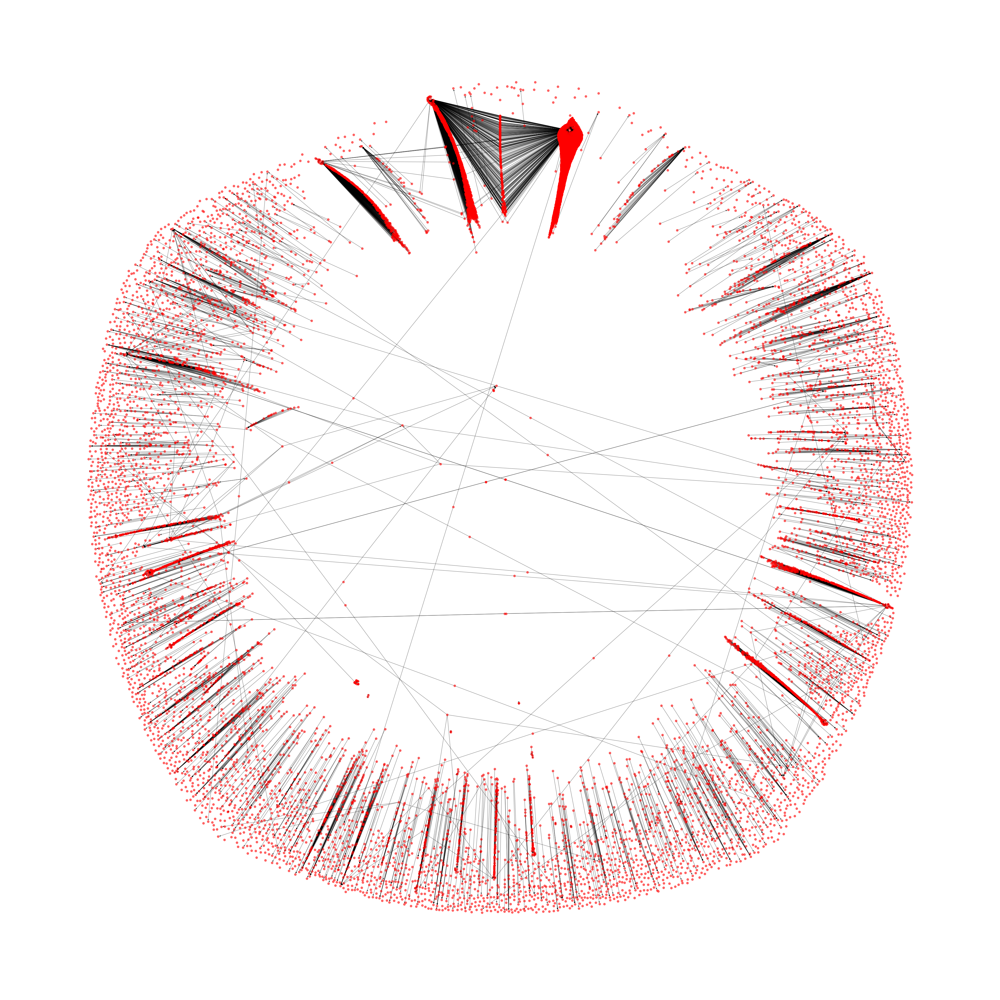

In [429]:
plt.figure(figsize=(50,50))
pos = nx.spring_layout(neg_subgraph)
# ec = nx.draw_networkx_edges(neg_subgraph, pos, alpha=0.2,edge_color='black')
# nc = nx.draw_networkx_nodes(neg_subgraph, pos, node_color='red', with_labels=False, node_size=60)
nx.draw(neg_subgraph, pos, node_color='red', with_labels=False, node_size = 60, edge_color='black',alpha=0.6,line_widths=0.3)
plt.axis('off')
plt.show()

In [430]:
#########################################################################################################

In [431]:
#neighbor analysis

In [44]:
#basically the data is stored in a nested dictionary format with each unique ID having a dictionary with values for red, green, blue, and grey neighbors
#each count is stored as a list because it is for some reason very fast
neighbordata={}

for n in undirected_all_graph.nodes:
    neighbordata[n] = {'red': [], 'green': [], 'blue': [], 'grey': []}

for n in tqdm(undirected_all_graph.nodes(data=True)):
    for i in undirected_all_graph.neighbors(n[0]):
        if undirected_all_graph.nodes[i]['color']=='red':
             neighbordata[n[0]]['red'].append(1) #lists cuz for some reason faster than counters
        elif undirected_all_graph.nodes[i]['color']=='blue':
             neighbordata[n[0]]['blue'].append(1)
        elif undirected_all_graph.nodes[i]['color']=='green':
             neighbordata[n[0]]['green'].append(1)
        else:
             neighbordata[n[0]]['grey'].append(1)
        #print(E.nodes[i]['color'])

100%|██████████| 96344/96344 [00:01<00:00, 58695.92it/s]


In [441]:
#check what the data looks like. capped it at 1000 
a = 0
for n in tqdm(all_graph.nodes(data=True)):
    print(neighbordata[n[0]]['red'])
    a = a+1
    if a > 1000:
        break

  0%|          | 0/96344 [00:00<?, ?it/s]

[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

  1%|          | 1147/96344 [00:00<00:20, 4757.01it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1]
[]
[1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1, 1]
[1]
[1]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1]
[1]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[1]
[1, 1, 1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[

  2%|▏         | 2142/96344 [00:00<00:25, 3646.66it/s]

[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]


  3%|▎         | 3137/96344 [00:00<00:26, 3488.79it/s]


[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1, 1, 1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1, 1]
[1, 1, 1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]

  4%|▍         | 4133/96344 [00:01<00:26, 3537.30it/s]

[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[

  5%|▌         | 5128/96344 [00:01<00:24, 3771.56it/s]


[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1, 1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]

  6%|▋         | 6124/96344 [00:01<00:21, 4255.29it/s]

[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]


  7%|▋         | 7129/96344 [00:01<00:19, 4613.92it/s]

[1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1, 1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[1, 1]
[1, 1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]


  8%|▊         | 8115/96344 [00:02<00:21, 4129.40it/s]

[1, 1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[1]
[1, 1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1, 1, 1, 1, 1, 1, 1]
[1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]


  9%|▉         | 9110/96344 [00:02<00:21, 3993.56it/s]


[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[1]
[1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]

 10%|█         | 10106/96344 [00:02<00:21, 4031.76it/s]

[]
[]
[]
[]
[]
[1]
[]
[]
[1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1, 1]
[]
[]
[]
[1]
[1, 1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1

 12%|█▏        | 11101/96344 [00:02<00:19, 4359.19it/s]


[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[

 12%|█▏        | 11599/96344 [00:02<00:21, 4025.61it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[1, 1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

 13%|█▎        | 12595/96344 [00:03<00:19, 4311.74it/s]


[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[1, 1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[1, 1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1, 1, 1]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]


 14%|█▍        | 13590/96344 [00:03<00:21, 3895.19it/s]

[]
[1]
[1]
[1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1, 1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[

 15%|█▍        | 14087/96344 [00:03<00:20, 4008.98it/s]


[1]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1, 1, 1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[

 16%|█▌        | 15083/96344 [00:03<00:21, 3716.47it/s]

[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1, 1]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]


 17%|█▋        | 16078/96344 [00:04<00:23, 3443.19it/s]


[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[1, 1, 1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[

 18%|█▊        | 17074/96344 [00:04<00:19, 4001.26it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1, 1, 1, 1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]

 19%|█▉        | 18069/96344 [00:04<00:19, 4057.57it/s]


[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]

 20%|█▉        | 19065/96344 [00:04<00:18, 4139.62it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]

 21%|██        | 20060/96344 [00:05<00:18, 4178.80it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1, 1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[

 22%|██▏       | 21056/96344 [00:05<00:17, 4368.74it/s]

[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[1, 1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[1, 1, 1, 1, 1]
[]


 23%|██▎       | 22051/96344 [00:05<00:19, 3861.33it/s]


[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[1, 1, 1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]

 24%|██▍       | 23047/96344 [00:05<00:18, 4030.02it/s]

[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1, 1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[

 25%|██▍       | 24042/96344 [00:06<00:19, 3689.99it/s]


[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1]
[1]
[

 26%|██▌       | 25038/96344 [00:06<00:19, 3660.74it/s]

[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[1]
[1]
[]
[1]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[1]
[]
[

 27%|██▋       | 25976/96344 [00:06<00:17, 3954.55it/s]

[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1]
[1]
[1]
[]
[1, 1]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1

 28%|██▊       | 26531/96344 [00:06<00:20, 3456.56it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1, 1]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1, 1]
[]


 29%|██▊       | 27514/96344 [00:07<00:17, 3936.16it/s]


[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[1]
[1, 1]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[]

 29%|██▉       | 28024/96344 [00:07<00:19, 3579.45it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1, 1]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1, 1]
[]
[]
[1]
[]
[]
[]
[1, 1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1, 1]
[1]
[1]
[]

 30%|███       | 29019/96344 [00:07<00:16, 4081.30it/s]


[1]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[1, 1]
[]
[1]
[]
[1]
[1]
[1]
[]
[1]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1, 1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]


 31%|███       | 30015/96344 [00:07<00:14, 4454.21it/s]

[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[1]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[1]
[1]
[]
[]
[1, 1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]

 32%|███▏      | 31010/96344 [00:07<00:14, 4574.74it/s]


[]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[

 33%|███▎      | 31973/96344 [00:08<00:14, 4377.30it/s]

[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1, 1, 1, 1, 1, 1, 1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[1]
[1]
[]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1

 34%|███▍      | 32833/96344 [00:08<00:15, 4032.63it/s]

[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[1]
[]
[1, 1]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]


 35%|███▍      | 33587/96344 [00:08<00:20, 3052.79it/s]

[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[

 36%|███▌      | 34492/96344 [00:08<00:18, 3310.09it/s]


[]
[]
[]
[]
[1]
[1, 1]
[]
[1]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]

 36%|███▋      | 34990/96344 [00:09<00:18, 3269.92it/s]

[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1, 1]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[1]
[1, 1, 1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]


 37%|███▋      | 35985/96344 [00:09<00:17, 3392.25it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1, 1, 1, 1, 1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[

 38%|███▊      | 36770/96344 [00:09<00:18, 3150.88it/s]

[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1, 1, 1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]


 39%|███▊      | 37098/96344 [00:09<00:21, 2724.46it/s]

[1]
[]
[]
[1]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1, 1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[1, 1]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]


 39%|███▉      | 38053/96344 [00:09<00:17, 3379.76it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1, 1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[1]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[

 40%|████      | 38969/96344 [00:10<00:16, 3531.97it/s]


[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[

 41%|████▏     | 39790/96344 [00:10<00:15, 3754.47it/s]

[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]


 42%|████▏     | 40632/96344 [00:10<00:14, 3969.39it/s]

[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]


 43%|████▎     | 41557/96344 [00:10<00:13, 3991.84it/s]

[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[1]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1, 1]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[1]
[1]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]


 44%|████▍     | 42459/96344 [00:11<00:12, 4184.47it/s]


[]
[1]
[]
[]
[1]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[

 45%|████▌     | 43435/96344 [00:11<00:11, 4460.60it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[1]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[1]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[

 46%|████▌     | 44304/96344 [00:11<00:13, 3852.90it/s]


[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]


 47%|████▋     | 45365/96344 [00:11<00:12, 4044.30it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[

 48%|████▊     | 45778/96344 [00:11<00:12, 3972.97it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1, 1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1]
[1]
[]
[1]
[]
[]
[1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]


 49%|████▊     | 46851/96344 [00:12<00:11, 4222.45it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[1, 1, 1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]

 50%|████▉     | 47773/96344 [00:12<00:11, 4307.77it/s]

[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]

 50%|█████     | 48646/96344 [00:12<00:14, 3393.58it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]


 51%|█████     | 49316/96344 [00:12<00:11, 3962.86it/s]

[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[1]
[]
[1]
[]
[]
[1, 1, 1, 1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1, 1]
[]
[1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[

 52%|█████▏    | 50415/96344 [00:12<00:11, 3829.67it/s]


[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1, 1, 1, 1, 1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[

 53%|█████▎    | 50912/96344 [00:13<00:13, 3389.70it/s]

[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[

 54%|█████▎    | 51779/96344 [00:13<00:13, 3380.88it/s]

[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1, 1]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[

 54%|█████▍    | 52475/96344 [00:13<00:14, 3068.81it/s]


[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1, 1, 1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1

 56%|█████▌    | 53532/96344 [00:13<00:12, 3356.63it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]


 56%|█████▌    | 53909/96344 [00:14<00:15, 2689.58it/s]


[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]


 57%|█████▋    | 54892/96344 [00:14<00:21, 1897.39it/s]

[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]

 57%|█████▋    | 55389/96344 [00:15<00:18, 2164.71it/s]


[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]

 59%|█████▊    | 56385/96344 [00:15<00:16, 2471.47it/s]

[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]


 60%|█████▉    | 57663/96344 [00:15<00:12, 3071.65it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]

 60%|██████    | 58204/96344 [00:15<00:10, 3529.24it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[

 61%|██████    | 58965/96344 [00:16<00:13, 2767.63it/s]

[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[

 62%|██████▏   | 59373/96344 [00:16<00:12, 3014.42it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1, 1, 1, 1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1, 1, 1, 1, 1]
[]
[1]
[]
[]
[]


 62%|██████▏   | 60087/96344 [00:16<00:11, 3053.14it/s]

[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1, 1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 

 63%|██████▎   | 60734/96344 [00:16<00:11, 3043.73it/s]


[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[

 64%|██████▍   | 61511/96344 [00:16<00:10, 3420.18it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]


 65%|██████▍   | 62194/96344 [00:17<00:10, 3130.32it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]

 65%|██████▌   | 62951/96344 [00:17<00:09, 3392.39it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1, 1]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[1, 1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1, 1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]

 67%|██████▋   | 64342/96344 [00:17<00:08, 3797.52it/s]

[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[1, 1]
[]
[]
[]
[]
[]


 68%|██████▊   | 65337/96344 [00:17<00:08, 3739.79it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]


 69%|██████▉   | 66333/96344 [00:18<00:07, 4025.85it/s]

[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[1, 1, 1]
[1]
[1]
[1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]

 70%|██████▉   | 67328/96344 [00:18<00:06, 4250.95it/s]


[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]

 71%|███████   | 68324/96344 [00:18<00:06, 4427.55it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]

 72%|███████▏  | 69319/96344 [00:18<00:05, 4537.47it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]

 73%|███████▎  | 70315/96344 [00:19<00:05, 4617.93it/s]

[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1, 1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]

 74%|███████▍  | 71310/96344 [00:19<00:05, 4587.14it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]

 75%|███████▌  | 72306/96344 [00:19<00:05, 4693.21it/s]

[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]


 76%|███████▌  | 73301/96344 [00:19<00:04, 4644.07it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1, 1, 1, 1, 1, 1, 1, 1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]

 77%|███████▋  | 74297/96344 [00:19<00:04, 4675.33it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1, 1]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[

 78%|███████▊  | 75292/96344 [00:20<00:04, 4671.74it/s]


[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]

 79%|███████▉  | 76308/96344 [00:20<00:04, 4758.17it/s]

[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]

 80%|████████  | 77442/96344 [00:20<00:03, 5087.60it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]


 81%|████████▏ | 78449/96344 [00:20<00:03, 4794.78it/s]

[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1,

 82%|████████▏ | 79368/96344 [00:20<00:04, 4061.29it/s]


[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[

 83%|████████▎ | 79788/96344 [00:21<00:04, 3955.64it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[

 84%|████████▍ | 80767/96344 [00:21<00:04, 3754.57it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[1]

 85%|████████▍ | 81763/96344 [00:21<00:03, 3885.39it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]

 85%|████████▌ | 82260/96344 [00:21<00:03, 3898.86it/s]

[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[1, 1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[

 86%|████████▋ | 83256/96344 [00:21<00:03, 4158.78it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1

 87%|████████▋ | 84298/96344 [00:22<00:02, 4462.72it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]

 88%|████████▊ | 85247/96344 [00:22<00:02, 4345.21it/s]

[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]

 90%|████████▉ | 86325/96344 [00:22<00:02, 4764.63it/s]


[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1

 91%|█████████ | 87418/96344 [00:22<00:02, 3900.53it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]


 92%|█████████▏| 88297/96344 [00:23<00:02, 3372.12it/s]


[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]


 93%|█████████▎| 89332/96344 [00:23<00:01, 3998.75it/s]


[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]


 94%|█████████▎| 90314/96344 [00:23<00:01, 3958.04it/s]

[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[

 95%|█████████▍| 91220/96344 [00:23<00:01, 4228.60it/s]

[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1, 1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[1, 1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]


 95%|█████████▌| 91717/96344 [00:24<00:01, 4330.23it/s]


[]
[1]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[1]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]


 96%|█████████▌| 92713/96344 [00:24<00:01, 2880.41it/s]

[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]


 97%|█████████▋| 93702/96344 [00:24<00:00, 3643.83it/s]


[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]


 98%|█████████▊| 94563/96344 [00:24<00:00, 3706.82it/s]

[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[

 99%|█████████▉| 95699/96344 [00:25<00:00, 4034.62it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[1

100%|██████████| 96344/96344 [00:25<00:00, 3799.26it/s]

[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[1]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[]
[1]
[]
[]
[]
[]
[]
[]
[1]
[1]
[]
[]
[]
[]
[1]
[]

In [45]:
#initialize new dict because problems occur if you modify the original dict as you grab the results
neighbordatafinal = {}
for n in all_graph.nodes:
    neighbordatafinal[n] = {'red': 0.0, 'green': 0.0, 'blue': 0.0, 'grey': 0.0}

#turn lists into counts
for n in tqdm(all_graph.nodes(data=True)):
    neighbordata[n[0]]['red'] = len(neighbordata[n[0]]['red'])
    neighbordata[n[0]]['blue'] = len(neighbordata[n[0]]['blue'])
    neighbordata[n[0]]['green'] = len(neighbordata[n[0]]['green'])
    neighbordata[n[0]]['grey'] = len(neighbordata[n[0]]['grey'])



100%|██████████| 96344/96344 [00:00<00:00, 159618.60it/s]


In [507]:
#check data
for n in tqdm(all_graph.nodes(data=True)):
    print(neighbordata[n[0]]['red']+neighbordata[n[0]]['blue']+neighbordata[n[0]]['green']+neighbordata[n[0]]['grey'])

  1%|          | 934/96344 [00:00<00:10, 9339.54it/s]

2
79572
1070
2
2
1
2
660
2
8
2
30
2
3
2
57
2
11185
2
4
2
2
2
4
1
1
2
12
1
1
1
2
15
76
58
2
54
3
1
1
4
3
2
12
3
1
1
2
2
1
2
126
245
2
73
1
2
8
2
1
3
1
1
2
1511
3
1
1
2
5065
2
3
2
1
2
2
3
61
2
2
1
3
1
1
2
4
2
323
1
2
121
2
1
1
2
1
2
2
13
2
3
2
2
2
2
9
2
9
2
1
3
1
3
2
26
1
2
2
2
69
3
1
1
2
2
1
3
2
1
2
2
1
2
2
5
2
2
2
1
2
2
2
2
1
16
2
2
7
1
2
2
2
21
2
3
2
2
3
4
2
4
57
2
2
2
2
2
73
2
1
2
2
2
2
16
2
4
3
88
2
1
2
27
2
1
1
3
1
1
2
2
1779
2
5
3
1
1
3
2
13
2
3
2
1
2
1
2
147
1
3
2
2
2
8
2
2
1
2
1
2
95
4
1
3
1
1
2
2
3
1
1
2
9
2
6
3
2
2
1
2
2
3
1
1
2
40
2
85
2
2
2
2
2
3
2
2
33
1
2
3
2
3
1
1
3
1
1
2
2
2
11
1
2
2
3
3
1
3
1
1
2
118
1
2
65
4
3
3
1
2
31
2
2
3
1
3
1
2
2
3
1
1
4
2
1
2
1
2
2
2
1
1
3
1
1
3
1
2
2
2
1
1
2
17
1
2
1
1
4
277
2
43
2
19
2
27
2
2
3
2
2
2
1
2
1
1
2
1
2
2
14
2
24
2
2
2
33
3
6
6
2
2
2
1
2
1
2
2
2
2
1
2
2
3
1
1
1
1
1
1
1
2
1
2
1
2
1
2
5
2
2
2
21
2
2
1
3
1
1
1
3
1
1
2
1
2
2
2
2
9
2
2
14
2
22
3
1
1
2
3
1
1
3
1
1
2
1
2
2
1
2
2
2
2
1
2
4
130
63
1
2
1
1
2
11
3
2
2
1
2
2
5
4
5
2
148
2
56
2
1

  2%|▏         | 1783/96344 [00:00<00:20, 4649.25it/s]


8
2
3
3
2
3
1
1
2
2
1
2
19
2
2
2
2
2
2
2
2
4
17
1
2
61
2
2
2
21
3
1
1
2
5
2
2
12
3
1
1
1
2
3
1
1
4
2
2
2
1
2
60
3
1
1
2
1
2
3
2
3
3
2
2
2
1
1
2
3
1
1
2
1
3
1
1
3
2
2
2
1
2
2
2
2
3
1
1
2
39
2
1
2
3
2
2
1
2
5
1
2
2
14
21
1
1
1
1
2
2
2
2
2
2
2
18
2
3
1
1
2
2
5
2
1
2
3
1
1
2
19
2
4
2
3
2
2
2
2
5
2
2
2
2
2
2
1
2
218
2
1
2
1
2
2
2
39
1
2
6
2
1
2
2
9
2
2
2
1
3
1
1
4
125
2
2
4
2
2
3
2
2
1
2
2
2
2
9
2
3
9
9
2
2
2
2
2
2
3
2
2
2
4
2
4
1
2
2
2
2
2
2
4
2
1
2
1
2
1
2
1
2
2
5
1
1
2
2
2
2
2
2
2
3
3
3
2
20
1
1
1
42
1
1
2
3
5
1
1
2
2
2
1
2
2
2
1
1
2
3
2
1
2
3
1
2
2
2
1
2
2
2
2
2
2
1
11
1
1
1
2
3
3
2
1
2
2
2
8
2
2
2
2
3
1
1
2
1
2
2
2
1
2
2
1
2
3
2
2
2
1
2
2
2
1
1
1
2
3
1
1
2
3
1
1
2
2
3
1
1
2
5
2
1
2
31
2
2
1
3
3
2
1
2
2
2
1
3
1
1
2
2
1
2
2
1
4
1
1
12
2
2
2
3
1
1
1
2
2
1
2
1
2
2
2
3
2
1
2
1
2
3
1
1
2
1
2
2
3
7
2
2
2
3
1
1
3
1
1
1
2
2
2
2
2
2
7
2
23
2
105
2
2
2
4
2
99
1
2
2
42
2
2
3
1
1
2
1
3
2
2
5
2
2
2
14
2
2
2
2
2
1
1
2
1
2
2
2
1
2
2
1
2
2
2
2
3
1
1
6
2
3
1
1
2
1
2
1
2
1
5
2
2
2
2
2
2
3
3
1
1
3
2
4
1


  3%|▎         | 2779/96344 [00:00<00:22, 4235.27it/s]

1
2
2
2
15
2
2
2
2
2
2
2
8
2
2
23
3
1
1
2
2
1
2
2
1
1
2
1
1
3
1
1
1
2
2
2
2
2
2
2
2
2
5
1
1
2
2
5
2
1
2
3
1
1
2
1
3
1
3
1
1
2
1
2
3
1
1
2
6
2
2
2
4
1
2
2
1
2
1
2
49
2
1
2
2
1
3
1
1
2
2
2
6
2
1
2
4
1
1
2
1
2
2
6
2
2
1
3
1
1
3
1
1
3
1
1
1
3
1
1
3
3
1
1
2
2
1
2
1
1
2
2
1
1
2
2
2
2
2
2
2
2
2
2
1
1
2
1
4
1
1
2
2
2
3
1
1
2
2
1
1
2
2
2
2
2
2
2
2
1
2
2
22
2
23
2
2
2
1
2
2
1
2
2
3
1
1
3
1
1
2
3
2
4
2
1
2
1
2
3
1
1
1
1
2
3
1
2
1
3
1
1
3
1
1
2
2
2
2
2
2
2
3
1
2
1
1
1
3
1
1
2
2
1
2
2
2
2
2
2
2
2
2
2
83
3
1
1
2
2
2
4
1
1
1
2
2
2
1
2
2
2
2
2
2
2
2
7
2
2
3
1
1
2
2
1
3
2
1
1
3
2
22
3
6
3
1
1
2
2
2
2
2
3
2
2
19
1
2
2
2
5
2
2
2
2
2
1
2
2
2
1
2
2
2
3
1
1
3
10
1
2
1
2
2
2
2
5
2
3
1
1
2
2
3
1
1
3
2
2
2
1
2
1
3
1
1
2
1
1
3
1
2
117
5
2
1
2
1
2
2
1
2
3
3
1
2
2
1
3
2
2
2
2
2
2
2
14
1
1
2
2
2
1
2
2
2
1
2
40
2
2
32
2
2
3
1
1
2
2
2
7
2
1
1
2
2
2
2
1
3
1
1
2
2
10
1
2
2
3
2
1
2
2
2
11
1
2
2
2
2
2
2
3
1
1
2
1
2
3
5
5
2
2
2
1
2
3
5
3
298
1
2
3
1
1
2
16
2
1
1
2
1
3
1
1
2
1
2
2
2
5
18
1
2
5
1
3
3
1
1
1
2
2
3
3
1
4
2
1


  4%|▍         | 3774/96344 [00:00<00:22, 4163.80it/s]


8
2
1
2
2
2
1
3
1
1
1
1
1
2
2
2
21
3
2
2
1
2
2
1
2
1
7
390
2
4
2
1
1
3
1
2
2
1
3
1
1
1
2
2
2
1
1
3
2
2
2
1
1
1
1
2
29
2
25
2
3
1
2
3
1
1
2
3
1
1
2
3
1
2
1
1
2
3
3
1
2
2
2
1
2
8
2
2
1
2
3
1
1
1
2
1
1
1
1
3
2
2
2
1
3
2
2
3
1
1
2
1
3
1
1
2
15
2
3
1
1
2
2
3
1
2
1
2
1
2
1
2
2
2
169
6
2
2
1
2
2
2
1
2
2
2
2
3
1
1
2
2
2
2
2
1
2
1
2
2
2
1
2
6
1
2
2
3
4
1
2
2
2
3
19
2
2
1
1
2
2
7
2
21
9
2
8
2
3
3
1
1
2
2
1
2
2
2
2
4
3
1
1
2
1
2
1
3
15
18
2
3
3
2
2
2
1
4
2
9
55
4
1
1
2
2
1
2
2
1
2
1
2
2
4
11
2
2
2
2
2
3
1
1
2
2
3
2
2
2
1
1
3
7
2
2
2
2
2
3
2
2
2
4
2
1
3
2
3
10
2
1
2
2
1
3
1
1
3
1
3
1
1
2
3
3
6
1
2
1
2
2
2
1
2
1
2
3
2
19
2
2
3
1
1
1
3
1
1
2
1
2
3
1
1
2
2
3
2
3
1
3
2
2
1
2
2
2
3
1
1
3
1
2
2
1
2
2
1
2
2
2
2
2
2
1
2
2
16
2
1
2
3
3
1
1
2
1
2
2
13
1
3
1
1
3
1
1
1
2
26
3
1
1
2
2
14
3
1
1
2
2
2
2
1
2
2
1
2
3
3
1
2
5
2
1
3
1
1
2
15
2
2
12
1
3
1
3
3
1
1
247
3
3
2
2
1
2
1
2
2
2
2
2
1
3
2
2
2
1
1
1
2
151
2
2
2
2
18
2
2
24
1
2
1
2
2
2
6
5
2
3
1
3
2
19
3
2
1
2
1
2
2
2
2
2
2
28
3
2
3
1
1
2
1
2
2
2
2
2
2
2
2
2
2

  5%|▍         | 4770/96344 [00:01<00:22, 4063.48it/s]

2
1
2
2
2
2
1
2
2
1
1
2
1
3
1
3
3
1
2
1
2
2
2
2
2
1
1
7
4
2
3
1
1
2
1
1
3
1
2
2
2
2
2
2
2
2
1
2
3
1
1
1
2
3
3
1
1
2
2
8
2
2
2
2
1
3
2
1
1
2
2
1
3
5
2
2
16
2
1
2
2
2
2
1
2
1
2
2
10
2
1
3
2
2
2
2
5
1
2
1
1
2
1
2
2
2
2
2
2
1
3
1
1
1
2
2
1
2
2
3
1
1
1
2
2
2
2
10
2
1
2
1
1
3
1
1
2
2
2
2
3
1
1
1
2
2
2
4
1
1
3
2
1
2
31
1
2
10
2
2
1
3
1
1
2
2
2
2
1
2
3
3
1
2
2
3
1
2
2
2
3
1
1
2
2
2
1
2
3
2
3
1
1
3
2
2
2
2
2
2
2
4
2
2
2
2
2
3
2
1
2
5
2
2
2
2
1
1
2
3
1
1
1
2
2
2
1
2
2
2
1
17
2
1
3
1
1
2
2
3
1
1
4
2
1
2
5
1
3
3
1
1
10
1
1
2
1
2
5
2
2
6
2
1
2
1
1
4
1
3
1
1
1
2
2
2
2
2
1
2
2
2
2
1
2
2
1
2
2
1
2
2
1
2
21
2
4
2
2
2
2
1
2
1
2
2
3
3
2
2
2
2
2
3
61
6
2
2
1
3
2
2
2
34
2
2
2
2
1
2
2
2
2
2
2
2
3
2
1
2
1
1
2
2
2
2
1
2
1
3
2
2
3
23
21
2
2
2
2
2
1
2
2
1
3
1
1
2
3
3
1
2
8
2
1
2
1
1
3
1
1
2
1
2
3
2
1
1
2
2
1
2
1
2
2
3
1
1
2
3
1
3
2
3
1
2
2
2
3
2
1
2
2
1
2
2
2
1
1
2
3
1
1
4
2
2
1
3
2
2
2
2
2
4
1
1
2
3
1
1
3
2
3
2
1
2
2
2
1
2
2
2
3
2
7
3
1
2
2
3
1
1
2
3
2
2
2
15
1
2
2
1
2
1
1
2
2
1
2
7
2
2
2
2
7
1
1
2
1
2
2
1
2
1

  5%|▌         | 5268/96344 [00:01<00:22, 4104.29it/s]


2
2
1
2
3
1
1
2
62
5
1
1
2
2
1
2
3
2
1
2
2
6
2
2
2
2
1
1
2
1
2
2
2
4
1
2
1
2
1
2
3
1
1
2
3
2
2
5
2
1
2
1
2
2
2
60
2
2
2
3
1
1
2
1
1
2
2
2
2
2
2
2
2
2
2
1
2
2
1
2
2
2
1
2
1
1
3
1
1
2
2
1
2
1
2
2
5
2
2
2
2
2
3
7
2
1
1
2
2
1
4
2
1
2
1
2
3
2
1
1
1
2
2
2
16
2
2
1
1
2
2
2
2
2
1
2
2
2
1
2
2
3
1
1
2
2
6
2
2
2
1
2
4
2
2
5
7
2
1
1
2
1
2
2
2
3
2
2
2
2
2
3
3
1
1
2
1
1
2
2
2
1
2
4
2
2
2
2
2
2
2
3
2
2
2
1
2
2
2
1
3
1
1
1
2
1
1
1
2
2
1
2
1
2
2
5
2
1
2
3
2
1
3
1
1
2
1
2
2
3
2
1
2
2
2
3
2
1
2
2
2
1
3
1
6
2
8
2
2
2
2
3
1
1
1
3
1
1
2
1
1
2
2
1
3
1
1
2
2
3
3
1
2
3
1
1
2
1
2
1
2
2
2
3
1
3
1
2
2
1
2
1
1
1
2
2
3
1
2
1
2
2
1
2
2
2
2
2
1
2
3
1
1
2
2
2
1
3
2
2
2
2
2
2
2
1
2
2
2
2
3
2
2
1
2
2
1
2
3
3
4
2
3
1
1
3
1
1
2
1
2
2
3
2
2
2
2
6
2
3
2
3
2
1
1
1
2
2
2
2
3
2
2
2
13
2
1
2
2
2
2
2
1
1
2
2
2
2
1
3
1
2
1
2
2
2
1
2
7
1
2
2
3
4
1
2
1
2
2
2
2
2
2
2
1
1
1
2
1
2
5
1
4
1
1
2
1
2
1
2
2
3
2
3
5
1
2
2
2
2
24
3
2
2
2
21
4
2
2
1
1
7
2
2
1
2
1
2
2
2
2
2
2
2
2
1
2
2
3
1
1
2
1
2
1
2
8
2
3
2
3
2
2
2
2
2
1
2
7
2
2
1
2
2
2
2
2

  6%|▌         | 5765/96344 [00:01<00:30, 2974.11it/s]

2
2
3
1
2
1
1
2
1
2
1
2
2
3
1
1
2
4
2
3
1
2
2
3
1
1
2
2
3
1
1
2
1
1
2
2
1
1
2
2
1
1
2
1
2
1
1
1
1
1
2
2
1
2
3
1
2
2
2
1
3
1
1
2
2
2
2
1
2
2
33
2
2
2
1
1
2
2
1
2
15
1
2
2
3
1
1
2
3
2
2
2
2
2
2
3
1
1
2
2
2
2
1
4
1
1
2
2
3
1
1
3
1
1
1
2
2
2
2
2
2
2
1
2
2
2
2
2
1
2
2
1
2
2
2
2
20
2
2
2
2
1
2
3
2
9
2
2
2
3
1
1
2
1
3
2
3
3
3
1
1
1
2
2
3
1
1
2
2
3
1
2
2
2
1
2
1
2
2
2
3
2
2
2
3
2
2
2
1
2
2
2
2
1
2
44
2
2
3
4
2
2
3
2
2
2
1
2
2
2
2
1
2
2
8
1
2
2
2
3
1
1
2
2
1
1
2
1
2
2
1
1
3
1
1
2
3
2
2
3
2
3
2
2
3
1
1
2
2
3
1
1
2
2
1
2
11
2
2
3
2
2
1
2
2
9
1
2
2
1
2
2
3
9
3
1
1
2
2
2
1
2
1
1
2
1
2
3
1
1
2
2
3
1
1
2
1
2
1
4
1
1
2
1
2
6
1
1
3
1
1
8
1
3
4
1
2
2
2
1
1
2
3
1
1
2
2
8
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
1
1
2
1
1
6
3
7
5
2
2
2
2
2
1
2
2
2
2
2
10
2
2
2
3
1
2
1
2
2
2
1
2
1
2
8
2
1
2
2
1
2
3
1
1
2
3
1
1
2
2
2
2
2
1
2
2
2
2
2
2
1
2
2
1
2
3
1
1
2
3
2
2
2
2
5
2
2
2
1
3
1
1
2
3
1
1
3
2
2
2
3
4
3
1
1
1
1
2
2
3
1
1
3
1
1
1
3
1
1
2
1
2
2
2
3
3
2
1
2
2
2
3
2
1
2
1
2
2
1
2
2
2
1
2
1
2
1
2
2
2
2
9
2
3
1
3
1
1
1
2
2
2
2


  7%|▋         | 6760/96344 [00:01<00:32, 2743.88it/s]


2
2
2
5
2
1
2
1
3
1
1
1
4
1
1
2
1
2
2
2
2
2
2
1
2
2
2
1
2
2
1
2
1
2
2
3
1
1
3
2
3
4
1
1
1
1
2
1
2
2
3
1
2
2
2
3
1
3
1
1
1
6
2
3
2
2
2
2
2
2
2
2
2
2
2
3
1
1
2
2
1
3
1
1
4
2
1
2
2
2
1
2
1
2
2
2
2
1
2
2
1
11
2
1
9
2
1
2
2
2
2
1
2
1
2
1
4
2
3
1
1
2
1
2
2
3
1
1
2
1
2
2
3
1
1
2
2
2
1
1
3
1
1
2
2
1
2
7
2
3
1
1
2
2
2
2
1
1
6
1
1
3
1
1
2
1
2
2
2
2
2
2
1
2
43
2
4
1
2
1
2
2
1
3
2
1
2
2
2
2
2
1
2
1
2
3
2
1
2
2
2
2
1
2
3
1
1
1
1
2
6
2
1
2
2
2
2
1
2
2
2
1
3
1
1
2
1
2
2
1
2
1
1
1
1
1
2
1
2
2
2
2
1
3
1
4
5
2
2
2
1
1
1
2
2
10
2
3
1
1
1
1
1
2
1
1
3
1
1
2
1
2
2
2
3
2
2
2
2
1
2
3
1
1
2
2
2
2
2
2
2
3
1
1
3
1
2
1
2
2
1
2
2
2
2
2
2
8
2
1
2
3
1
1
2
2
2
1
2
3
2
2
3
2
3
1
1
3
3
2
9
2
2
2
2
2
3
1
1
2
2
2
2
2
2
1
1
3
1
1
3
1
1
2
15
1
2
2
1
2
15
2
2
2
1
2
2
2
2
2
1
2
2
2
2
3
1
1
2
4
21
1
2
2
2
14
3
3
1
1
1
2
2
2
2
1
1
3
2
2
2
2
7
1
1
2
3
2
3
1
1
3
1
1
2
2
1
1
2
1
2
4
2
3
1
1
1
2
1
2
2
2
2
2
1
1
2
2
1
2
2
1
2
1
1
2
1
3
1
3
2
2
2
2
3
1
1
3
1
1
1
6
1
2
2
2
2
2
2
2
2
1
3
1
1
5
1
1
2
2
2
3
1
1
2
4
2
2
1
2
2
1
2
2
2
2


  8%|▊         | 7258/96344 [00:02<00:39, 2242.91it/s]

2
2
3
4
1
2
2
1
2
2
1
3
1
1
2
2
2
1
2
1
1
2
2
8
2
2
2
1
1
14
1
1
2
3
2
2
1
2
2
2
17
3
2
2
2
2
1
2
1
2
2
2
2
1
3
2
2
3
1
1
2
2
2
4
2
1
2
1
2
2
1
3
2
3
2
2
3
1
1
2
1
2
2
3
9
22
3
3
1
1
3
2
1
2
3
2
1
3
1
1
2
3
1
1
2
1
2
2
3
1
1
2
2
2
6
2
2
2
2
2
1
3
1
1
2
2
2
1
2
2
1
3
1
1
1
2
1
3
1
1
2
2
3
2
2
3
1
1
2
3
2
2
2
2
3
1
1
2
2
2
2
2
1
2
2
1
2
2
1
2
1
2
2
2
1
1
2
2
3
9
1
1
2
2
1
2
2
2
2
2
2
2
2
2
2
1
1
2
2
2
2
2
1
1
2
2
3
2
2
2
1
2
2
2
2
1
2
2
2
3
1
1
2
2
2
2
2
1
2
2
3
1
2
2
1
2
2
2
2
1
2
2
2
1
1
2
2
3
1
1
3
1
2
2
1
2
2
2
1
2
2
2
2
1
2
2
2
1
1
2
2
2
2
1
1
2
3
1
1
2
1
2
2
3
2
1
2
1
2
1
1
2
2
2
1
2
1
2
1
1
4
1
3
1
3
1
1
2
2
3
1
1
2
2
2
17
2
2
2
2
1
2
1
1
1
2
2
1
2
2
2
1
2
3
2
2
6
4
2
2
1
3
1
1
2
2
1
1
2
264
60
2
2
2
1
1
2
2
1
188
2
1
2
1
1
2
2
2
2
2
2
2
2
2
2
1
2
5
3
2
1
3
2
3
2
3
2
15
8
6
2
1
1
2
4
2
2
2
2
2
2
2
1
2
2
1
1
2
2
2
2
2
2
3
2
1
2
2
4
3
3
3
2
2
1
3
1
1
8
2
2
2
2
2
1
2
2
2
2
2
1
1
2
6
2
1
2
1
2
1
2
1
1
2
2
3
2
1
3
1
1
2
3
2
3
1
1
2
1
2
1
1
2
2
1
57
2
2
3
3
2
2
2
2
2
2
1
2
3
1
1
2
1
3
1

  8%|▊         | 7756/96344 [00:02<00:41, 2129.71it/s]


3
1
2
2
2
3
1
1
2
3
1
1
4
2
2
2
1
2
2
2
2
2
1
2
2
2
2
1
3
1
1
2
3
2
2
4
2
3
1
1
2
2
2
2
2
1
2
3
1
1
3
1
1
3
2
1
2
2
4
1
1
3
1
1
3
1
1
1
1
2
2
1
2
2
5
3
1
1
3
1
1
1
3
1
3
1
3
2
7
2
3
1
1
1
2
2
7
1
2
2
2
2
2
1
1
1
2
2
3
35
36
1
3
2
1
2
2
2
3
1
1
1
3
2
1
3
4
1
2
3
3
2
2
2
1
2
1
3
381
2
2
1
2
2
2
2
2
1
2
20
2
2
2
2
2
1
1
2
13
2
2
2
1
1
2
2
1
2
1
2
3
2
5
2
2
2
2
2
2
2
2
3
1
2
2
4
1
2
3
2
2
2
2
2
2
2
5
3
3
1
1
3
1
1
2
1
2
1
2
3
1
1
2
3
2
2
2
2
2
2
2
2
2
1
1
2
2
2
2
1
2
1
3
1
1
2
5
2
2
2
1
2
2
1
2
1
1
3
1
1
2
6
2
2
2
2
2
1
2
2
1
2
2
2
2
2
2
2
2
2
3
1
1
1
2
3
1
2
3
2
2
2
2
1
1
2
2
189
6
2
2
2
3
1
1
1
2
3
5
6
2
1
2
1
2
2
1
2
2
2
2
4
3
1
1
6
2
2
2
2
3
2
1
2
1
2
2
2
1
2
6
2
2
1
2
2
3
2
2
2
5
1
1
2
3
2
2
1
2
2
1
1
2
1
2
1
3
1
1
2
2
1
2
2
12
2
1
1
2
2
1
3
3
1
2
2
1
2
2
2
2
2
1
2
2
2
3
1
1
2
2
2
1
3
1
1
1
3
1
1
1
3
1
1
1
2
4
2
1
2
2
3
4
6
3
1
1
3
1
1
2
1
3
1
2
2
2
2
1
2
3
2
2
2
2
20
2
2
2
2
2
6
1
1
2
1
65
2
1
3
2
1
3
1
1
2
2
2
2
2
2
2
2
3
1
1
1
2
12
2
2
1
3
2
2
3
1
1
2
2
2
2
2
2
2
2
2
1
1
1
2
1
2
1

  9%|▉         | 8751/96344 [00:03<00:47, 1851.94it/s]

1
2
2
3
1
1
2
3
1
2
2
3
2
2
11
2
3
4
1
1
2
2
3
2
3
2
1
2
1
2
2
2
3
2
2
4
1
2
5
1
1
1
3
1
1
2
2
1
1
2
2
2
13
1
2
1
2
2
1
3
1
1
3
8
3
1
1
2
2
1
2
3
1
1
9
7
1
3
2
2
1
2
2
2
1
2
2
1
1
2
1
1
1
1
3
1
1
2
3
1
1
1
1
2
1
2
1
1
2
2
2
4
2
1
2
2
2
1
2
2
1
2
1
2
2
1
3
1
1
2
3
3
2
2
1
3
1
1
2
3
1
1
2
2
2
2
2
2
3
1
1
1
2
2
3
1
1
5
13
13
2
1
2
3
2
9
2
1
5
1
3
2
3
2
1
2
2
2
2
1
2
2
1
2
2
2
2
1
2
2
3
1
1
2
2
4
1
2
3
2
1
2
2
1
2
2
2
3
3
1
1
1
2
1
2
2
2
2
2
3
1
1
1
2
2
1
2
2
5
2
3
1
2
2
2
3
2
2
3
1
1
1
3
3
3
2
1
2
1
3
2
2
3
2
2
2
1
2
1
4
3
1
1
2
1
2
1
2
2
4
1
1
3
1
1
2
2
1
2
1
2
2
1
2
3
1
1
1
2
1
2
2
3
3
1
6
2
1
3
2
2
3
2
1
3
2
1
1
2
2
2
2
2
3
2
2
1
2
3
1
1
1
2
2
1
2
2
2
2
3
2
2
1
1
1
2
4
4
1
1
1
2
4
2
1
2
4
2
1
1
1
2
1
2
2
6
2
2
2
3
2
6
2
2
2
2
1
2
2
1
3
3
2
1
1
1
2
2
2
1
2
1
2
3
1
1
2
2
2
1
2
2
2
2
3
2
1
1
6
3
1
1
2
2
2
3
1
1
2
1
2
2
2
2
2
1
2
2
2
2
2
4
2
3
2
2
2
1
2
3
1
1
2
4
1
1
1
1
2
2
1
1
2
1
2
4
1
2
1
1
2
3
2
1
1
1
1
2
2
2
2
2
4
1
3
2
1
2
2
1
2
2
1
2
2
2
2
3
2
2
2
1
3
29
2
2
1
2
2
1
2
2
2
58
2
1
2


 10%|█         | 9746/96344 [00:03<00:34, 2487.40it/s]


2
3
2
2
3
1
1
2
2
3
2
2
3
1
1
1
2
3
2
1
2
2
2
2
2
1
2
1
2
2
2
2
2
3
2
2
2
2
3
2
2
1
2
2
2
3
1
1
1
2
1
2
2
2
3
1
1
2
3
1
1
2
2
2
2
2
2
2
1
1
39
2
2
78
2
1
2
1
2
2
2
3
1
1
4
2
2
2
1
3
1
1
4
2
1
2
1
1
4
1
1
2
2
2
2
2
1
2
3
2
1
2
1
2
3
1
1
1
2
2
5
3
1
1
2
3
1
1
1
2
1
2
1
2
2
3
1
1
1
2
1
1
2
2
16
3
2
2
3
2
2
1
2
3
1
1
2
1
1
2
2
4
1
3
1
1
2
1
2
2
3
1
1
2
2
2
2
2
1
3
1
1
1
3
2
1
1
2
2
1
1
2
2
2
1
2
1
2
9
2
1
2
1
3
2
2
2
2
2
1
2
2
9
1
1
2
2
1
2
5
2
1
3
1
1
2
2
2
2
2
2
1
1
2
2
2
2
2
2
1
2
2
3
1
1
1
2
2
1
2
2
2
2
2
3
1
1
2
3
1
1
1
2
2
3
1
1
2
2
2
4
6
4
2
2
2
2
2
3
2
2
2
1
2
1
3
1
1
1
2
2
3
1
1
2
2
1
2
1
2
2
2
10
3
1
1
2
2
1
2
2
2
1
7
1
3
1
2
2
1
2
3
2
1
2
2
2
2
3
1
1
2
2
2
1
2
2
1
1
3
1
1
2
1
3
1
1
3
2
2
2
7
2
1
3
1
2
2
2
3
1
1
2
3
1
1
3
1
1
2
2
2
2
3
1
1
2
2
5
1
1
2
2
2
5
2
1
2
2
2
3
1
1
3
3
2
2
2
2
1
2
3
2
2
3
1
1
3
1
1
2
2
2
2
3
2
1
1
1
2
3
1
1
2
3
1
2
2
1
2
2
1
2
1
2
2
1
1
3
1
1
2
2
2
2
1
1
2
2
2
2
2
2
1
1
2
2
2
2
1
2
19
2
2
2
2
2
6
2
6
2
2
3
2
2
1
1
1
2
2
2
1
2
1
2
1
2
2
2
1
2
2
2
2
2
3
1


 11%|█         | 10742/96344 [00:03<00:28, 2984.12it/s]

1
2
1
1
2
1
2
2
2
2
2
2
2
2
2
10
13
2
2
2
4
2
2
2
2
2
3
1
1
1
1
2
1
2
2
2
2
9
2
1
2
2
1
2
3
1
1
2
2
1
1
1
2
2
3
3
2
3
1
1
2
2
2
2
2
1
3
1
1
2
2
2
2
1
1
2
2
2
1
8
2
1
1
2
1
2
2
2
2
2
1
1
2
1
1
2
2
2
3
7
2
1
1
2
1
1
2
2
2
1
2
2
1
3
2
1
1
2
1
1
2
1
2
3
1
1
2
2
4
1
2
2
2
2
2
3
1
1
2
2
2
2
2
2
2
3
8
11
2
2
2
3
1
1
3
1
1
2
1
3
1
1
2
1
2
3
2
1
1
2
3
1
1
3
1
1
1
2
5
3
5
1
1
1
2
2
1
1
1
3
1
1
2
2
2
2
4
1
1
2
3
2
15
2
2
3
2
3
1
1
2
2
1
2
2
2
2
2
1
2
3
1
1
2
9
2
3
1
1
2
3
1
1
1
2
2
1
2
2
2
2
2
1
2
2
2
2
2
2
3
2
1
2
1
2
1
2
2
1
2
2
1
2
1
2
1
2
1
1
2
2
3
4
2
3
1
2
2
2
1
2
2
5
3
1
1
3
1
2
1
1
2
1
2
1
2
2
2
2
2
1
1
3
2
2
1
2
2
2
1
1
1
1
2
1
3
2
2
1
3
1
1
3
1
1
2
1
2
2
2
1
2
1
2
2
3
1
1
2
6
2
3
1
2
2
2
1
3
1
1
2
2
2
2
2
2
2
1
2
3
2
1
2
2
1
2
3
1
1
2
3
1
1
1
2
1
2
3
2
1
2
2
3
1
1
2
2
2
1
3
2
2
2
2
2
2
2
3
1
1
5
3
1
1
2
2
1
2
1
2
2
1
2
2
3
1
1
2
2
2
2
2
3
1
1
2
3
1
1
2
1
2
2
2
2
3
1
1
2
2
2
2
2
2
3
3
2
2
1
1
1
2
3
1
1
2
2
1
2
2
2
2
2
1
2
1
2
2
6
3
2
2
2
2
1
2
2
2
3
1
1
5
5
1
2
7
3
1
1
2
2
2
9
1
1
2
2
31

 12%|█▏        | 11737/96344 [00:03<00:24, 3406.04it/s]


2
2
1
1
2
2
2
1
2
3
8
2
1
2
1
2
2
1
2
1
2
1
2
2
1
2
1
2
3
2
1
2
2
2
2
2
3
2
2
1
2
1
2
2
2
2
2
2
1
3
2
1
4
1
2
2
2
2
2
6
3
1
1
2
2
1
2
2
13
1
1
1
2
2
2
3
2
2
3
2
1
3
2
2
1
2
2
1
3
2
2
2
2
2
2
84
2
2
2
1
3
2
1
2
2
3
1
1
4
2
2
2
1
2
2
2
2
1
2
2
2
2
2
2
2
2
2
2
1
1
1
7
4
2
1
1
2
1
2
1
2
1
1
2
3
2
2
1
2
3
1
2
2
1
2
2
2
2
1
2
2
2
2
2
6
2
2
7
2
3
3
1
2
2
2
1
3
1
1
2
2
3
1
1
4
1
2
2
2
2
3
2
1
2
2
2
2
2
1
1
2
2
2
2
1
2
6
1
1
2
2
2
2
2
5
2
2
1
1
3
1
1
3
1
2
3
3
1
1
2
3
1
1
1
2
2
2
2
1
2
2
2
2
1
14
2
2
2
3
1
2
2
2
2
1
1
2
2
1
2
2
2
3
1
1
2
2
2
2
3
3
1
1
3
2
1
2
2
2
2
2
2
3
1
1
2
2
1
3
1
1
3
1
1
1
2
2
2
2
2
2
2
2
1
3
2
2
2
2
2
2
1
2
3
1
1
2
2
4
2
3
1
1
4
2
2
2
2
2
2
3
6
2
1
2
3
1
1
2
2
2
1
1
1
2
2
2
2
1
1
3
2
2
1
2
2
2
1
2
1
33
2
3
1
1
2
2
2
1
2
508
2
1
2
2
7
2
3
1
1
1
2
9
2
2
2
2
2
7
1
2
2
1
2
2
1
1
2
3
1
1
2
3
1
1
3
1
1
1
2
2
2
2
2
2
2
2
3
1
1
1
2
2
3
2
1
2
1
1
2
2
2
2
1
2
2
3
1
1
2
3
2
2
2
2
3
3
1
1
1
2
2
2
31
2
2
2
2
1
4
3
1
3
2
2
2
2
2
2
2
2
1
2
2
2
2
2
2
1
2
1
2
2
2
1
1
1
1
3
2
1
2
2
2
1
2


 13%|█▎        | 12733/96344 [00:04<00:23, 3542.63it/s]

2
3
2
1
3
2
1
2
2
2
2
2
2
2
2
1
2
2
1
2
2
2
2
2
2
2
3
1
1
2
2
1
3
1
1
3
1
2
3
2
2
3
1
1
9
1
1
3
1
1
3
2
2
2
2
3
1
1
2
2
2
2
2
2
2
2
2
4
2
3
1
1
2
2
2
2
2
4
42
1
2
2
1
1
1
2
2
1
2
1
2
2
2
3
2
1
2
2
2
2
3
2
2
3
1
2
2
5
1
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
1
2
6
2
2
2
2
2
2
1
2
3
3
1
2
2
3
1
2
2
2
2
1
2
8
1
1
2
1
2
2
2
2
1
3
1
1
1
2
1
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
3
1
1
2
1
2
2
1
3
1
1
1
2
2
2
1
2
1
2
3
1
1
1
2
2
3
3
3
2
1
2
2
2
2
2
2
2
1
2
1
2
2
2
2
6
1
1
3
2
2
3
1
1
3
4
21
2
2
2
2
3
1
2
8
2
2
2
3
2
1
3
3
2
2
2
1
3
1
1
2
2
1
2
2
2
1
3
1
1
2
2
1
2
1
3
1
1
2
2
1
2
2
1
2
2
3
2
2
11
2
4
1
2
2
2
2
2
1
2
2
2
3
1
1
2
2
2
2
1
2
3
4
2
1
2
1
2
3
1
2
2
2
2
1
2
1
2
3
1
1
2
2
2
2
2
3
2
1
2
2
2
2
1
3
2
1
2
1
2
1
2
2
1
2
2
2
2
2
1
3
1
1
2
2
1
4
2
4
3
1
2
2
2
2
5
2
2
3
3
1
1
16
2
2
3
1
1
2
2
2
1
3
1
1
2
3
2
2
1
3
2
1
3
2
2
2
2
1
2
1
2
2
2
2
2
1
3
1
2
1
2
3
2
2
1
2
2
1
2
2
2
1
1
1
2
2
2
2
3
1
1
2
2
2
2
2
2
2
2
2
2
2
2
1
2
2
2
2
2
5
2
3
1
1
2
1
3
2
2
1
3
1
1
2
2
1
1
1
2
2
2
2
2
3
3
3
1
2
2
2
1
3
1
1
1
2
2
2


 14%|█▍        | 13728/96344 [00:04<00:23, 3531.79it/s]


1
2
2
1
2
2
1
5
1
1
2
1
2
4
2
2
2
2
2
3
1
1
3
7
49
2
2
2
2
2
2
3
1
1
1
1
2
2
1
1
2
1
2
3
4
3
3
2
2
2
2
1
2
2
2
2
5
1
1
2
1
2
2
2
3
1
1
2
2
1
1
3
1
2
3
1
1
2
1
2
2
2
2
2
3
2
1
1
1
2
2
1
1
2
3
3
1
1
5
2
2
2
1
2
2
2
1
2
2
4
1
2
1
1
4
2
5
2
2
2
3
2
1
1
2
1
2
5
2
2
3
1
1
2
2
1
2
2
3
2
7
1
3
1
1
2
2
2
2
6
2
2
2
2
3
1
1
3
1
1
3
2
2
2
2
3
1
1
4
3
1
1
3
1
1
1
10
2
2
1
2
2
1
1
2
2
2
1
44
1
2
3
2
5
2
3
1
1
5
2
2
2
3
1
3
1
1
2
2
2
2
1
2
2
1
7
3
1
1
2
3
5
1
2
1
2
1
2
2
2
3
2
2
1
1
2
2
2
2
3
1
1
1
4
1
3
1
1
2
2
2
2
3
2
8
2
2
2
2
2
3
2
1
1
2
2
2
2
3
2
1
2
2
2
1
4
3
2
2
2
5
6
2
7
2
2
1
2
2
2
2
1
2
3
1
2
1
1
1
2
2
2
1
1
2
2
1
2
2
1
2
1
2
3
1
1
2
2
1
2
2
2
2
2
1
2
2
3
1
1
2
2
2
2
2
2
2
5
1
1
2
3
1
1
1
3
1
1
2
5
1
2
2
2
2
5
1
2
2
2
2
1
1
3
1
1
2
3
1
1
2
2
2
2
3
2
7
2
1
2
30
2
1
2
2
2
2
2
2
2
2
2
2
2
4
2
2
2
2
2
1
2
3
1
3
1
1
3
1
1
1
2
2
3
1
2
2
4
1
2
3
1
1
1
1
2
2
2
2
2
2
2
2
2
2
2
1
1
2
3
1
1
2
2
1
1
2
2
2
2
2
2
2
2
2
3
2
3
1
1
2
1
1
2
1
2
2
3
2
2
2
2
1
2
1
2
1
4
1
1
2
2
1
2
2
2
23
1
2
1
2
2
2
2
1
2
2


 15%|█▌        | 14724/96344 [00:04<00:23, 3437.32it/s]

5
2
2
3
1
1
3
1
1
1
3
1
1
1
4
2
2
1
2
4
2
2
1
2
2
2
2
2
2
2
2
2
3
2
5
2
2
2
1
2
2
1
2
1
1
3
1
1
3
2
7
2
1
1
2
2
2
1
2
2
2
1
2
1
4
2
1
2
2
1
5
1
1
1
2
2
2
2
1
2
1
2
1
2
2
1
2
2
2
5
1
2
2
1
2
2
2
3
2
3
2
1
1
8
1
2
1
2
14
2
1
2
1
3
5
5
2
2
1
2
2
3
1
1
2
1
2
2
1
2
1
2
2
2
2
4
2
2
2
2
1
2
1
2
2
3
1
1
2
1
2
2
2
1
3
1
1
1
2
2
1
1
3
2
2
4
1
2
2
2
2
1
2
2
1
2
3
1
1
2
2
2
2
5
2
3
2
1
2
2
2
1
2
1
2
2
1
1
3
2
2
2
2
1
2
1
2
2
1
1
11
2
1
2
6
2
3
2
2
2
1
1
2
2
1
2
1
2
1
2
1
3
1
3
1
1
5
2
2
3
2
1
2
4
3
1
2
2
2
2
3
1
1
2
1
1
2
2
2
2
2
1
1
2
1
2
2
2
2
2
2
1
2
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
1
2
2
2
3
2
2
2
2
1
2
2
1
2
2
4
2
2
2
1
1
2
2
3
1
1
8
2
2
2
2
3
1
1
2
1
2
2
3
3
2
2
2
2
2
1
2
2
1
2
2
1
2
2
1
4
1
2
2
3
1
1
2
2
2
3
2
2
2
2
1
2
2
2
1
3
1
1
2
3
2
3
1
1
2
2
3
2
3
1
1
1
2
2
2
1
2
2
1
1
1
1
2
2
3
2
2
2
3
2
1
18
2
2
2
3
2
2
2
2
3
4
3
1
1
3
2
1
2
2
2
2
1
3
2
2
3
1
1
2
3
2
2
2
2
1
2
1
2
2
1
3
1
1
1
2
1
3
2
1
2
2
2
2
2
2
2
1
1
2
2
2
2
1
2
2
2
2
2
2
1
2
2
2
2
2
2
2
2
8
2
2
2
2
2
2
2
3
1
1
1
1
2
3
1
1
2
1
2
3
2

 16%|█▋        | 15719/96344 [00:05<00:21, 3683.21it/s]


2
1
2
3
2
1
2
2
2
2
2
2
1
2
2
2
2
2
1
3
2
2
2
2
3
2
2
1
2
3
3
1
1
2
2
2
1
2
2
1
2
1
2
2
2
2
2
2
2
8
1
3
1
1
3
2
2
2
2
2
2
2
2
1
2
2
9
3
2
2
2
2
2
3
1
1
3
1
1
2
1
2
2
2
2
2
1
2
2
2
1
2
3
1
1
2
1
2
2
2
2
3
2
2
2
2
3
2
3
134
3
2
1
2
1
1
2
3
2
1
2
2
1
2
2
3
2
2
2
2
2
2
3
2
2
2
4
2
2
2
2
2
1
1
1
2
2
2
1
1
3
1
1
1
2
2
2
2
2
3
1
1
2
1
2
2
2
2
3
2
2
3
3
1
1
2
2
1
1
3
1
1
2
2
1
2
2
1
2
1
2
2
2
2
1
1
2
2
1
2
2
2
3
5
1
2
2
2
2
2
2
3
1
1
2
1
2
2
1
3
2
2
3
1
1
2
4
2
2
1
2
2
4
2
2
1
1
2
1
2
2
3
2
2
2
7
2
1
2
16
2
1
3
1
1
3
2
2
1
2
2
2
3
2
2
2
2
2
1
1
2
3
2
2
2
2
2
1
2
2
2
1
2
2
3
1
1
2
2
2
1
2
2
1
1
2
3
2
1
15
2
1
4
2
2
2
3
1
1
1
2
2
1
4
2
2
2
2
1
2
2
2
2
2
2
2
3
1
1
1
1
4
2
2
1
1
2
1
1
2
3
1
1
2
2
2
2
2
2
2
2
10
2
1
2
1
2
2
2
2
1
2
1
2
2
2
2
2
2
1
2
1
1
1
2
1
2
2
2
3
1
1
2
1
2
2
2
1
2
2
2
1
2
2
1
2
2
1
1
2
2
3
3
2
2
2
3
1
1
2
13
2
2
2
3
1
1
2
1
2
2
2
2
2
2
1
2
2
2
2
2
2
2
3
3
1
1
2
2
2
2
2
2
2
2
2
2
2
2
3
1
1
2
3
1
1
2
2
2
2
1
1
1
3
1
1
1
2
2
24
2
2
2
2
2
2
2
2
1
2
3
2
2
2
2
2
2
2
2
3
2
1
3
1
1
4


 17%|█▋        | 16092/96344 [00:05<00:25, 3087.45it/s]



1
1
2
2
2
1
2
2
2
2
2
2
3
1
1
2
3
1
1
3
1
2
2
2
3
2
2
2
2
1
2
2
2
2
2
1
2
2
2
2
4
2
3
1
1
3
2
1
2
1
1
2
2
1
2
2
2
2
2
2
1
1
2
1
2
2
3
2
3
2
1
2
2
2
1
2
2
2
2
3
2
1
2
2
2
1
3
1
1
2
1
2
2
2
2
1
2
1
2
2
1
2
2
3
2
2
2
2
3
2
2
3
1
1
3
1
1
2
6
3
1
1
3
2
2
2
3
1
2
1
1
3
3
3
2
4
2
1
5
2
2
1
2
2
1
2
1
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
3
1
1
2
3
2
2
1
2
1
2
2
2
12
3
36
1


KeyboardInterrupt: 

In [46]:
#counts into proportions
for n in tqdm(all_graph.nodes(data=True)):
    neighbordatafinal[n[0]]['red'] = neighbordata[n[0]]['red']/(neighbordata[n[0]]['red']+neighbordata[n[0]]['blue']+neighbordata[n[0]]['green']+neighbordata[n[0]]['grey'])
    neighbordatafinal[n[0]]['blue'] = neighbordata[n[0]]['blue']/(neighbordata[n[0]]['red']+neighbordata[n[0]]['blue']+neighbordata[n[0]]['green']+neighbordata[n[0]]['grey'])
    neighbordatafinal[n[0]]['green'] = neighbordata[n[0]]['green']/(neighbordata[n[0]]['red']+neighbordata[n[0]]['blue']+neighbordata[n[0]]['green']+neighbordata[n[0]]['grey'])
    neighbordatafinal[n[0]]['grey'] = neighbordata[n[0]]['grey']/(neighbordata[n[0]]['red']+neighbordata[n[0]]['blue']+neighbordata[n[0]]['green']+neighbordata[n[0]]['grey'])

neighbordatafinal[n[0]]['red']

#average percentages of a particular color
red = []
blue = []
green = []
grey = []
for n in tqdm(all_graph.nodes(data=True)):
    if n[1]['color'] == 'red':
        red.append(neighbordatafinal[n[0]]['red'])
        blue.append(neighbordatafinal[n[0]]['blue'])
        green.append(neighbordatafinal[n[0]]['green'])
        grey.append(neighbordatafinal[n[0]]['grey'])
print("red nodes:")
print("% of red neighbors", sum(red)/len(red)*100,"%")
print("% of blue neighbors", sum(blue)/len(blue)*100,"%")
print("% of green neighbors", sum(green)/len(green)*100,"%")
print("% of grey neighbors", sum(grey)/len(grey)*100,"%")
print(" ")

red = []
blue = []
green = []
grey = []
for n in tqdm(all_graph.nodes(data=True)):
    if n[1]['color'] == 'blue':
        red.append(neighbordatafinal[n[0]]['red'])
        blue.append(neighbordatafinal[n[0]]['blue'])
        green.append(neighbordatafinal[n[0]]['green'])
        grey.append(neighbordatafinal[n[0]]['grey'])

print("blue nodes:")
print("% of red neighbors", sum(red)/len(red)*100,"%")
print("% of blue neighbors", sum(blue)/len(blue)*100,"%")
print("% of green neighbors", sum(green)/len(green)*100,"%")
print("% of grey neighbors", sum(grey)/len(grey)*100,"%")
print(" ")

red = []
blue = []
green = []
grey = []
for n in tqdm(all_graph.nodes(data=True)):
    if n[1]['color'] == 'green':
        red.append(neighbordatafinal[n[0]]['red'])
        blue.append(neighbordatafinal[n[0]]['blue'])
        green.append(neighbordatafinal[n[0]]['green'])
        grey.append(neighbordatafinal[n[0]]['grey'])
print("green nodes:")
print("% of red neighbors", sum(red)/len(red)*100,"%")
print("% of blue neighbors", sum(blue)/len(blue)*100,"%")
print("% of green neighbors", sum(green)/len(green)*100,"%")
print("% of grey neighbors", sum(grey)/len(grey)*100,"%")
print(" ")

red = []
blue = []
green = []
grey = []
for n in tqdm(all_graph.nodes(data=True)):
    if n[1]['color'] == 'grey':
        red.append(neighbordatafinal[n[0]]['red'])
        blue.append(neighbordatafinal[n[0]]['blue'])
        green.append(neighbordatafinal[n[0]]['green'])
        grey.append(neighbordatafinal[n[0]]['grey'])
print("grey nodes:")
print("% of red neighbors", sum(red)/len(red)*100,"%")
print("% of blue neighbors", sum(blue)/len(blue)*100,"%")
print("% of green neighbors", sum(green)/len(green)*100,"%")
print("% of grey neighbors", sum(grey)/len(grey)*100,"%")
print(" ")

  0%|          | 0/96344 [00:00<?, ?it/s]

red nodes:
% of red neighbors 40.14972584142021 %
% of blue neighbors 0.286853952749939 %
% of green neighbors 54.901474030300136 %
% of grey neighbors 4.661946175529327 %
 


 36%|███▌      | 34216/96344 [00:00<00:00, 342159.51it/s]

blue nodes:
% of red neighbors 0.19618885002491926 %
% of blue neighbors 37.54127217919302 %
% of green neighbors 55.17851806839465 %
% of grey neighbors 7.08402090238852 %
 


100%|██████████| 96344/96344 [00:00<00:00, 599574.80it/s]

green nodes:
% of red neighbors 0.9038586311777153 %
% of blue neighbors 1.2787754226806514 %
% of green neighbors 91.87865205274571 %
% of grey neighbors 5.938713893397328 %
 
grey nodes:
% of red neighbors 14.680502047693405 %
% of blue neighbors 29.011765274070918 %
% of green neighbors 56.30773267823569 %
% of grey neighbors 0.0 %
 


In [445]:
########################################################################################################

In [47]:
#for directed
neighbordata={}

for n in all_graph.nodes:
    neighbordata[n] = {'red': [], 'green': [], 'blue': [], 'grey': []}

for n in tqdm(all_graph.nodes(data=True)):
    for i in all_graph.neighbors(n[0]):
        if all_graph.nodes[i]['color']=='red':
             neighbordata[n[0]]['red'].append(1) #lists cuz for some reason faster than counters
        elif all_graph.nodes[i]['color']=='blue':
             neighbordata[n[0]]['blue'].append(1)
        elif all_graph.nodes[i]['color']=='green':
             neighbordata[n[0]]['green'].append(1)
        else:
             neighbordata[n[0]]['grey'].append(1)
        #print(E.nodes[i]['color'])
        

100%|██████████| 96344/96344 [00:01<00:00, 96008.48it/s] 


In [48]:
neighbordatafinal = {}
for n in all_graph.nodes:
    neighbordatafinal[n] = {'red': 0.0, 'green': 0.0, 'blue': 0.0, 'grey': 0.0}

#turn lists into counts
for n in tqdm(all_graph.nodes(data=True)):
    neighbordata[n[0]]['red'] = len(neighbordata[n[0]]['red'])
    neighbordata[n[0]]['blue'] = len(neighbordata[n[0]]['blue'])
    neighbordata[n[0]]['green'] = len(neighbordata[n[0]]['green'])
    neighbordata[n[0]]['grey'] = len(neighbordata[n[0]]['grey'])

100%|██████████| 96344/96344 [00:00<00:00, 309591.63it/s]


In [49]:
#counts into proportions
for n in tqdm(all_graph.nodes(data=True)):
    if (neighbordata[n[0]]['red']+neighbordata[n[0]]['blue']+neighbordata[n[0]]['green']+neighbordata[n[0]]['grey']) != 0:# divide by 0 catch
        neighbordatafinal[n[0]]['red'] = neighbordata[n[0]]['red']/(neighbordata[n[0]]['red']+neighbordata[n[0]]['blue']+neighbordata[n[0]]['green']+neighbordata[n[0]]['grey'])
        neighbordatafinal[n[0]]['blue'] = neighbordata[n[0]]['blue']/(neighbordata[n[0]]['red']+neighbordata[n[0]]['blue']+neighbordata[n[0]]['green']+neighbordata[n[0]]['grey'])
        neighbordatafinal[n[0]]['green'] = neighbordata[n[0]]['green']/(neighbordata[n[0]]['red']+neighbordata[n[0]]['blue']+neighbordata[n[0]]['green']+neighbordata[n[0]]['grey'])
        neighbordatafinal[n[0]]['grey'] = neighbordata[n[0]]['grey']/(neighbordata[n[0]]['red']+neighbordata[n[0]]['blue']+neighbordata[n[0]]['green']+neighbordata[n[0]]['grey'])
    else:
        neighbordatafinal[n[0]]['red'] = 0
        neighbordatafinal[n[0]]['blue'] = 0
        neighbordatafinal[n[0]]['green'] = 0
        neighbordatafinal[n[0]]['grey'] = 0
        

#average percentages of a particular color
red = []
blue = []
green = []
grey = []
for n in tqdm(all_graph.nodes(data=True)):
    if n[1]['color'] == 'red':
        red.append(neighbordatafinal[n[0]]['red'])
        blue.append(neighbordatafinal[n[0]]['blue'])
        green.append(neighbordatafinal[n[0]]['green'])
        grey.append(neighbordatafinal[n[0]]['grey'])
print("red nodes:")
print("% of red neighbors", sum(red)/len(red)*100,"%")
print("% of blue neighbors", sum(blue)/len(blue)*100,"%")
print("% of green neighbors", sum(green)/len(green)*100,"%")
print("% of grey neighbors", sum(grey)/len(grey)*100,"%")
print(" ")

red = []
blue = []
green = []
grey = []
for n in tqdm(all_graph.nodes(data=True)):
    if n[1]['color'] == 'blue':
        red.append(neighbordatafinal[n[0]]['red'])
        blue.append(neighbordatafinal[n[0]]['blue'])
        green.append(neighbordatafinal[n[0]]['green'])
        grey.append(neighbordatafinal[n[0]]['grey'])

print("blue nodes:")
print("% of red neighbors", sum(red)/len(red)*100,"%")
print("% of blue neighbors", sum(blue)/len(blue)*100,"%")
print("% of green neighbors", sum(green)/len(green)*100,"%")
print("% of grey neighbors", sum(grey)/len(grey)*100,"%")
print(" ")

red = []
blue = []
green = []
grey = []
for n in tqdm(all_graph.nodes(data=True)):
    if n[1]['color'] == 'green':
        red.append(neighbordatafinal[n[0]]['red'])
        blue.append(neighbordatafinal[n[0]]['blue'])
        green.append(neighbordatafinal[n[0]]['green'])
        grey.append(neighbordatafinal[n[0]]['grey'])
print("green nodes:")
print("% of red neighbors", sum(red)/len(red)*100,"%")
print("% of blue neighbors", sum(blue)/len(blue)*100,"%")
print("% of green neighbors", sum(green)/len(green)*100,"%")
print("% of grey neighbors", sum(grey)/len(grey)*100,"%")
print(" ")

red = []
blue = []
green = []
grey = []
for n in tqdm(all_graph.nodes(data=True)):
    if n[1]['color'] == 'grey':
        red.append(neighbordatafinal[n[0]]['red'])
        blue.append(neighbordatafinal[n[0]]['blue'])
        green.append(neighbordatafinal[n[0]]['green'])
        grey.append(neighbordatafinal[n[0]]['grey'])
print("grey nodes:")
print("% of red neighbors", sum(red)/len(red)*100,"%")
print("% of blue neighbors", sum(blue)/len(blue)*100,"%")
print("% of green neighbors", sum(green)/len(green)*100,"%")
print("% of grey neighbors", sum(grey)/len(grey)*100,"%")
print(" ")

  0%|          | 0/96344 [00:00<?, ?it/s]

red nodes:
% of red neighbors 35.55013230917962 %
% of blue neighbors 0.22328177029692647 %
% of green neighbors 55.62815877801929 %
% of grey neighbors 4.818656032080062 %
 
blue nodes:
% of red neighbors 0.15085516895547466 %
% of blue neighbors 28.810738951580905 %
% of green neighbors 56.67894225376807 %
% of grey neighbors 7.302355484749115 %
 


100%|██████████| 96344/96344 [00:00<00:00, 606024.65it/s]

green nodes:
% of red neighbors 0.7804404783136991 %
% of blue neighbors 1.040937226213126 %
% of green neighbors 87.49363262690927 %
% of grey neighbors 6.17782159097078 %
 
grey nodes:
% of red neighbors 0.0 %
% of blue neighbors 0.0 %
% of green neighbors 0.0 %
% of grey neighbors 0.0 %
 


In [50]:
len(a)

11885

In [52]:
interactionsdict = {}
for i in tqdm(range(len(userID))):
    interactionsdict[str(userID[i])] = {'retweeted_id': str(retweeted_id[i]), 'reply_id': str(in_reply_to_user_id[i]), 'mentions_id': str(user_mentions_id[i]), 'tweet': str(tweet[i])}

100%|██████████| 247584/247584 [00:18<00:00, 13416.81it/s]


In [ ]:
#make users to connections dictionary that maps user id to a list of tuples of id, tweet
#loop through dataframe
    #every time we find an interaction, list of tuples containing the id and tweet
    
#when we find a red green:
    #for id, tweet in user_to_connections[g]:
        #check id if it is take tweet 

In [33]:
#make users to connections dictionary that maps user id to a list of tuples of id, tweet
users_to_connections = {}

In [34]:
#loop through dataframe
    #every time we find an interaction, list of tuples containing the id and tweet
for index, row in tqdm(tweets_final.iterrows()):
    if user_mentions_id[index] != None:
        if str(userID[index]) in users_to_connections:
            users_to_connections[str(userID[index])].append((str(user_mentions_id[index]),str(tweet[index])))
        else:
            users_to_connections[str(userID[index])] = []
            users_to_connections[str(userID[index])].append((str(user_mentions_id[index]),str(tweet[index])))
    elif retweeted_id[index] != None:
        if str(userID[index]) in users_to_connections:
            users_to_connections[str(userID[index])].append((str(retweeted_id[index]),str(tweet[index])))
        else:
            users_to_connections[str(userID[index])] = []
            users_to_connections[str(userID[index])].append((str(retweeted_id[index]),str(tweet[index])))
    elif in_reply_to_user_id[index] != None:
        if str(userID[index]) in users_to_connections:
            users_to_connections[str(userID[index])].append((str(in_reply_to_user_id[index]),str(tweet[index])))
        else:
            users_to_connections[str(userID[index])] = []
            users_to_connections[str(userID[index])].append((str(in_reply_to_user_id[index]),str(tweet[index])))

247584it [01:04, 3830.40it/s]


In [54]:
#when we find a red green:
    #for id, tweet in user_to_connections[g]:
        #check id if it is in the dictionary 
for n in tqdm(all_graph.nodes(data=True)):
    for i in all_graph.neighbors(n[0]):
        if n[1]['color'] == "red" and all_graph.nodes[i]['color'] == 'green':
            for ID, tweet in users_to_connections[n[0]]:
                if i == ID:
                    print(tweet)
                    
#looks like news

 33%|███▎      | 27842/83374 [00:00<00:00, 141016.26it/s]

I'm beginning to hate quarantine @billmaher.
I'm beginning to hate quarantine @billmaher.
I'm beginning to hate quarantine @billmaher.
@JRedHeart @COVID_Australia @wvangaal Sadly a few families openly disobeying quarantine and  instructions and curre… https://t.co/eaadS7ltIZ
@JRedHeart @COVID_Australia @wvangaal Sadly a few families openly disobeying quarantine and  instructions and curre… https://t.co/eaadS7ltIZ
RT @sardesairajdeep: In other news.. Delhi LG passes order of mandatory 5 day govt quarantine for those testing positive for corona. NO hom…
RT @sardesairajdeep: In other news.. Delhi LG passes order of mandatory 5 day govt quarantine for those testing positive for corona. NO hom…
RT @ndtv: Watch | “People who have mild symptoms or are asymptomatic can recover within the comfort of their homes”: Atishi, MLA, AAP on ce…
RT @ndtv: Watch | “People who have mild symptoms or are asymptomatic can recover within the comfort of their homes”: Atishi, MLA, AAP on ce…
RT @Chaiti: Just do

 49%|████▉     | 40789/83374 [00:00<00:00, 137287.03it/s]


RT @tarsemkpahi: आपदा में अवसर की बात तक तो ठीक था,

पर भाजपा तो भेड़ियों की तरह दिल्ली वालों को नोचने की तैयारी कर रही है, 

जब देश और दु…
RT @raghav_chadha: जहां पूरे देश और दुनिया में हल्के या बिना लक्षण के कोरोना मरीज़ होम आइसोलेशन से ठीक हो रहे हैं, वहीं केंद्र सरकार दिल्ली…
RT @raghav_chadha: जहां पूरे देश और दुनिया में हल्के या बिना लक्षण के कोरोना मरीज़ होम आइसोलेशन से ठीक हो रहे हैं, वहीं केंद्र सरकार दिल्ली…
RT @rajshekharTOI: Technicalities aside, fear of institutional quarantine is the only way there will be some leash on people in Delhi. The…
RT @rajshekharTOI: Technicalities aside, fear of institutional quarantine is the only way there will be some leash on people in Delhi. The…
RT @LilNasX: introverted niggas after pretending to hate being in quarantine https://t.co/UJK5HpDCOA
RT @LilNasX: introverted niggas after pretending to hate being in quarantine https://t.co/UJK5HpDCOA
RT @StarStudioPH: MAYMAY: "Kaya narealize ko na instead na mag worry, tatagan ‘yung loob ko at 

 68%|██████▊   | 56577/83374 [00:00<00:00, 75174.72it/s] 


RT @ANI: Chief Minister said if home isolation ends in Delhi there will be chaos. Currently, there are more than 10,000 people under home i…
RT @ANI: Chief Minister said if home isolation ends in Delhi there will be chaos. Currently, there are more than 10,000 people under home i…
RT @ANI: Chief Minister said if home isolation ends in Delhi there will be chaos. Currently, there are more than 10,000 people under home i…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi w…
RT @Saurabh_MLAgk: Central Govt's order of Compulsory Institutional Quarantine is totally un-scientific, irrational &amp; impractical.

Delhi

 85%|████████▌ | 71088/83374 [00:00<00:00, 73732.39it/s]


RT @anuragteddy: AAP aur BJP ka Blame Game Khatam Nanhi hoga...
RT @anuragteddy: AAP aur BJP ka Blame Game Khatam Nanhi hoga...
@kkookieyung we got the whole quarantine to cry about those ending too
@kkookieyung we got the whole quarantine to cry about those ending too
@kkookieyung we got the whole quarantine to cry about those ending too
RT @Sumitips: Around30 employees of GRT Jewellery came from Chennai Usman Road branch to Coimbatore without E pass to Cross Cut Road branch…
RT @Sumitips: Around30 employees of GRT Jewellery came from Chennai Usman Road branch to Coimbatore without E pass to Cross Cut Road branch…
RT @Sumitips: Around30 employees of GRT Jewellery came from Chennai Usman Road branch to Coimbatore without E pass to Cross Cut Road branch…
RT @mayamadhava: Wrong information.. #FakeNews Media #SunNews.

Say it louder, it is @GRTJewellers GRT which was sealed for bringing its 30…
RT @mayamadhava: Wrong information.. #FakeNews Media #SunNews.

Say it louder, it is @GRTJewel

100%|██████████| 83374/83374 [00:00<00:00, 95248.89it/s]


RT @sjredmond: All people attending today’s Trump rally should be forced to quarantine for 14 days in order to prevent the spread of the co…
RT @sjredmond: All people attending today’s Trump rally should be forced to quarantine for 14 days in order to prevent the spread of the co…
RT @ReporterVikrant: केंद्र ने राज्यों को सुझाव दिया था कि Home Isolation के नियमों का सख्ती से पालन किया जाए, DDMA अध्यक्ष उपराज्यपाल ने H…
RT @ReporterVikrant: केंद्र ने राज्यों को सुझाव दिया था कि Home Isolation के नियमों का सख्ती से पालन किया जाए, DDMA अध्यक्ष उपराज्यपाल ने H…
RT @ReporterVikrant: केंद्र ने राज्यों को सुझाव दिया था कि Home Isolation के नियमों का सख्ती से पालन किया जाए, DDMA अध्यक्ष उपराज्यपाल ने H…
RT @JournoAshutosh: Only 6000 bed available in govt facility and 10,000 under home quarantine. If home isolation is done away, there will b…
RT @JournoAshutosh: Only 6000 bed available in govt facility and 10,000 under home quarantine. If home isolation is done away, there will b…
RT @JournoAs

In [55]:
for n in tqdm(all_graph.nodes(data=True)):
    for i in all_graph.neighbors(n[0]):
        if n[1]['color'] == "blue" and all_graph.nodes[i]['color'] == 'green':
            for ID, tweet in users_to_connections[n[0]]:
                if i == ID:
                    print(tweet)
#looks like news

 19%|█▊        | 15496/83374 [00:00<00:00, 76964.30it/s]

RT @michidee_: Soflo support ya girl ❤️🙏🏼🔥
RT @michidee_: Soflo support ya girl ❤️🙏🏼🔥
RT @michidee_: Soflo support ya girl ❤️🙏🏼🔥
RT @michidee_: Soflo support ya girl ❤️🙏🏼🔥
RT @michidee_: Soflo support ya girl ❤️🙏🏼🔥
RT @michidee_: Soflo support ya girl ❤️🙏🏼🔥
RT @ANI: Delhi Chief Minister Arvind Kejriwal at today's SDMA meeting said there is already a shortage of healthcare staff, how will it be…
RT @ANI: Delhi Chief Minister Arvind Kejriwal at today's SDMA meeting said there is already a shortage of healthcare staff, how will it be…
RT @interaksyon: After mañanita, Filipino online users are now criticizing the “despedida party” involving some  BFP Region VI personnel th…
RT @interaksyon: After mañanita, Filipino online users are now criticizing the “despedida party” involving some  BFP Region VI personnel th…
RT @interaksyon: As the nation eases into a modified community quarantine status, the logistics industry—including transportation, storage,…
RT @interaksyon: As the nation eases in

 26%|██▌       | 21287/83374 [00:00<00:01, 55211.81it/s]


To paraphrase my friend .@billmaher SIP equivalent to government sentenced imprisonment. May be quarantine was simp… https://t.co/xHgfTRzypT
RT @myworld2121: Quarantine results ... !! 

( whiskyhuskydog | Ig ) https://t.co/5AS9Tafqnr
RT @myworld2121: Quarantine results ... !! 

( whiskyhuskydog | Ig ) https://t.co/5AS9Tafqnr
RT @myworld2121: Quarantine results ... !! 

( whiskyhuskydog | Ig ) https://t.co/5AS9Tafqnr
@YuvrajDhir Dear Mr. Yuvraj, Passengers traveling inbound on #VBN Evacuation flights from foreign destinations are… https://t.co/P3rHxJjxCV
@YuvrajDhir Dear Mr. Yuvraj, Passengers traveling inbound on #VBN Evacuation flights from foreign destinations are… https://t.co/P3rHxJjxCV
RT @_s01_s: Strong in the quarantine 🤨 https://t.co/lgAV0dtc8O
RT @_s01_s: Strong in the quarantine 🤨 https://t.co/lgAV0dtc8O
RT @smitaprakash: Thank you @LtGovDelhi for rolling back decision on institutional quarantine
RT @smitaprakash: Thank you @LtGovDelhi for rolling back decision on institutio

 44%|████▍     | 37010/83374 [00:00<00:00, 57233.38it/s]


@sharmanagendar We All know:
- Hospitals ( Govt + private) add to Infection
- People will now not report to Covid19… https://t.co/NQz9zHCOg6
RT @NicoleOlynneO: JOSHUAs LoveFromHome
@iamjoshuagarcia
RT @NicoleOlynneO: JOSHUAs LoveFromHome
@iamjoshuagarcia
RT @Galaxy_Boy28: 💦Showing my pussy 🍑

4 quarantine at only $ 8 this week  don't miss the chance

⬇️⬇️⬇️⬇️⬇️⬇️⬇️

https://t.co/aUuCBJdIJJ…
RT @Galaxy_Boy28: 💦Showing my pussy 🍑

4 quarantine at only $ 8 this week  don't miss the chance

⬇️⬇️⬇️⬇️⬇️⬇️⬇️

https://t.co/aUuCBJdIJJ…
RT @DaaruBaazMehta: JUST IN

IMP POINTS By @ArvindKejriwal at SDMA meet with LG

1. Why ICMR guidelines not being implemented in Delhi
2. N…
RT @DaaruBaazMehta: JUST IN

IMP POINTS By @ArvindKejriwal at SDMA meet with LG

1. Why ICMR guidelines not being implemented in Delhi
2. N…
RT @DaaruBaazMehta: JUST IN

IMP POINTS By @ArvindKejriwal at SDMA meet with LG

1. Why ICMR guidelines not being implemented in Delhi
2. N…
RT @sharadsharma1: दिल्ली के उपराज्यपाल ने 

 58%|█████▊    | 48455/83374 [00:00<00:00, 45533.46it/s]


RT @izzyolaseni: @dre7a Yes I’ll miss the sleep, the insane amount of free time to work on myself + cultivating my relationship with God, I…
RT @thoddoo_hc: Furathama covid-19 sample negijje. 
Thank you Dr.Khalid and brother Jeeva.
Island quarantine furathama furihamakuri 3 faraa…
RT @thoddoo_hc: Furathama covid-19 sample negijje. 
Thank you Dr.Khalid and brother Jeeva.
Island quarantine furathama furihamakuri 3 faraa…
RT @DanielBarrs2: Two COVID 19-related things on R4 this AM. Germany has a Track and Trace system that works (as well as any) and Swissport…
RT @DanielBarrs2: Two COVID 19-related things on R4 this AM. Germany has a Track and Trace system that works (as well as any) and Swissport…
RT @12345simply: Sabi ni ms Vina ay oo nga pala naka lockdown daw ang lips ni mm sa quarantine lovelife hahaha

MAYMAY LoveFromHomeLaunch
@…
RT @12345simply: Sabi ni ms Vina ay oo nga pala naka lockdown daw ang lips ni mm sa quarantine lovelife hahaha

MAYMAY LoveFromHomeLaunch
@…
RT @ZeeNews:

 70%|██████▉   | 58092/83374 [00:01<00:00, 37806.65it/s]

@Kapatweets_Intl @mcgidotorg I think one the benefits of Weekly Thanksgiving to God is prevent us to go outside, es… https://t.co/8VEOY263A7
@Kapatweets_Intl @mcgidotorg I think one the benefits of Weekly Thanksgiving to God is prevent us to go outside, es… https://t.co/8VEOY263A7
👏💌🎼😪🎶🙌🐚 
(Tomorrow's #TimsTwitterListeningParty is going to be emotional)

Love this, @StornowayBand thank you!
👏💌🎼😪🎶🙌🐚 
(Tomorrow's #TimsTwitterListeningParty is going to be emotional)

Love this, @StornowayBand thank you!
👏💌🎼😪🎶🙌🐚 
(Tomorrow's #TimsTwitterListeningParty is going to be emotional)

Love this, @StornowayBand thank you!
RT @TomEHodgson: Zorbing through the streets of lockdown

(please spare a thought for my poor neighbours 🎺🎺🎺🎺)
RT @TomEHodgson: Zorbing through the streets of lockdown

(please spare a thought for my poor neighbours 🎺🎺🎺🎺)
RT @TomEHodgson: Zorbing through the streets of lockdown

(please spare a thought for my poor neighbours 🎺🎺🎺🎺)
RT @AaronDYeoman: https://t.co/Lj8pcjNr0e
via @ju

 75%|███████▍  | 62360/83374 [00:01<00:00, 29813.95it/s]


RT @ReporterVikrant: Relieved, 67 yrs old MIL with mild symptoms tested corona positive around 15 days back. Today she tested Negative. She…
RT @ReporterVikrant: Relieved, 67 yrs old MIL with mild symptoms tested corona positive around 15 days back. Today she tested Negative. She…
@zeglicki @SPD_travels you might still be the carrier, self-quarantine is an effective precautionary measure to che… https://t.co/SwG0UYb7jD
@zeglicki @SPD_travels you might still be the carrier, self-quarantine is an effective precautionary measure to che… https://t.co/SwG0UYb7jD
@zeglicki @SPD_travels you might still be the carrier, self-quarantine is an effective precautionary measure to che… https://t.co/SwG0UYb7jD
RT @JournoAshutosh: Will delhi LG ensure all Covid affected will be provided as fine quarantine centres as they get at home? Arbitrary typi…
RT @JournoAshutosh: Will delhi LG ensure all Covid affected will be provided as fine quarantine centres as they get at home? Arbitrary typi…
RT @JournoAs

 81%|████████  | 67217/83374 [00:01<00:00, 33719.03it/s]


RT @ELoyalKnight: #OKSCheckpointMaymay
SOLID MAYWARD

@maymayentrata07

@Barber_Edward_
RT @ELoyalKnight: #OKSCheckpointMaymay
SOLID MAYWARD

@maymayentrata07

@Barber_Edward_
RT @ethicalsid: Padma Shri Awardee @DrKKAggarwal slams Center's and LG's order of mandatory 5-day Institutional quarantine. 

He supports @…
RT @ethicalsid: Padma Shri Awardee @DrKKAggarwal slams Center's and LG's order of mandatory 5-day Institutional quarantine. 

He supports @…
RT @ethicalsid: Padma Shri Awardee @DrKKAggarwal slams Center's and LG's order of mandatory 5-day Institutional quarantine. 

He supports @…
RT @IndiaToday: #Delhi CM opposes mandatory 5 day govt quarantine during meet with 
L-G. 
Listen in to what Dr Prateet Samdani has to say.…
RT @IndiaToday: #Delhi CM opposes mandatory 5 day govt quarantine during meet with 
L-G. 
Listen in to what Dr Prateet Samdani has to say.…
RT @IndiaToday: #Delhi CM opposes mandatory 5 day govt quarantine during meet with 
L-G. 
Listen in to what Dr Prateet S

 89%|████████▉ | 74381/83374 [00:01<00:00, 25627.21it/s]


RT @Independent: Lucie McInerney: If staycations are anything like my childhood holidays in Ireland, I'll be packing my waterproofs https:/…
RT @ANI: Delhi LG announces rollback of compulsory 5-day institutional quarantine, says, "Only those #COVID positive cases which do not req…
RT @ANI: Delhi LG announces rollback of compulsory 5-day institutional quarantine, says, "Only those #COVID positive cases which do not req…
RT @ANI: Delhi LG announces rollback of compulsory 5-day institutional quarantine, says, "Only those #COVID positive cases which do not req…
RT @SlavaMalamud: For clarification: so far, 6 Rostov players have tested positive, but the entire team and staff of 42 people are on manda…
RT @SlavaMalamud: For clarification: so far, 6 Rostov players have tested positive, but the entire team and staff of 42 people are on manda…
RT @SlavaMalamud: For clarification: so far, 6 Rostov players have tested positive, but the entire team and staff of 42 people are on manda…
RT @Reporter

100%|██████████| 83374/83374 [00:02<00:00, 38660.61it/s]


RT @divyana_h: Nah this acc would be so crazyyy
RT @divyana_h: Nah this acc would be so crazyyy
RT @BlinkNow: We're so grateful for our Surkhet community!

"Our Surkhet doctors are training these front line health assistants and nurses…
RT @BlinkNow: We're so grateful for our Surkhet community!

"Our Surkhet doctors are training these front line health assistants and nurses…
RT @BlinkNow: We're so grateful for our Surkhet community!

"Our Surkhet doctors are training these front line health assistants and nurses…
RT @zarasdiary: so i glew up like 5 times during quarantine 😐 https://t.co/6w0wxX2vA6
RT @zarasdiary: so i glew up like 5 times during quarantine 😐 https://t.co/6w0wxX2vA6
RT @zarasdiary: so i glew up like 5 times during quarantine 😐 https://t.co/6w0wxX2vA6
RT @smitaprakash: Thank you @LtGovDelhi for rolling back decision on institutional quarantine
RT @smitaprakash: Thank you @LtGovDelhi for rolling back decision on institutional quarantine
RT @smitaprakash: Thank you @LtGov